In [1]:
import os
import astropy
import requests
import pandas as pd
import numpy as np
import lightkurve as lk 
from scipy.interpolate import interp1d
from astropy.modeling import models, fitting
import matplotlib.pyplot as plt
import emcee
import sys
import csv
from astropy.timeseries import LombScargle
from os.path import basename, exists

# change these paths to wherever you have the files
# sys.path.insert(1,'/Users/neisner/Documents/code/utils/')
import filters # Suzanne's functions
import norm

# change these paths to wherever you have the files
# sys.path.insert(1,'/Users/neisner/Documents/code/ETV')
import etv_functions # Nora's functions 

%matplotlib inline

In [2]:
from IPython.display import display, HTML, Javascript, clear_output

display(HTML("<style>.container { width:99% !important; }</style>"))  # Jupyter 6
display(HTML("<style>.jp-Notebook { --jp-notebook-max-width: 98%; }</style>"))  # Jupyter 7

# define the paths where the data will be stores - NEED TO CHANGE THIS TO YOUR OWN PATH
outfile_base = './etv_out'  # for ETV
lk_download_dir = 'C:/dev/_juypter/PH_TESS_LightCurveViewer/data'  

# A command from shell that can be run to notify users, e.g., fitting is finished. Use "echo" if you do not have one
NOTIFY_CMD = "win-notify.bat"

if hasattr(lk, "conf"):  # default download dir
    lk.conf.cache_dir = lk_download_dir
if hasattr(lk.search, "sr_cache"):   # PR for persistent query result cache
    lk.search.sr_cache.cache_dir = lk_download_dir  # None
    lk.search.sr_cache.expire_second = 86400

## Looking for ETVs in TIC 232633870

RUWE: 14.774, astrometric excess noise significance: 3100.000, e_RV: 2.11 km/s; ipd_frac_multi_peak: 58%

In [3]:
# define the plotting parameters

figsize = (8,4)

In [4]:
# import the data

# choose a TIC ID to analyze
ticid = 232633870

# define the paths where the data will be stores - NEED TO CHANGE THIS TO YOUR OWN PATH
outfile_path = f"{outfile_base}/tic{ticid}_etv_primary.csv"
outfile_path_s = f"{outfile_base}/tic{ticid}_etv_secondary.csv"


# import data using Lightkurve
# sr = lk.search_lightcurve('TIC {}'.format(ticid), author = 'SPOC')  
if not "../.." in sys.path:
    sys.path.append("../..")
import lightkurve_ext as lke  # at ../../
import astropy.units as u


sr = lk.search_lightcurve('TIC {}'.format(ticid))  # get long cadence data too
sr = lke.filter_by_priority(sr, author_priority=['QLP', ], exptime_priority=['short', 'long', 'fast'])  # 'SPOC', 'TESS-SPOC'
# sr = sr[sr.exptime != 1800 *u.s]  # exclude 30min cadence data for now (TESS-SPOC, sectors 18, 19, 23 )
sr = sr[np.isin(sr.author, ['QLP'])]  # use only QLP for uniformity (only 3 secttors of SPOC data anyway, which wouldn't affect the big picture)
sr = lke._sort_chronologically(sr)  # workaround lightkurve v2.4.2+ change in sort order
with astropy.conf.set_temp("max_lines", -1):
    display(sr)
lcc_tess = sr.download_all()
lc_tess = lcc_tess.stitch()
# lc_tess = lc_tess.truncate(None, 1450)  # use data from sectors 2 - 3 for now


search_result = lc_tess

time = search_result.time.value
flux = search_result.flux.value
fluxerr = search_result.flux_err.value
len(search_result)

#,mission,year,author,exptime,target_name,distance,proposal_id
,,,,s,,arcsec,
0,TESS Sector 14,2019,QLP,1800,232633870,0.0,N/A
1,TESS Sector 15,2019,QLP,1800,232633870,0.0,N/A
2,TESS Sector 16,2019,QLP,1800,232633870,0.0,N/A
3,TESS Sector 17,2019,QLP,1800,232633870,0.0,N/A
4,TESS Sector 18,2019,QLP,1800,232633870,0.0,N/A
5,TESS Sector 19,2019,QLP,1800,232633870,0.0,N/A
6,TESS Sector 20,2019,QLP,1800,232633870,0.0,N/A
7,TESS Sector 21,2020,QLP,1800,232633870,0.0,N/A
8,TESS Sector 22,2020,QLP,1800,232633870,0.0,N/A


108752

In [17]:
flux < 0.91 | (time > 2720)

(108752, 108752)

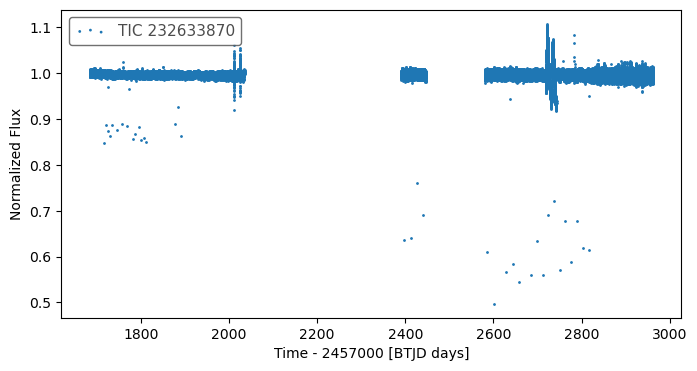

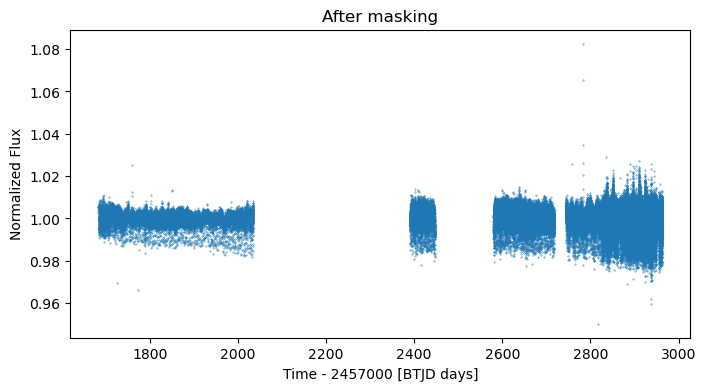

In [22]:
%matplotlib inline
# %matplotlib widget

time = search_result.time.value
flux = search_result.flux.value
fluxerr = search_result.flux_err.value
len(search_result)

# mask out data you don't like...

fig, ax = plt.subplots(figsize=figsize)
search_result.scatter(ax = ax)

# mask = time < 0  #( time > 54950) & (time < 54963)  #  truncate weird spikes at the beginning of Kepler data  
mask = time < 0
mask = (
    ( flux < 0.95 ) | # remove occassional lone outliers
    # cadences where scattered light effect is prevalent
    ( (time > 2718)   & (time < 2744) ) | 
    ( (time > 2010)   & (time < 2012) ) | 
    ( (time > 2023.5) & (time < 2025) ) 
)

time = time[~mask]
flux = flux[~mask]
fluxerr = fluxerr[~mask]

# make sure that therte are no nans!

finite_mask = np.isfinite(time) * np.isfinite(flux) * np.isfinite(fluxerr)

# make a dictionary of the data 

data = pd.DataFrame({'time': time[finite_mask], 'flux': flux[finite_mask], 'err': fluxerr[finite_mask]})

ax2 = plt.figure(figsize=figsize).gca()
ax2.scatter(data.time, data.flux, s=0.1);
ax2.set_ylabel(ax.get_ylabel())
ax2.set_xlabel(ax.get_xlabel())
ax2.set_title("After masking");

In [ ]:
do_bls = False

if do_bls:
    if not "../.." in sys.path:
        sys.path.append("../..")
    import lightkurve_ext_pg_runner as lke_pg_runner  # at ../../

    bls_result = lke_pg_runner.run_bls(
        search_result.remove_nans(),
        pg_kwargs=dict(
            minimum_period=1, maximum_period=20,
            frequency_factor=1,            
            duration=[3.4957 / 24 * f for f in [0.975, 1, 1.025, 1.05, 1.1, 1.15,]],  # based on observed primary eclipse duration for better fit
        ),
    )
    !$NOTIFY_CMD  "BLS Done"

lightkurve.Periodogram properties:
      Attribute                   Description            Units
---------------------- --------------------------------- -----
                nterms                                 2      
          default_view                            period      
                 label                     TIC 232633870      
             ls_method                          fastchi2      
frequency_at_max_power                            1.5176 1 / d
             max_power                            0.0056      
               nyquist                          215.9981 1 / d
   period_at_max_power                             0.659     d
             frequency                   array (799510,) 1 / d
                period                   array (799510,)     d
                 power                   array (799510,)      
                  meta <class 'collections.OrderedDict'>      
              targetid                <class 'NoneType'>      
0.6589522677561571 d

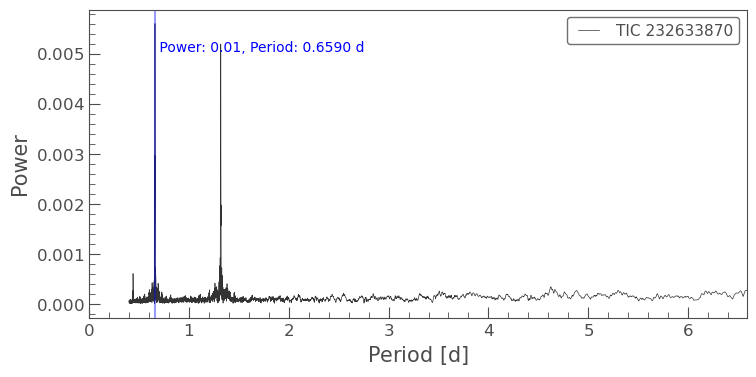

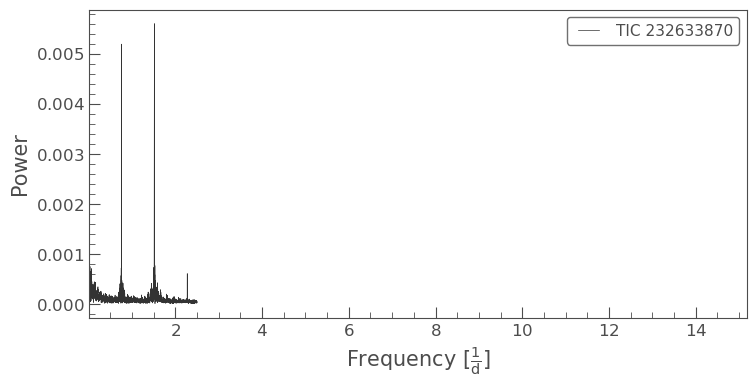

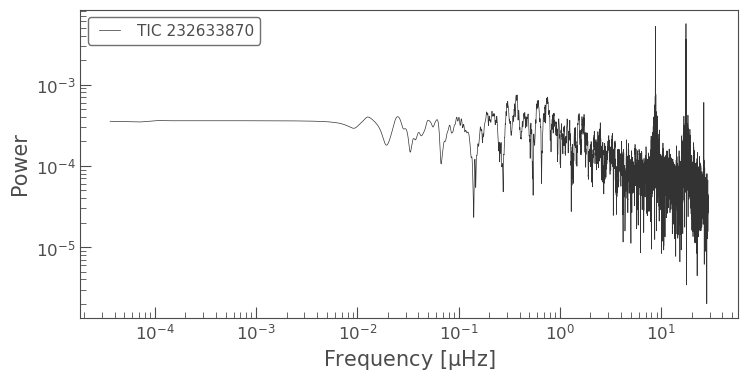

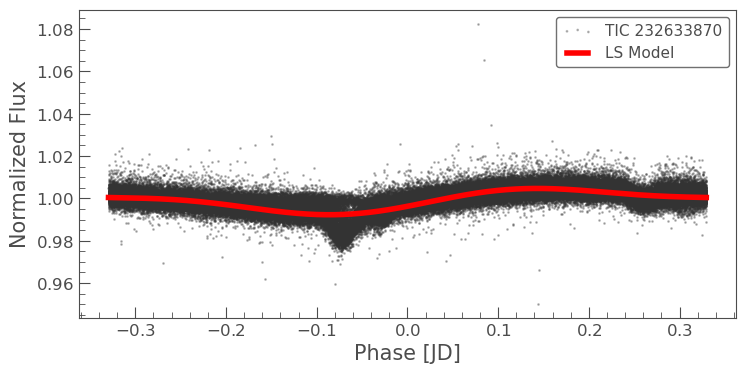

In [34]:
do_ls = True

if do_ls:
    if not "../.." in sys.path:
        sys.path.append("../..")
    import lightkurve_ext_pg as lke_pg  # at ../../

    lc = lk.LightCurve(time=Time(time, format="btjd"), flux=flux, flux_err=fluxerr)
    lc.meta["LABEL"] = f"TIC {ticid}"
    pg = (
        lc
        .to_periodogram(method="lombscargle",
                        # maximum_period=10,
                        minimum_period=0.4,                    
                           # minimum_period=0.0005, maximum_period=1,
                           # minimum_period=3, maximum_period=15,
                        ls_method="fastchi2", nterms=2,
                        oversample_factor=250,  # default: 5
                          )
         )
    pg.show_properties();
    print(pg.period_at_max_power);
    
    ax = lke_pg.plot_pg_n_mark_max(pg, max_period_factor=10);
    
    ax = pg.plot(view="frequency");  # frequency view
    ax.set_xlim(pg.frequency_at_max_power.value / 100 , pg.frequency_at_max_power.value * 10);

    ax = pg.plot(view="frequency", unit=u.microhertz, scale="log");  

    axs, lcs = lke_pg.plot_lc_with_model(
        lc,
        pg, 
        plot_lc=False, plot_model=False, plot_folded_model=True,
        also_return_lcs=True);


In [ ]:
# Visaully compare different candidate period

# ax = search_result.normalize().fold(epoch_time=1471.4196, period=8.418132651611877).truncate(-0.1, 0.1).scatter(label="BLS period, frequency_factor=10");  # HWHM 0.001571020094789155
# ax = search_result.normalize().fold(epoch_time=1471.4196, period=8.418147).truncate(-0.1, 0.1).scatter(label="s0001-s0009:TCE1");

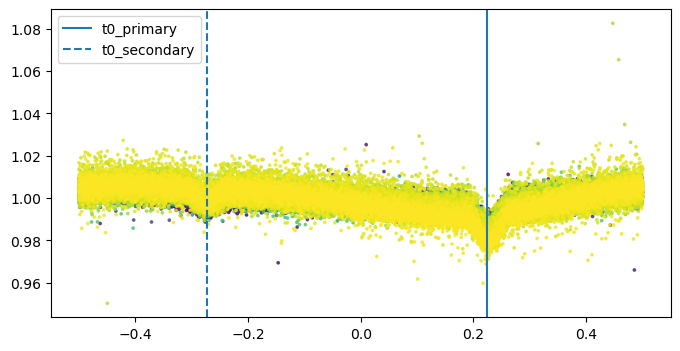

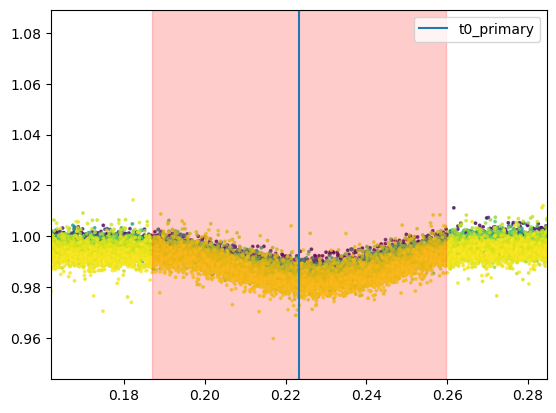

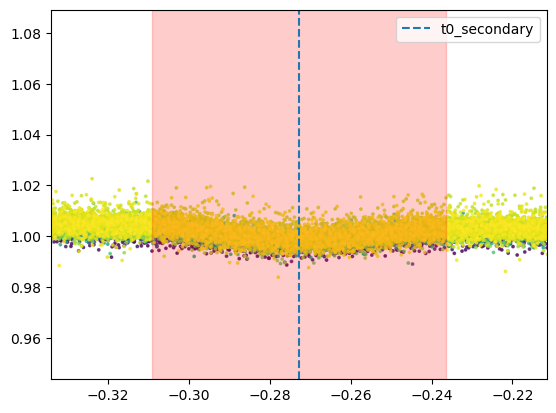

In [64]:
%matplotlib inline
# %matplotlib widget

from astropy.time import Time

# define the orbital period and the t0 

# epoch=1956.14, duration_hr=1.15055, period=0.6589319999999999, label="s0024s0024tce1", transit_depth_percent=1.2354,
# epoch=3312.87, duration_hr=1.11084, period=0.658943, label="s0074s0074tce1", transit_depth_percent=1.1230,
# MCMC on df_primary 1st run: 0.6589248556332254, significant error: 0.0016
# MCMC on df_primary 2nd run: 0.6589248663333831, error: 6.5e-6

# FILL-IN THE eclipse epoch / period, 
period = 0.658932  # s24TCE1
period = 0.65892486  # MCMC 

# t0_primary = 1956.14 -  0.010 # s24TCE1
t0_primary = 1684.00  # MCMMC
t0_secondary = t0_primary + 0.332

duration_hr_primary = 1.15
duration_hr_secondary = 1.15

# convert epoch from BTJD to commonly mjd used here
# t0_primary = Time(t0_primary, format="btjd").to_value("mjd")
# t0_secondary = Time(t0_secondary, format="btjd").to_value("mjd")

# Move t0 to the first dip in the data (some of the subsequent codes, espically fit_each_eclipse(), assumes that)
t0_primary = t0_primary - int((t0_primary - data['time'][0]) / period) * period
if t0_secondary is not None:
    t0_secondary = t0_secondary - int((t0_secondary - data['time'][0]) / period) * period

t0_for_plotting = 0  # keep 0 for plotting purposes
if t0_secondary is not None:
    t0_for_plotting = t0_primary - np.abs(t0_primary - t0_secondary) * 0.45  # use a custom one so that the eclipses are not near the edge (-0.5 or +0.5)

phase = etv_functions.phase_data(data['time'], t0_for_plotting, period)

fig, ax = plt.subplots(figsize = (8,4))

plt.scatter(phase,data['flux'], s = 3, alpha = 0.7, c = data['time'])

# add the phase to the dataframe
data['phase'] = phase

plt.axvline(etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0], label="t0_primary")
if t0_secondary is not None:
    plt.axvline(etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0], linestyle="--", label="t0_secondary")
plt.legend()
# plt.ylim(0.535, 0.55)
# plt.xlim(-0.5, 0.1)
plt.show();

plt.scatter(phase,data['flux'], s = 3, alpha = 0.7, c = data['time'])
plt.axvline(etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0], label="t0_primary")
t1_p, t4_p = etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0] - 0.5 * duration_hr_primary / 24/ period, etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0] + 0.5 * duration_hr_primary / 24/ period 
plt.xlim(t1_p - 0.025, t4_p + 0.025);
plt.axvspan(t1_p, t4_p, color="red", alpha=0.2);plt.legend();
# plt.ylim(0.75, 0.85);
plt.show()

if t0_secondary is not None:
    plt.scatter(phase,data['flux'], s = 3, alpha = 0.7, c = data['time'])
    plt.axvline(etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0], linestyle="--", label="t0_secondary")
    t1_s, t4_s = etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0] - 0.5 * duration_hr_secondary / 24/ period, etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0] + 0.5 * duration_hr_secondary / 24/ period 
    plt.xlim(t1_s - 0.025, t4_s + 0.025);
    plt.axvspan(t1_s, t4_s, color="red", alpha=0.2);plt.legend();
    plt.legend();
    # plt.ylim(0.975, 1.005);
    plt.show()

### Compare folded plots across sectors

In [ ]:
with plt.style.context(lk.MPLSTYLE):
    fig, axs = plt.subplots(1, len(lcc_tess), figsize=(4 * len(lcc_tess), 3), sharey=True);
    if isinstance(axs, plt.Axes):
        axs = [axs]
    for i, lc in enumerate(lcc_tess):
        lc_f = lc.select_flux("flux").normalize(unit="percent").fold(period=period, epoch_time=t0_primary)
        lc_f = lc_f.truncate(-duration_hr_primary * 2 / 24, duration_hr_primary * 2 / 24)
        ax = lc_f.scatter(ax=axs[i], s=1, label=f"S.{lc_f.sector}");
        ax.legend(loc="lower right");
        if i > 0: 
            ax.set_ylabel(None)
            ax.set_xlabel(None)
    fig.suptitle(f"{lc.label}, folded around primary eclipses");
plt.tight_layout();

# ---
with plt.style.context(lk.MPLSTYLE):
    fig, axs = plt.subplots(1, len(lcc_tess), figsize=(4 * len(lcc_tess), 3), sharey=True);
    if isinstance(axs, plt.Axes):
        axs = [axs]
    for i, lc in enumerate(lcc_tess):
        lc_f = lc.select_flux("flux").normalize(unit="percent").fold(period=period, epoch_time=t0_secondary)
        lc_f = lc_f.truncate(-duration_hr_secondary * 2 / 24, duration_hr_secondary * 2 / 24)
        ax = lc_f.scatter(ax=axs[i], s=1, label=f"S.{lc_f.sector}");
        ax.legend(loc="lower right");
        if i > 0: 
            ax.set_ylabel(None)
            ax.set_xlabel(None)
    fig.suptitle(f"{lc.label}, folded around secondary eclipses");
plt.tight_layout();

### Detrend (optional)

- detrended flux is in `flux_detrended`, and won't be used in subsequent work by default

In [ ]:
# show data to visualize what's changed in each step below
data  

In [ ]:
# phase fold the data and create an appoximate binary model (top) and subtract it from the data (bottom)
#_, _ , flux_sub_binary, model, _, _ = etv_functions.trend_removal_interact(period, 0, data['time'], data['flux'], data['time'], data['flux'])

data = etv_functions.trend_removal_interact(period, t0_for_plotting, data)
data

In [ ]:
# if you want to detrend the data run this line!

data = etv_functions.detrend_suz(data, T_dur = 10, plot = True)
data

In [ ]:
# plot the phase folded data here so that you know at what phase you want to cut the data to model 
fig, ax = plt.subplots(figsize = figsize)
plt.scatter(data.phase, data.flux_detrended, s = 1, label="flux_detrended")
plt.legend()
plt.show()

plt.scatter(phase,data['flux_detrended'], s = 3, alpha = 0.7, c = data['time'])
plt.axvline(etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0], label="t0_primary")
plt.xlim(etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0] - 0.6 * duration_hr_primary / 24/ period, etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0] + 0.6 * duration_hr_primary / 24/ period);
plt.legend();
# plt.ylim(0.75, 0.85);
plt.show()

plt.scatter(phase,data['flux_detrended'], s = 3, alpha = 0.7, c = data['time'])
plt.axvline(etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0], linestyle="--", label="t0_secondary")
plt.xlim(etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0] - 0.6 * duration_hr_secondary / 24/ period, etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0] + 0.6 * duration_hr_secondary / 24/ period);
plt.legend();
# plt.ylim(0.75, 0.85);
plt.show()

<span style="background-color: rgba(255, 0, 0, 0.6);"> NOTE: </span> The zoom windows below for the eclipses are made **smaller**, an attempt to reduce the complications of EW variability outside the minima (and some assymetery)

### Now that the data is ready we can start 

Primary:   1684.0 0.22326701560468942
window_width_p (phase): 0.12646864368318617
Secondary: 1683.67307514 -0.2728819079614404
window_width_s (phase): 0.12646864368318617
Start params for  fitting period with MCMC on df_primary:
[0.9972, -0.0114, t0_primary, 0.01857, 1.0387, 0.65892486],


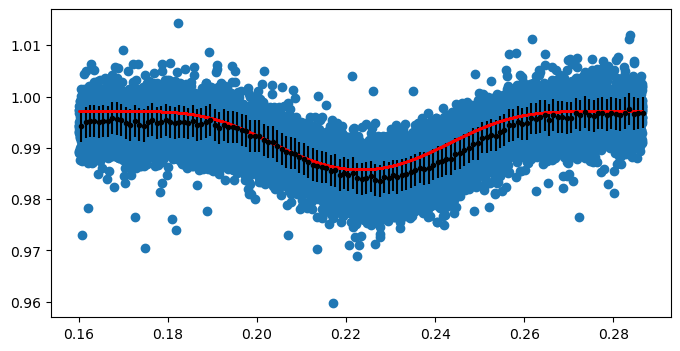

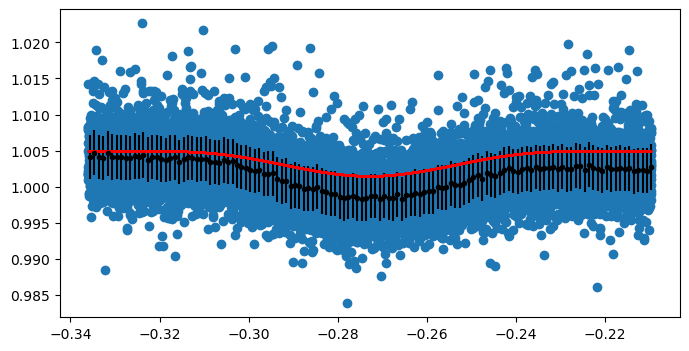

In [61]:
# define the midpoints of the primary and secondary eclipses and the window width

# if these don't look central - change them!! the eclipses should be central
midpoint_p =  etv_functions.phase_data([t0_primary], t0_for_plotting, period)[0]  # convet to time in phase
# midpoint_p -= 0.004  # the offset is added back to t0_primary (& secondary above
print('Primary:  ', t0_primary, midpoint_p)

# change depending on the width of the eclipses, default to be slightly larger than the primary eclipse
# window_width_p = 1.2 * duration_hr_primary / 24 / period   # it seems to be difficult to bit model the flat bottom and the curves outside, focus on the overall shape for now
window_width_p = 2 / 24 / period  # use a wider window due to period uncertainity 
# use a shoter duration to avoid fitting the out-of-eclipse LC, which has its own variability that the model is not equipped to hanlde
# window_width_p = 0.095
print("window_width_p (phase):", window_width_p)

data_primary = data[(data['phase'] > midpoint_p - window_width_p / 2) & (data['phase'] < midpoint_p + window_width_p / 2) ]
ph_binned,flux_binned,err_binned = etv_functions.run_binning_phased(data_primary.phase, data_primary.flux, yerr=data_primary.err,nbins=1000)


if t0_secondary is not None:
    midpoint_s =  etv_functions.phase_data([t0_secondary], t0_for_plotting, period)[0]
    print('Secondary:', t0_secondary, midpoint_s)

    # the coshgauss model seems problematic, try to use a larger width to give it more shape to fit
    # window_width_s = 1.2 * duration_hr_secondary / 24 / period  
    window_width_s = 2 / 24 / period   
    # window_width_s = 0.22
    print("window_width_s (phase):", window_width_s)
    
    data_secondary = data[(data['phase'] > midpoint_s - window_width_s / 2) & (data['phase'] < midpoint_s + window_width_s / 2) ]
    ph_binned_s,flux_binned_s,err_binned_s = etv_functions.run_binning_phased(data_secondary.phase, data_secondary.flux, yerr=data_secondary.err,nbins=1000)


### # you need initial guesses!! The order is :
# alpha0, alpha1, t0, d, Tau - CHANGE THESE TO YOUR OWN INITIAL GUESSES
# median flux, -eclipse depth, t0, related to duration, related to shape (U or V) 
# t0 in normalixed phase
start_vals = [0.9972, -0.01140, midpoint_p, 0.01857, 1.0424]
start_vals_s = [1.005, -0.0035, midpoint_s, 0.019, 0.95]
    
# -- -- -- -- -- -- -- -- -- 
etv_functions.plot_initial_guess(data_primary, ph_binned, flux_binned, err_binned, *start_vals)
if t0_secondary is not None:
    etv_functions.plot_initial_guess(data_secondary, ph_binned_s, flux_binned_s, err_binned_s, *start_vals_s)

print("Start params for  fitting period with MCMC on df_primary:")
print(f"[{start_vals[0]}, {start_vals[1]}, t0_primary, {start_vals[3]}, {start_vals[4]}, {period}],");

In [ ]:
if False: 
    # Export the data around primary eclipses, for period analysis outside of notebook
    data_primary[["time", "flux", "err"]].to_csv(f"tmp/data_primary_{ticid}.csv", index=False)

emcee parallel enabled, use 4 CPUs.


100%|██████████████████████████████████████████████████████████| 2000/2000 [12:36<00:00,  2.64it/s]


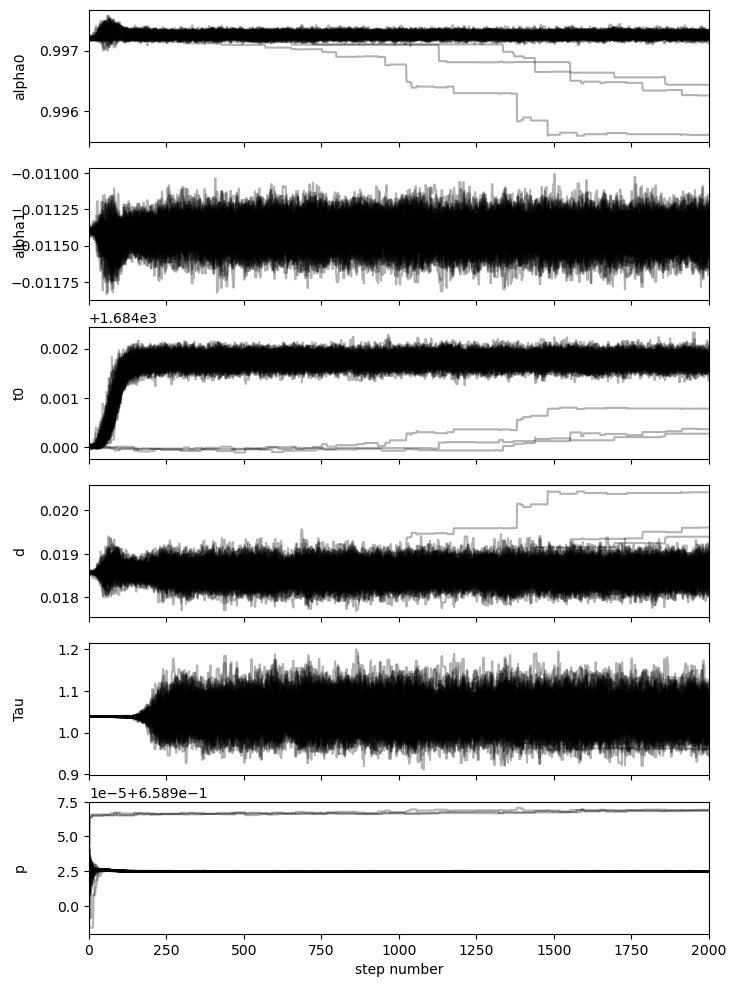

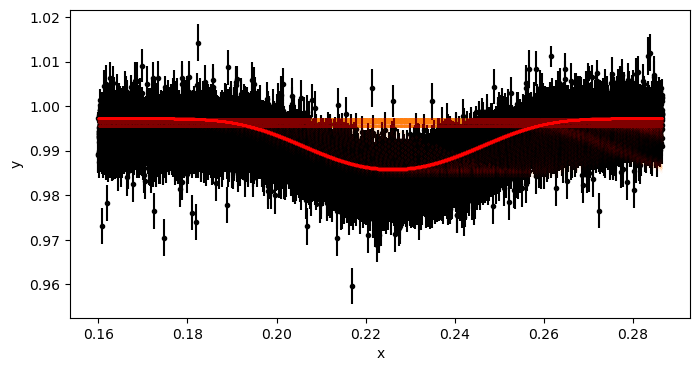

mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p = 0.9972549913303311, -0.011411807148779575, 1684.0017621433326, 0.018561674181783335, 1.0423834464605597, 0.6589248663333831
std_p: 6.545663812309685e-06


In [63]:
# use MCMC to refine the period

use_mcmc_to_fit_period = True


if use_mcmc_to_fit_period:
    import etv_functions_with_period as etvp

    etv_functions.enable_info_log_for_jupyter()
        
    # MCMC result
    # mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p = 0.9972403609501519, -0.011401443787189852, 1684.0017660602975, 0.018573210393113534, 1.0386679388812077, 0.6589248556332254
    # std_p: 0.0016413326890510598
    # 2nd run
    # mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p = 0.9972549913303311, -0.011411807148779575, 1684.0017621433326, 0.018561674181783335, 1.0423834464605597, 0.6589248663333831
    # std_p: 6.545663812309685e-06
    mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p, fit_params_p_stats = etvp.run_mcmc_initial_fit_p(
        data_primary[:],
        # [0.995, -0.012, t0_primary, 0.019, 0.95, 0.658932],  # first run
        # nruns=1000, discard=600, 
        [0.9972, -0.0114, t0_primary, 0.01857, 1.0387, 0.65892486], # 2nd runh
        nruns=2000, discard=1000, 
        # nruns=20, discard=1, 
        pool=-2,
        plot_chains=True,
        plot=True,
        also_return_stats=True,
    )
    print("mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p = " + ", ".join([str(v) for v in [mean_alpha0, mean_alpha1, mean_t0_time, mean_d, mean_Tau, mean_p]]))
    print("std_p:", fit_params_p_stats["std_p"])
    !$NOTIFY_CMD "Fitting period done."

emcee parallel enabled, use 4 CPUs.


100%|██████████████████████████████████████████████████████████| 1000/1000 [01:38<00:00, 10.12it/s]


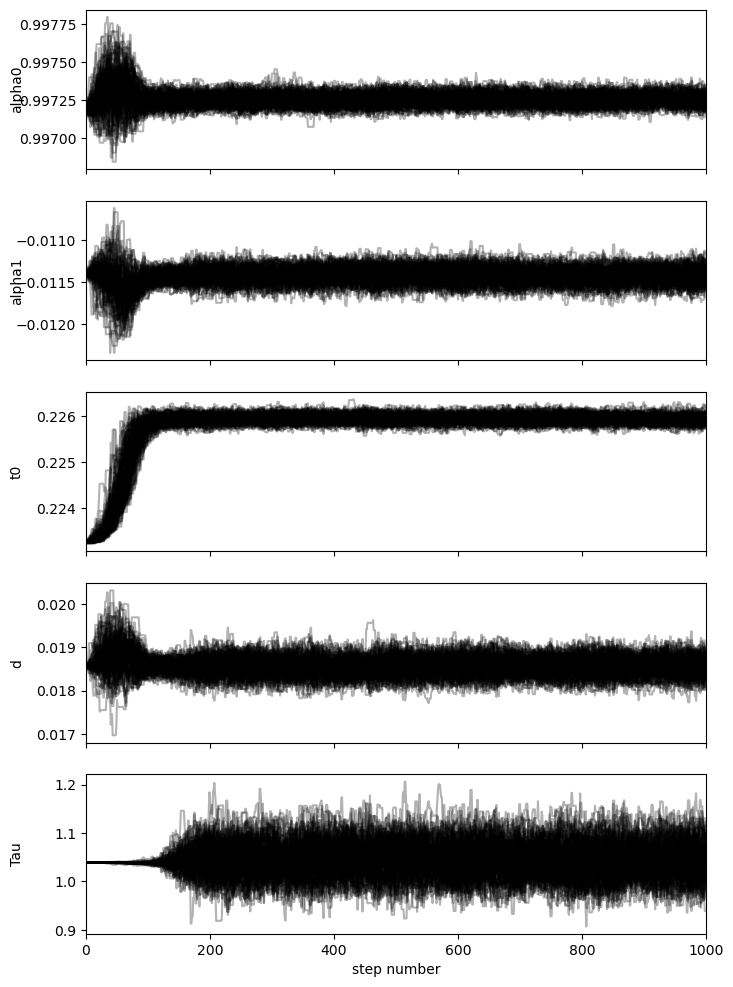

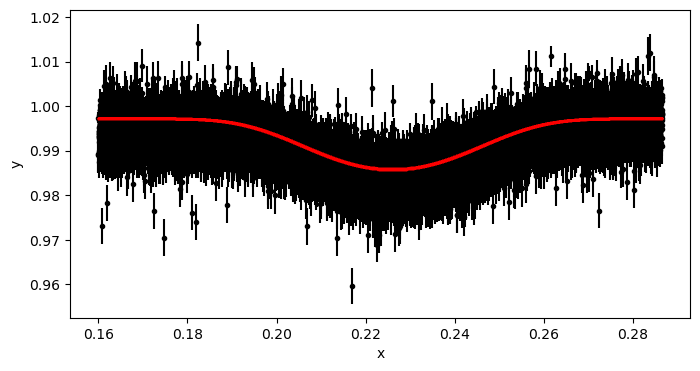

In [65]:
# run the initial model fit using MCMC for the primary and secondary eclipses 
run_init_fit = True

if run_init_fit:
    etv_functions.enable_info_log_for_jupyter()
    mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau = etv_functions.run_mcmc_initial_fit(data_primary, start_vals, nruns=1000, discard=600, pool=-2, plot_chains = True, plot = True)
    !$NOTIFY_CMD "Initial fit primary done"

emcee parallel enabled, use 4 CPUs.


100%|██████████████████████████████████████████████████████████| 1000/1000 [01:43<00:00,  9.65it/s]


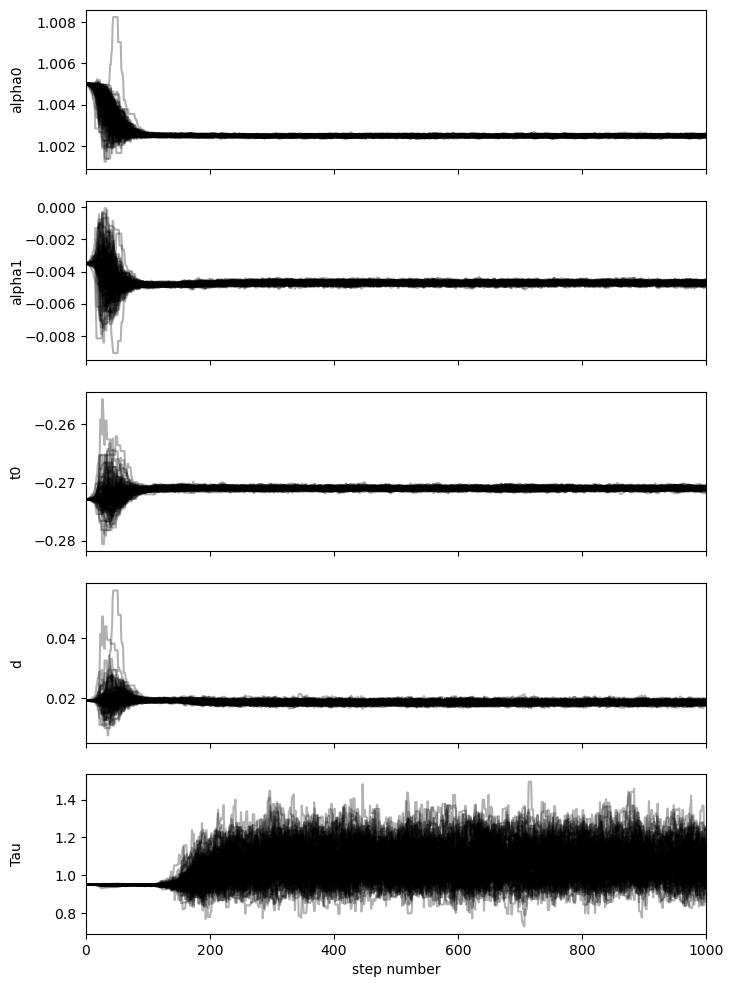

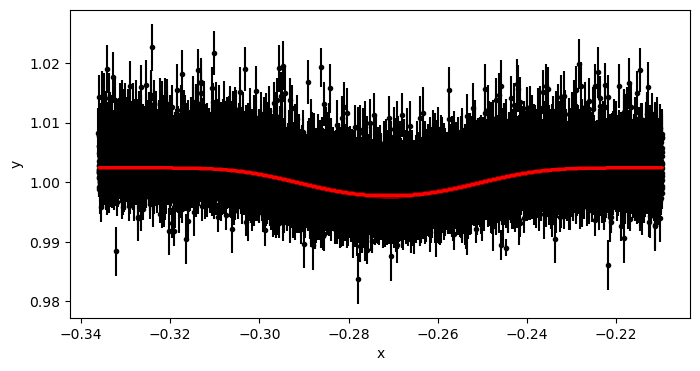

In [66]:
if run_init_fit:
    if t0_secondary is not None:
        mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s = etv_functions.run_mcmc_initial_fit(data_secondary, start_vals_s, nruns=1000, discard=600, pool=-2, plot_chains = True, plot = True)
        !$NOTIFY_CMD "Initial fit secondary done"

In [ ]:
if not run_init_fit:  # case init fit has been previously saved and to be reussed
    print("Use pre-defined inital model params:")
    # initial fit params from TESS data
    mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau = 0.9972590827504733, -0.01141763491675456, 0.22594590701634074, 0.018561559174368532, 1.043230609913581
    mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s = 1.0024856499010593, -0.004706525929913496, -0.2709965625095382, 0.01843460634564785, 1.0666151463590028

    etv_functions.plot_initial_guess(data_primary, ph_binned, flux_binned, err_binned, *[mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau])
    etv_functions.plot_initial_guess(data_secondary, ph_binned_s, flux_binned_s, err_binned_s, *[mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s])    

In [67]:
print("Initial model params:")  # For information, and they can be copied to the cell above for future reuse

print("mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau = " + ", ".join([str(v) for v in [mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau]]))
if t0_secondary is not None:
    print("mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s = " + ", ".join([str(v) for v in [mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s]]))

Initial model params:
mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau = 0.9972590827504733, -0.01141763491675456, 0.22594590701634074, 0.018561559174368532, 1.043230609913581
mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s = 1.0024856499010593, -0.004706525929913496, -0.2709965625095382, 0.01843460634564785, 1.0666151463590028


1941

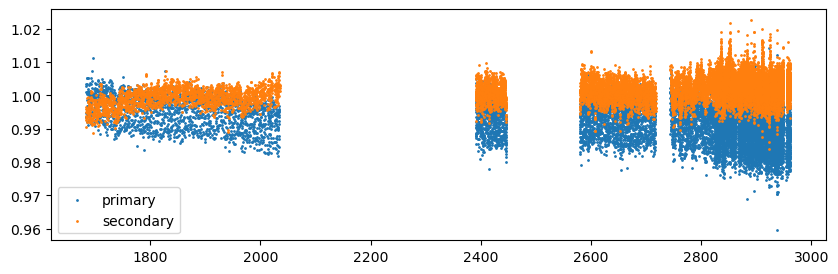

In [68]:
fig = plt.subplots(figsize=(10, 3), sharex=True)
plt.scatter(data_primary.time,data_primary.flux , s = 1, label = 'primary')
if t0_secondary is not None:
    plt.scatter(data_secondary.time,data_secondary.flux , s = 1, label = 'secondary')
plt.legend()

# calculate the number of transits there are within the data 
n_transits = int((max(data_primary.time) - min(data_primary.time)) / period)
n_transits

1684.0 0.65892486 1684.0


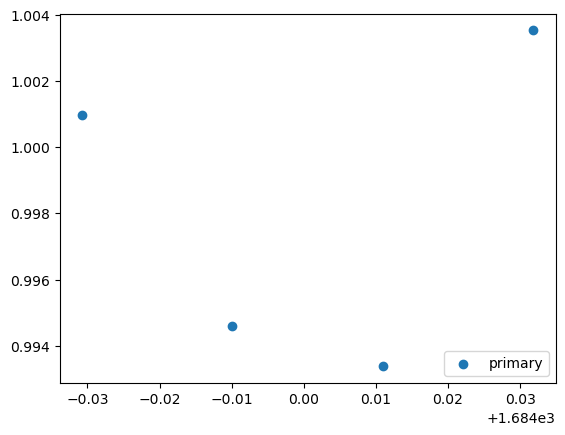

1684.0 0.65892486 1684.65892486


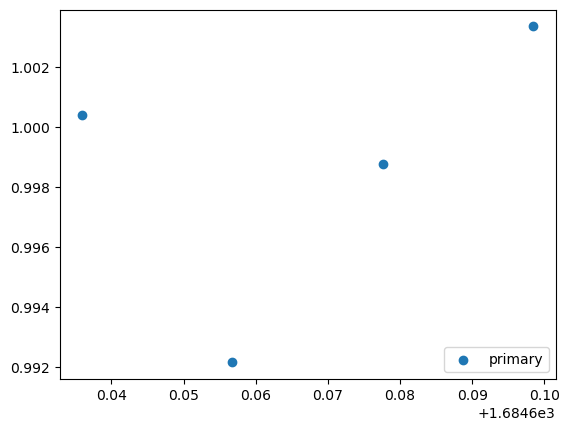

1684.0 0.65892486 1685.31784972


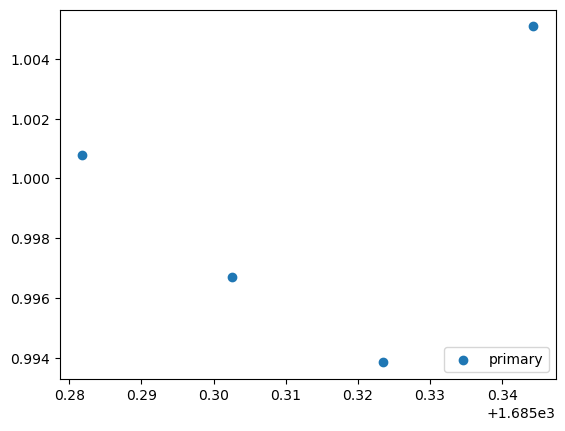

1683.67307514 0.65892486 1683.67307514


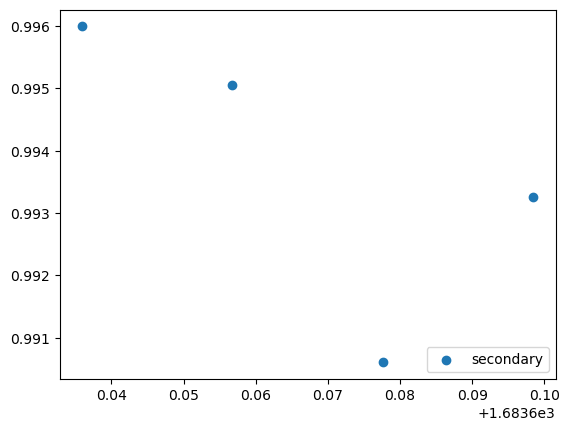

1683.67307514 0.65892486 1684.332


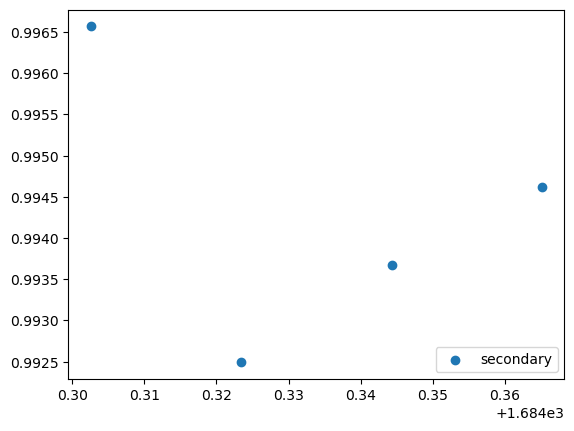

1683.67307514 0.65892486 1684.99092486


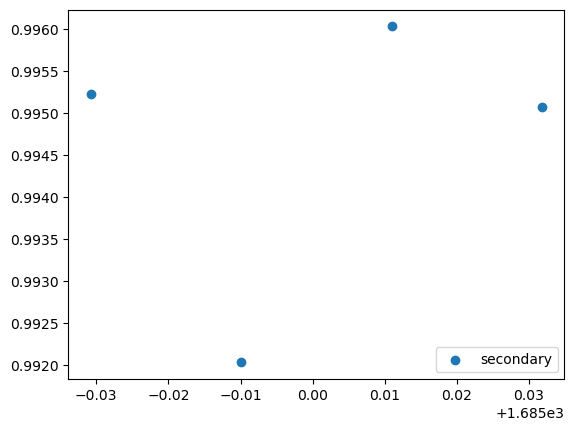

In [69]:
tr_index = range(0,n_transits)

for i in tr_index[0:3]:        
    transit_time = t0_primary+(period*i)
    x = np.array(data_primary.time)
    y = np.array(data_primary.flux) 
    yerr = np.array(data_primary.err)
    
    print (t0_primary, period, transit_time)
    
    mask = (x > (transit_time - (0.2*period))) & (x < (transit_time + (0.2*period))) 
    
    x = np.array(x[mask])
    y = np.array(y[mask]) 
    yerr = np.array(yerr[mask])
    fig, ax = plt.subplots()
    plt.scatter(x,y, label="primary")
    plt.legend(loc="lower right")
    plt.show()
    

if t0_secondary is not None:
    for i in tr_index[0:3]:        
        transit_time = t0_secondary+(period*i)
        x = np.array(data_secondary.time)
        y = np.array(data_secondary.flux) 
        yerr = np.array(data_secondary.err)
        
        print (t0_secondary, period, transit_time)
        
        mask = (x > (transit_time - (0.2*period))) & (x < (transit_time + (0.2*period))) 
        
        x = np.array(x[mask])
        y = np.array(y[mask]) 
        yerr = np.array(yerr[mask])
        fig, ax = plt.subplots()
        plt.scatter(x,y, label="secondary")
        plt.legend(loc="lower right")
        plt.show()

Fitting individual primary eclipses...
Creating new manifest file
Time 1684.0 does not have enough data points: 4
Time 1684.65892486 does not have enough data points: 4
Time 1685.31784972 does not have enough data points: 4
Time 1685.97677458 does not have enough data points: 4
Time 1686.63569944 does not have enough data points: 4
Time 1687.2946243 does not have enough data points: 4
Time 1687.95354916 does not have enough data points: 4
Time 1688.61247402 does not have enough data points: 4
Time 1689.27139888 does not have enough data points: 4
Time 1689.93032374 does not have enough data points: 4
Time 1690.5892486 does not have enough data points: 4
Time 1691.24817346 does not have enough data points: 4
Time 1691.90709832 does not have enough data points: 4
Time 1692.56602318 does not have enough data points: 4
Time 1693.22494804 does not have enough data points: 4
Time 1693.8838729 does not have enough data points: 4
Time 1694.54279776 does not have enough data points: 4
Time 1695

100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.76it/s]


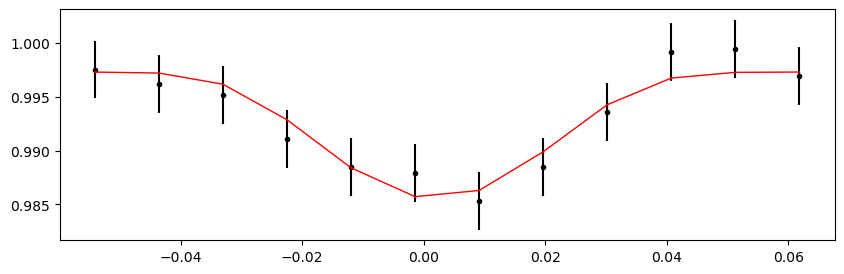

2391.68529964 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.25it/s]


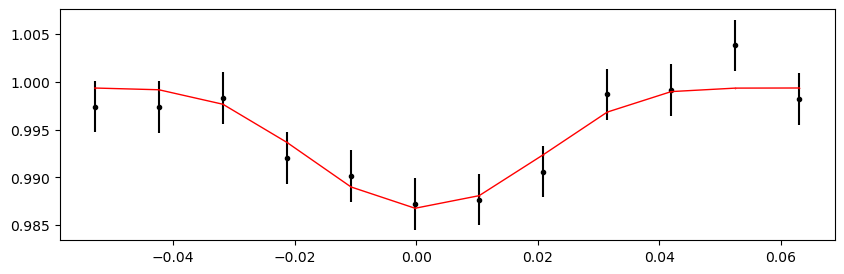

2392.3442245 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.05it/s]


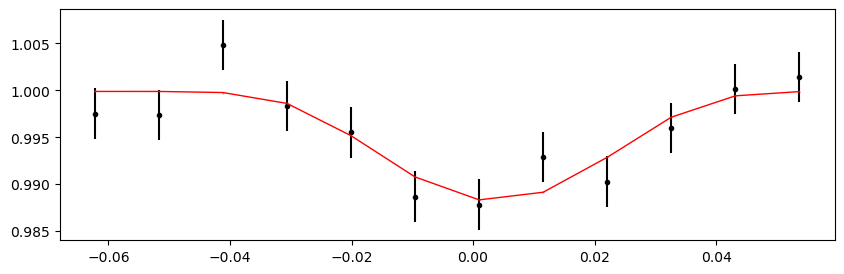

2393.00314936 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.55it/s]


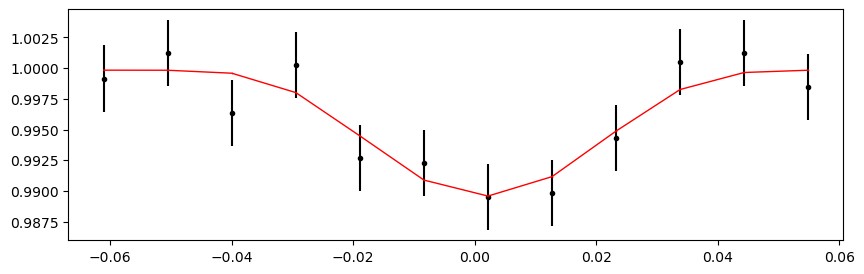

2393.66207422 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.14it/s]


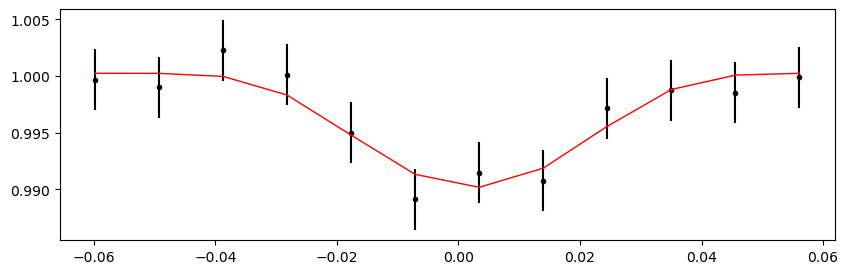

2394.32099908 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.82it/s]


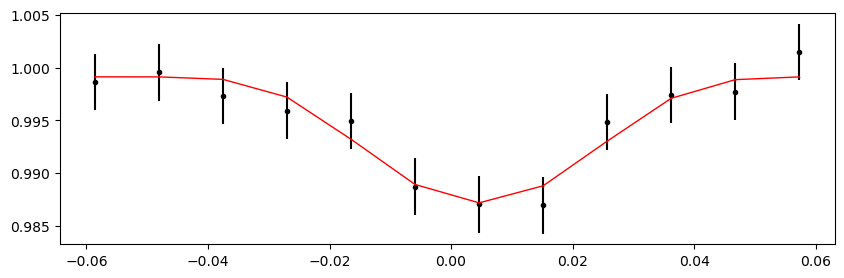

2394.97992394 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.35it/s]


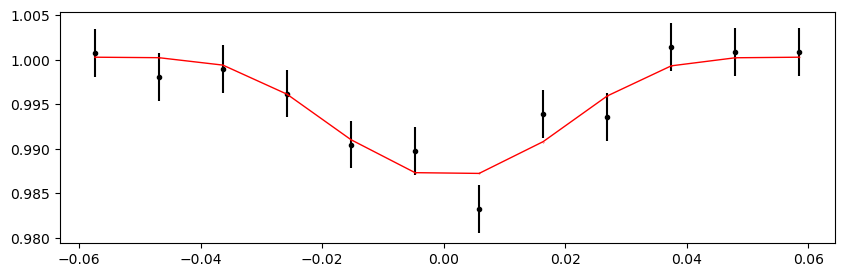

2395.6388488 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.11it/s]


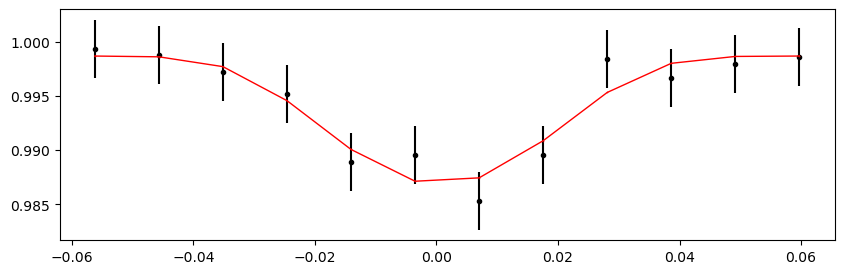

2396.29777366 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.98it/s]


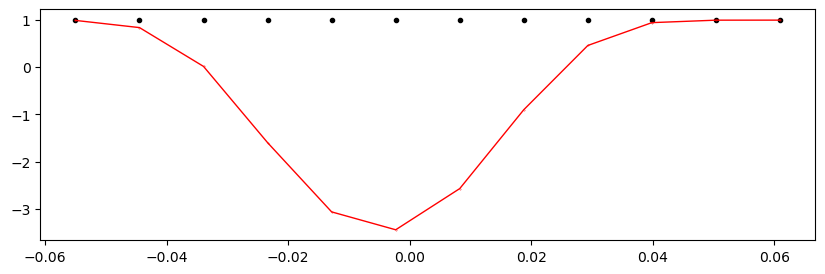

2396.95669852 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.76it/s]


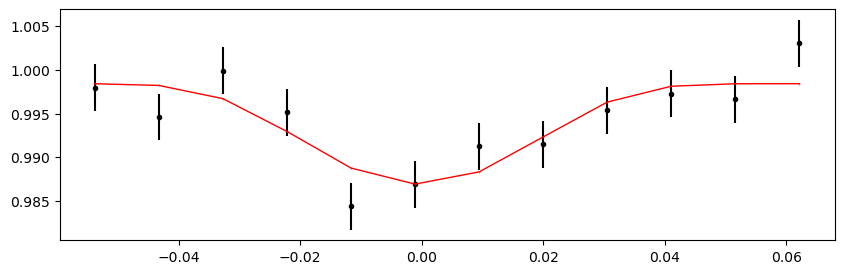

2397.61562338 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 527.36it/s]


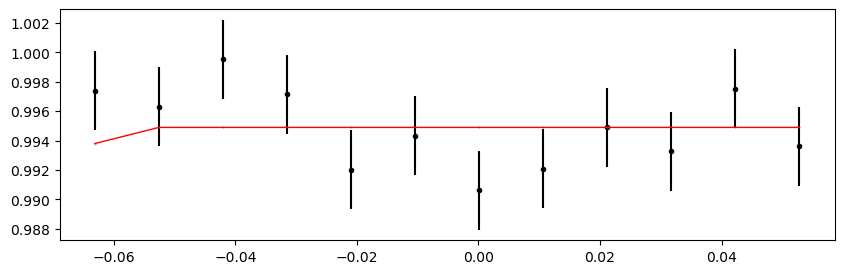

2398.27454824 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.94it/s]


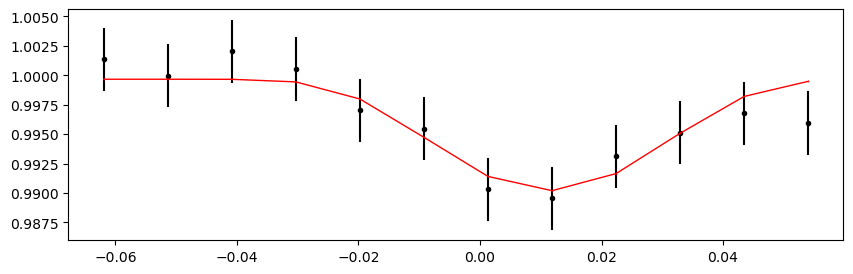

2398.9334731 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 463.39it/s]


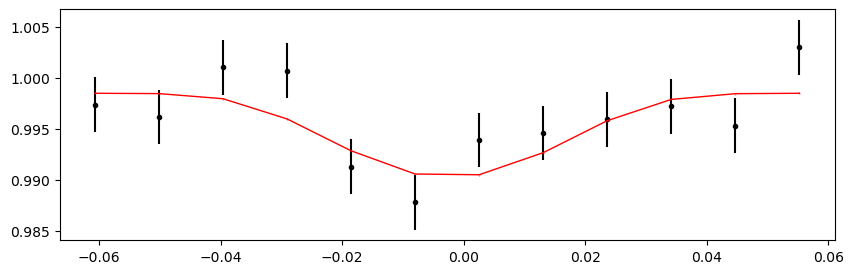

2399.59239796 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.39it/s]


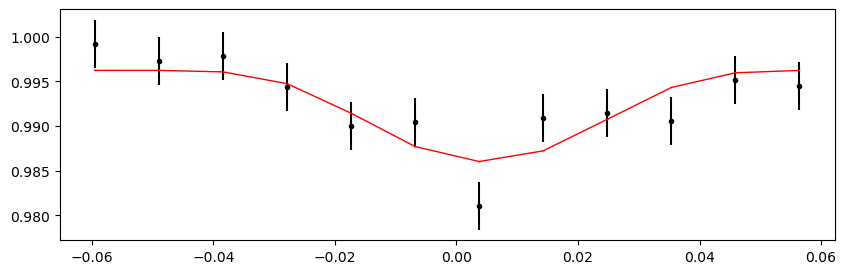

2400.25132282 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.61it/s]


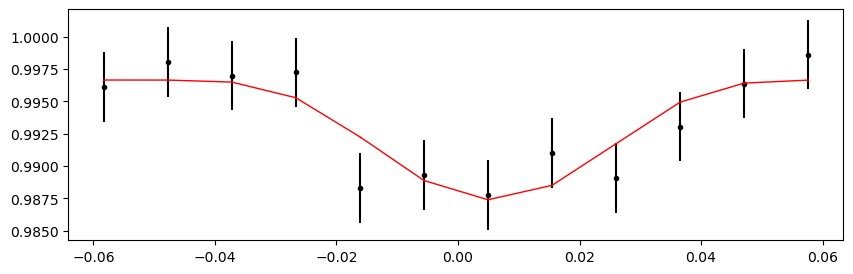

2400.91024768 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.27it/s]


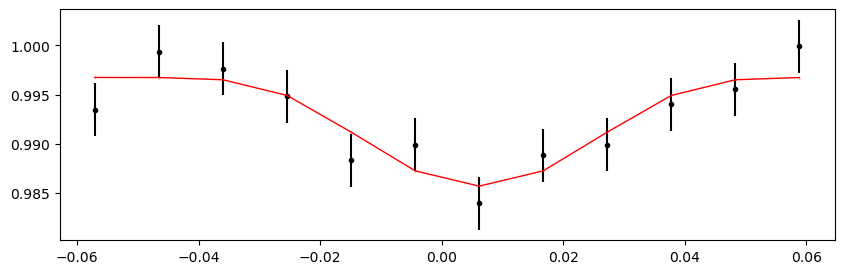

2401.56917254 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.24it/s]


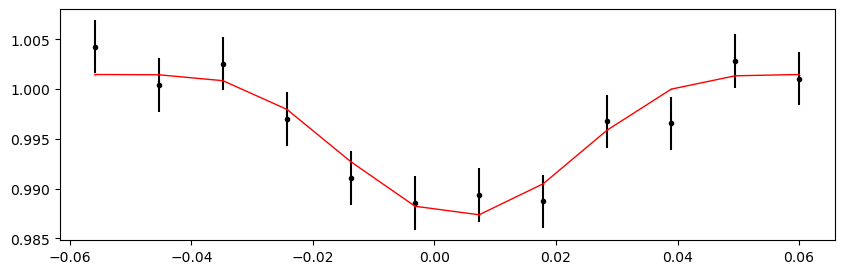

2402.2280974 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.03it/s]


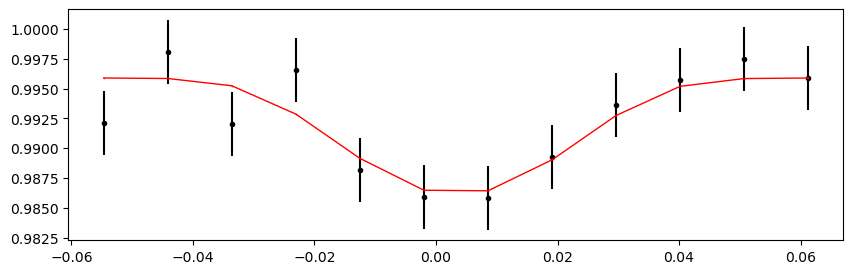

2402.88702226 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.48it/s]


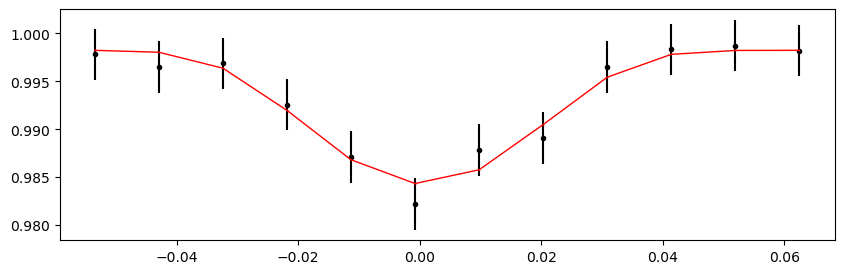

2403.54594712 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.40it/s]


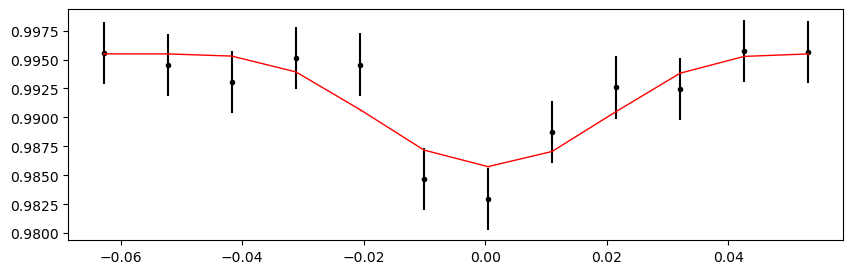

2404.20487198 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.57it/s]


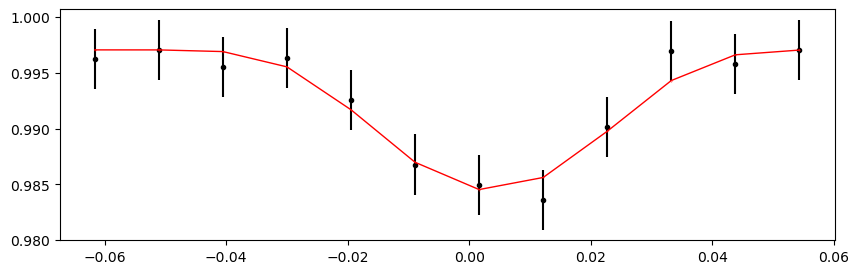

2405.5227217 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.32it/s]


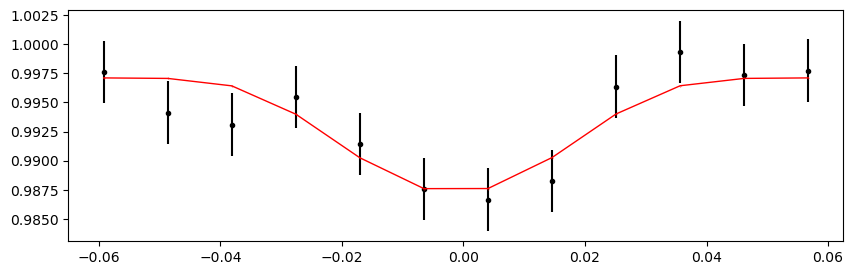

2406.18164656 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.99it/s]


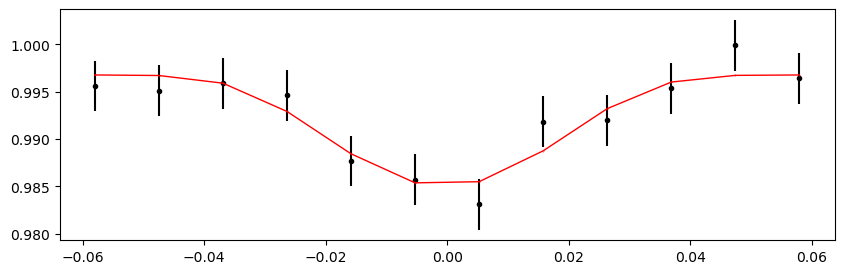

2406.84057142 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.08it/s]


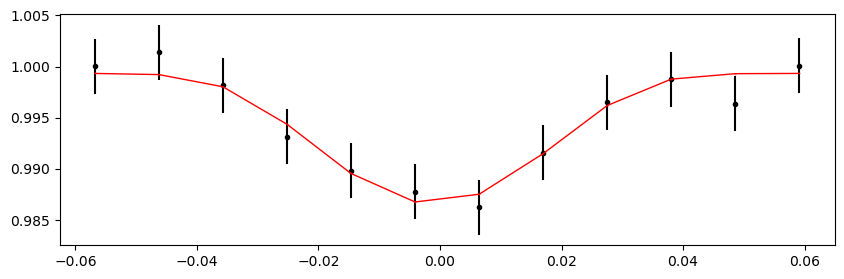

2407.49949628 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.74it/s]


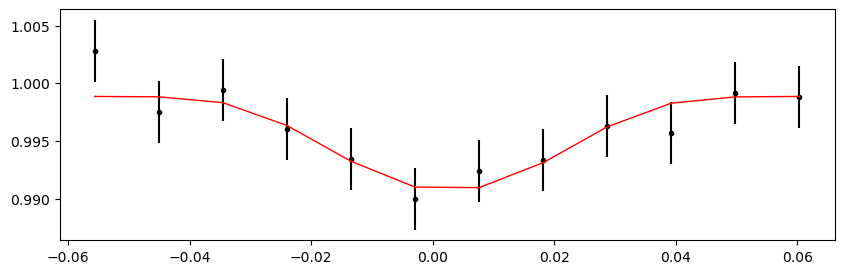

2408.15842114 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.63it/s]


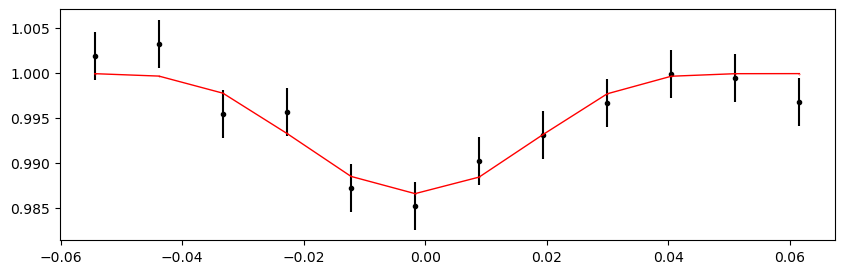

2408.817346 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.76it/s]


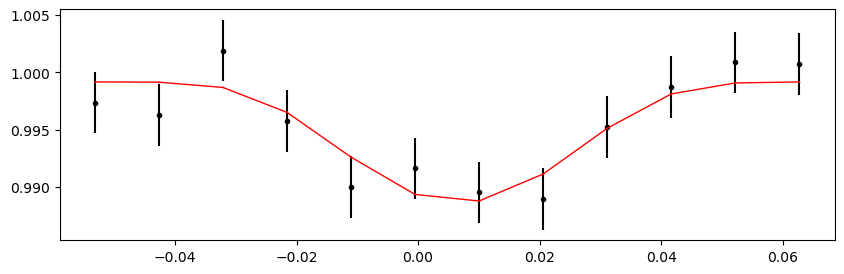

2409.47627086 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.99it/s]


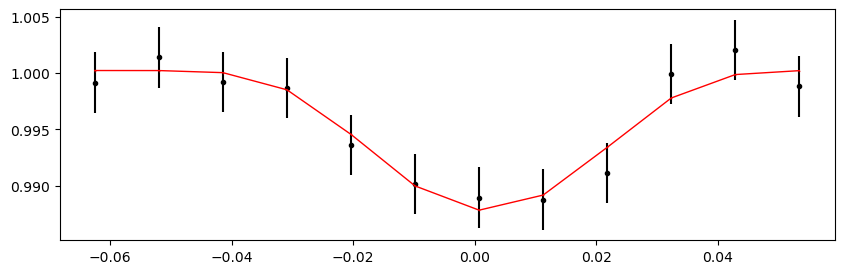

2410.13519572 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.88it/s]


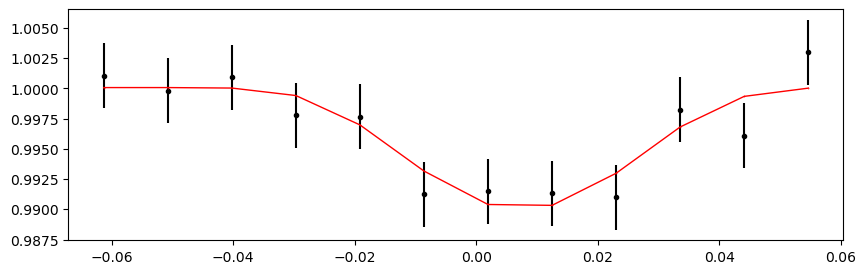

2410.79412058 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.25it/s]


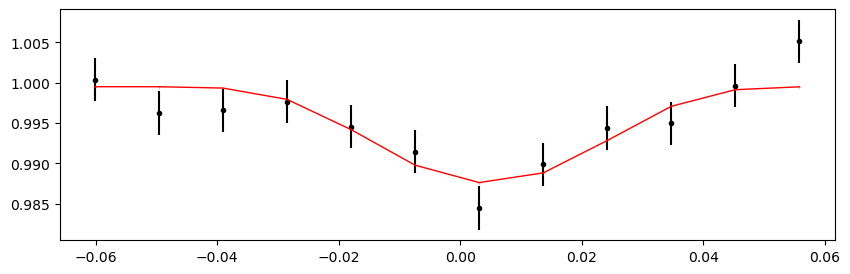

2411.45304544 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.76it/s]


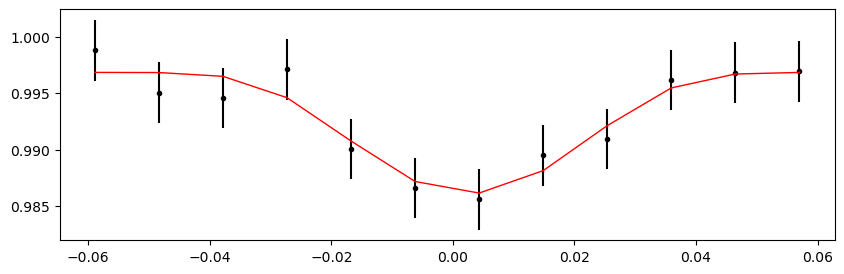

2412.1119703 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.27it/s]


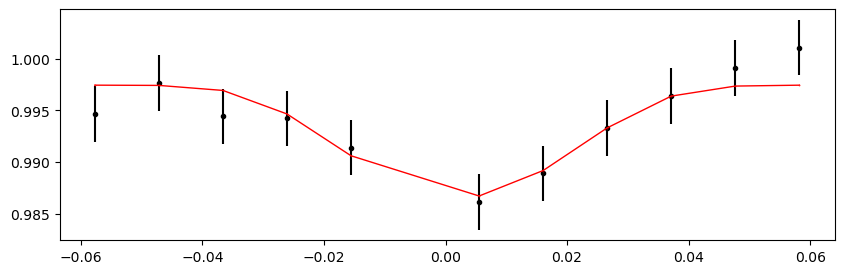

2412.77089516 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.72it/s]


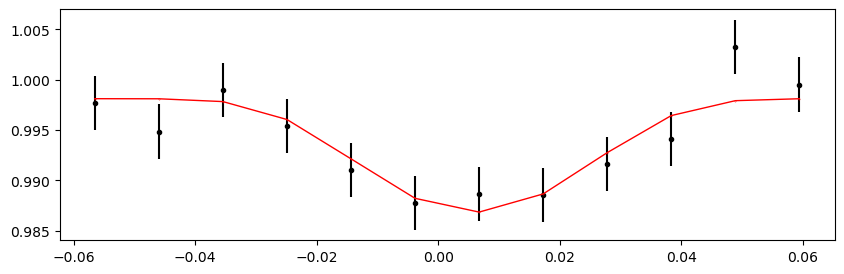

2413.42982002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.73it/s]


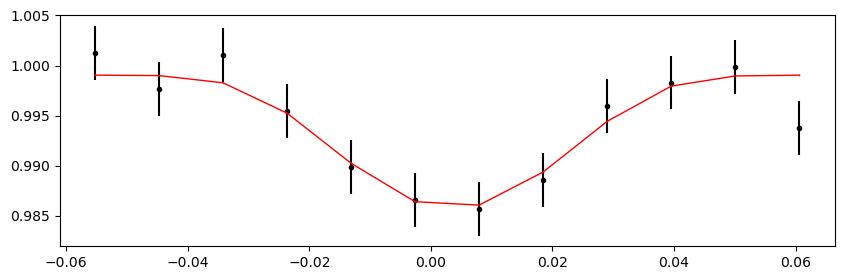

2414.08874488 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.34it/s]


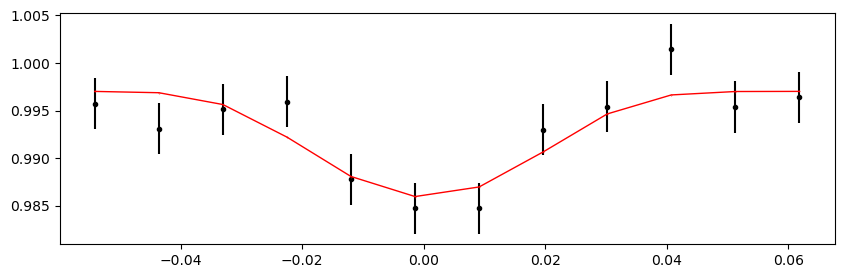

2414.7476697399998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.82it/s]


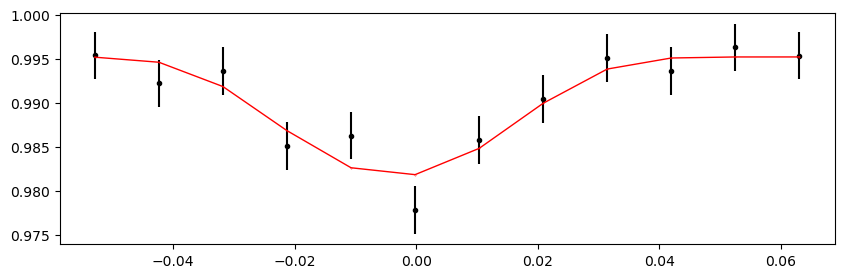

2415.4065946 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.83it/s]


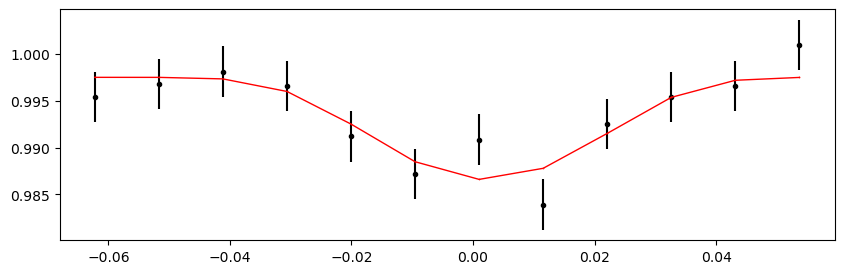

2416.06551946 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.69it/s]


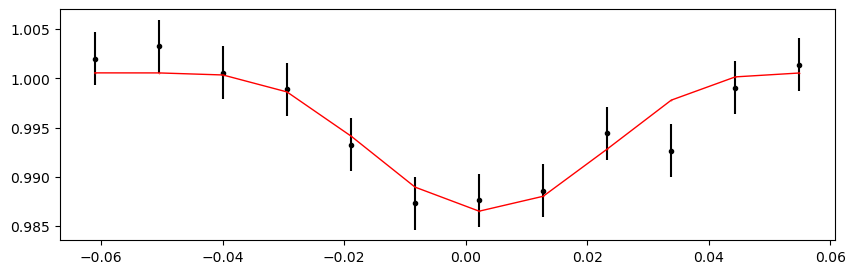

2416.7244443199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.01it/s]


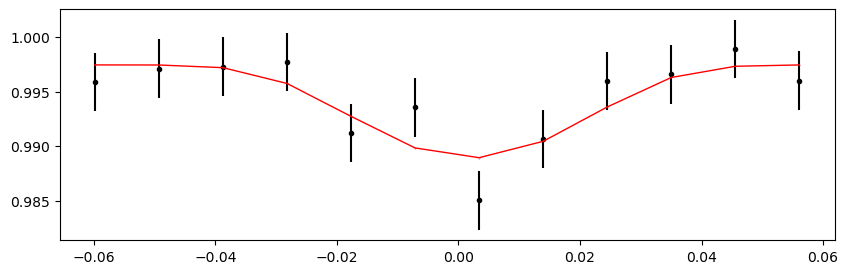

2417.38336918 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.07it/s]


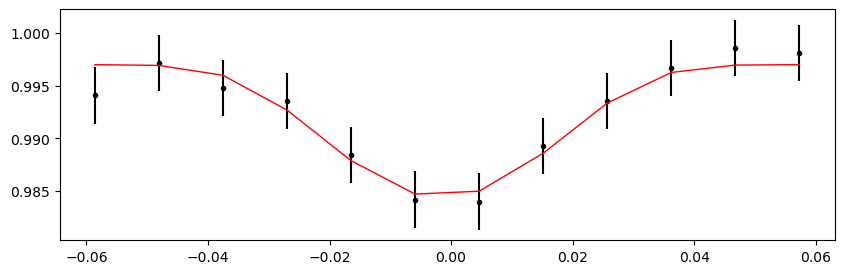

2418.04229404 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 375.90it/s]


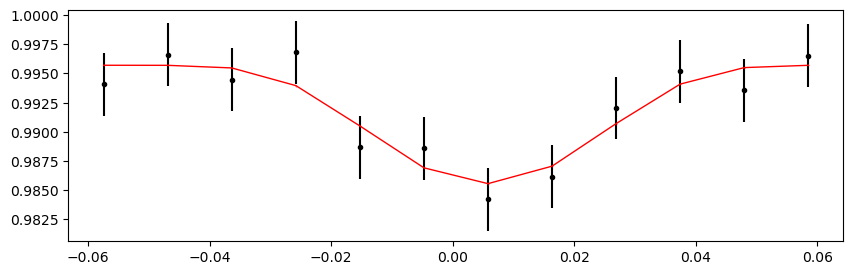

2418.7012188999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 410.42it/s]


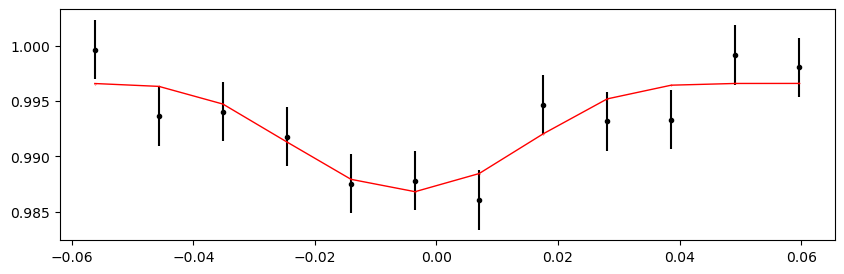

2420.01906862 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.76it/s]


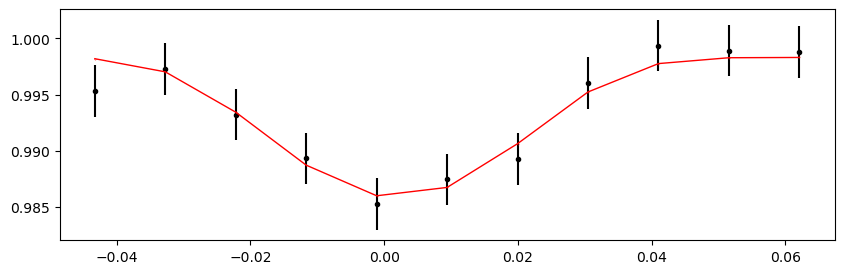

2420.6779934799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 429.97it/s]


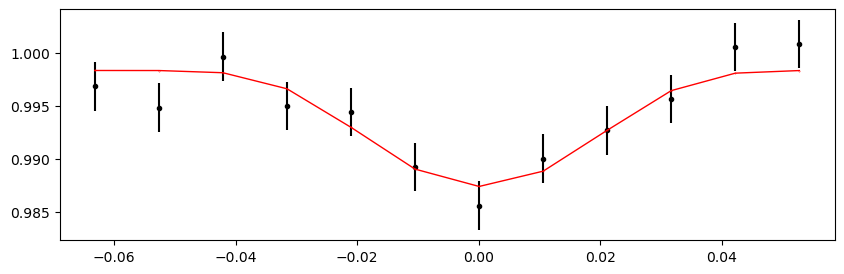

2421.33691834 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 399.63it/s]


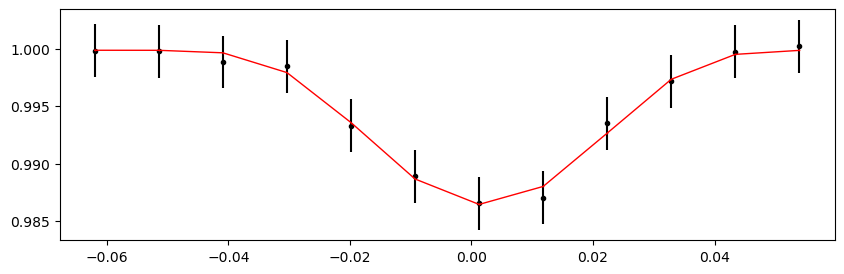

2421.9958432 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.72it/s]


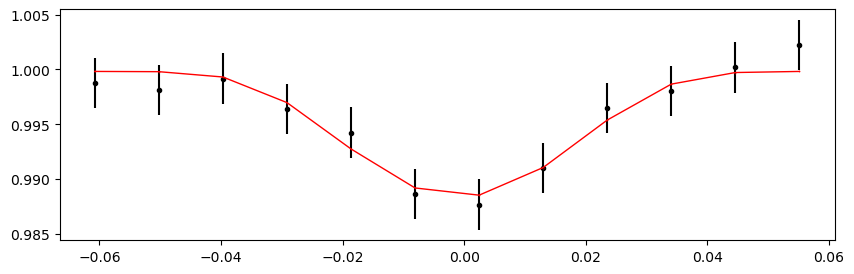

2422.6547680599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.67it/s]


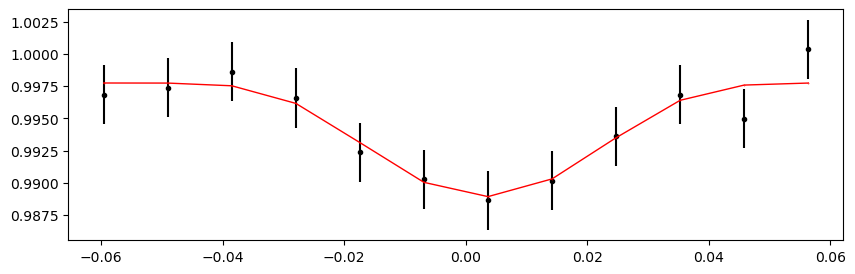

2423.31369292 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.11it/s]


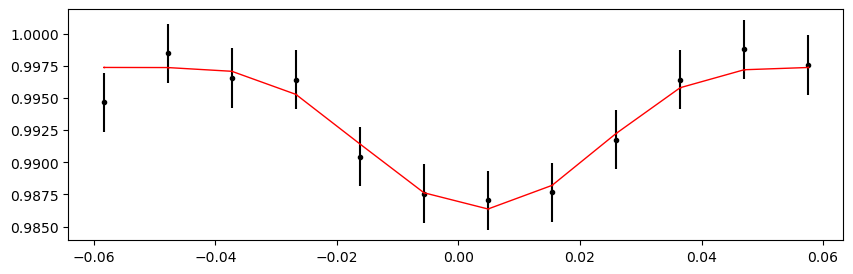

2423.97261778 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 429.70it/s]


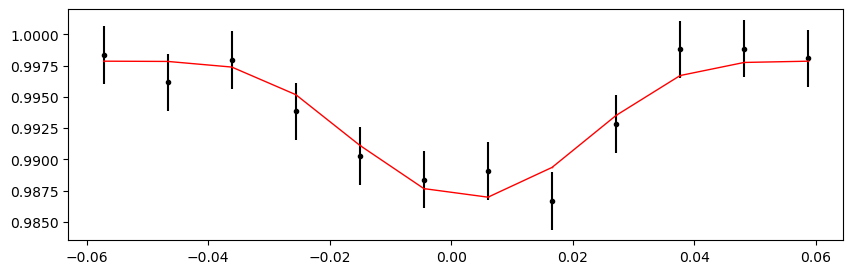

2424.6315426399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.93it/s]


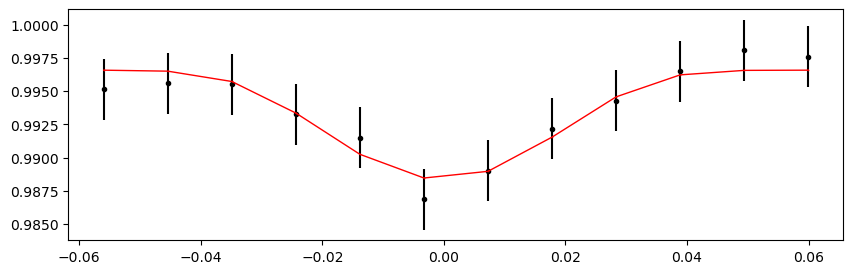

2425.2904675 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.22it/s]


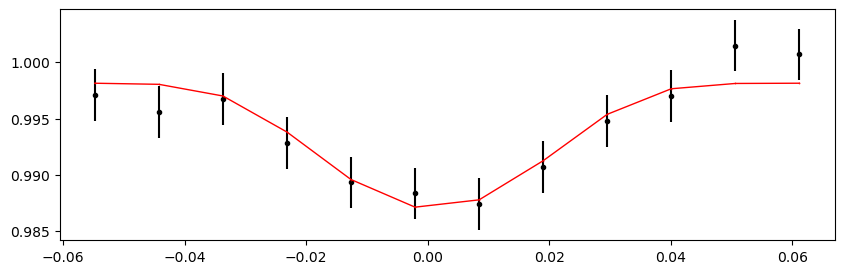

2425.94939236 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.37it/s]


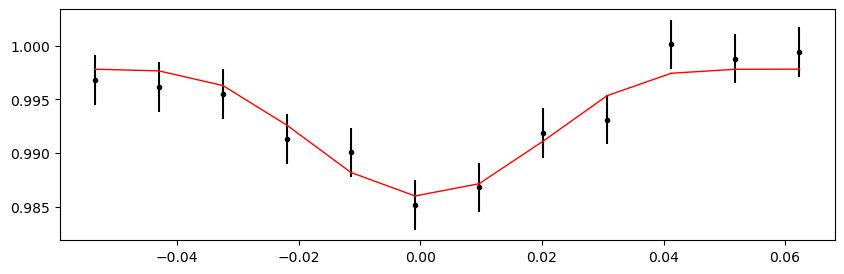

2426.6083172199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.49it/s]


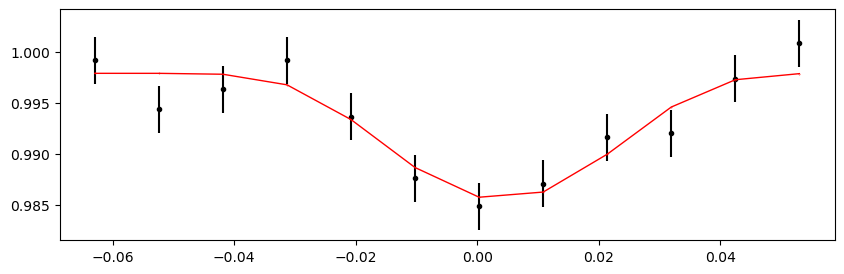

2427.26724208 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.24it/s]


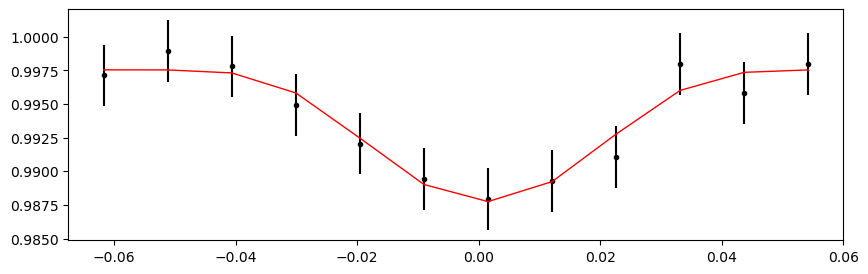

2427.92616694 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.40it/s]


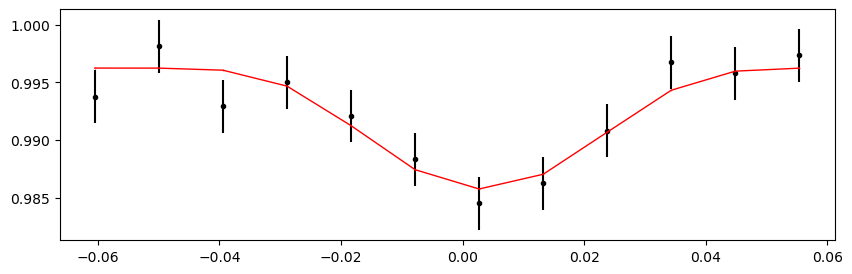

2428.5850918 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.01it/s]


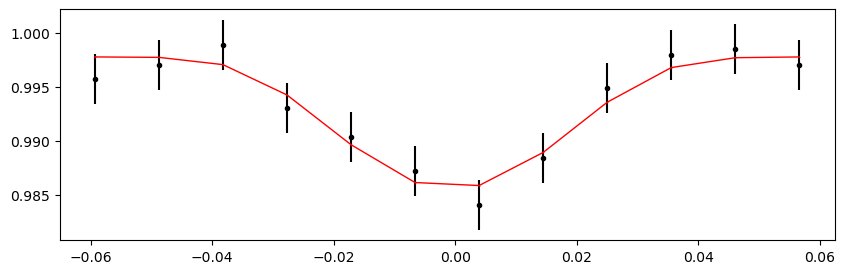

2429.24401666 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.89it/s]


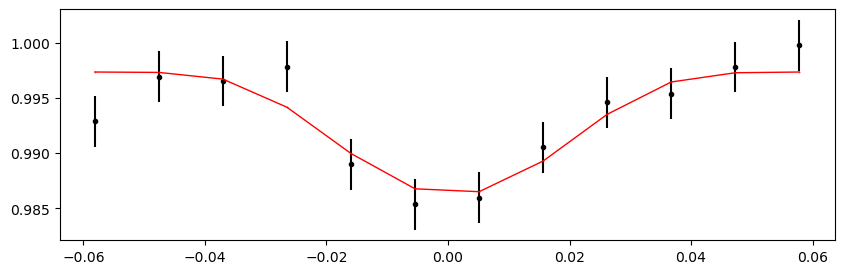

2429.90294152 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.80it/s]


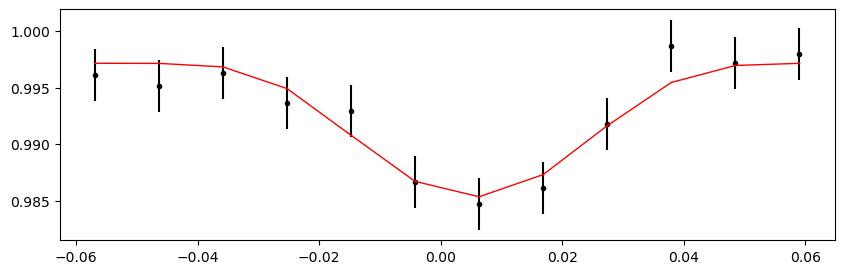

2430.56186638 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.61it/s]


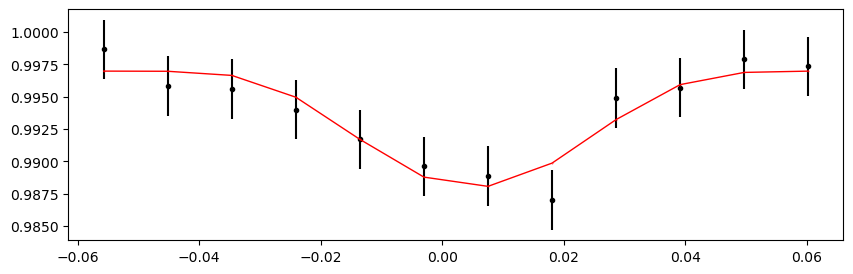

2431.22079124 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.70it/s]


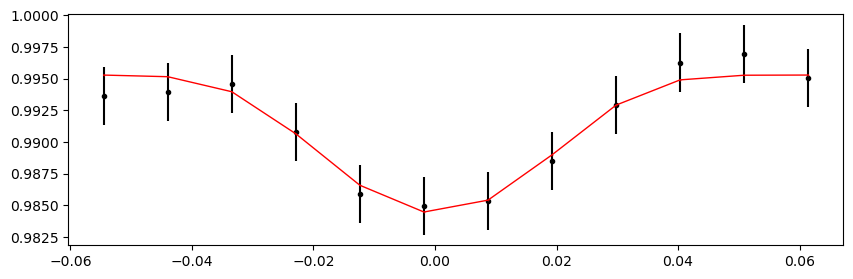

2431.8797160999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.56it/s]


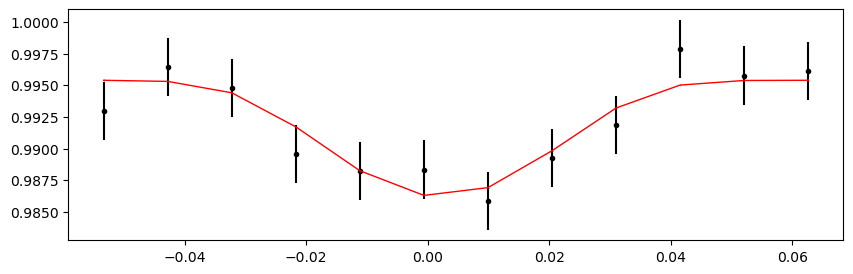

2432.53864096 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.43it/s]


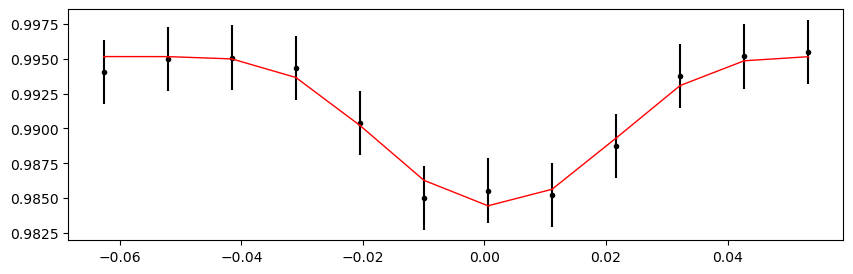

2433.85649068 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.78it/s]


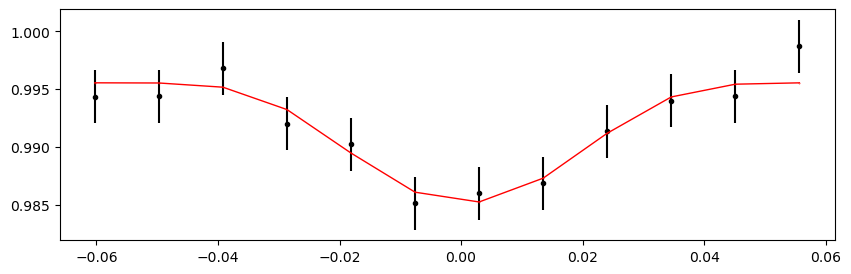

2434.51541554 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.98it/s]


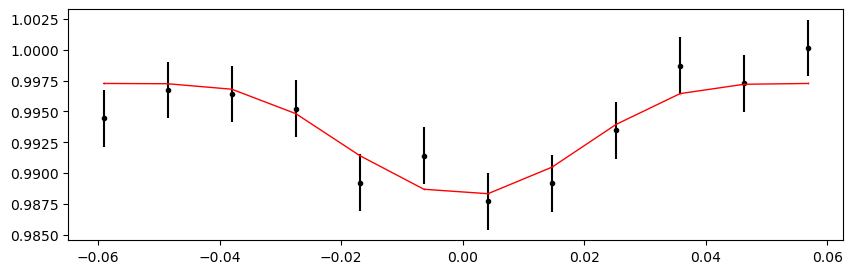

2435.1743404 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.14it/s]


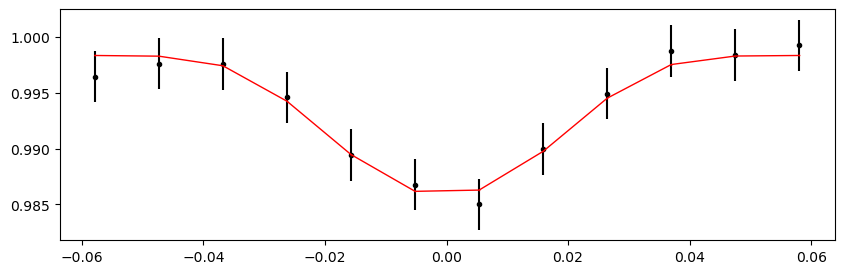

2435.83326526 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.47it/s]


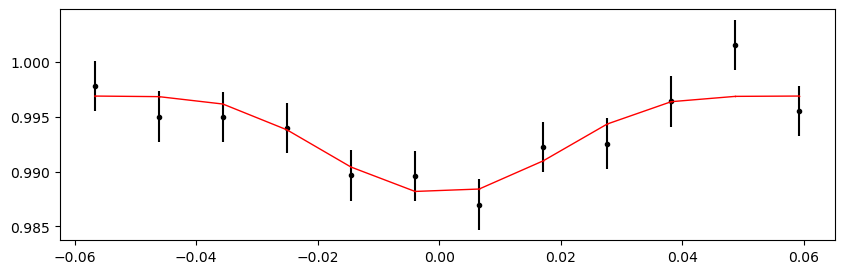

2436.49219012 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.99it/s]


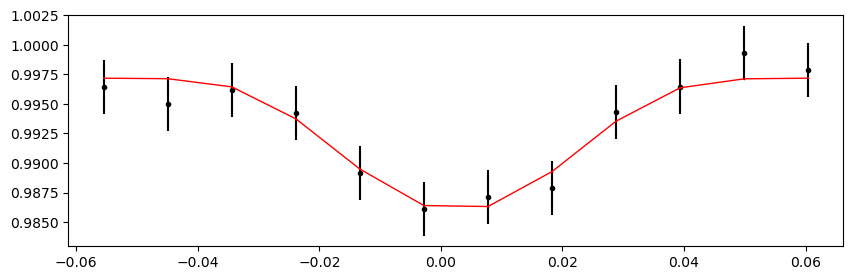

2437.15111498 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.65it/s]


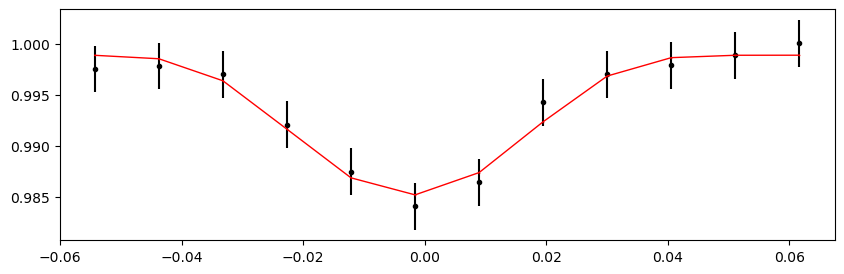

2437.81003984 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.73it/s]


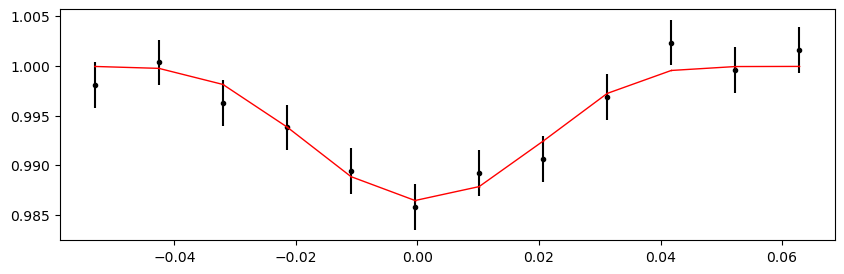

2438.4689647 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.32it/s]


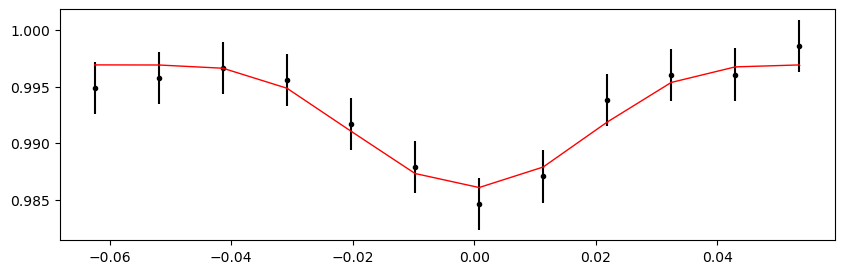

2439.12788956 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.73it/s]


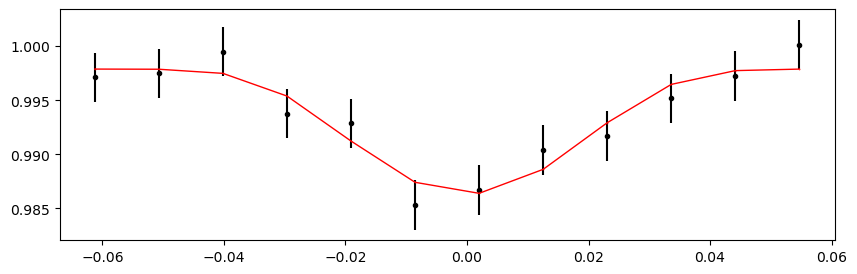

2439.78681442 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.70it/s]


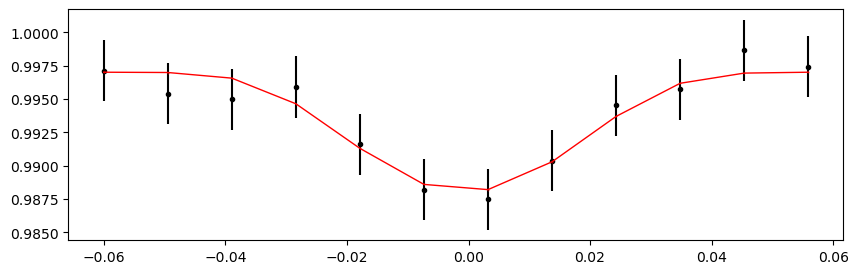

2440.44573928 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.24it/s]


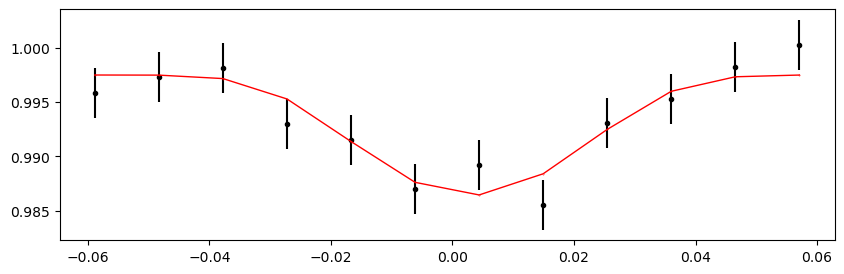

2441.10466414 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.46it/s]


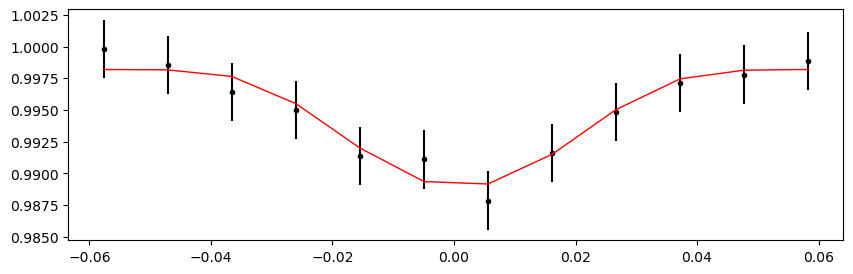

2441.763589 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.76it/s]


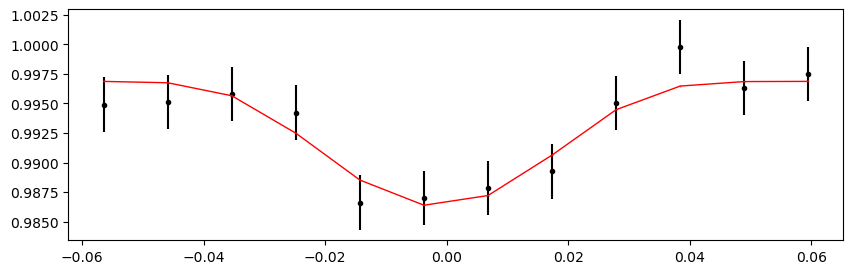

2442.42251386 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.16it/s]


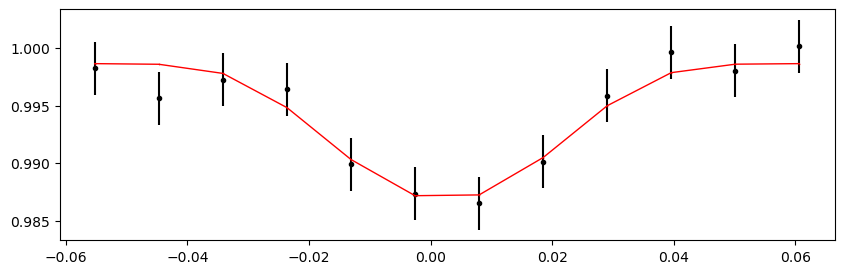

2443.08143872 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.16it/s]


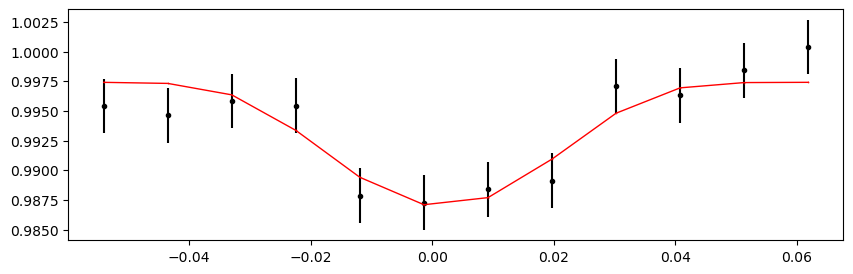

2443.74036358 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.39it/s]


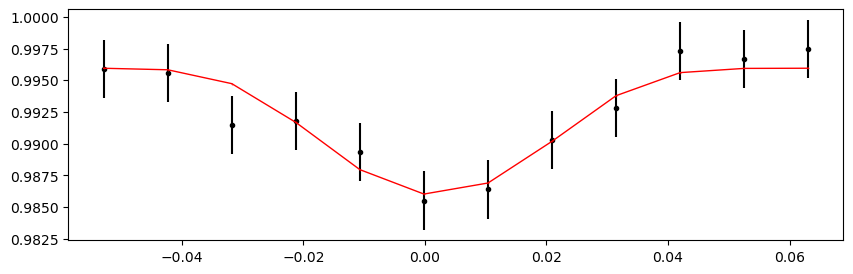

2444.39928844 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.07it/s]


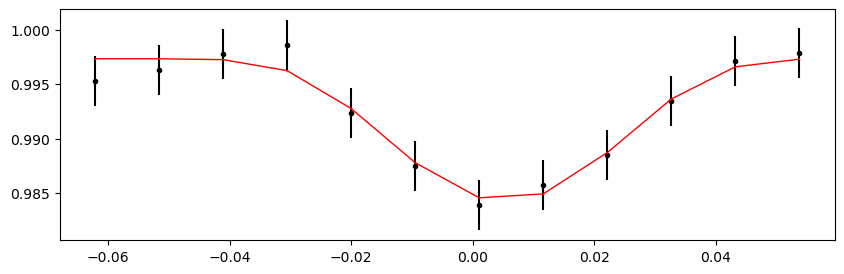

2445.0582133 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.73it/s]


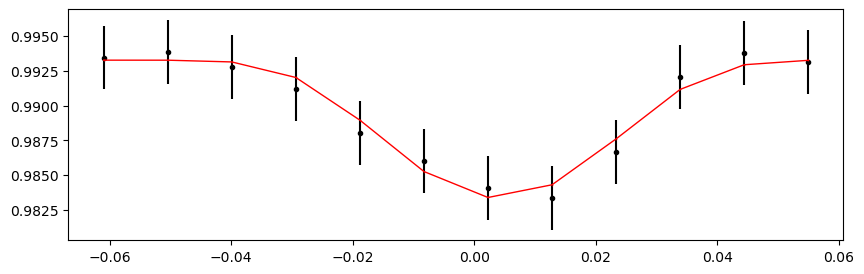

2445.71713816 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.69it/s]


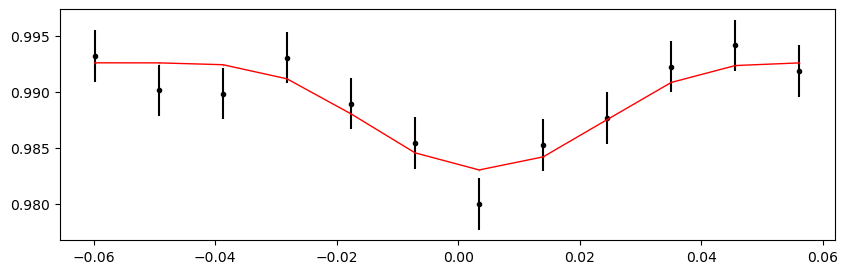

2446.37606302 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.44it/s]


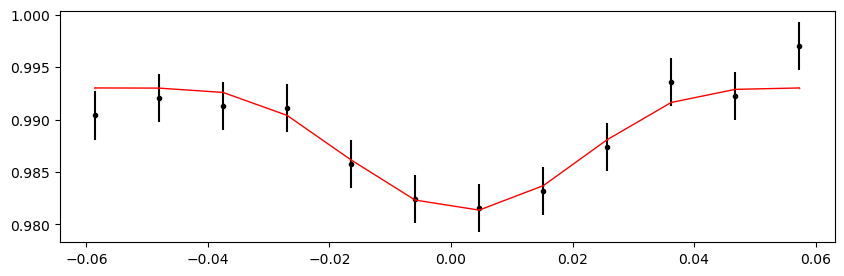

2580.1378096 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.27it/s]


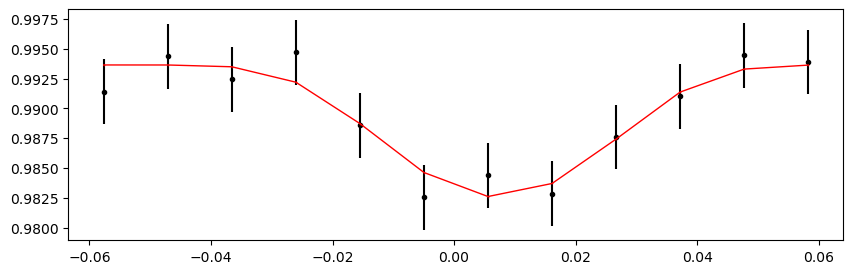

2580.79673446 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.43it/s]


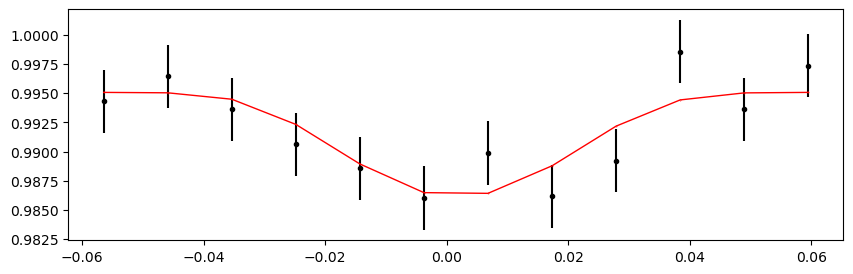

2581.45565932 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 406.71it/s]


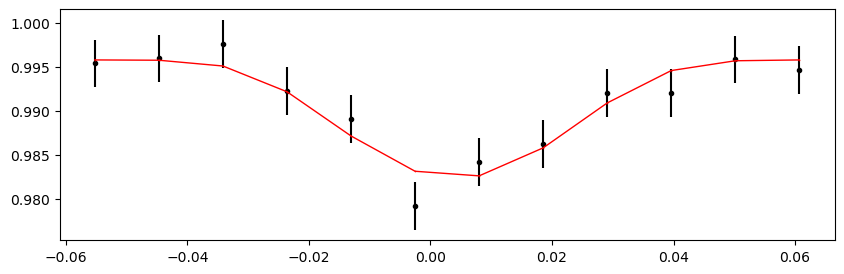

2582.11458418 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 392.16it/s]


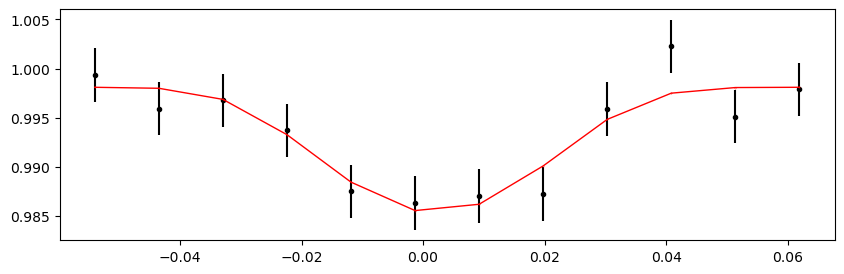

2582.77350904 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.82it/s]


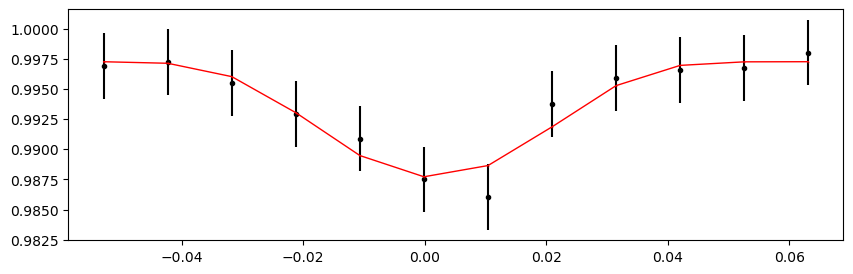

2583.4324339 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.57it/s]


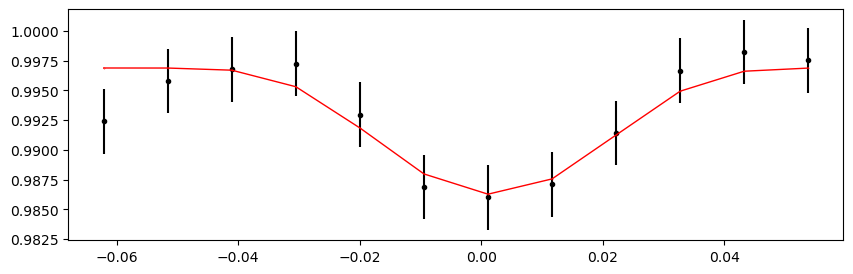

2584.09135876 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.22it/s]


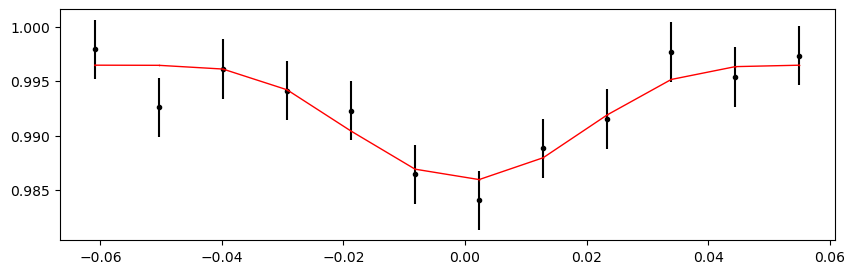

2584.75028362 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.35it/s]


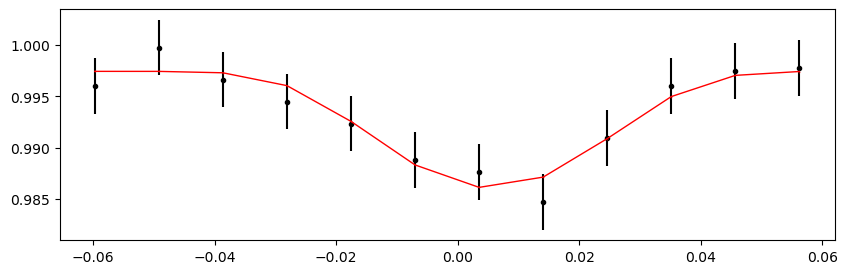

2585.40920848 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.21it/s]


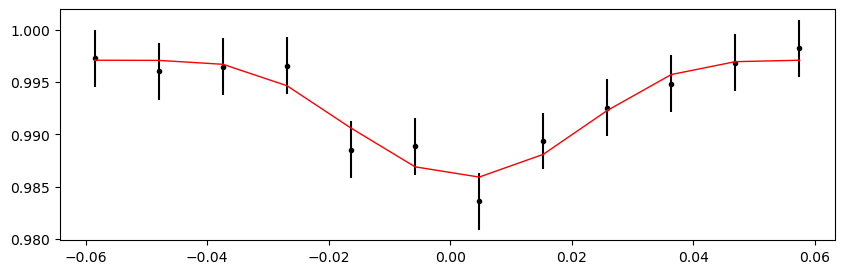

2586.06813334 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.03it/s]


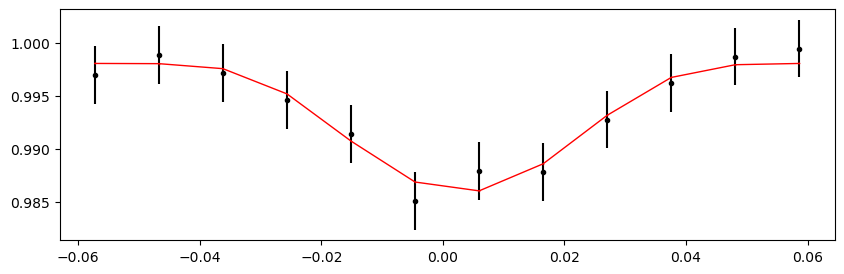

2586.7270582 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.41it/s]


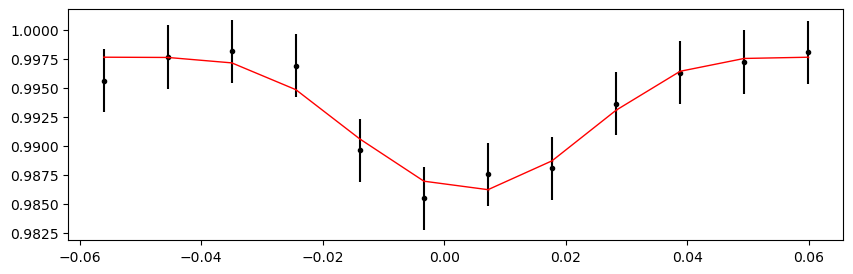

2587.38598306 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.73it/s]


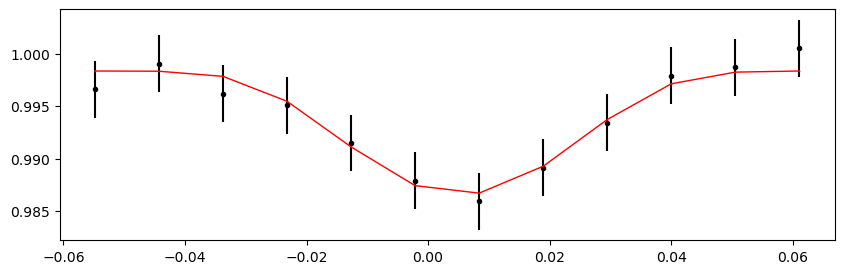

2588.04490792 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.56it/s]


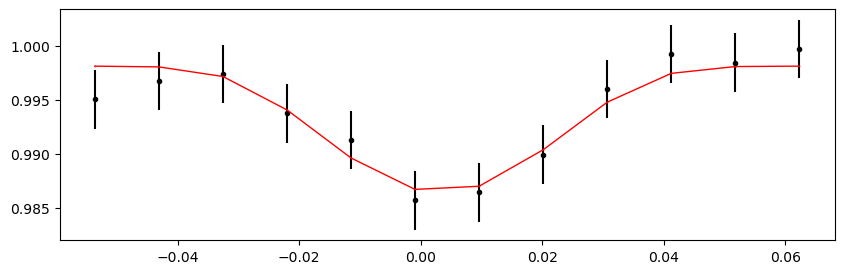

2588.70383278 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.38it/s]


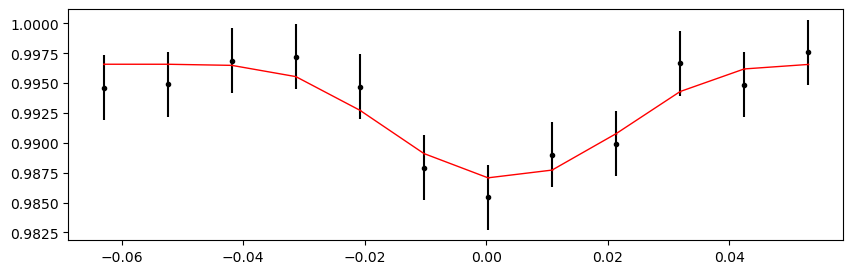

2589.36275764 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.32it/s]


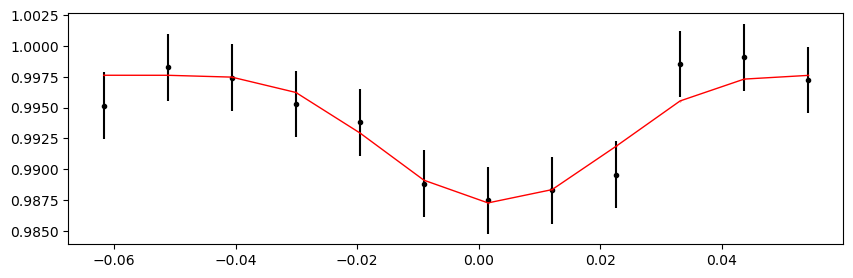

2590.0216824999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.59it/s]


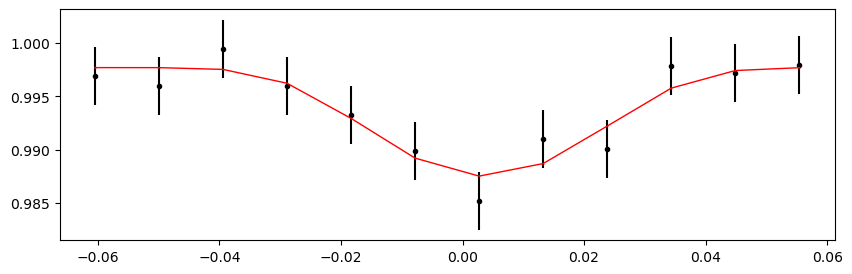

2590.68060736 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.90it/s]


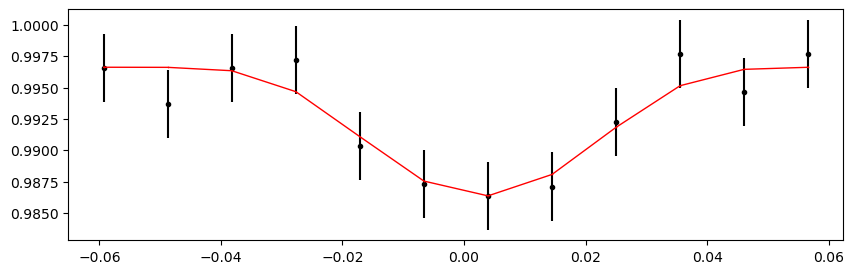

2591.33953222 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.08it/s]


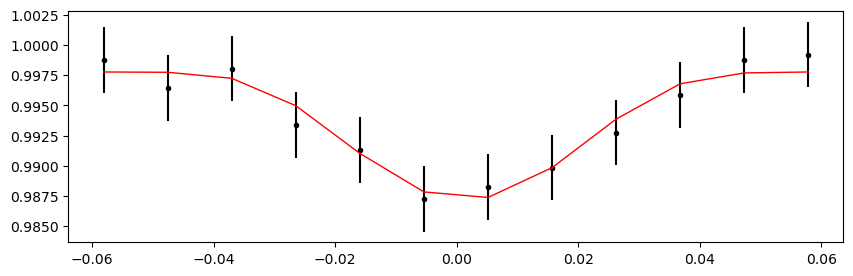

2591.9984570799998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.55it/s]


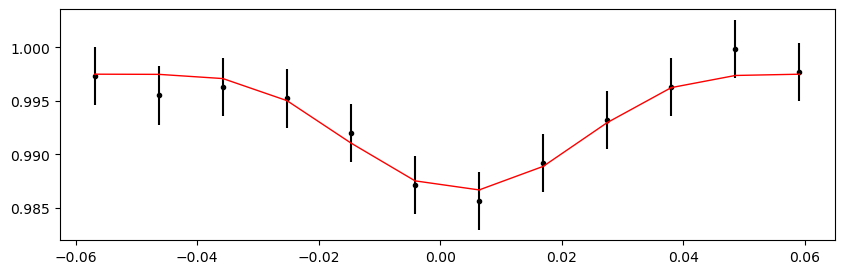

2592.65738194 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.13it/s]


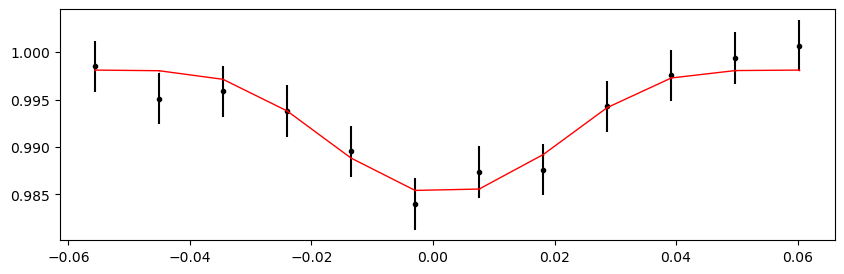

2593.9752316599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.03it/s]


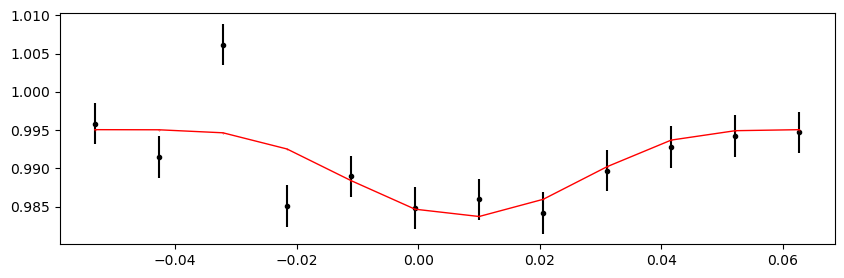

2594.63415652 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.56it/s]


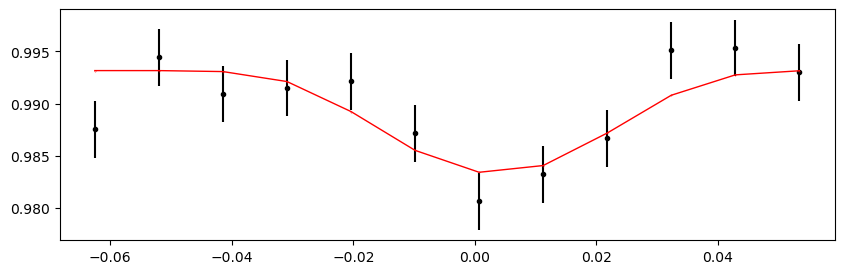

2595.29308138 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.25it/s]


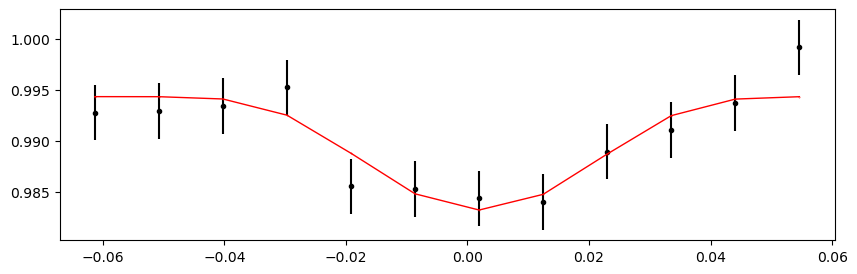

2595.9520062399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.93it/s]


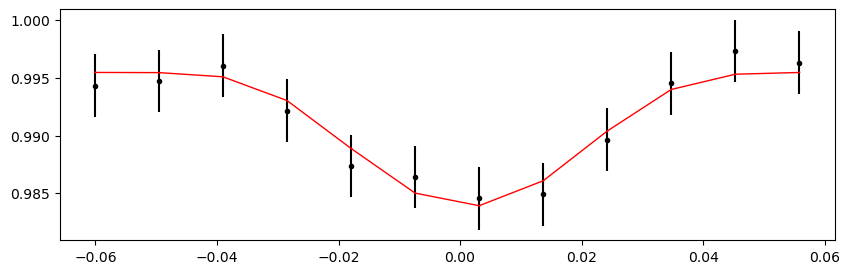

2596.6109311 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.24it/s]


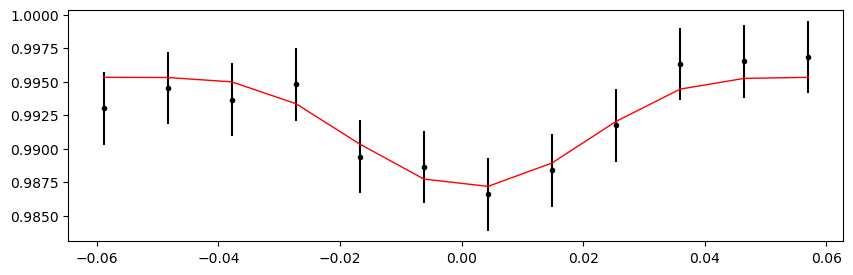

2597.26985596 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.94it/s]


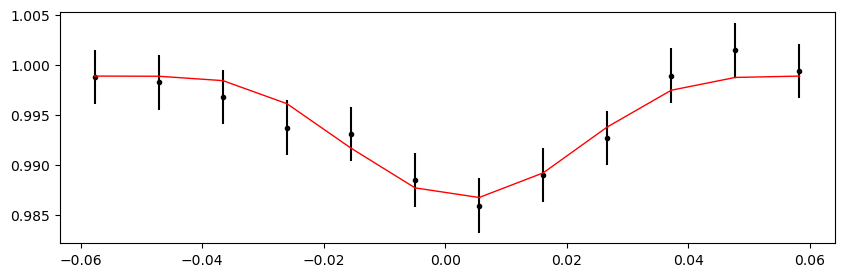

2597.9287808199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.44it/s]


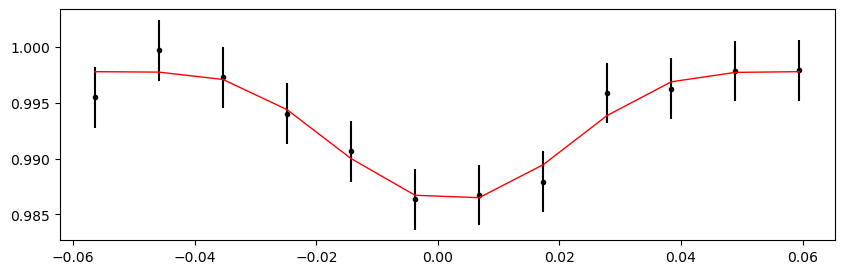

2598.58770568 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.74it/s]


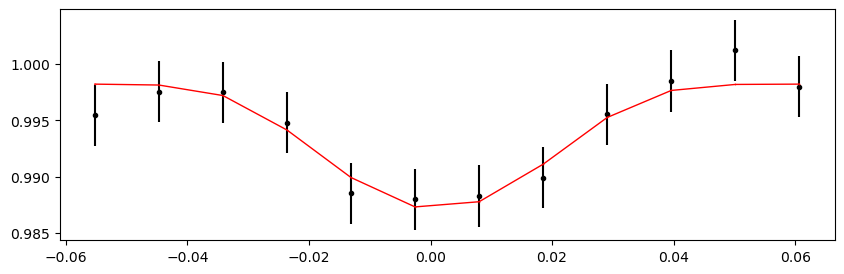

2599.24663054 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.56it/s]


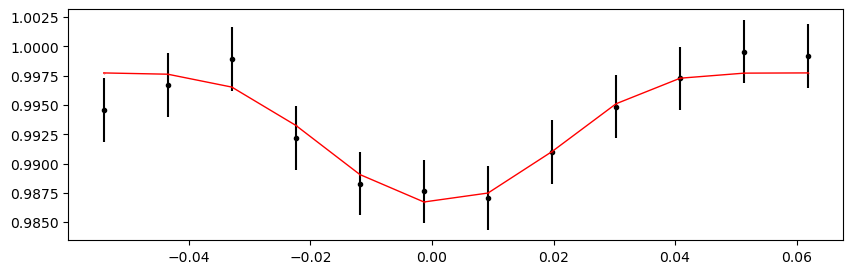

2599.9055553999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.37it/s]


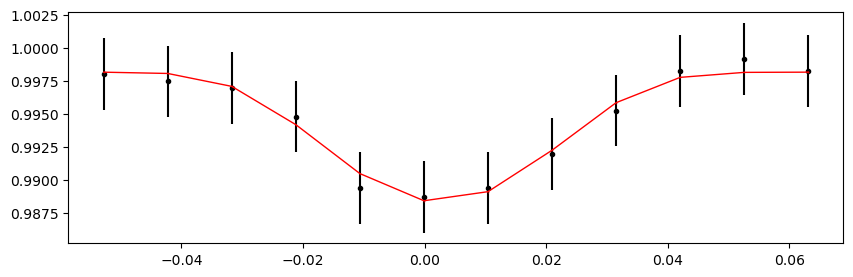

2600.56448026 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.63it/s]


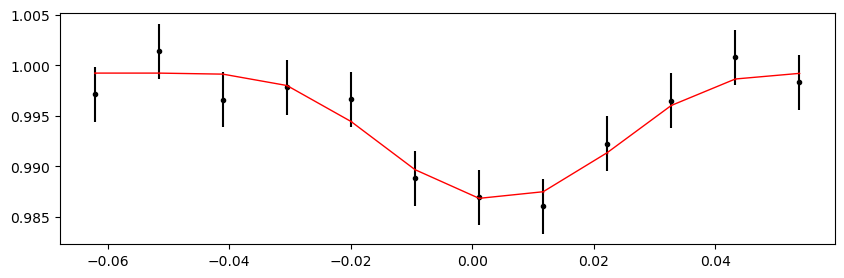

2601.22340512 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.73it/s]


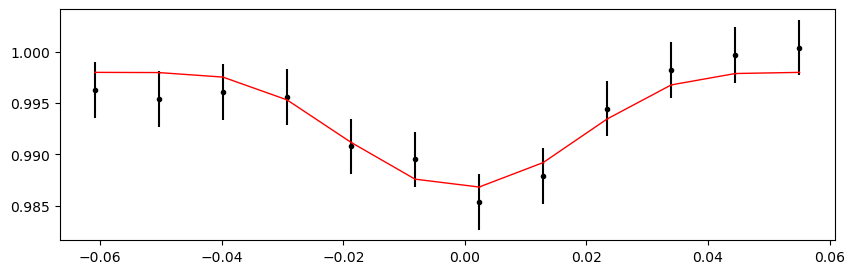

2601.8823299799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.02it/s]


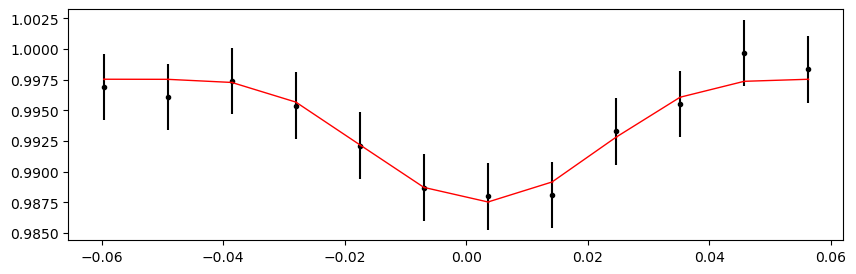

2602.54125484 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.03it/s]


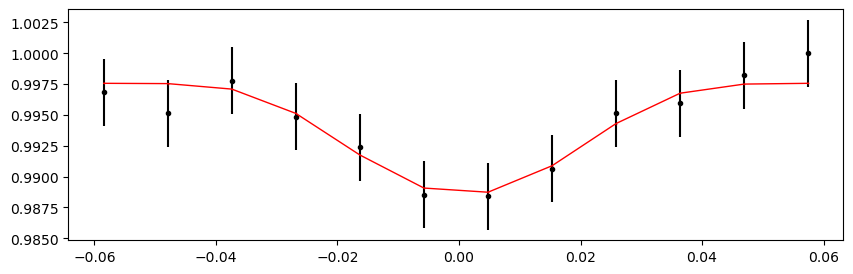

2603.2001797 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.13it/s]


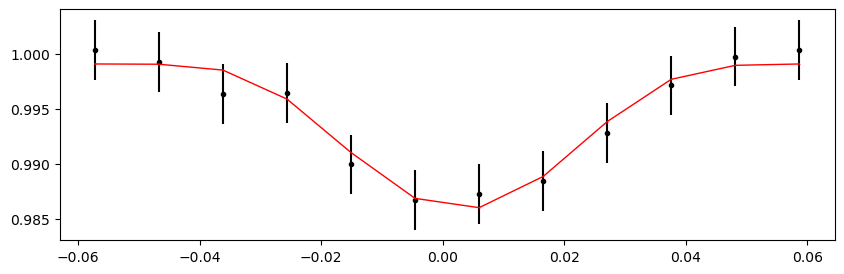

2603.8591045599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.50it/s]


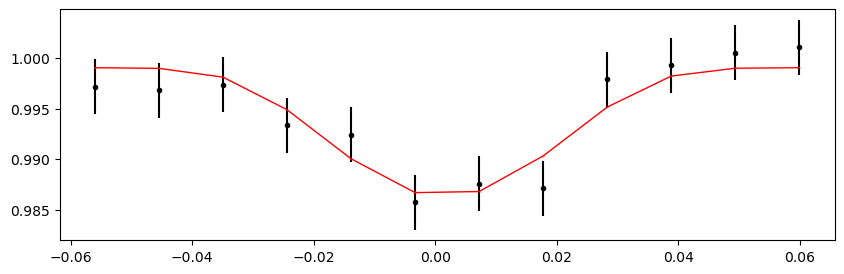

2604.51802942 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.37it/s]


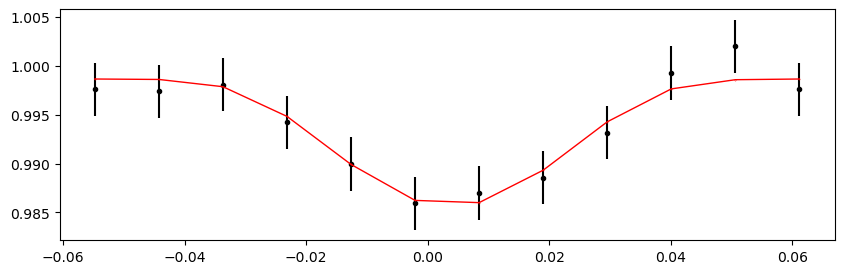

2605.17695428 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.03it/s]


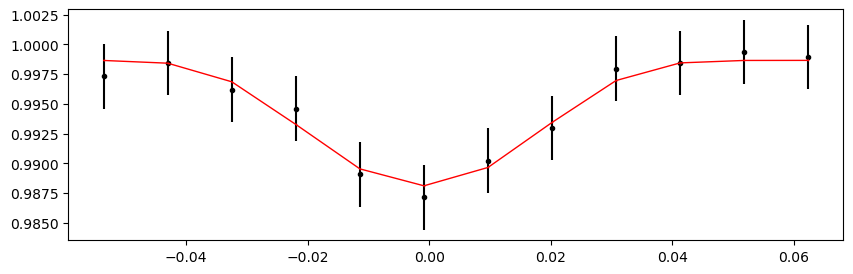

2605.83587914 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.14it/s]


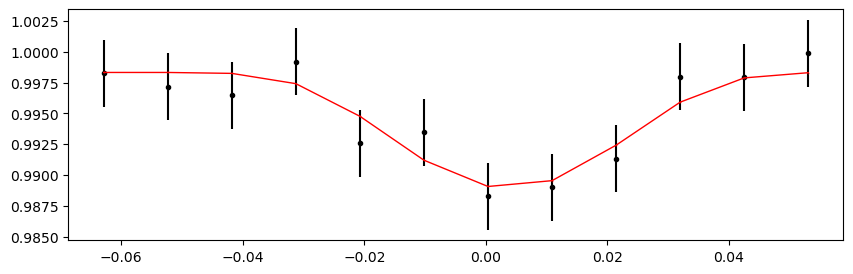

2606.494804 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.35it/s]


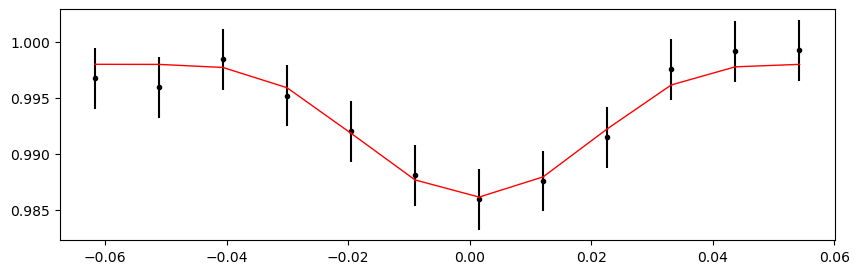

2608.47157858 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.34it/s]


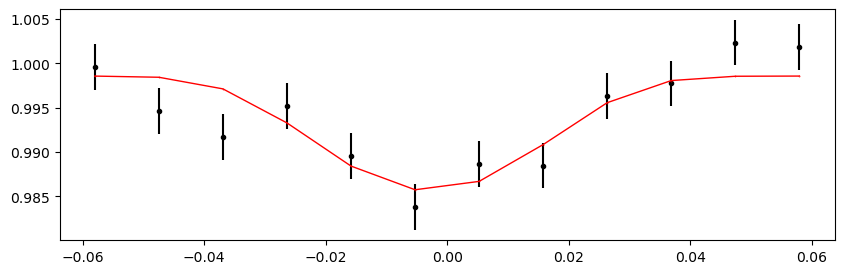

2609.1305034399998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.37it/s]


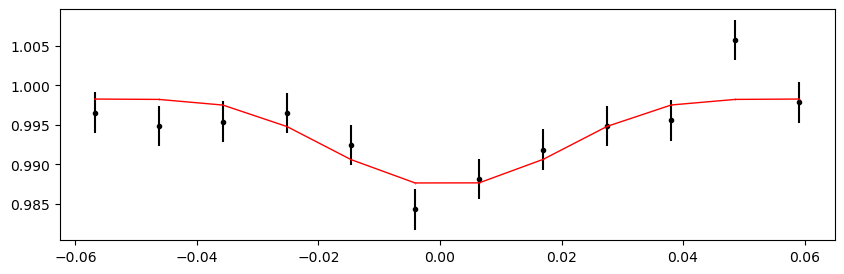

2609.7894283 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.34it/s]


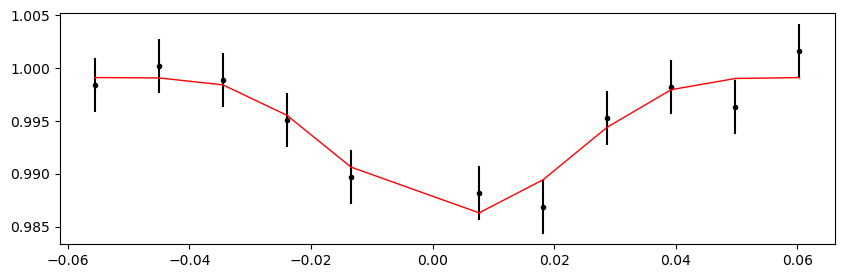

2610.44835316 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.03it/s]


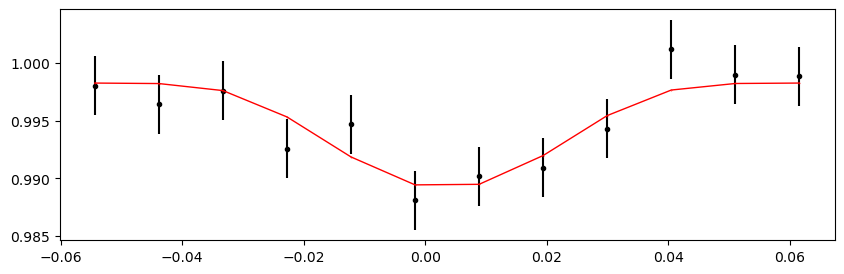

2611.10727802 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.15it/s]


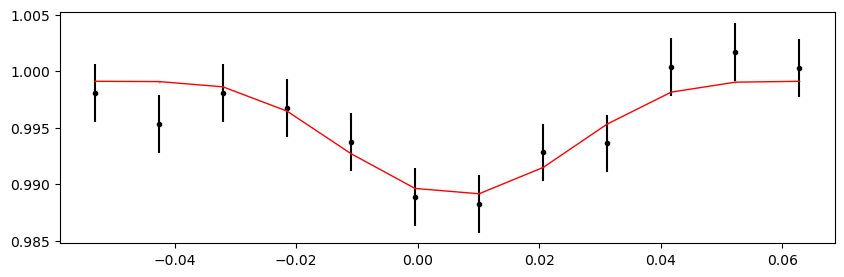

2611.76620288 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.34it/s]


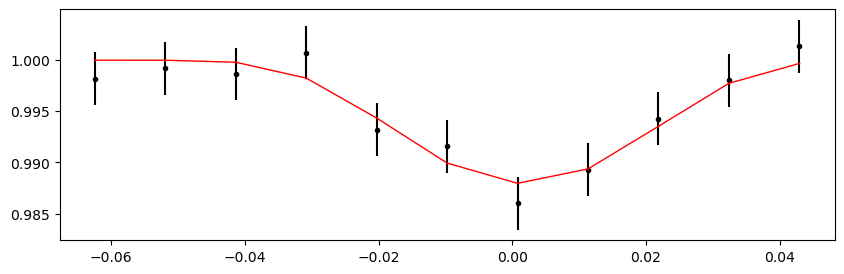

2612.42512774 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.76it/s]


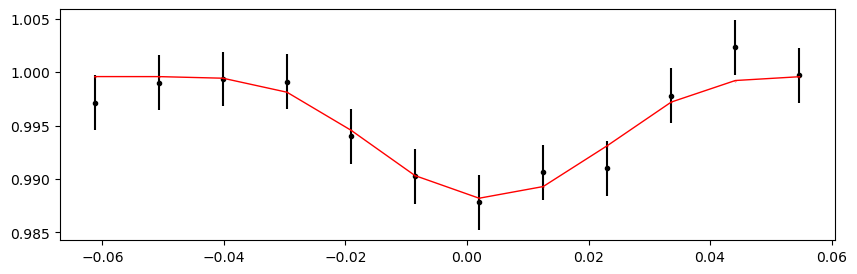

2613.0840526 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.85it/s]


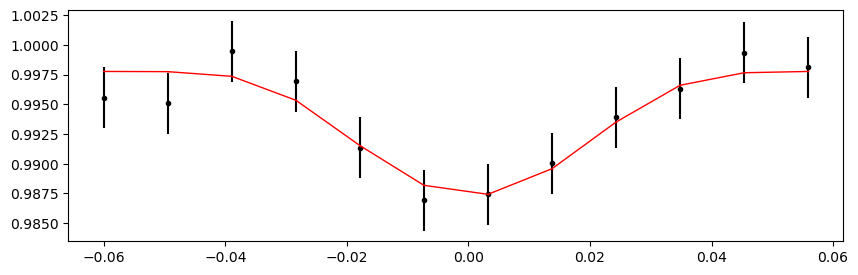

2613.74297746 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.74it/s]


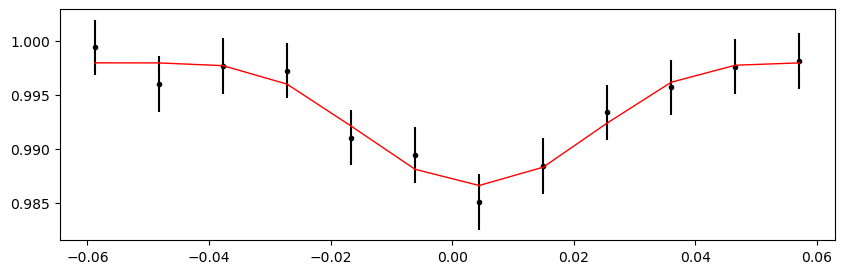

2614.40190232 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 450.66it/s]


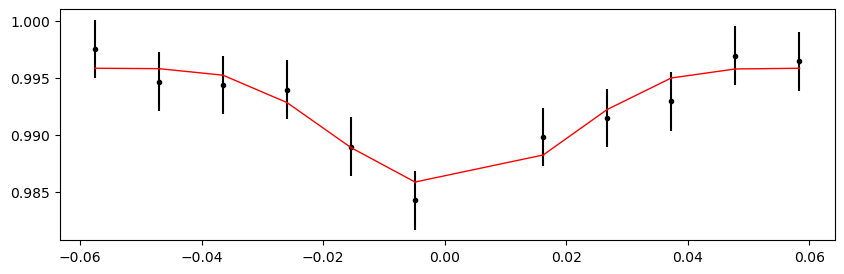

2615.06082718 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.03it/s]


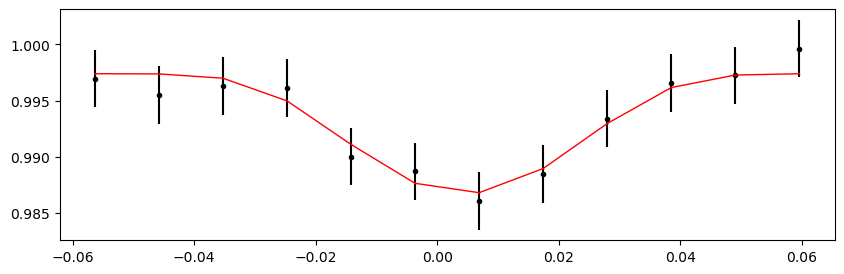

2615.71975204 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.75it/s]


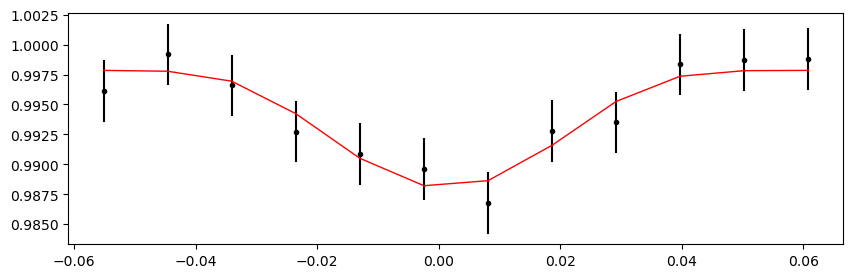

2616.3786769 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.13it/s]


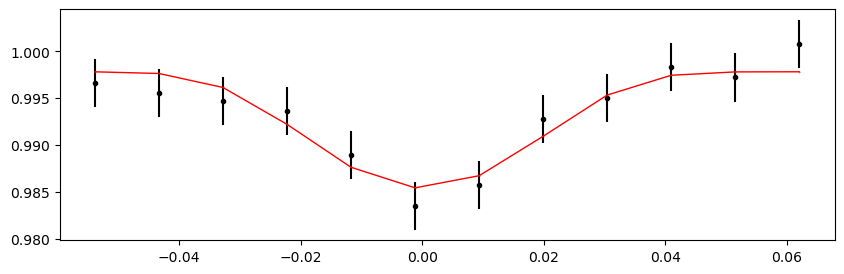

2617.03760176 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.02it/s]


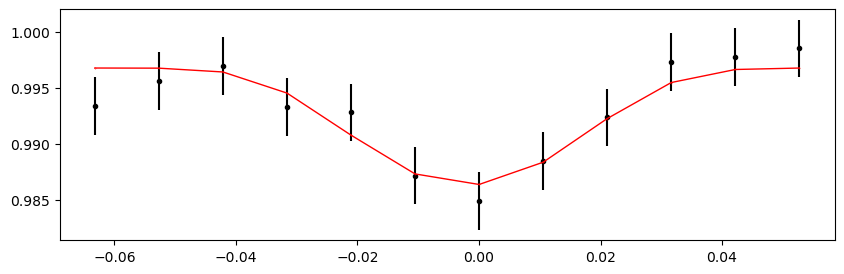

2617.69652662 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.72it/s]


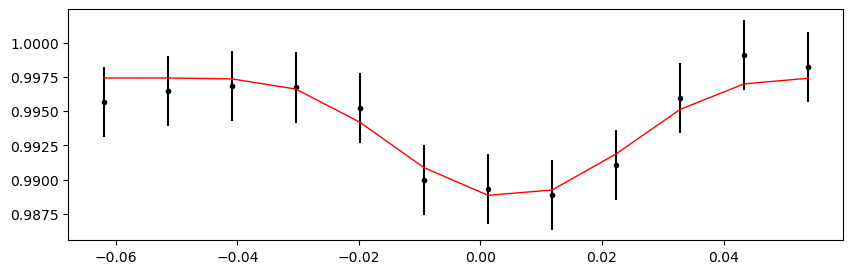

2618.35545148 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.39it/s]


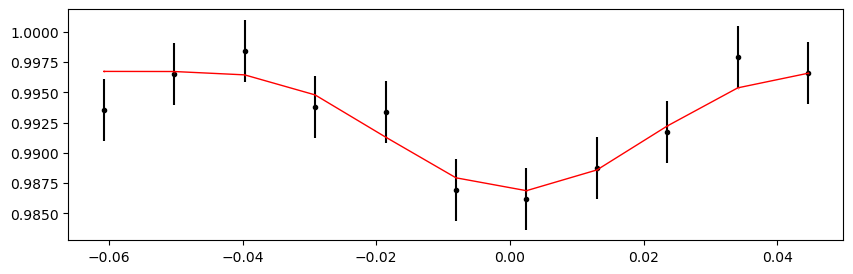

2619.01437634 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.13it/s]


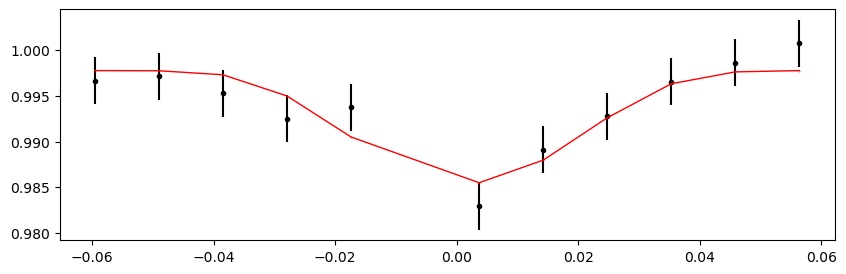

2619.6733012 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.13it/s]


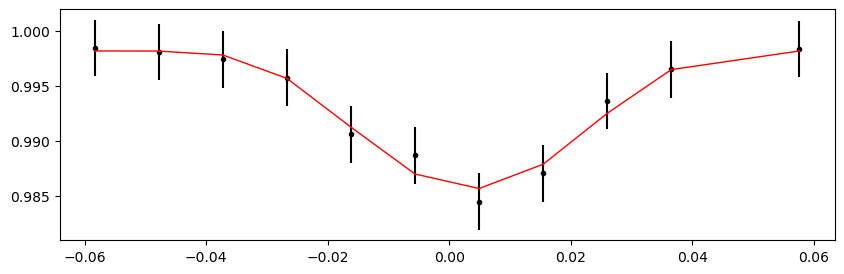

2620.33222606 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.71it/s]


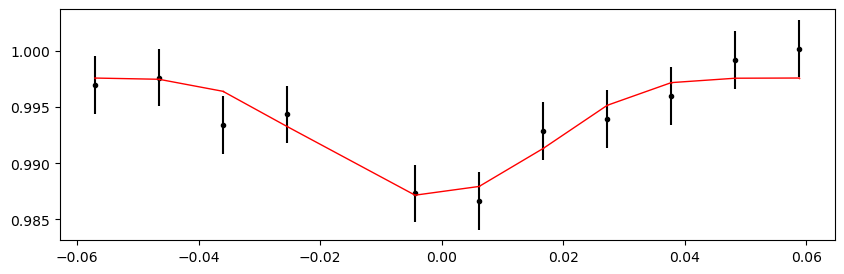

2620.99115092 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.35it/s]


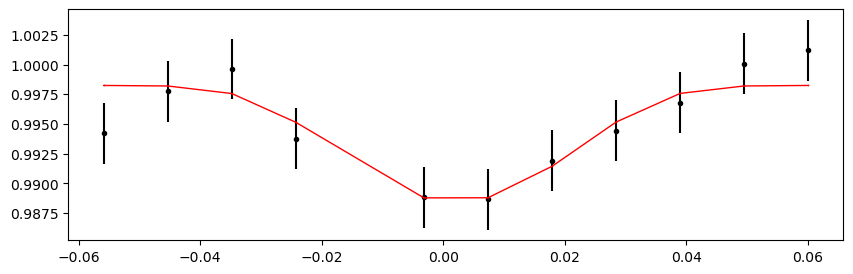

Time 2621.65007578 does not have enough data points: 2
2623.62685036 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.23it/s]


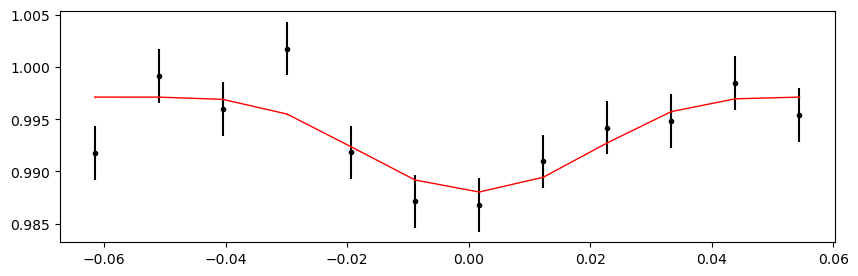

2624.28577522 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.71it/s]


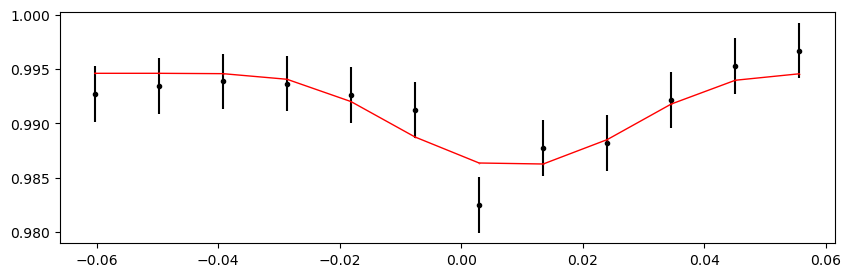

2624.94470008 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.45it/s]


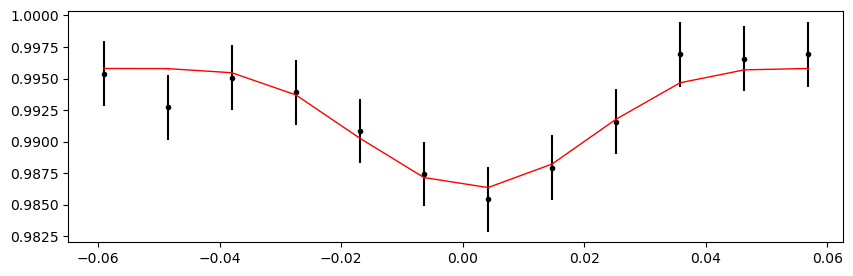

2625.60362494 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.61it/s]


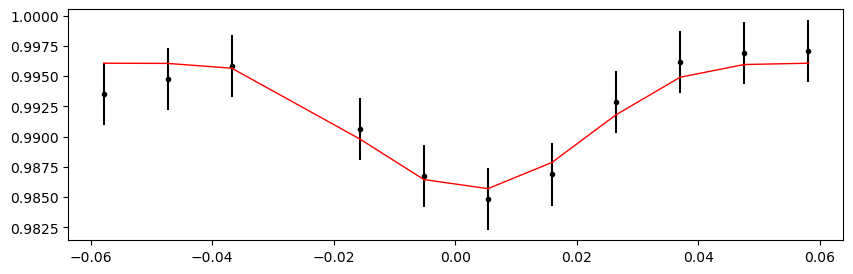

2626.2625497999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.34it/s]


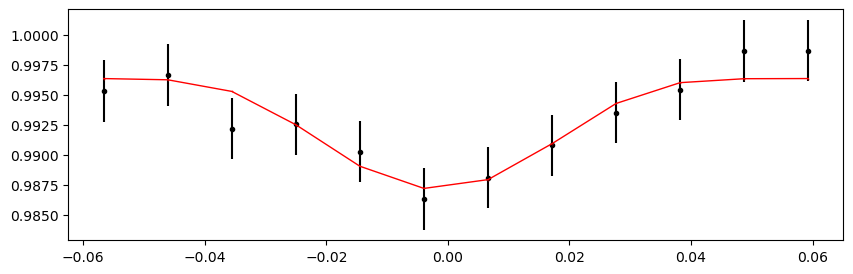

2626.92147466 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.51it/s]


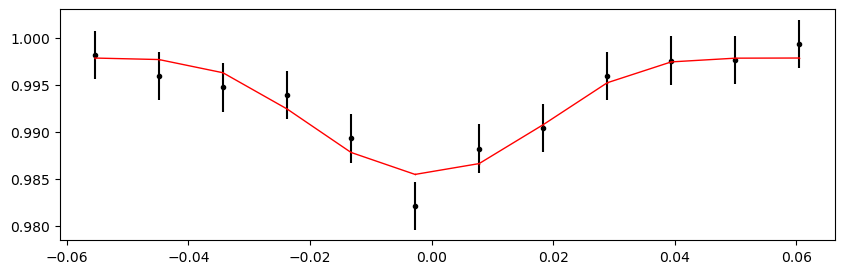

2627.58039952 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 429.83it/s]


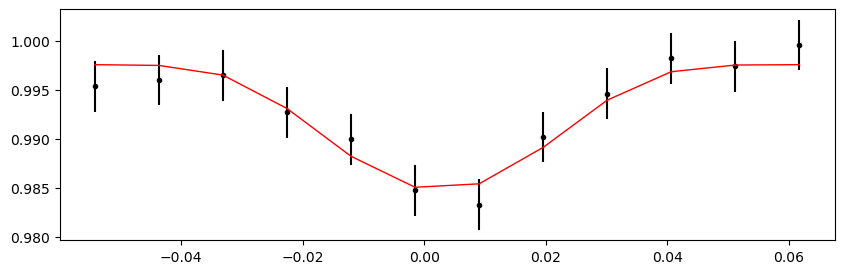

2628.2393243799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.19it/s]


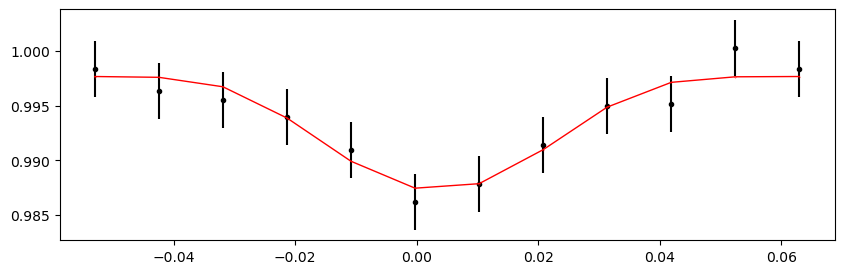

2628.89824924 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.25it/s]


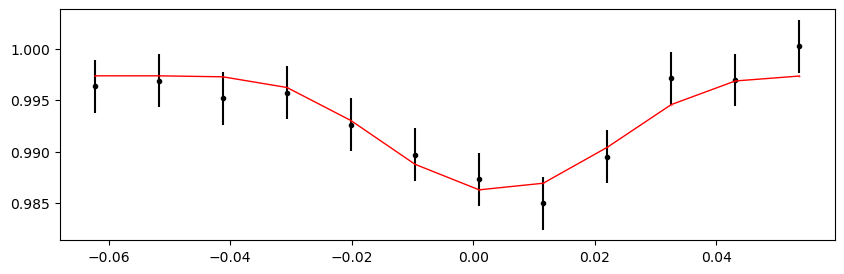

2629.5571741 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.91it/s]


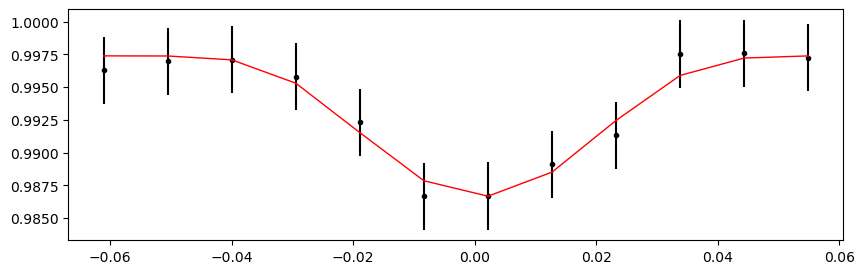

2630.2160989599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.46it/s]


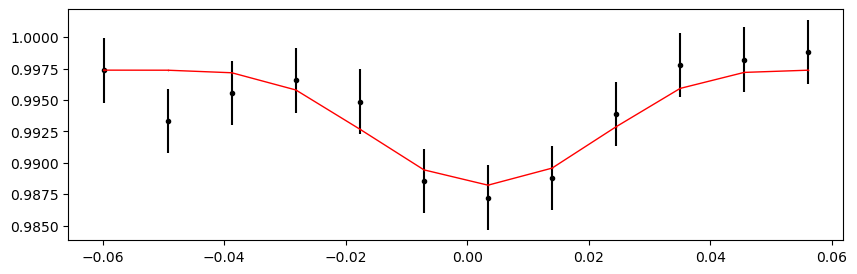

2630.87502382 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.82it/s]


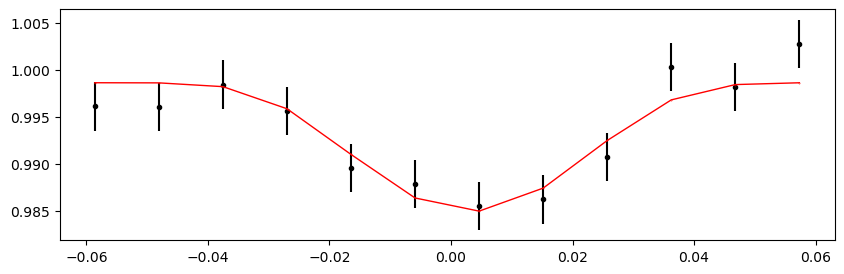

2631.53394868 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.33it/s]


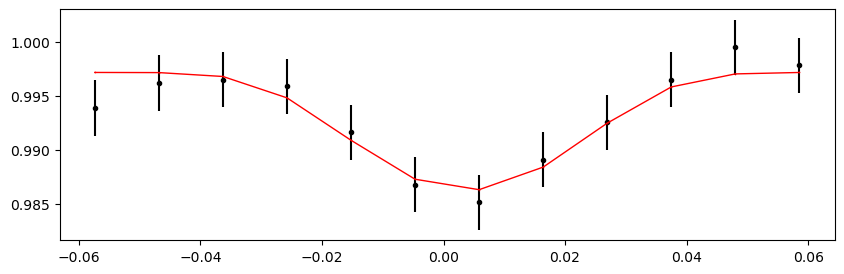

2632.1928735399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.65it/s]


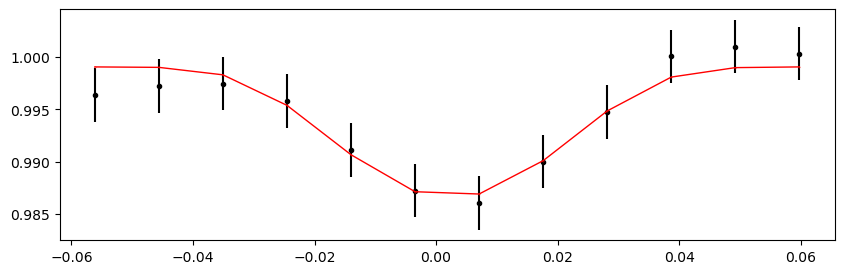

2632.8517984 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.13it/s]


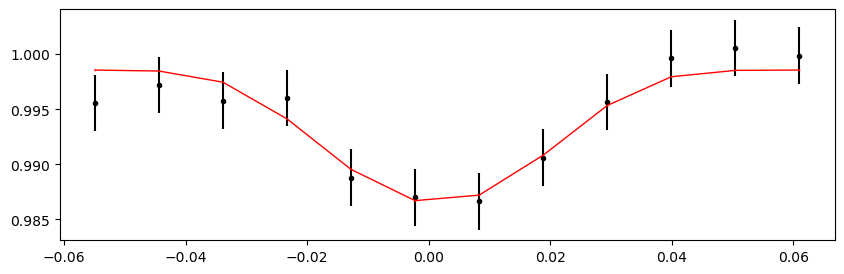

2633.51072326 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.90it/s]


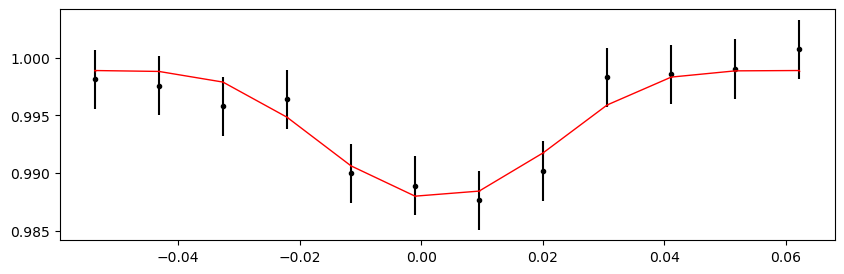

2634.1696481199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 501.82it/s]


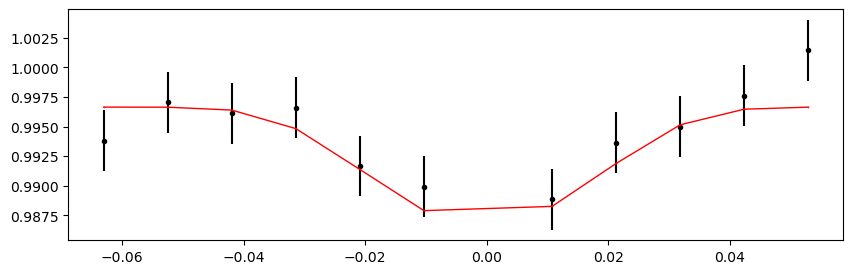

2634.82857298 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.87it/s]


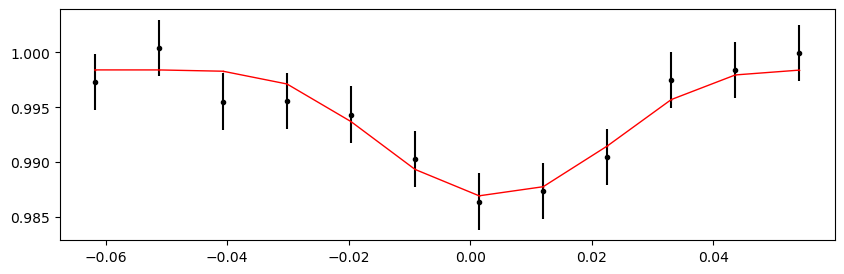

2635.48749784 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.23it/s]


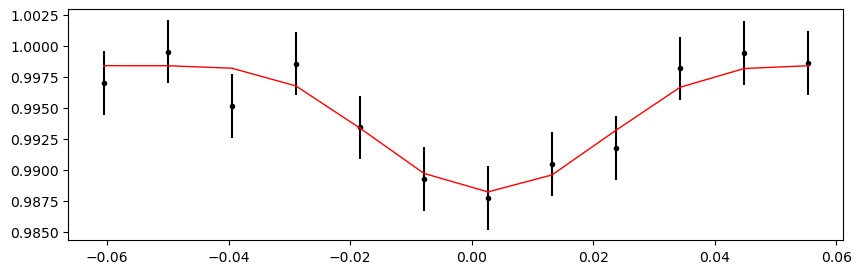

Time 2637.46427242 does not have enough data points: 5
2638.1231972799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.63it/s]


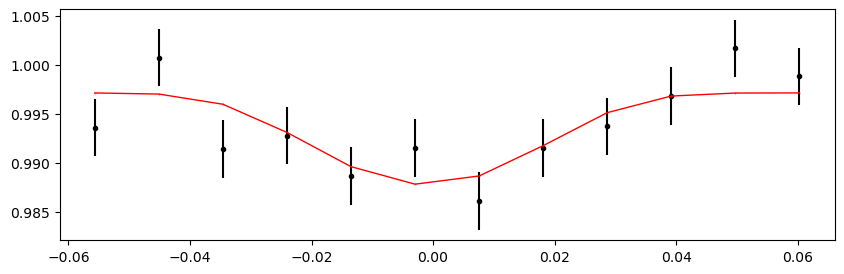

2638.78212214 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 520.18it/s]


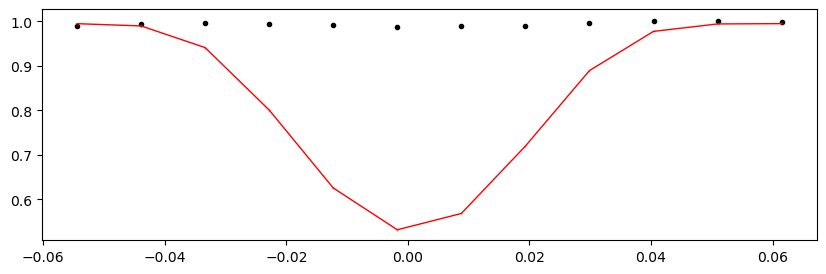

2639.441047 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.78it/s]


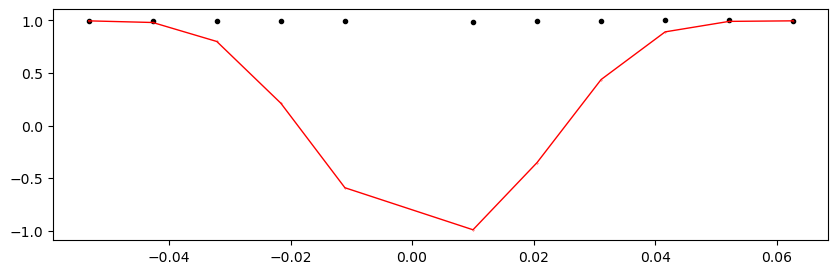

2640.0999718599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.03it/s]


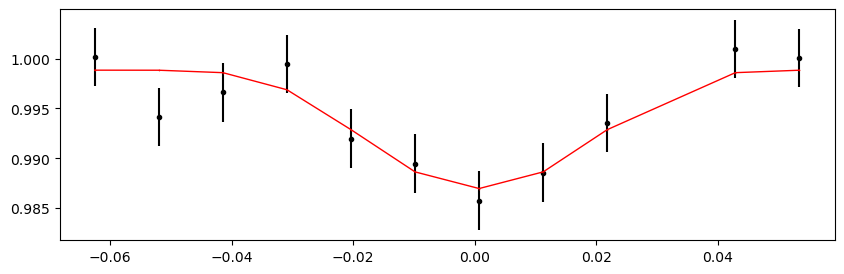

2640.75889672 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.26it/s]


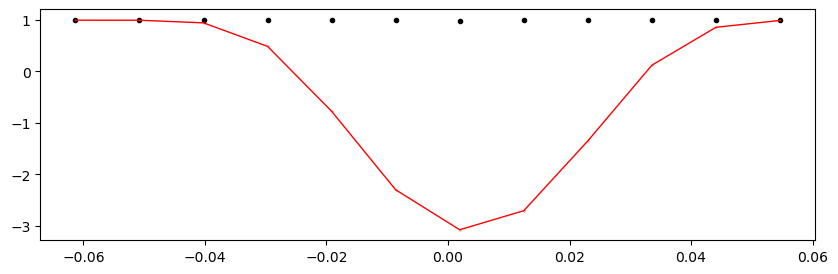

Time 2641.41782158 does not have enough data points: 10
Time 2642.07674644 does not have enough data points: 10
2642.7356713 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.32it/s]


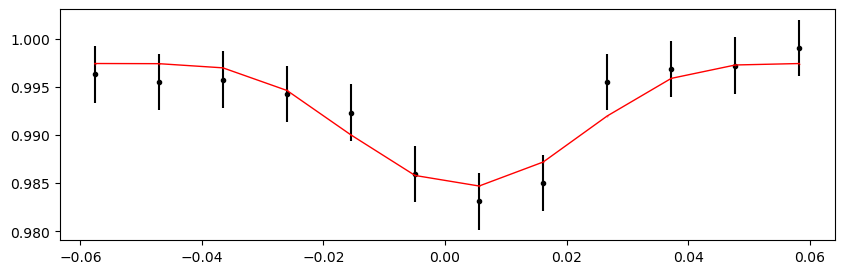

2643.3945961599998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.47it/s]


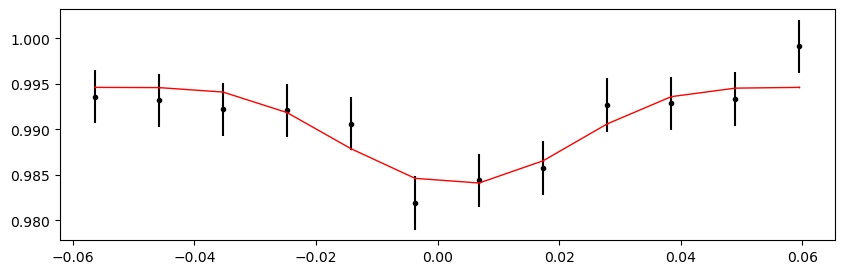

2644.05352102 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.51it/s]


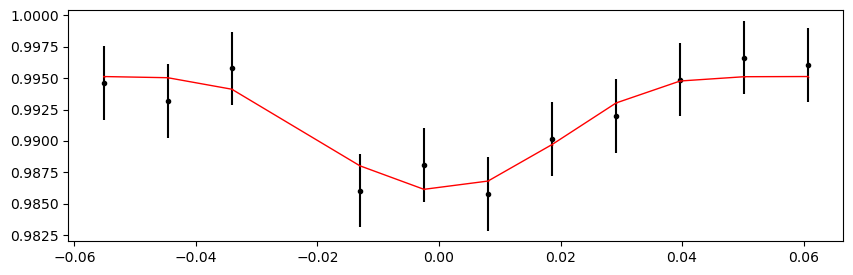

2644.71244588 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.64it/s]


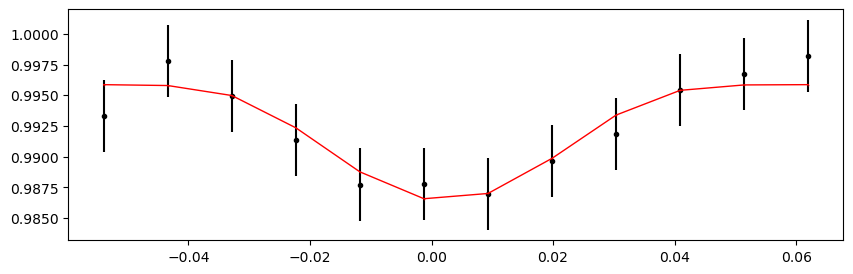

2645.37137074 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.37it/s]


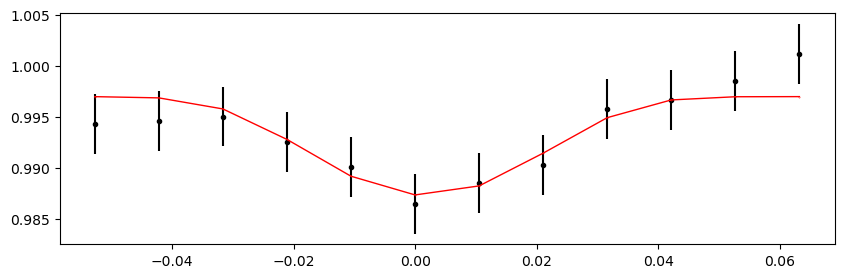

2646.0302956 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.64it/s]


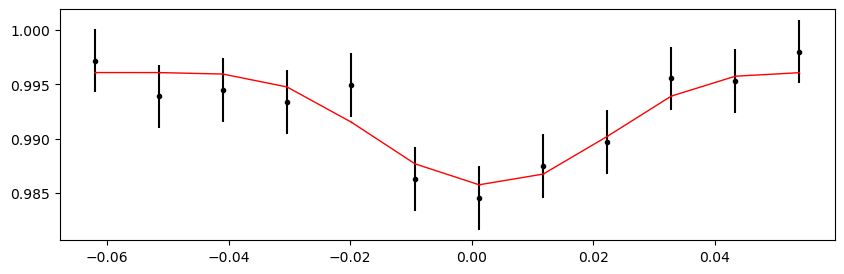

2646.68922046 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.41it/s]


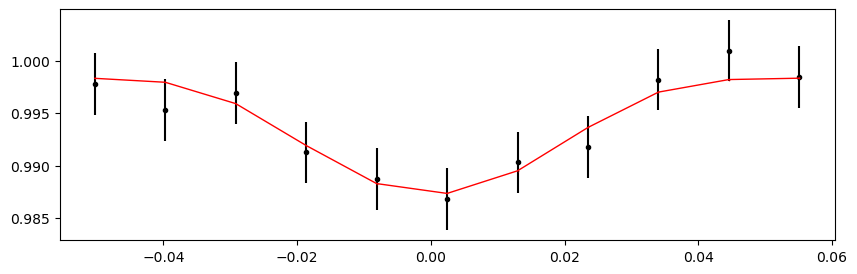

2647.34814532 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.37it/s]


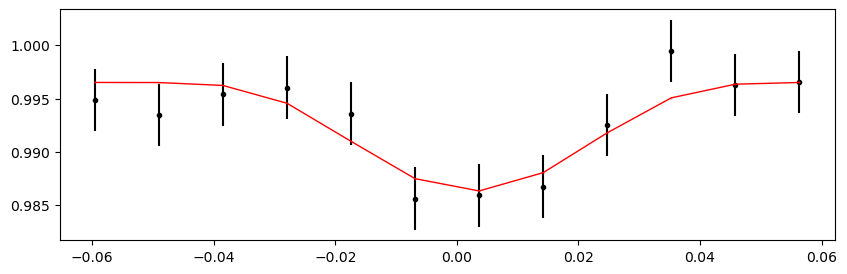

2648.00707018 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.98it/s]


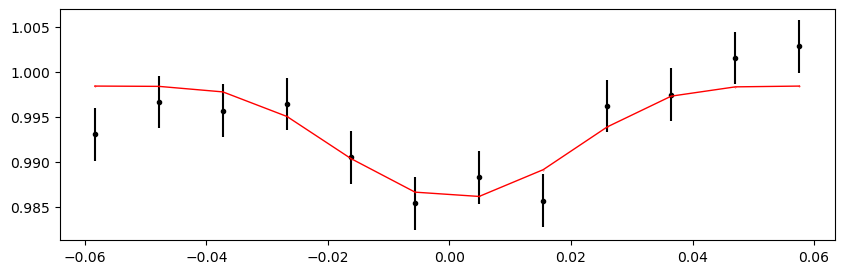

2648.66599504 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.65it/s]


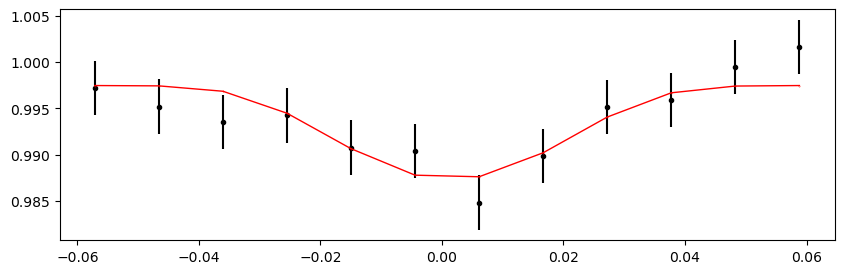

2649.3249199 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.84it/s]


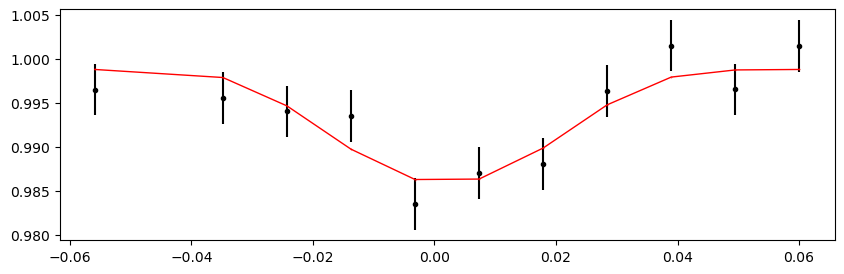

2649.98384476 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.61it/s]


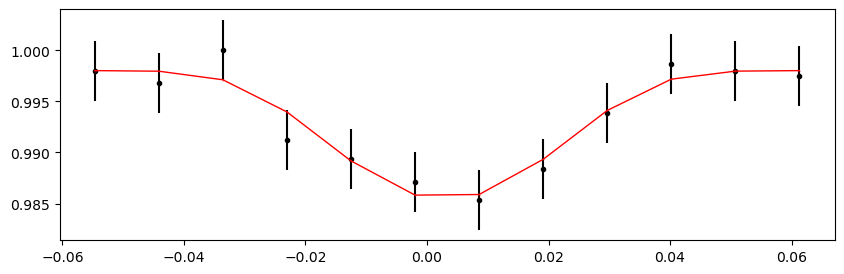

2651.96061934 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.36it/s]


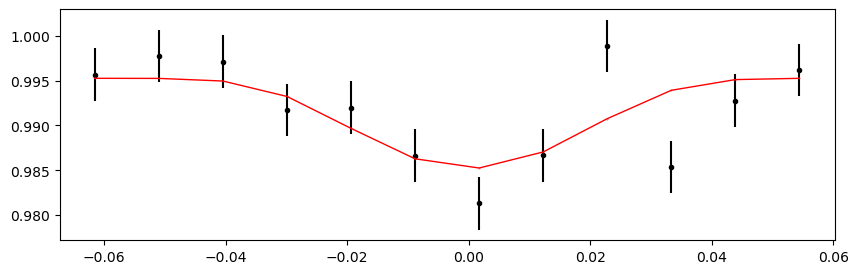

2652.6195442 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.27it/s]


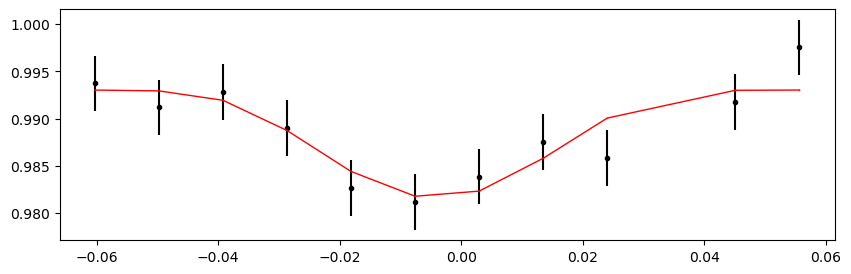

2653.27846906 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 451.78it/s]


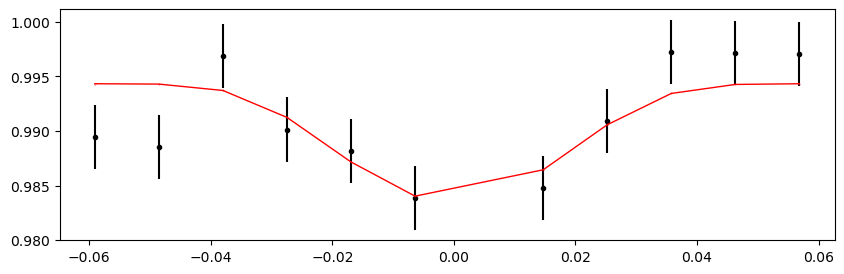

2653.93739392 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.09it/s]


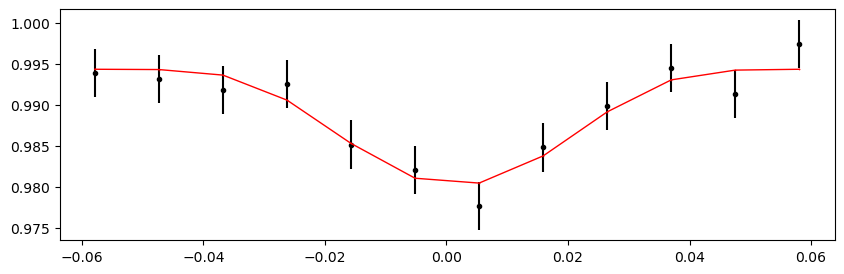

2654.59631878 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.47it/s]


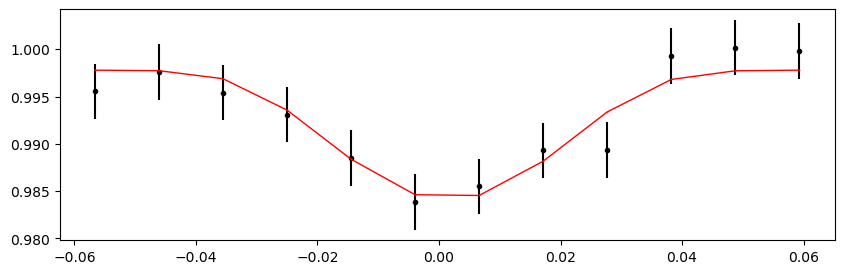

2655.25524364 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.05it/s]


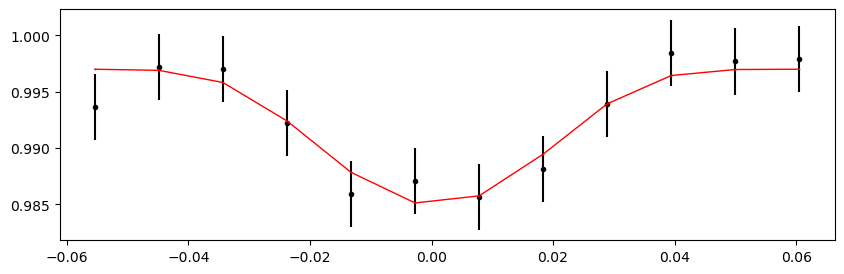

2655.9141685 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.52it/s]


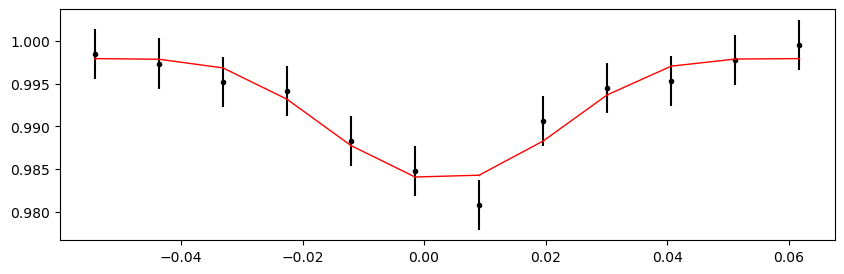

Time 2656.57309336 does not have enough data points: 10
2657.23201822 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.99it/s]


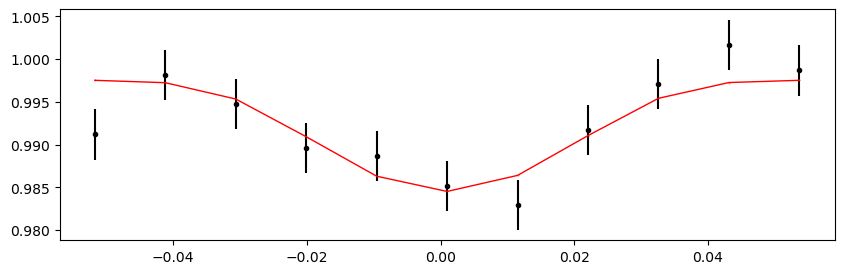

2657.89094308 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.38it/s]


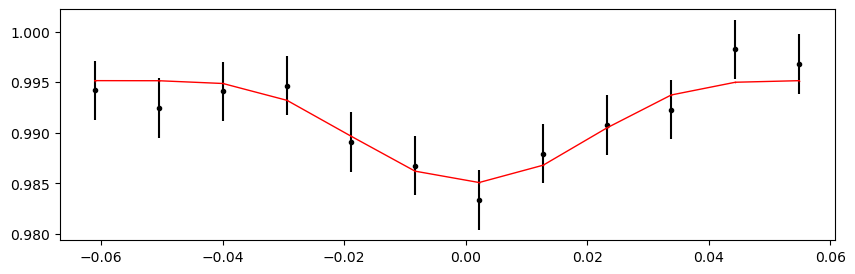

2658.54986794 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.21it/s]


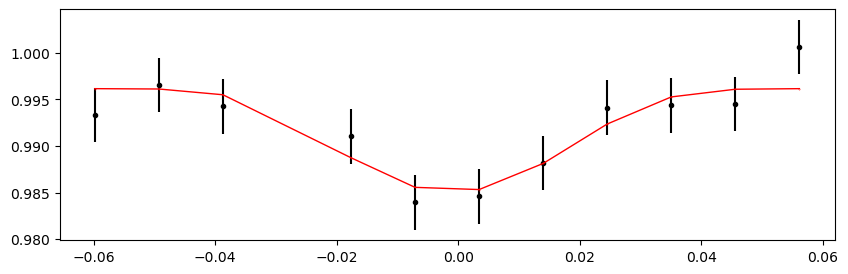

2659.2087928 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.02it/s]


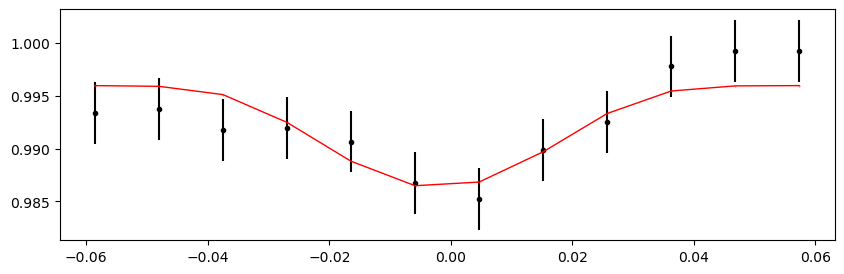

2659.86771766 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.45it/s]


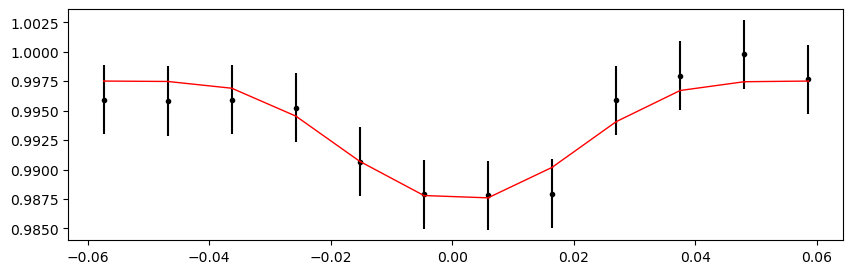

2660.5266425199998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.20it/s]


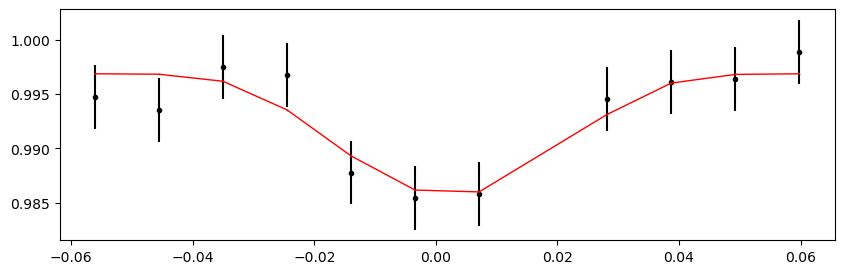

2661.18556738 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 536.94it/s]


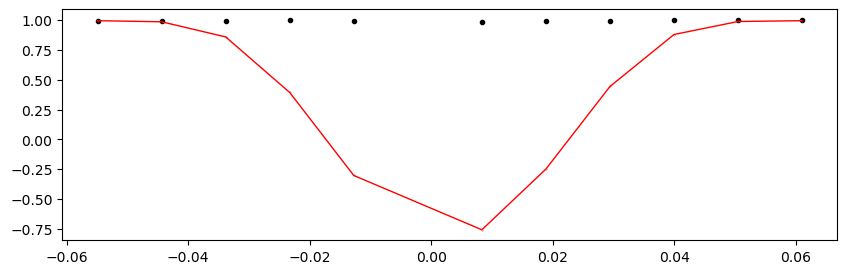

2661.84449224 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.07it/s]


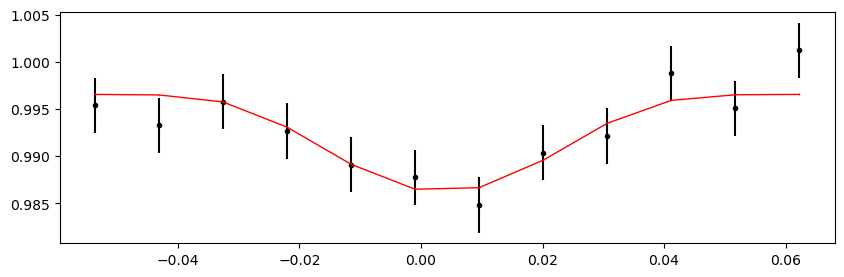

2662.5034170999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.92it/s]


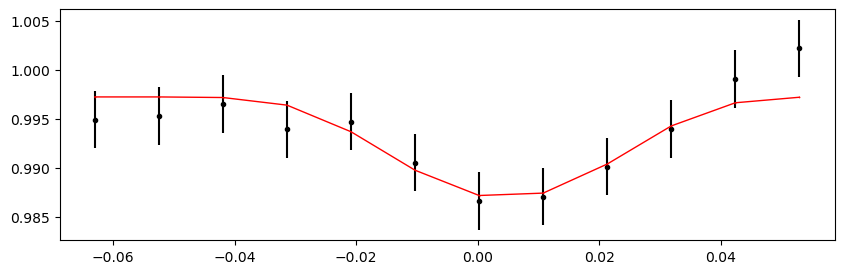

2663.16234196 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.16it/s]


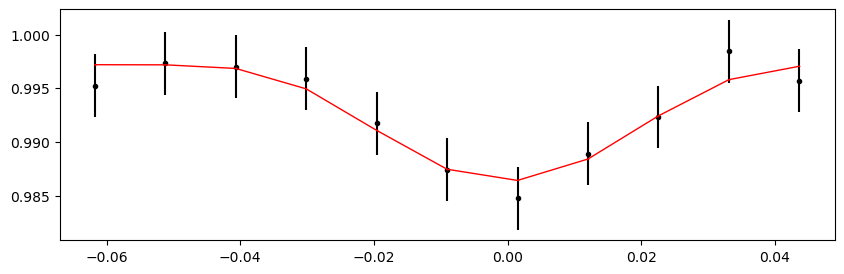

2663.82126682 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.79it/s]


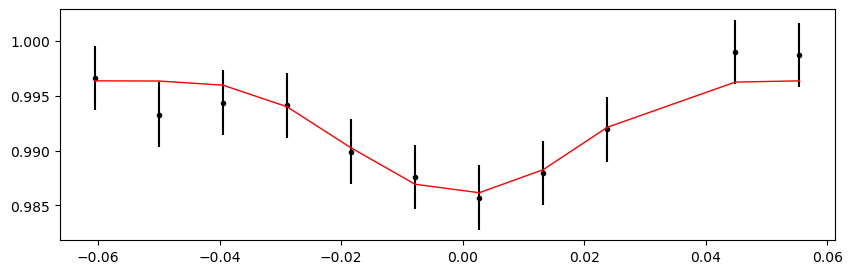

2665.7980414 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.44it/s]


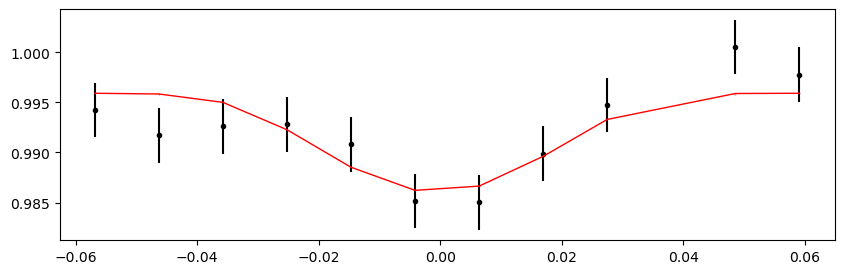

2666.4569662599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.80it/s]


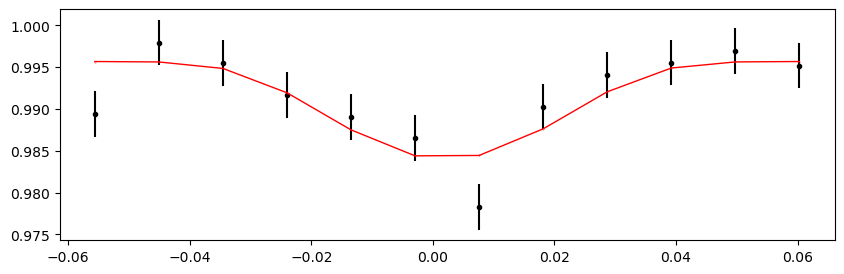

2667.11589112 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.55it/s]


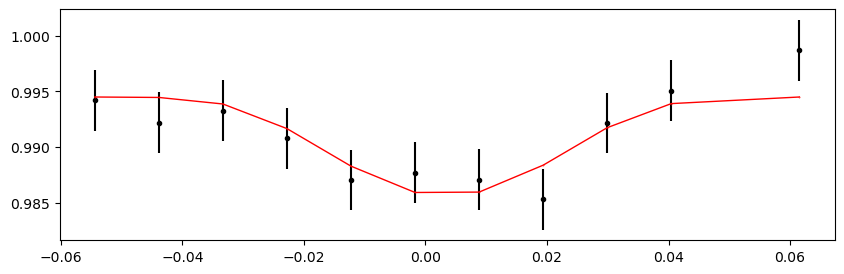

2667.77481598 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.55it/s]


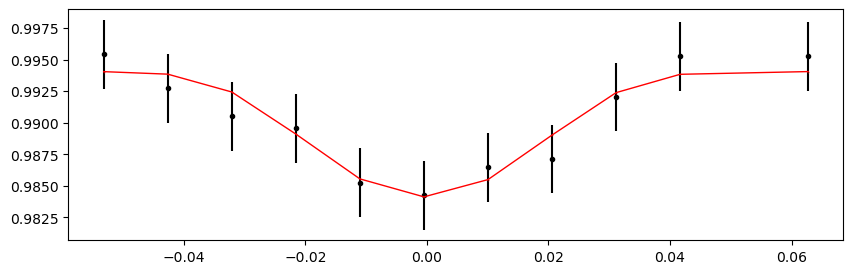

2668.4337408399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.76it/s]


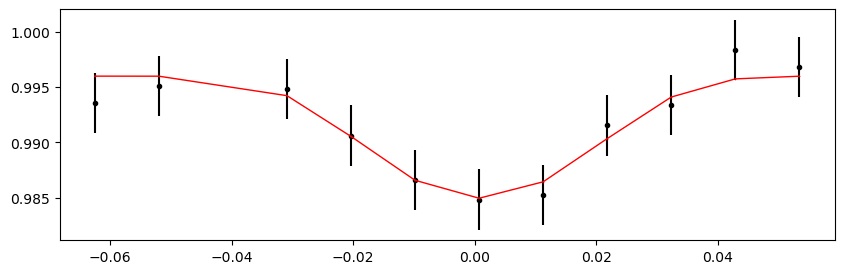

2669.0926657 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.06it/s]


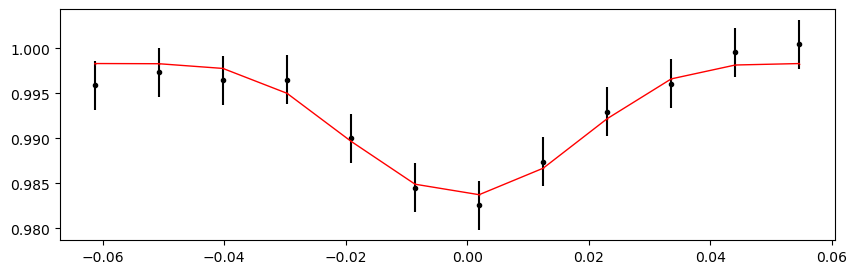

2669.75159056 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.60it/s]


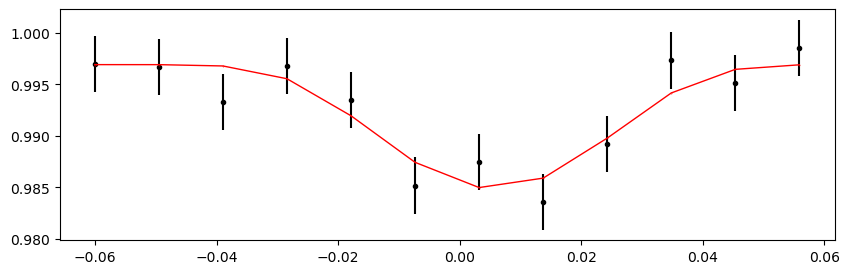

2670.4105154199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.49it/s]


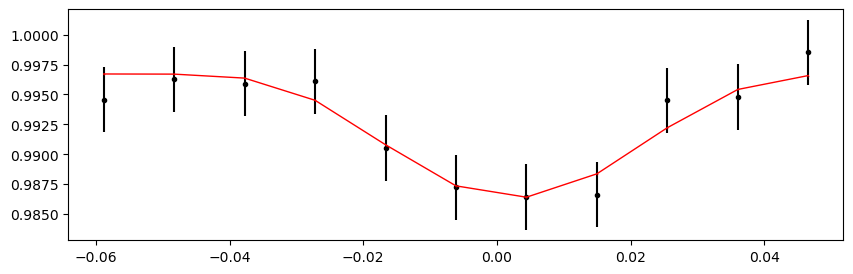

2671.06944028 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.09it/s]


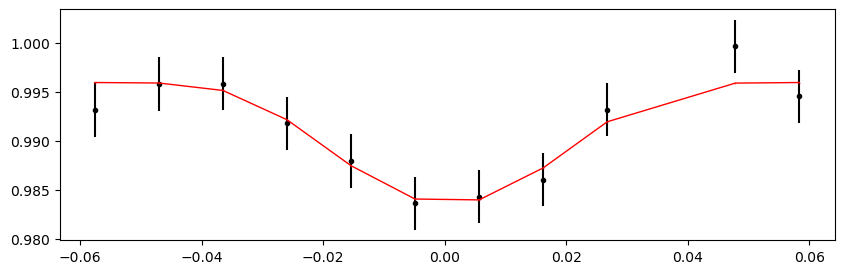

Time 2671.72836514 does not have enough data points: 10
Time 2672.3872899999997 does not have enough data points: 1
Time 2673.04621486 does not have enough data points: 10
2673.70513972 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.29it/s]


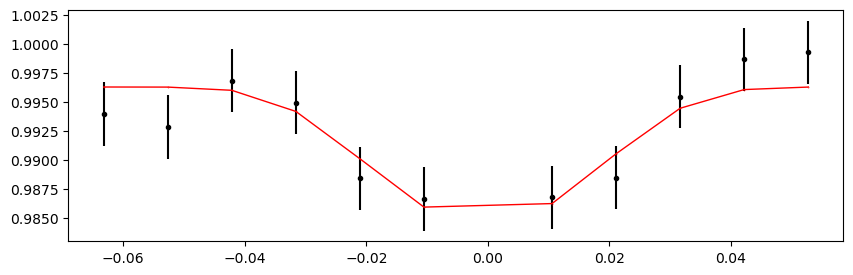

Time 2674.3640645799996 does not have enough data points: 10
Time 2675.02298944 does not have enough data points: 10
2675.6819143 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.47it/s]


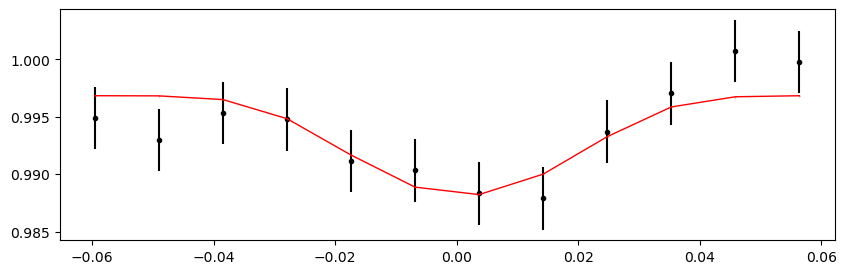

2676.34083916 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.56it/s]


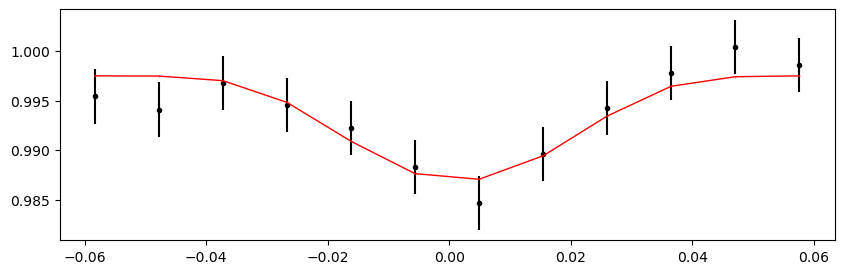

2676.99976402 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.55it/s]


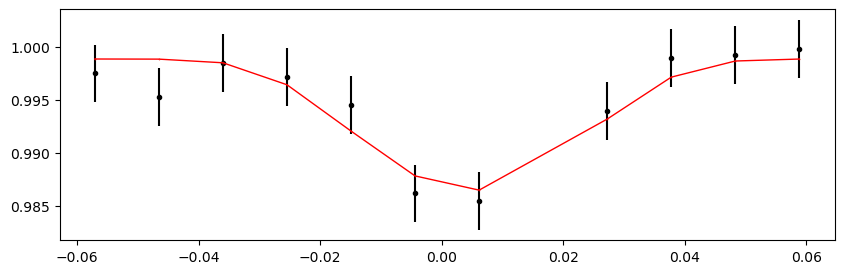

2677.6586888799998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.54it/s]


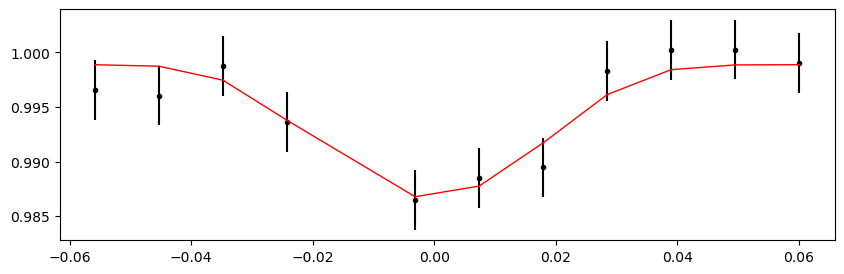

2678.31761374 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.63it/s]


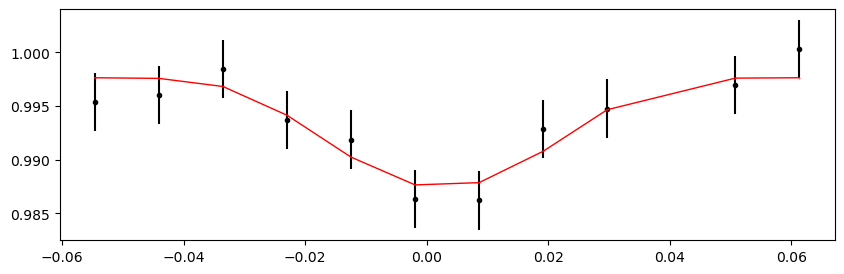

2679.6354634599998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.70it/s]


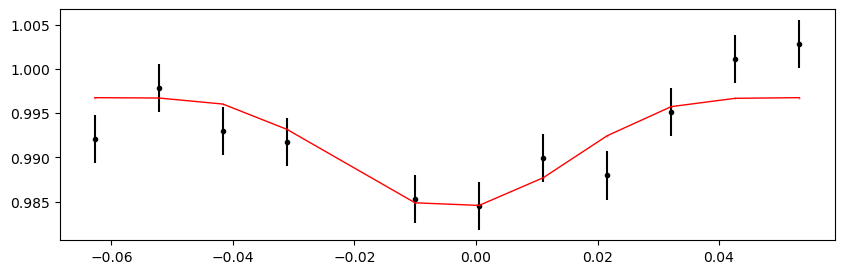

2680.29438832 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.47it/s]


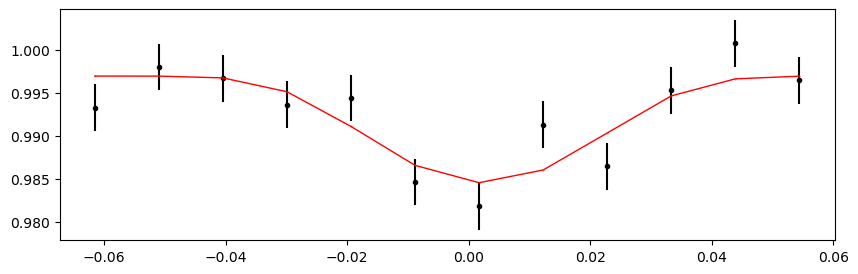

2680.95331318 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.37it/s]


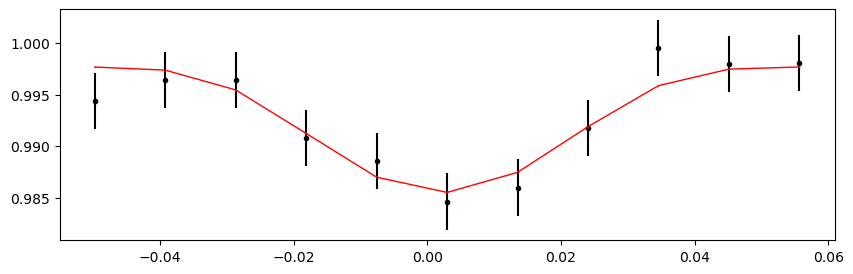

2681.61223804 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.85it/s]


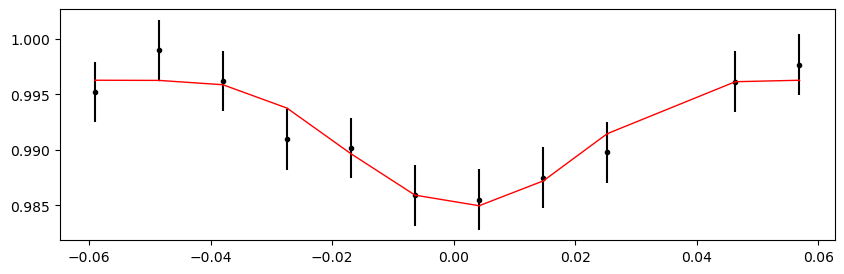

2682.2711629 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 434.83it/s]


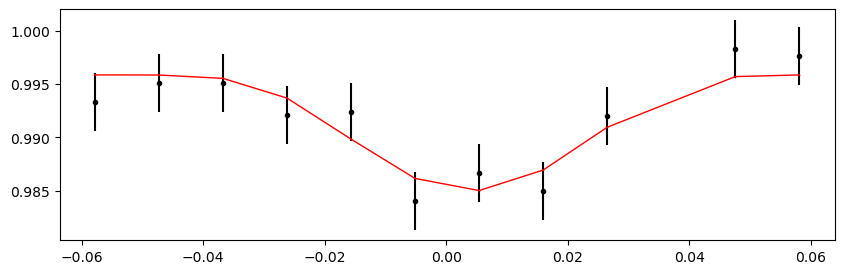

2682.93008776 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.75it/s]


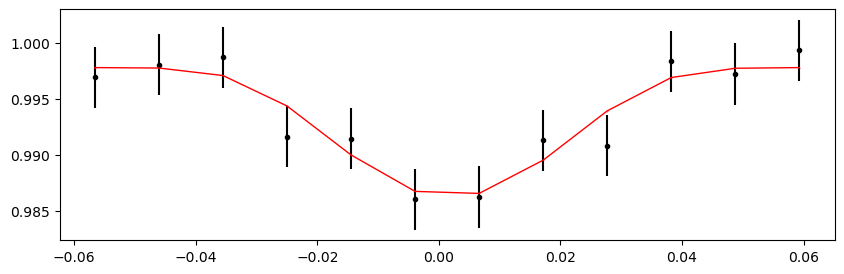

2683.58901262 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.13it/s]


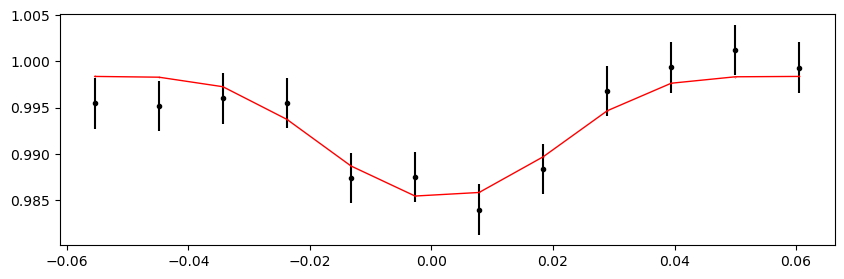

2684.24793748 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.20it/s]


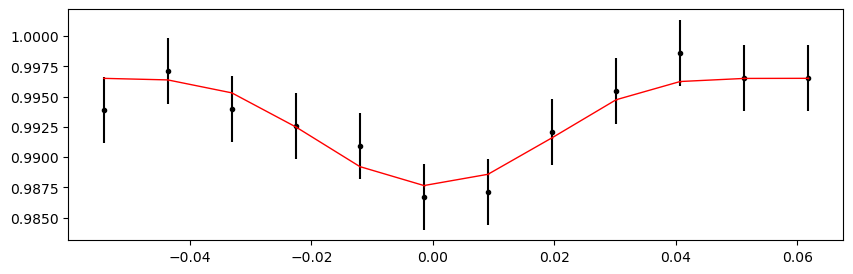

2684.90686234 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.99it/s]


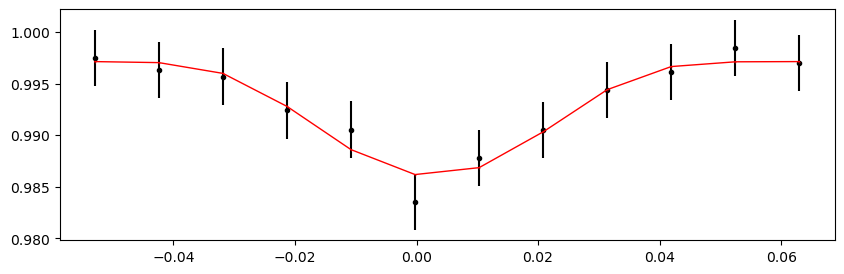

Time 2685.5657872 does not have enough data points: 10
Time 2686.22471206 does not have enough data points: 10
2686.88363692 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.47it/s]


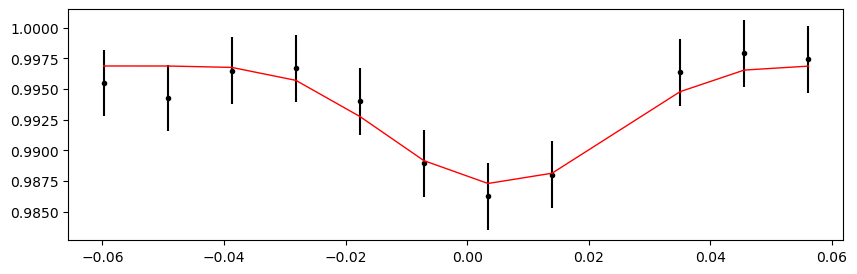

2687.54256178 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.81it/s]


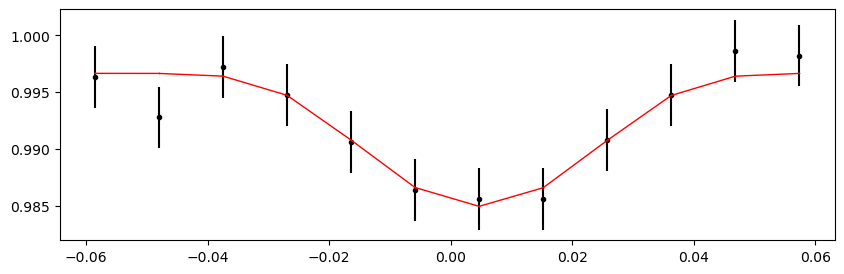

2688.20148664 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.44it/s]


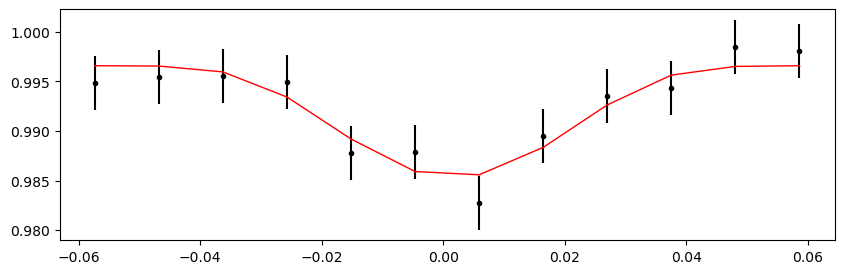

2688.8604115 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.25it/s]


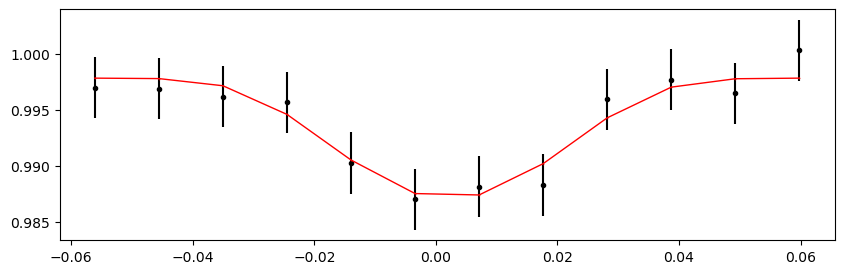

Time 2689.51933636 does not have enough data points: 10
Time 2690.17826122 does not have enough data points: 10
2690.83718608 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.95it/s]


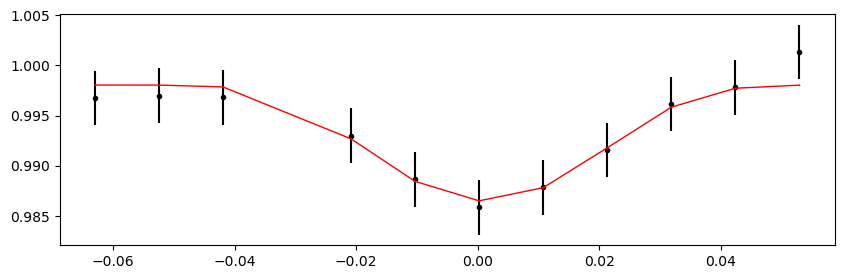

Time 2691.49611094 does not have enough data points: 8
2693.47288552 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.54it/s]


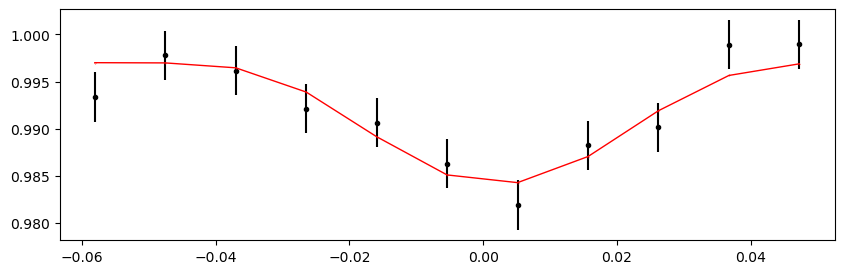

2694.13181038 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.56it/s]


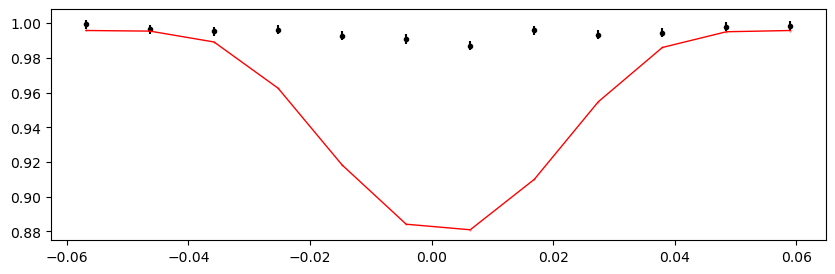

2694.79073524 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.80it/s]


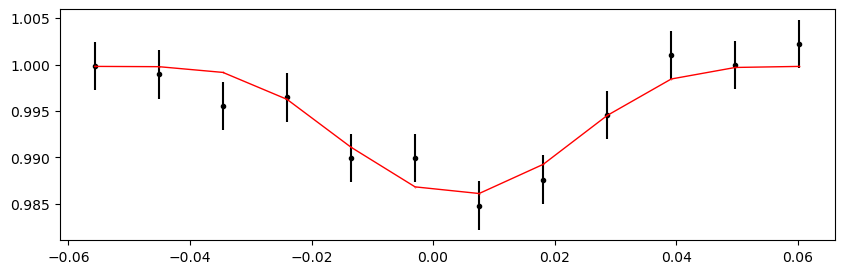

2695.4496601 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.41it/s]


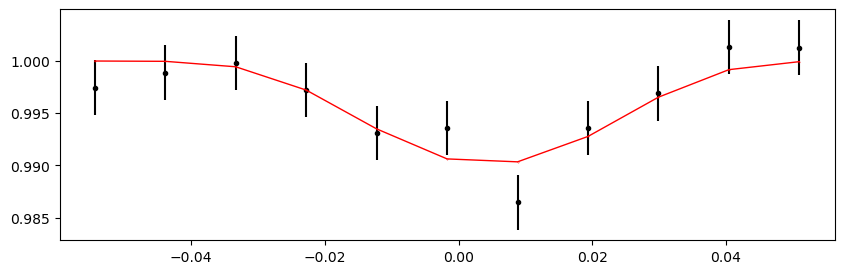

2696.10858496 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.92it/s]


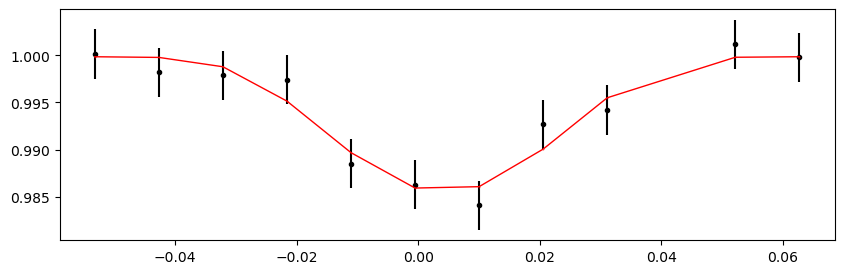

2696.7675098199998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.61it/s]


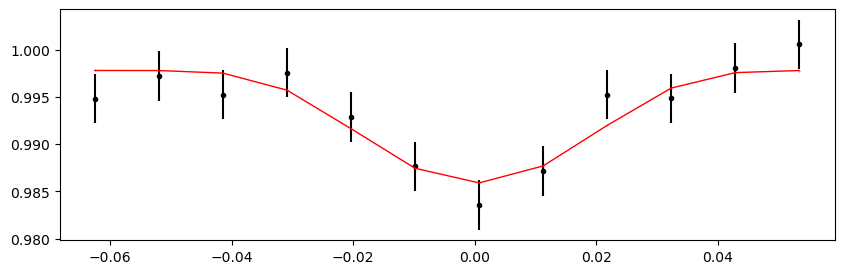

2697.42643468 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 490.85it/s]


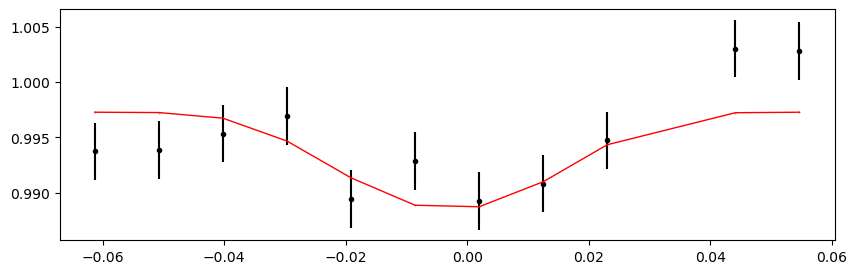

2698.08535954 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.82it/s]


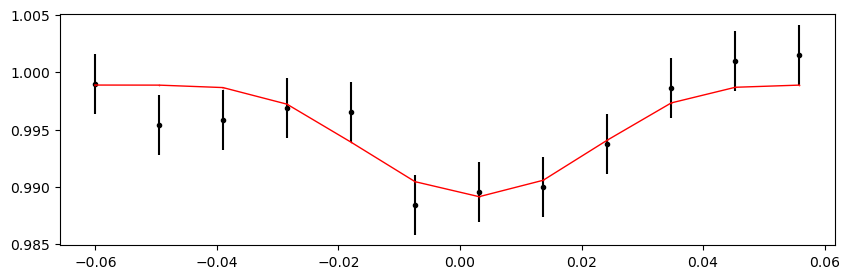

2698.7442843999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.35it/s]


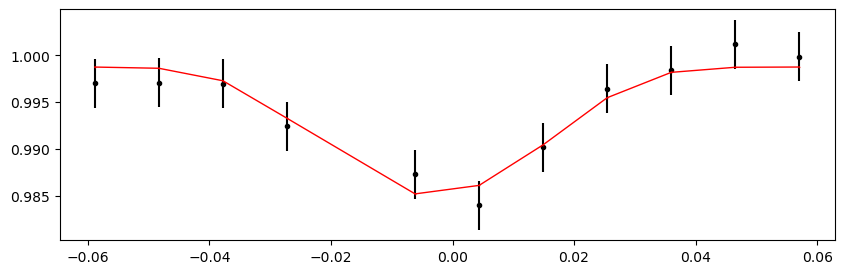

2699.40320926 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.93it/s]


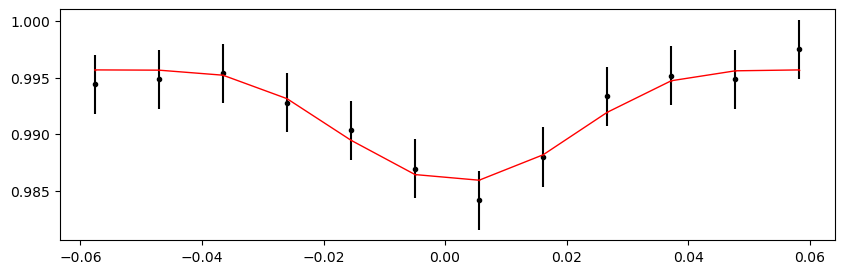

2700.06213412 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.39it/s]


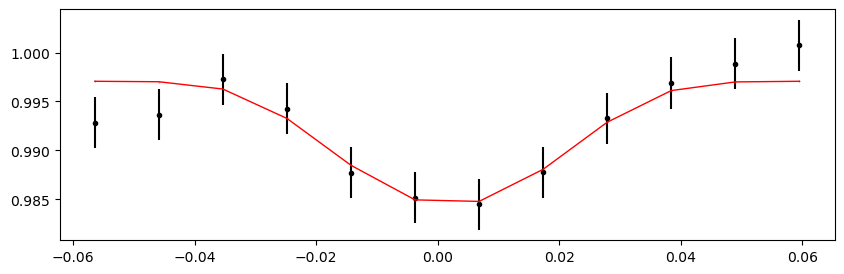

2700.7210589799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.49it/s]


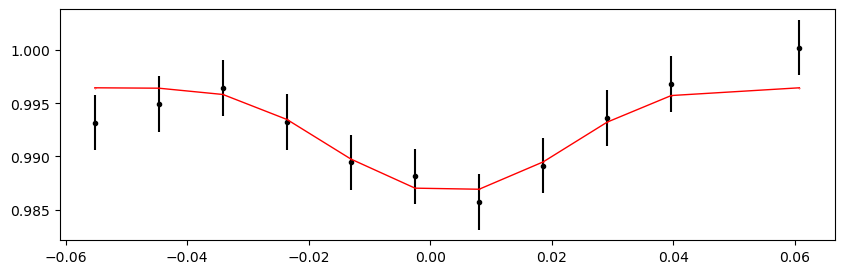

2701.37998384 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.76it/s]


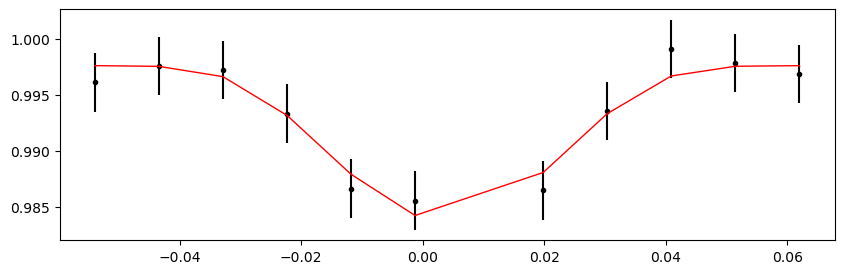

Time 2702.0389087 does not have enough data points: 8
2702.6978335599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.80it/s]


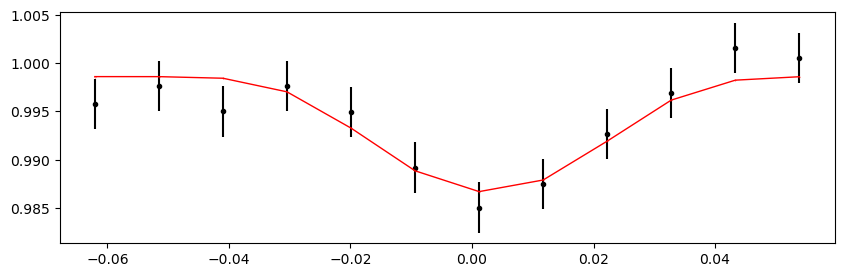

2703.35675842 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.22it/s]


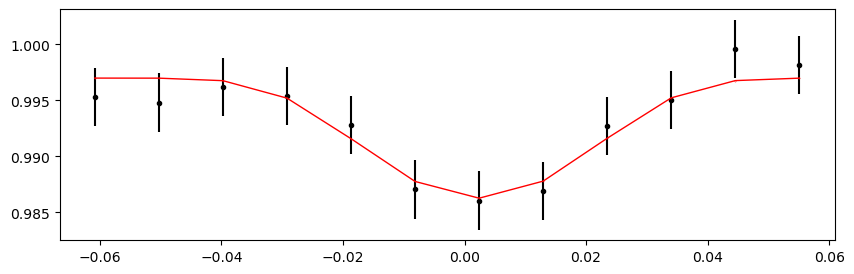

Time 2704.01568328 does not have enough data points: 8
Time 2704.6746081399997 does not have enough data points: 9
2705.99245786 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.50it/s]


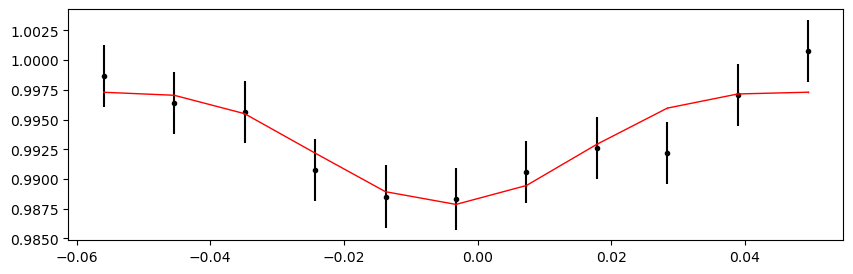

2706.6513827199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.87it/s]


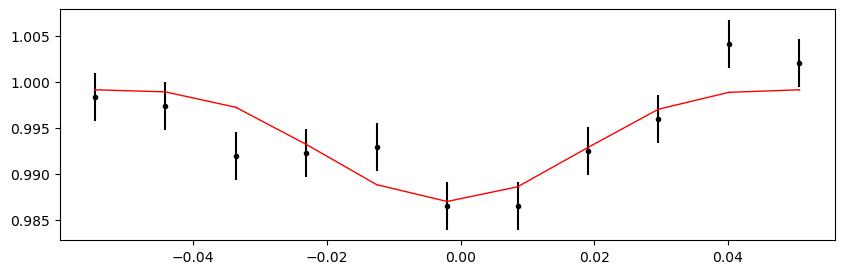

2707.31030758 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.79it/s]


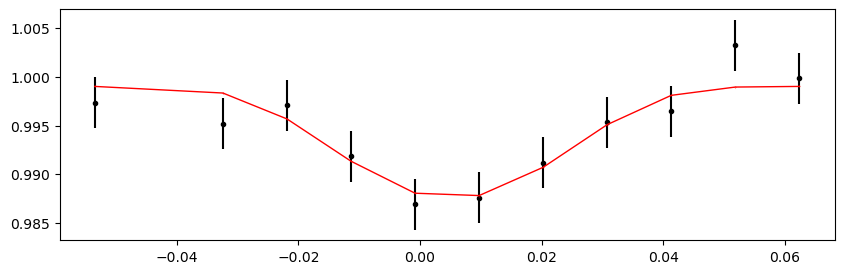

2707.96923244 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.70it/s]


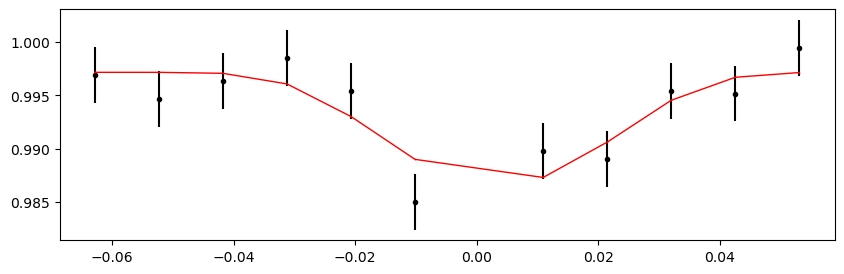

2708.6281572999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.20it/s]


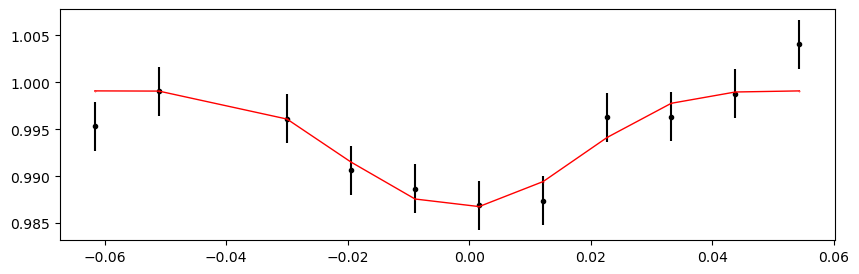

2709.28708216 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.86it/s]


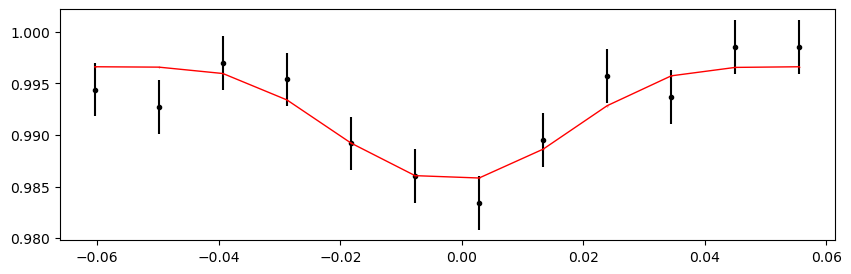

2709.9460070200003 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.58it/s]


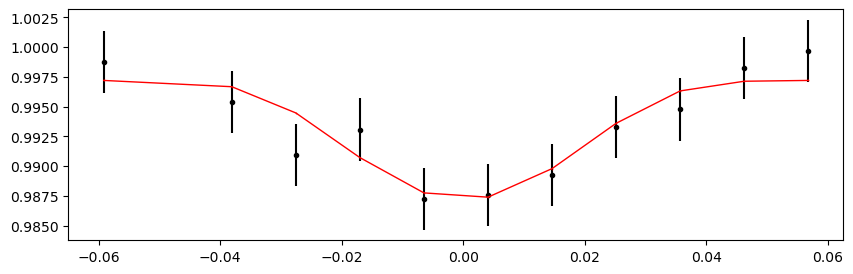

2710.6049318799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.51it/s]


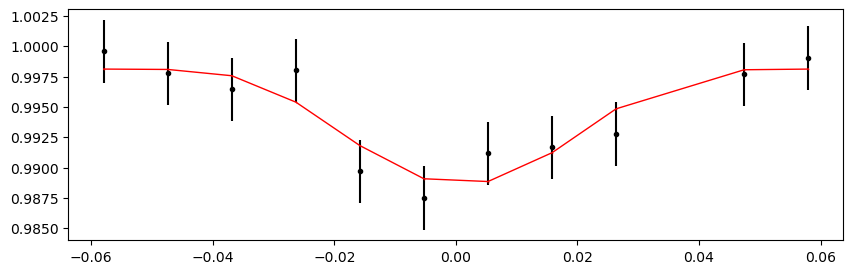

2711.26385674 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.42it/s]


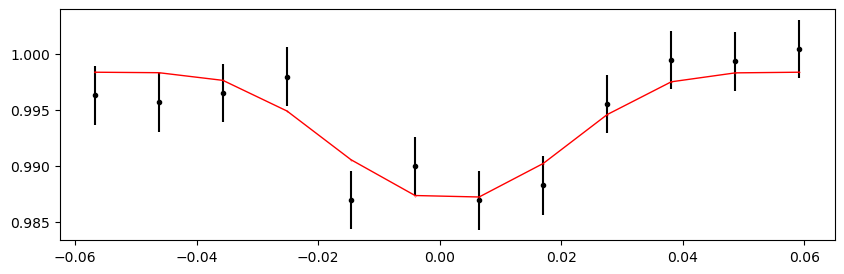

2711.9227816000002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.38it/s]


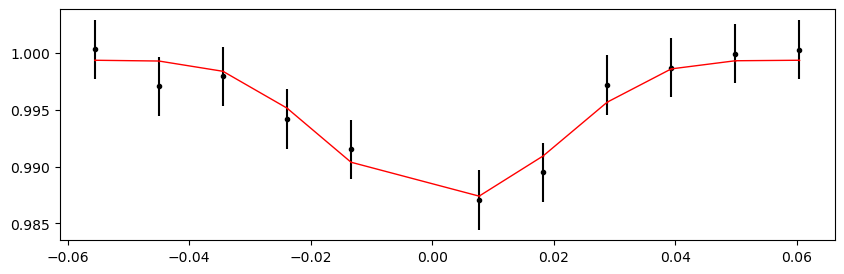

2712.5817064599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.60it/s]


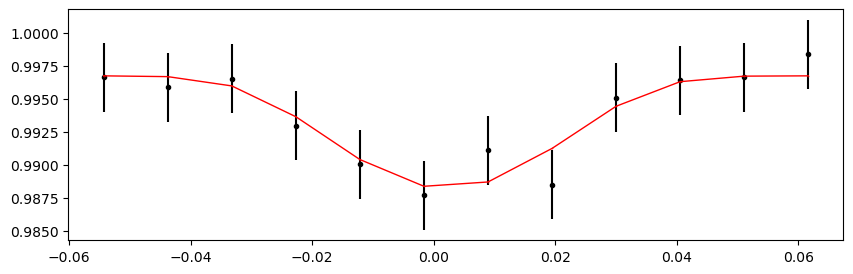

2713.24063132 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.17it/s]


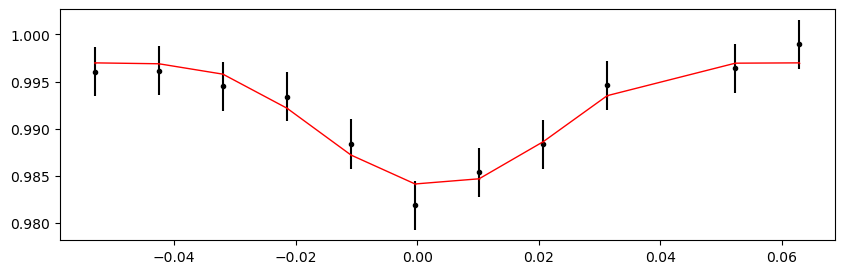

2713.89955618 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.78it/s]


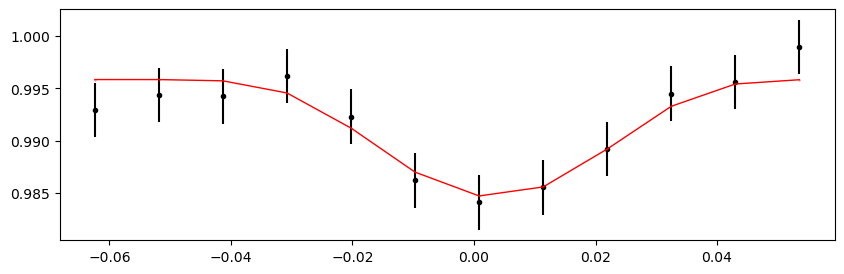

2714.5584810399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.68it/s]


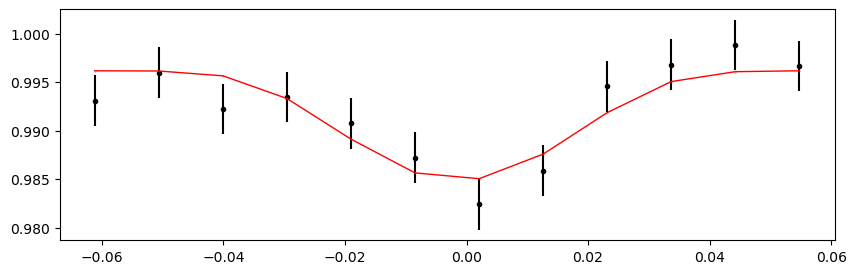

2715.2174059 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.54it/s]


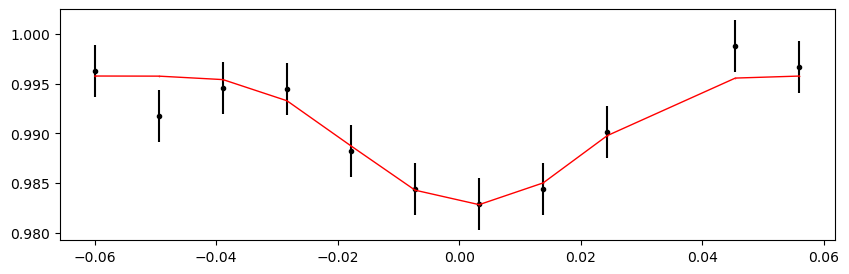

2715.87633076 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.15it/s]


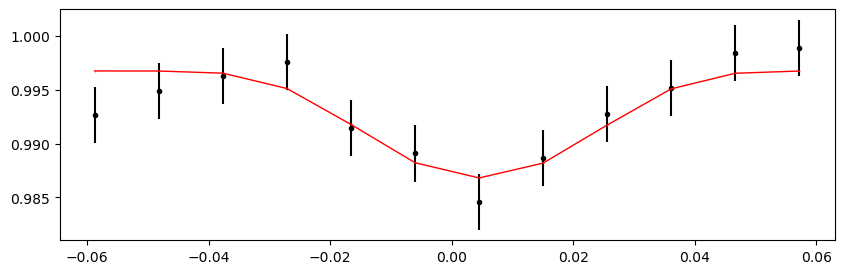

2716.5352556199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.39it/s]


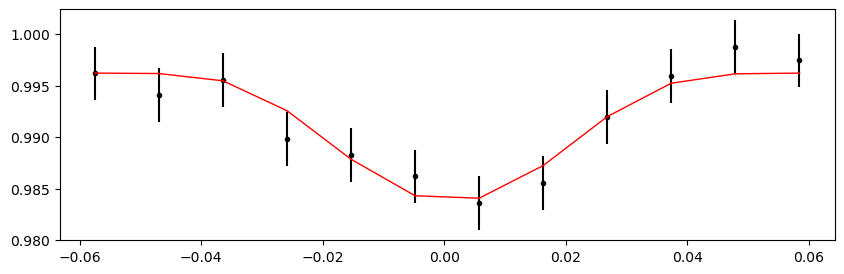

2717.19418048 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.95it/s]


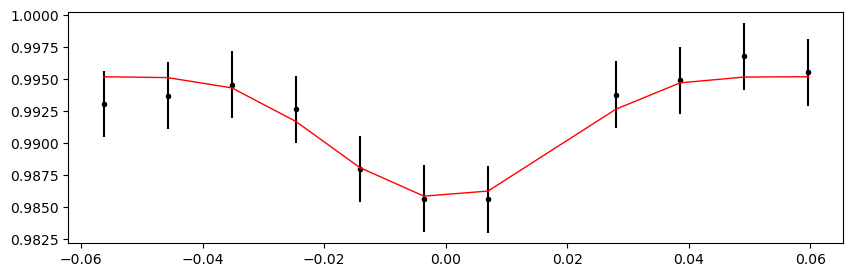

2744.21009974 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.76it/s]


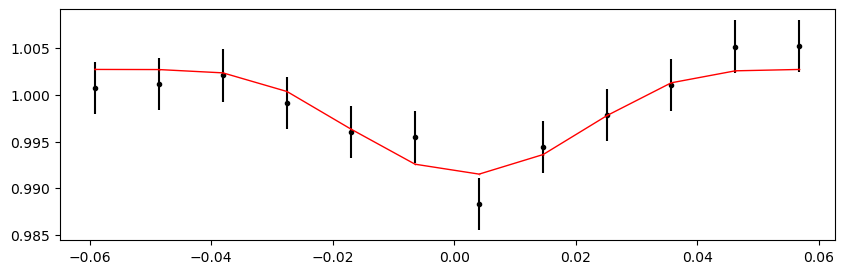

2744.8690245999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.76it/s]


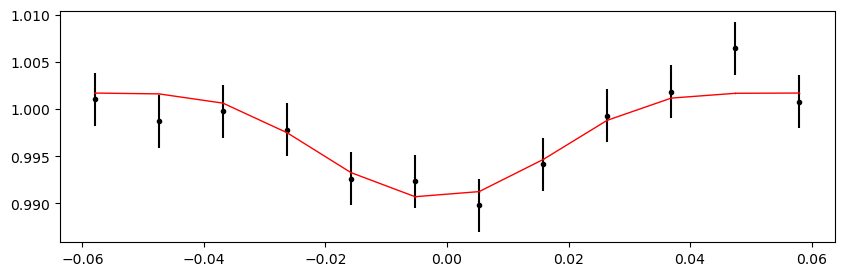

2745.52794946 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.12it/s]


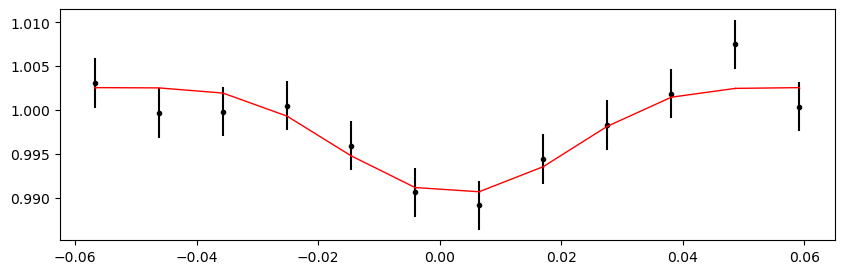

2746.1868743200002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 527.08it/s]


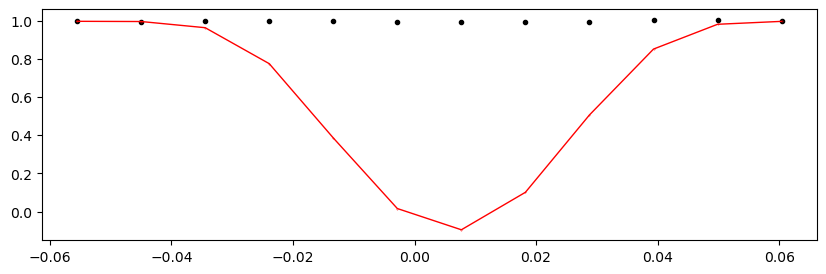

2746.8457991799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.95it/s]


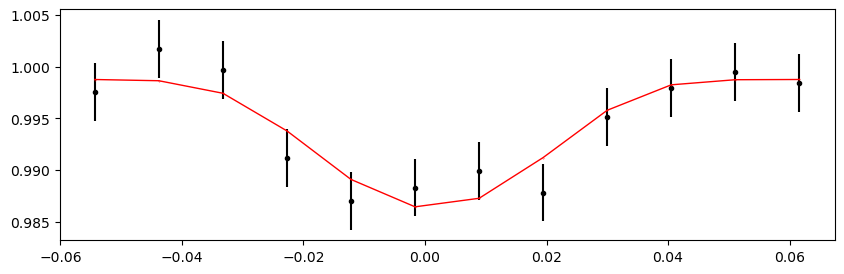

2747.50472404 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.47it/s]


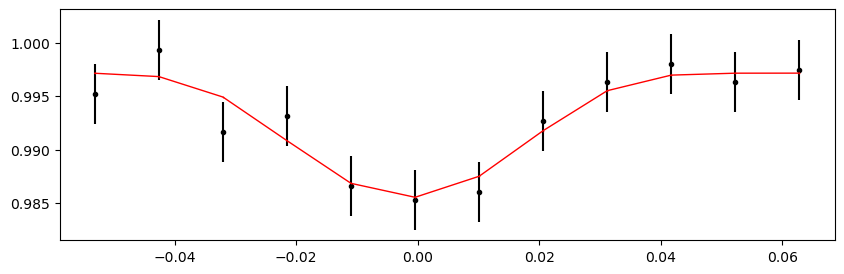

2748.1636489 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.02it/s]


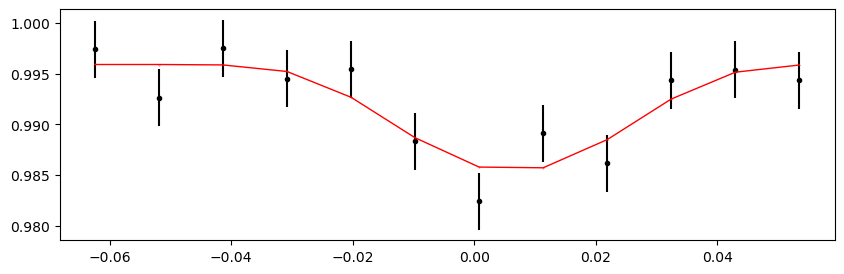

2748.8225737599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.23it/s]


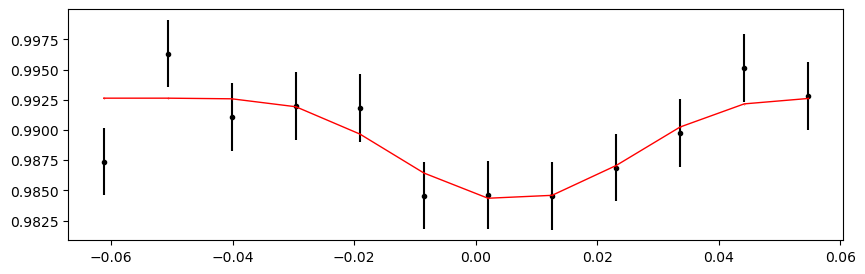

2749.48149862 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.54it/s]


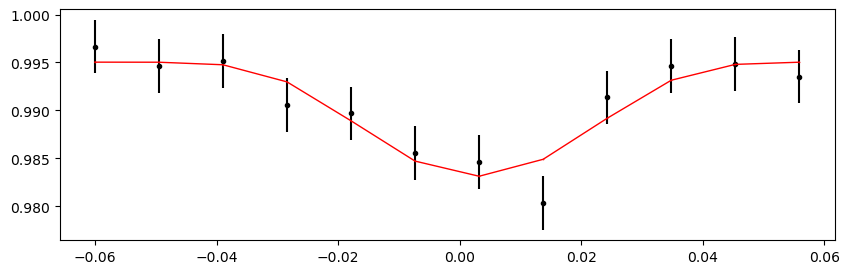

2750.14042348 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.41it/s]


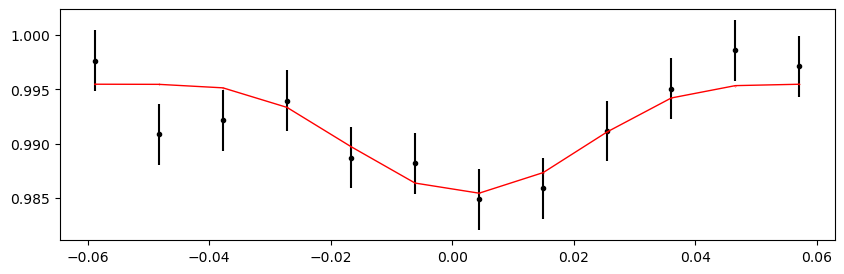

2750.7993483399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.52it/s]


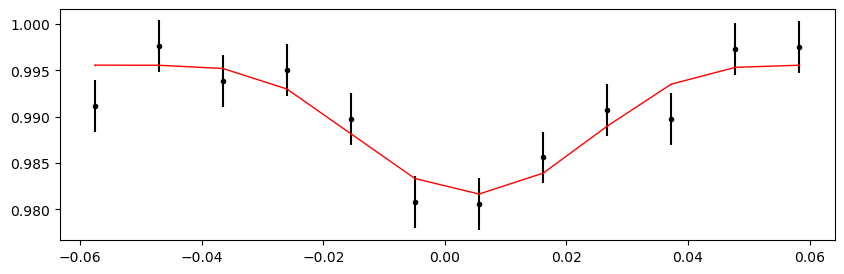

2751.4582732 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.95it/s]


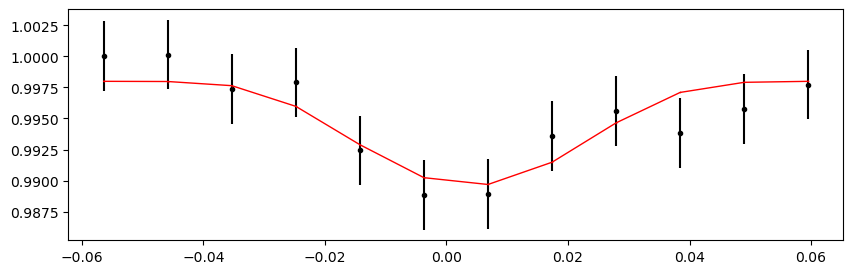

2752.11719806 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.07it/s]


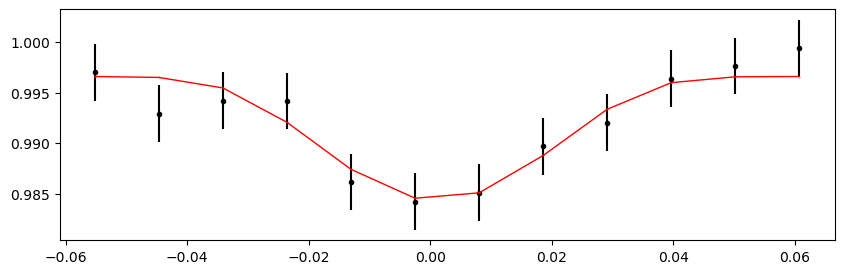

2752.7761229199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.45it/s]


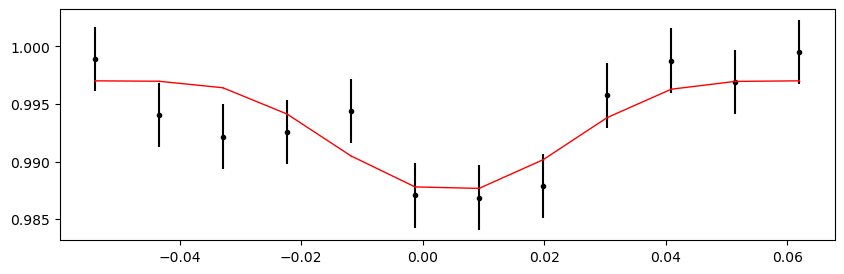

2753.43504778 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.67it/s]


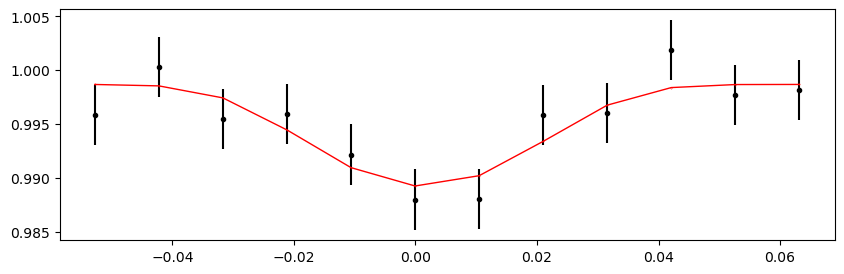

2754.09397264 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.31it/s]


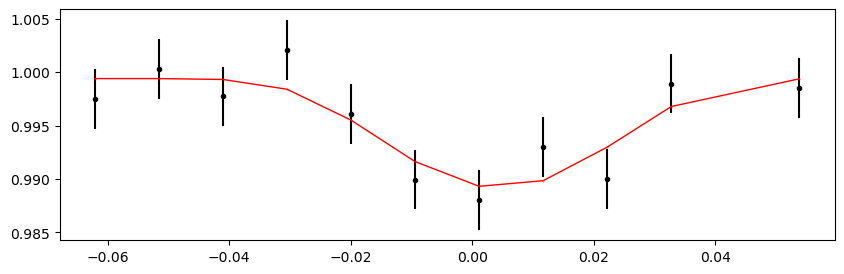

2754.7528975 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 451.72it/s]


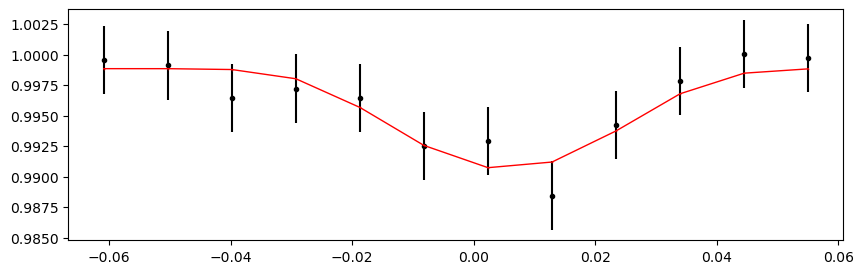

2755.41182236 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.32it/s]


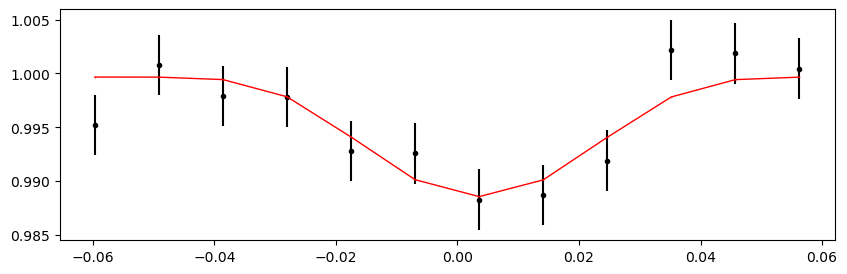

2757.38859694 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.18it/s]


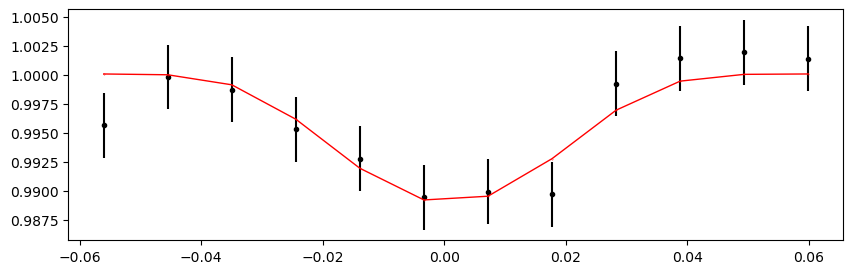

2758.0475218 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.07it/s]


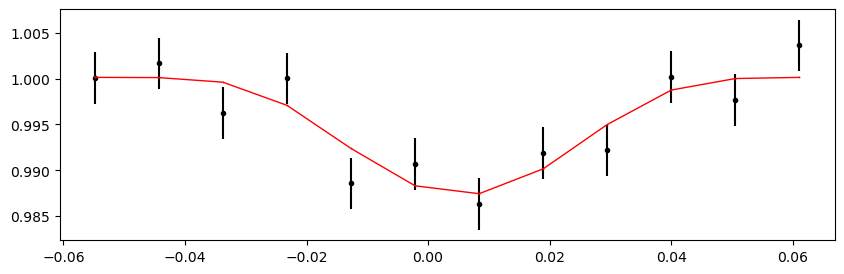

2758.70644666 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 434.82it/s]


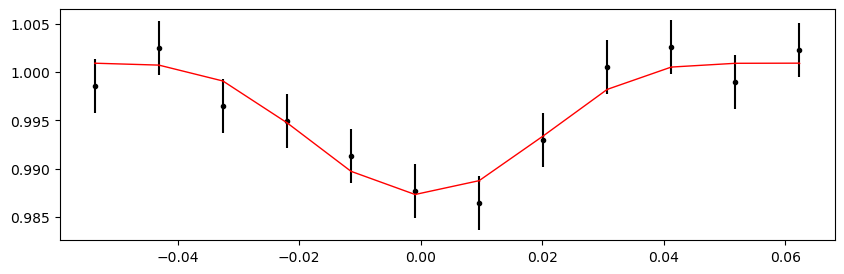

2759.36537152 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.66it/s]


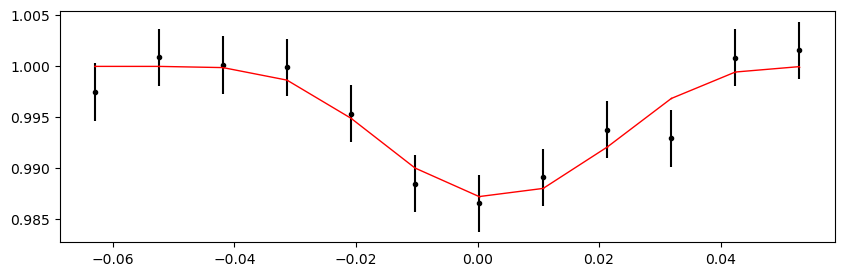

2760.02429638 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.55it/s]


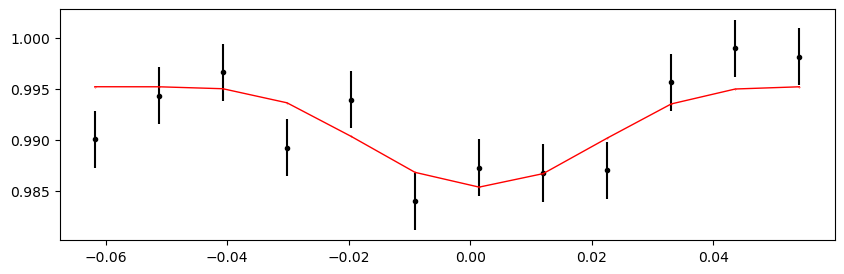

2760.68322124 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.09it/s]


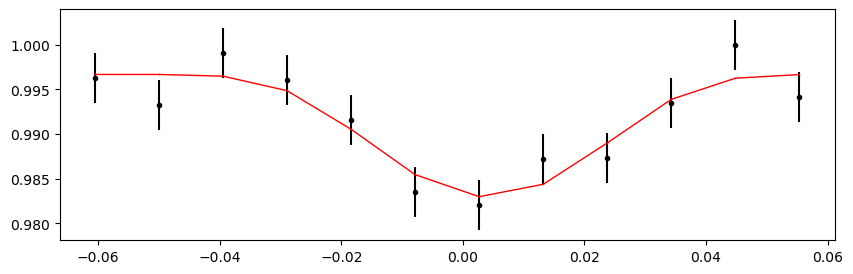

2761.3421461 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.90it/s]


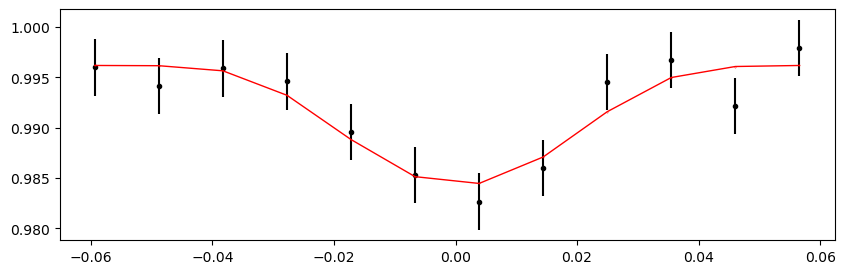

2762.00107096 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.13it/s]


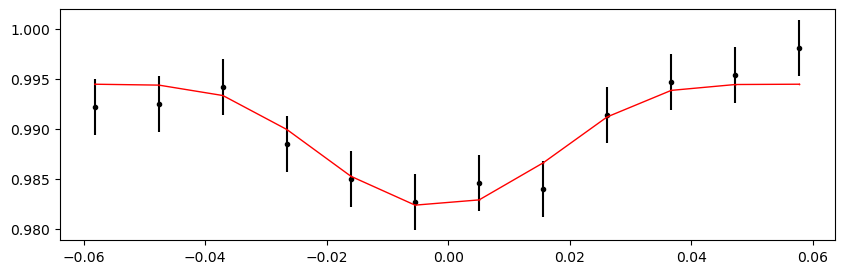

2762.65999582 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 526.98it/s]


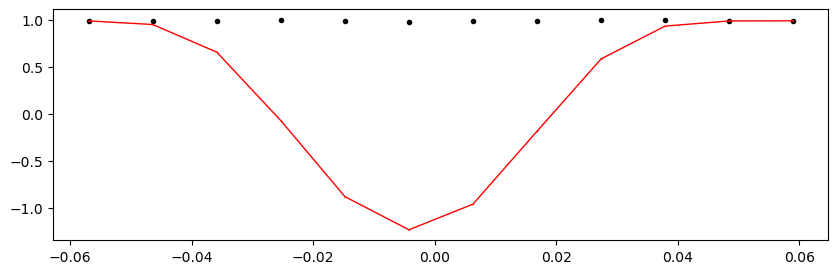

2763.31892068 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.19it/s]


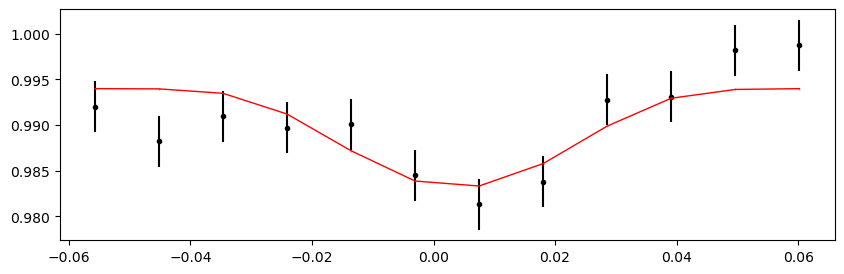

2763.97784554 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.60it/s]


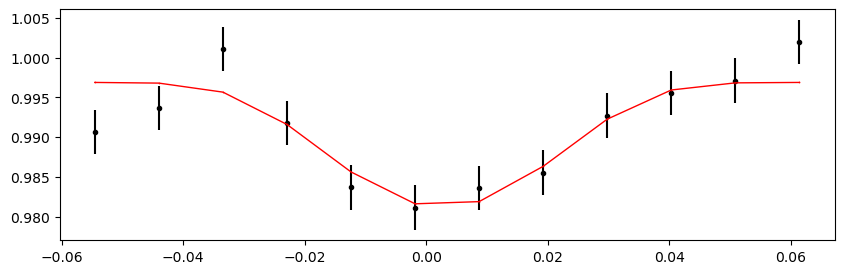

2764.6367704 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.65it/s]


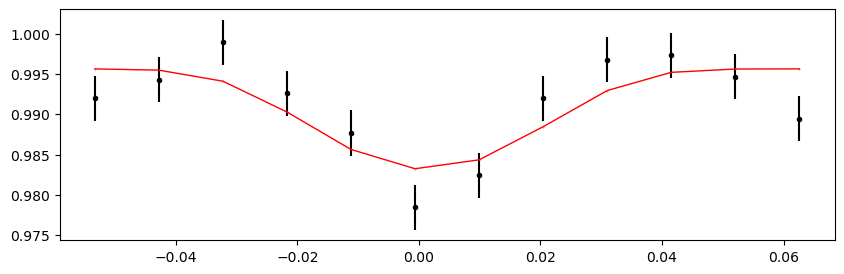

2765.29569526 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.75it/s]


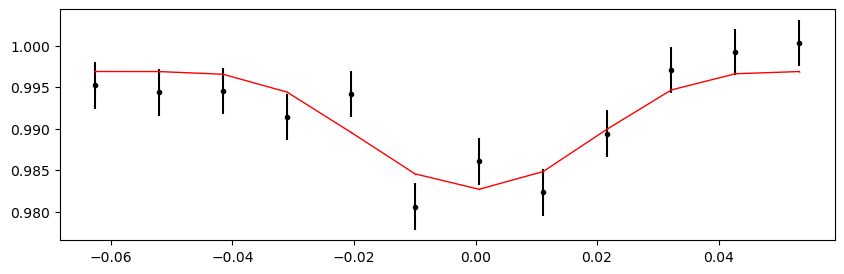

2765.95462012 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.55it/s]


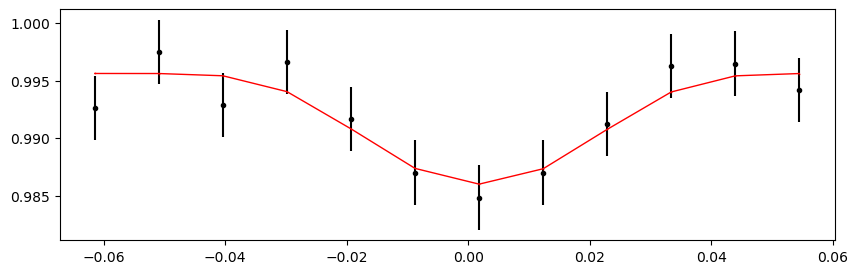

2766.61354498 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.04it/s]


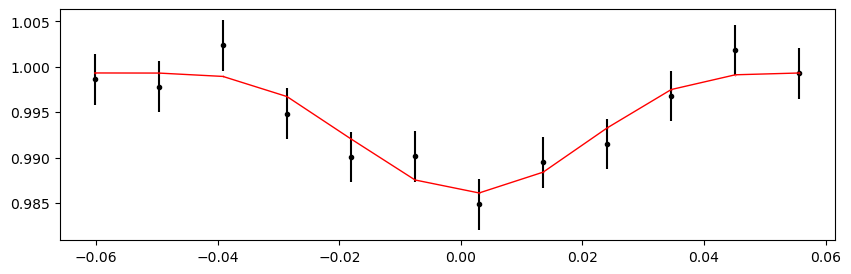

2767.2724698399998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 439.26it/s]


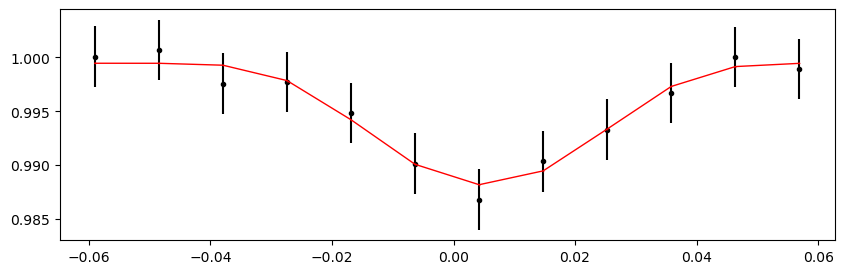

2767.9313947 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.04it/s]


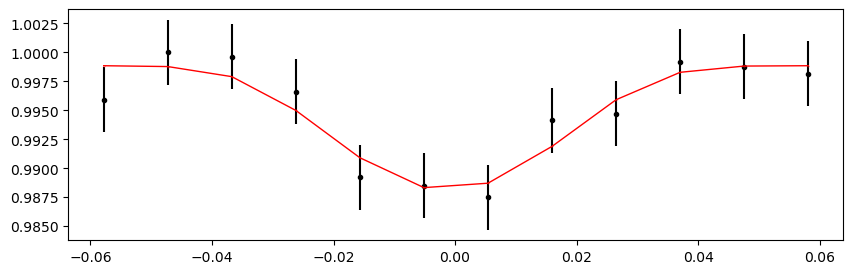

2768.59031956 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.73it/s]


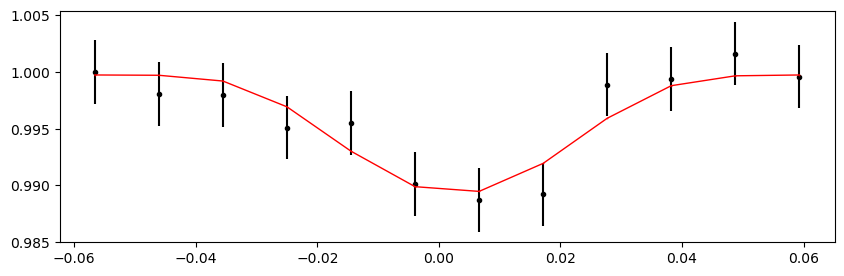

Time 2769.90816928 does not have enough data points: 8
2770.56709414 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.27it/s]


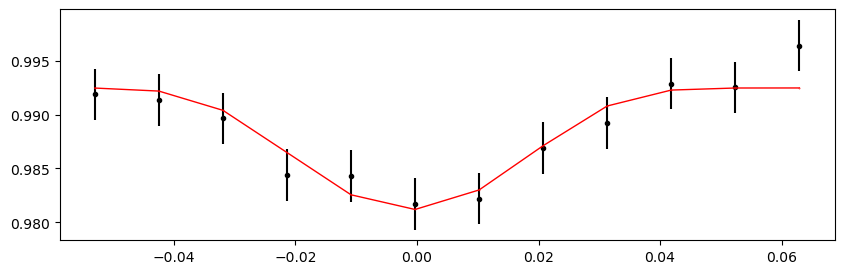

2771.2260189999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.74it/s]


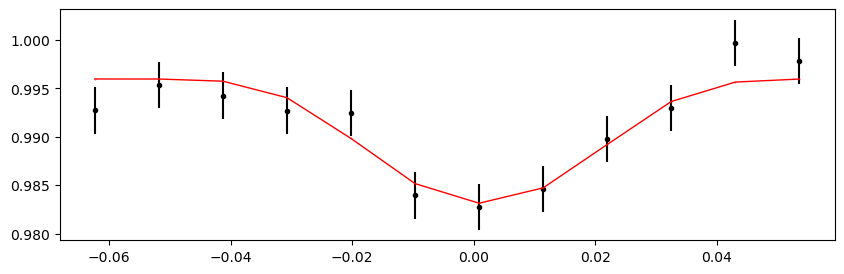

2771.88494386 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.50it/s]


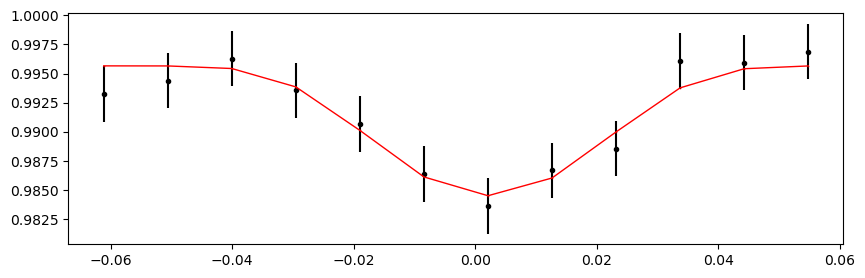

2772.54386872 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 449.23it/s]


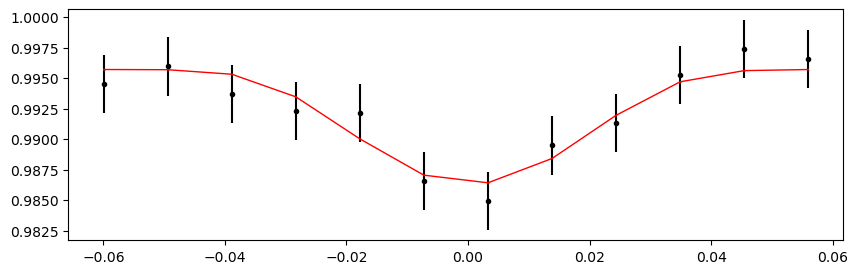

2773.2027935799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.62it/s]


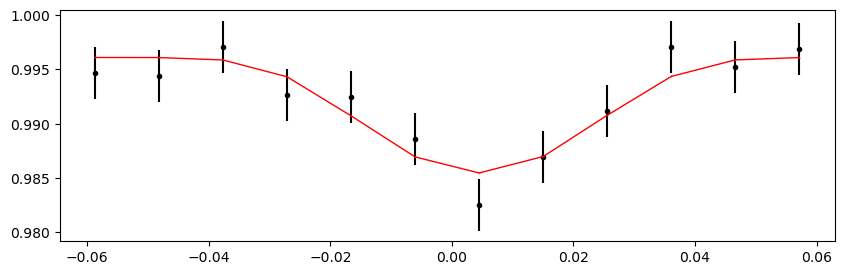

2773.86171844 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.25it/s]


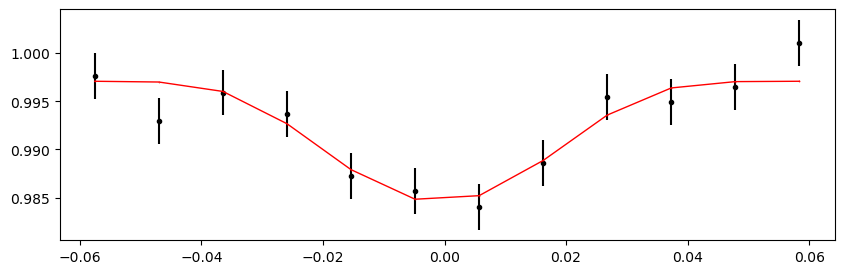

2774.5206433 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.26it/s]


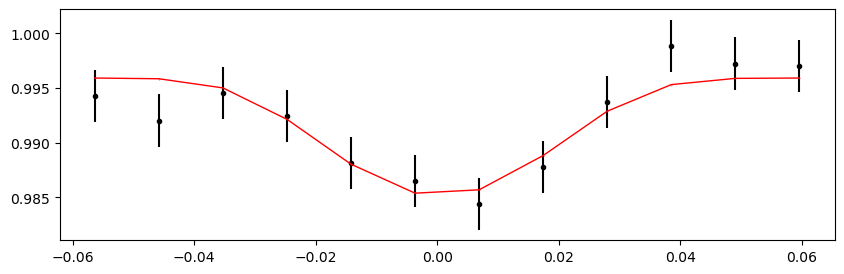

2775.1795681599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.37it/s]


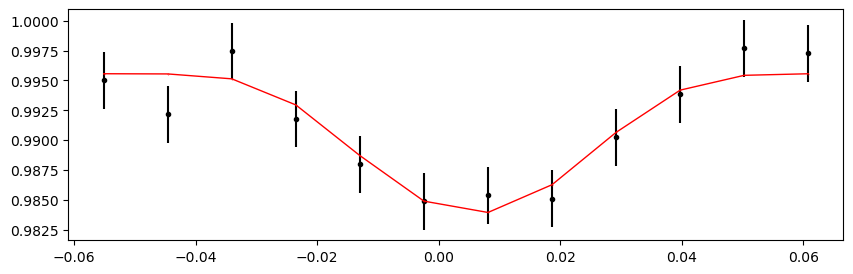

2775.83849302 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.91it/s]


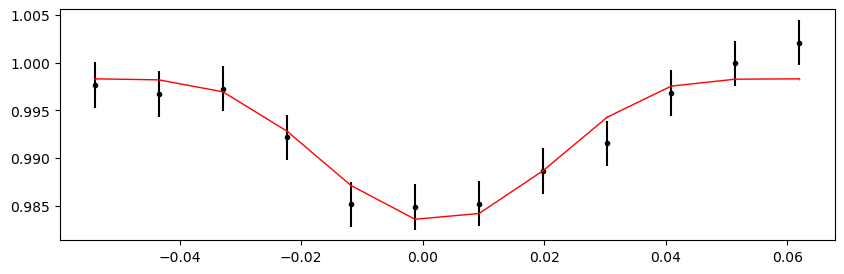

2776.49741788 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.97it/s]


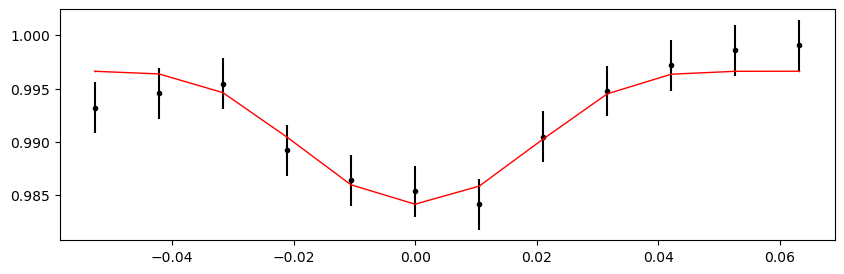

2777.1563427399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.65it/s]


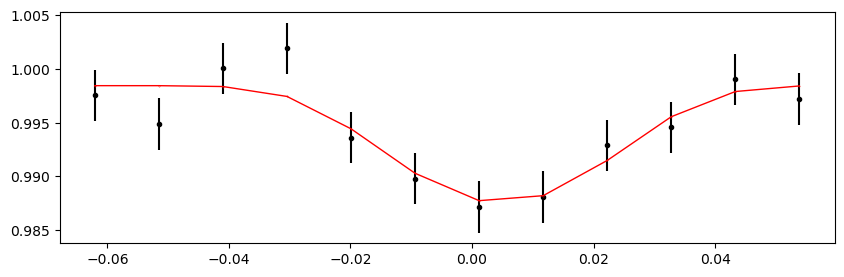

2777.8152676 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.29it/s]


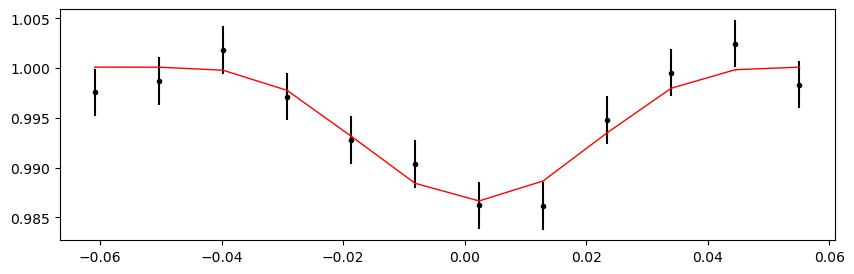

2778.47419246 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.64it/s]


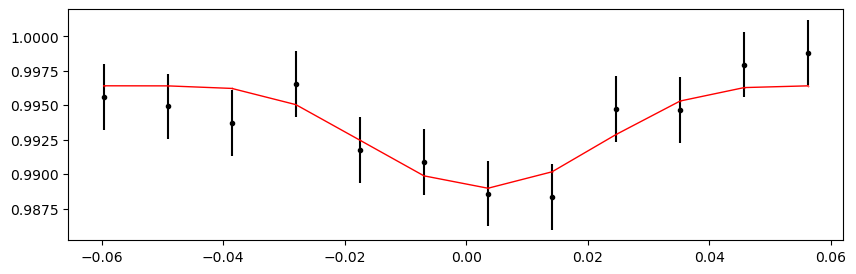

2779.1331173199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.77it/s]


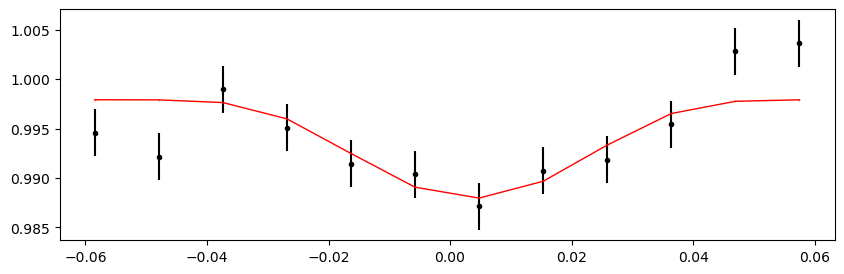

2779.79204218 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.13it/s]


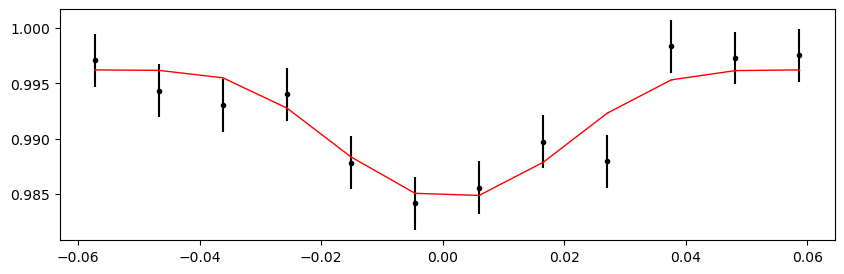

2780.45096704 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.60it/s]


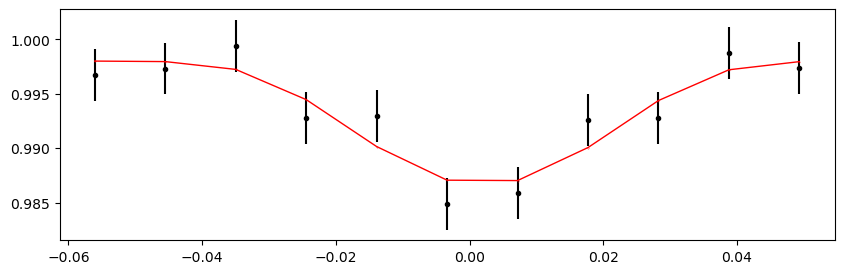

2781.1098918999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.89it/s]


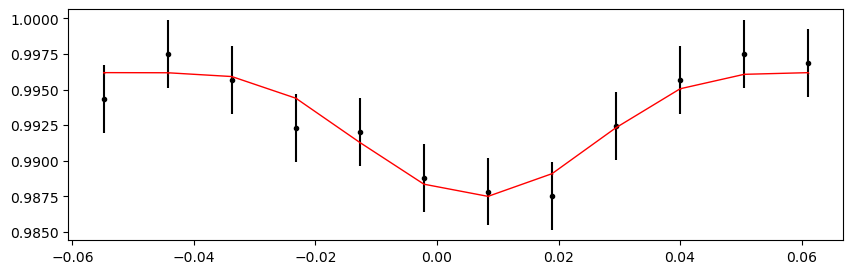

2781.76881676 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 450.20it/s]


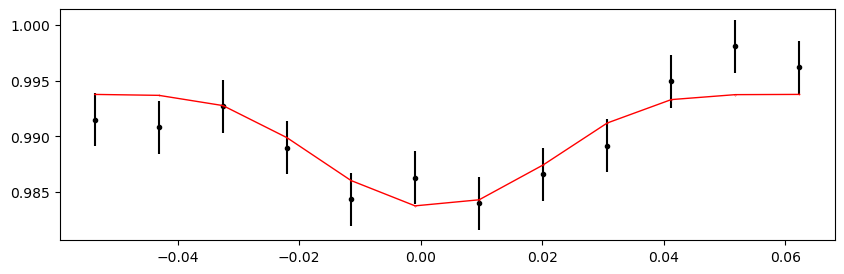

2783.74559134 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.03it/s]


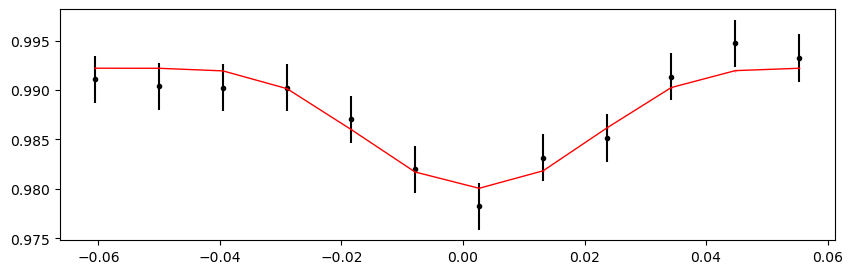

2784.4045162 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.89it/s]


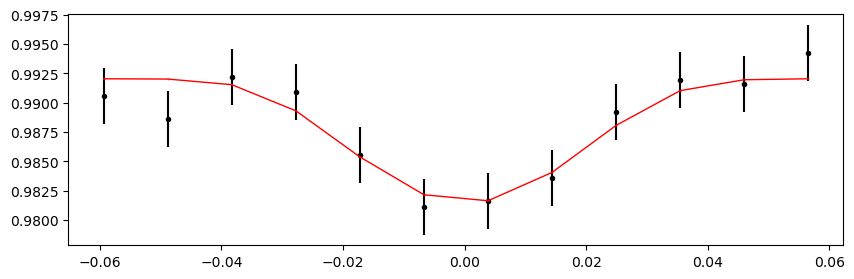

2785.0634410599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 402.55it/s]


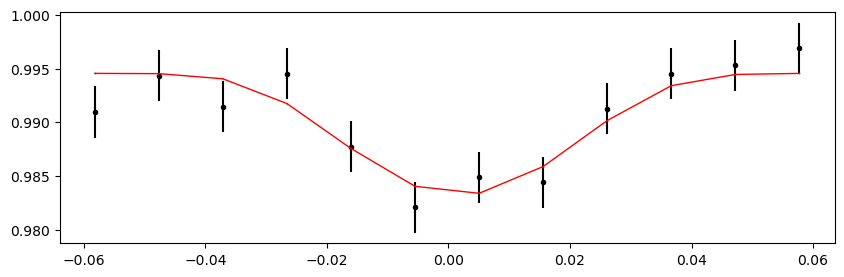

2785.72236592 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.07it/s]


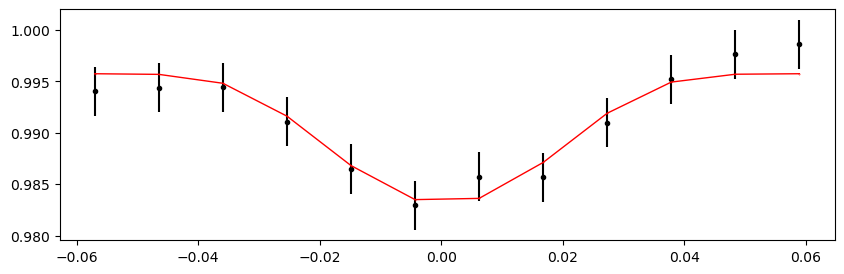

2786.38129078 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.64it/s]


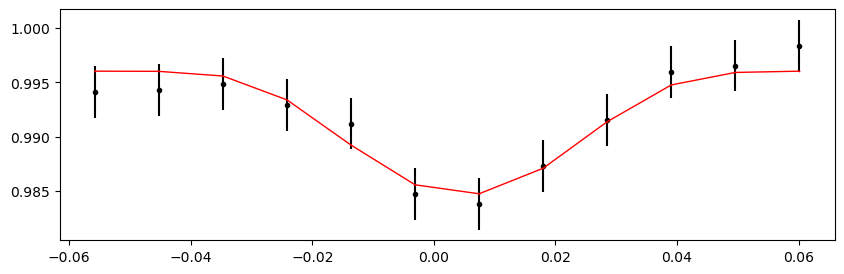

2787.0402156399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.23it/s]


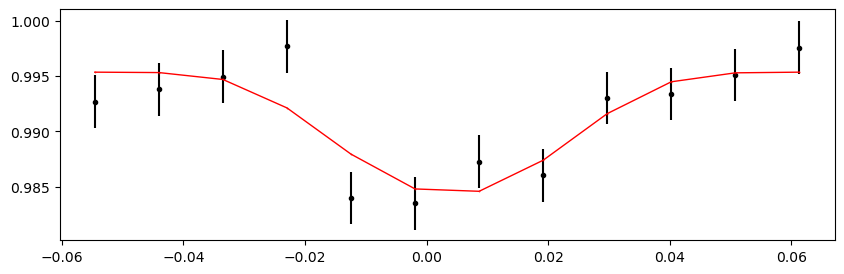

2787.6991405 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.75it/s]


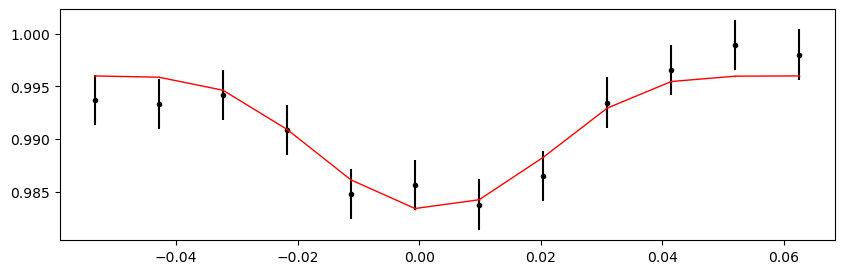

2788.35806536 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.11it/s]


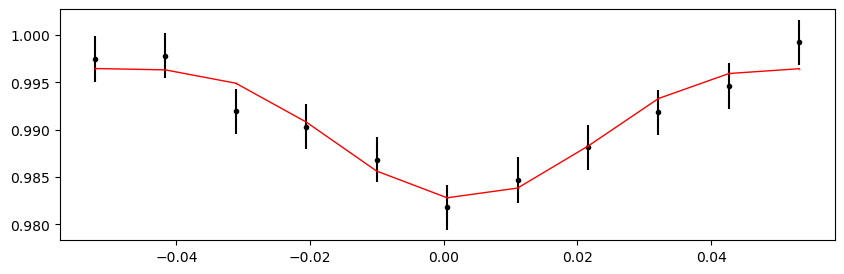

2789.0169902199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.93it/s]


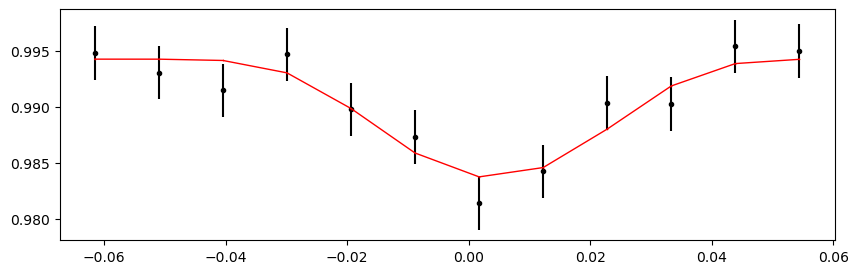

2789.67591508 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.87it/s]


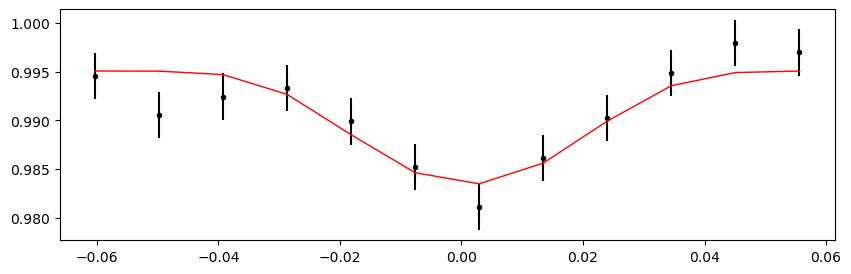

2790.33483994 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.29it/s]


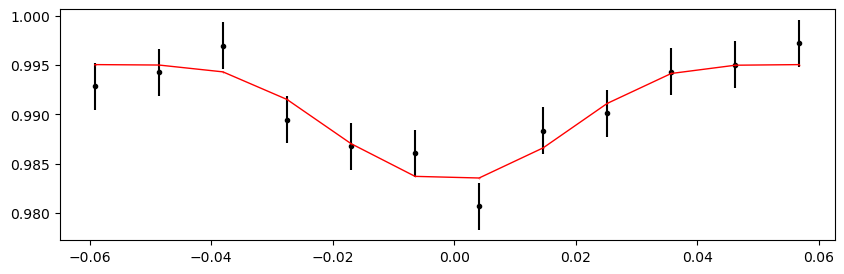

2790.9937648 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.18it/s]


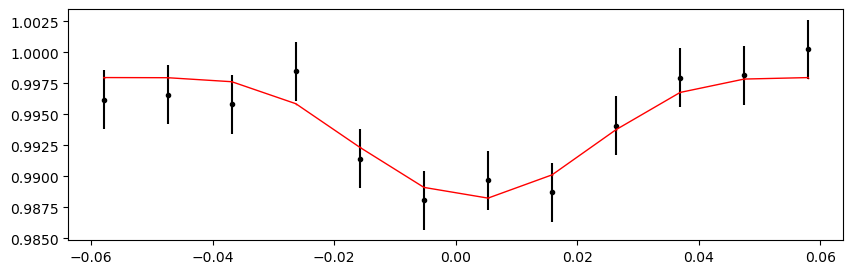

2791.65268966 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.97it/s]


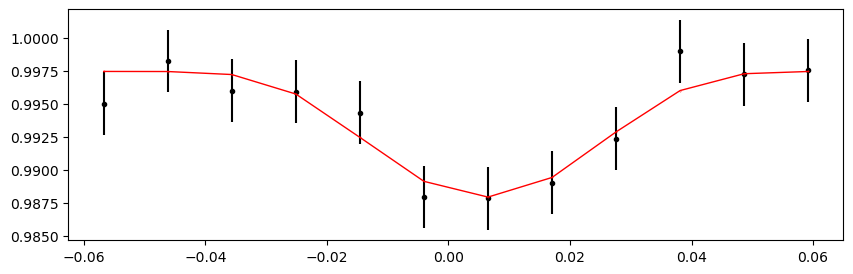

2792.31161452 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.61it/s]


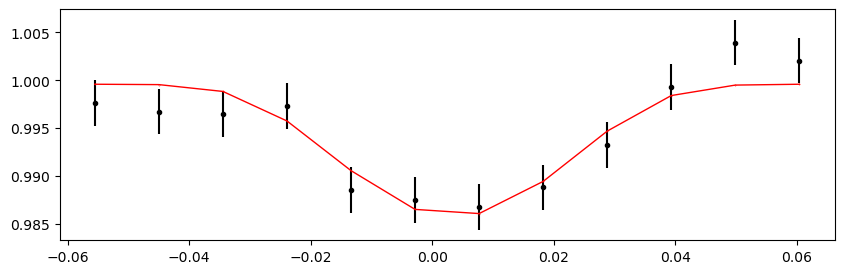

2792.97053938 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.34it/s]


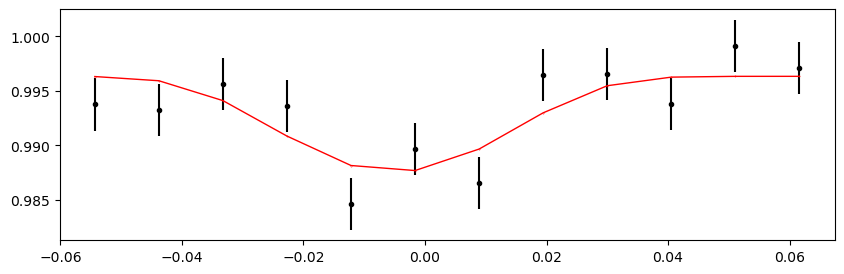

2793.62946424 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 434.07it/s]


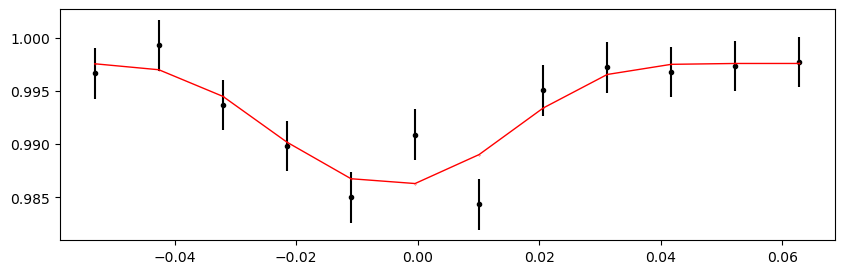

2794.2883891 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.65it/s]


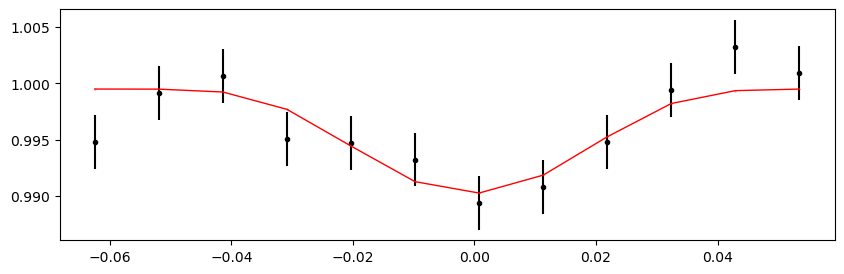

2794.94731396 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 430.46it/s]


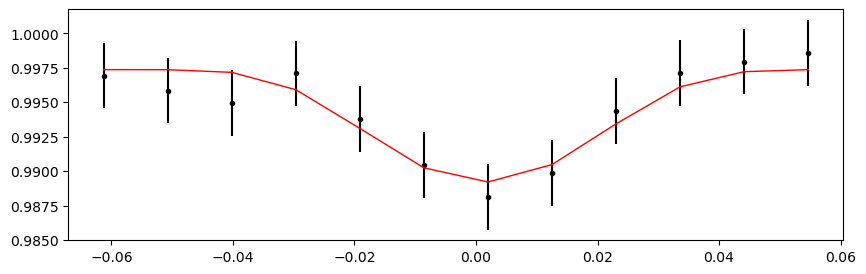

2795.60623882 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.36it/s]


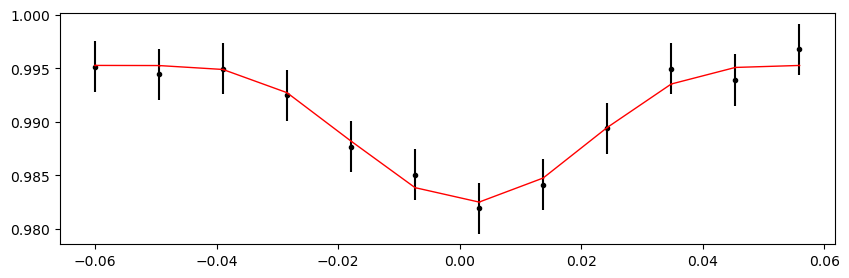

2797.5830134 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.97it/s]


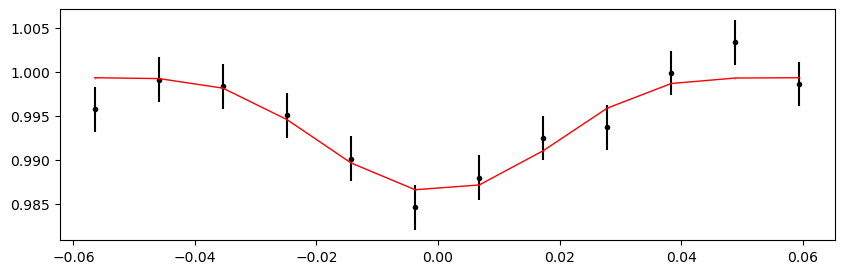

2798.24193826 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.79it/s]


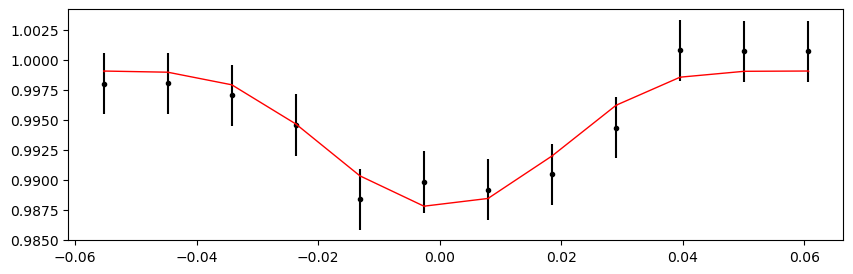

2798.90086312 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 437.95it/s]


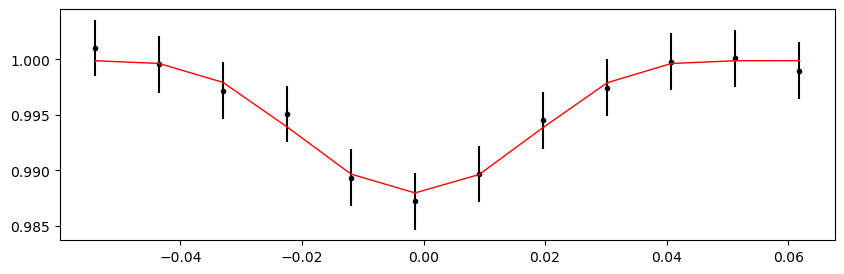

2799.55978798 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.55it/s]


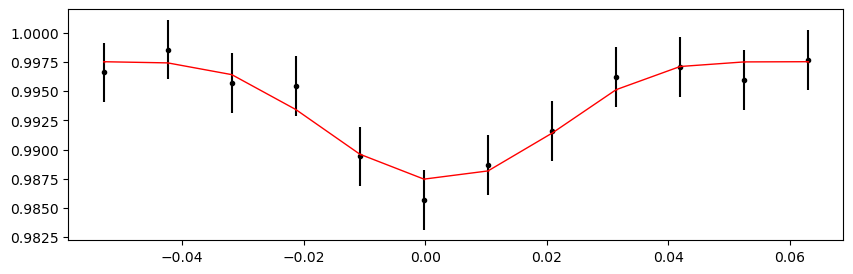

2800.21871284 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.94it/s]


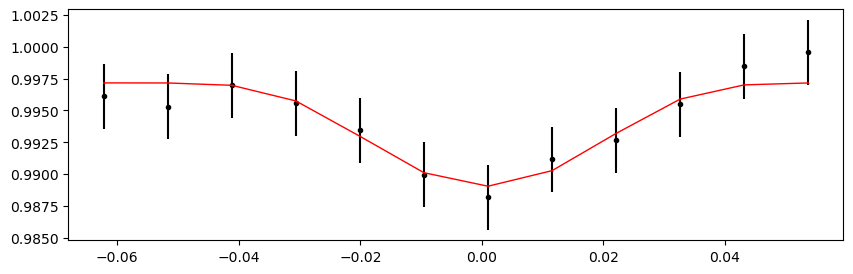

2800.8776377 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.60it/s]


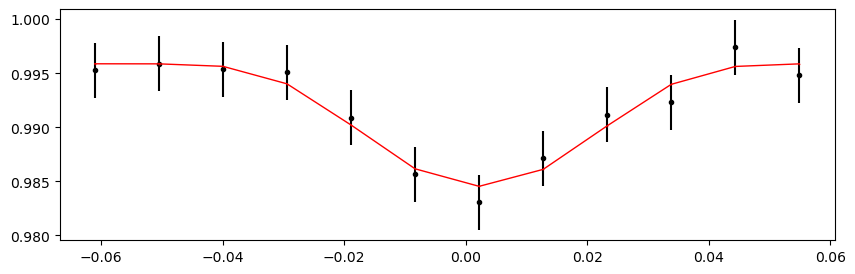

2801.5365625599998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 436.26it/s]


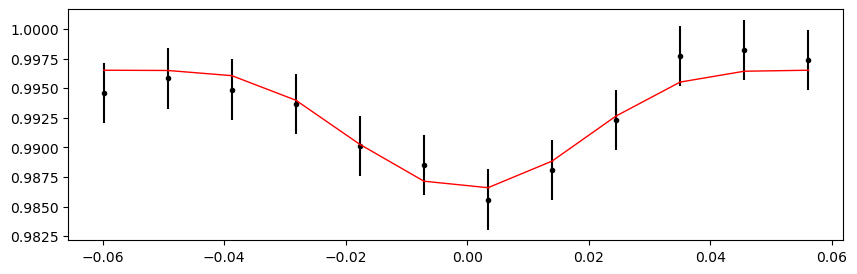

2802.19548742 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.49it/s]


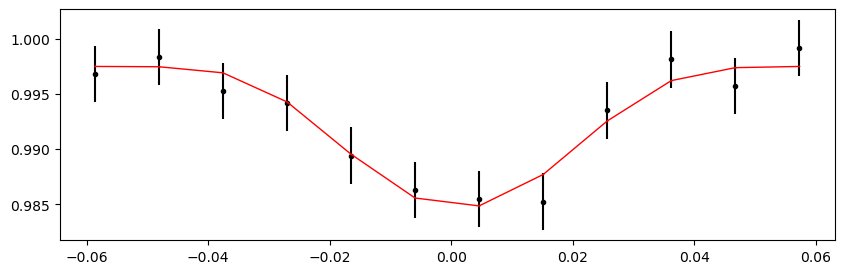

2802.85441228 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.76it/s]


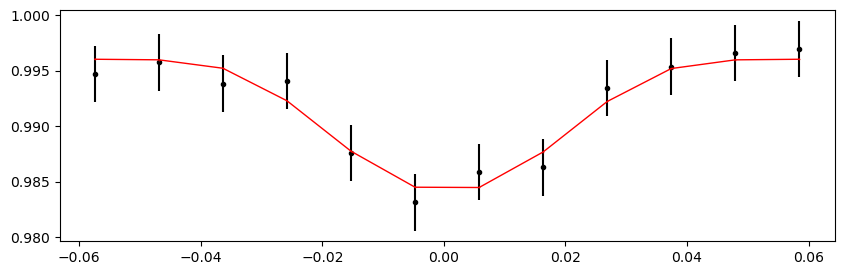

2803.5133371399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.56it/s]


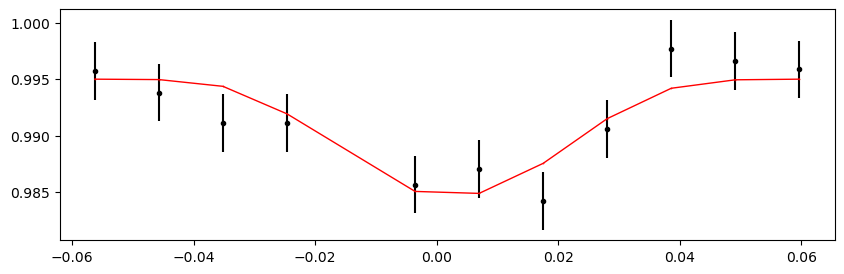

2804.172262 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.63it/s]


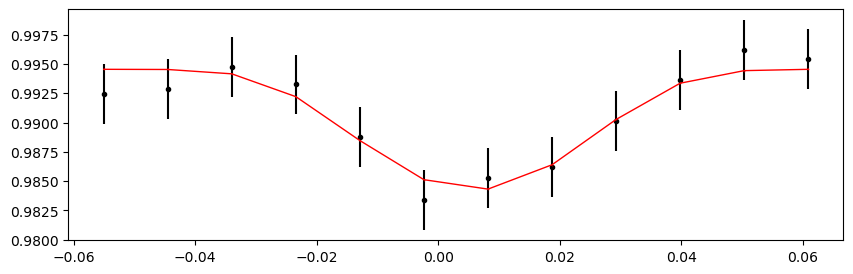

2804.83118686 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.21it/s]


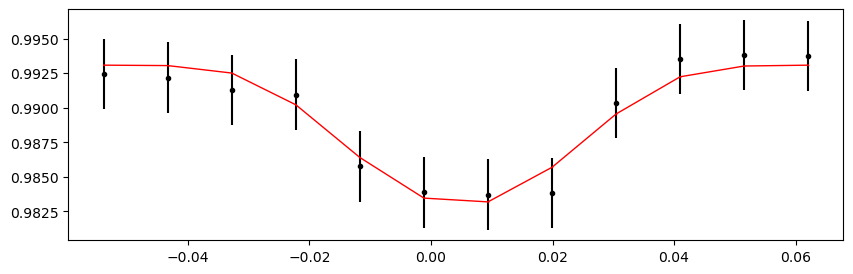

2805.4901117199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.84it/s]


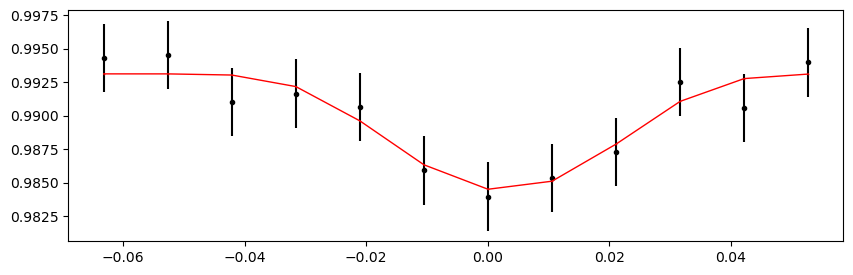

2806.14903658 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.20it/s]


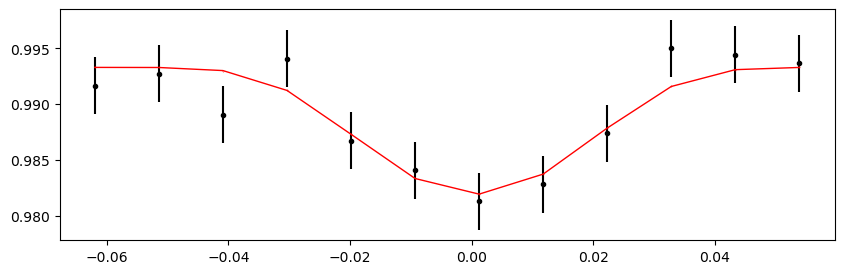

2806.80796144 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 442.02it/s]


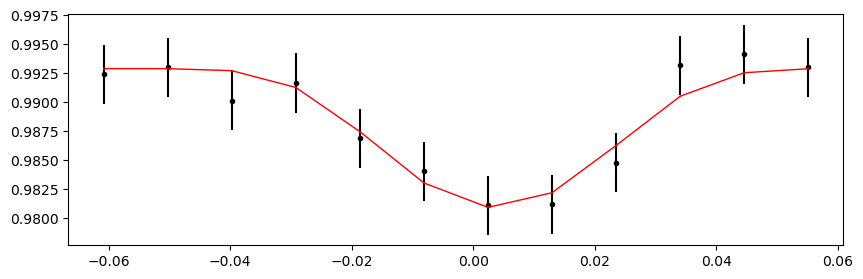

2807.4668862999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.38it/s]


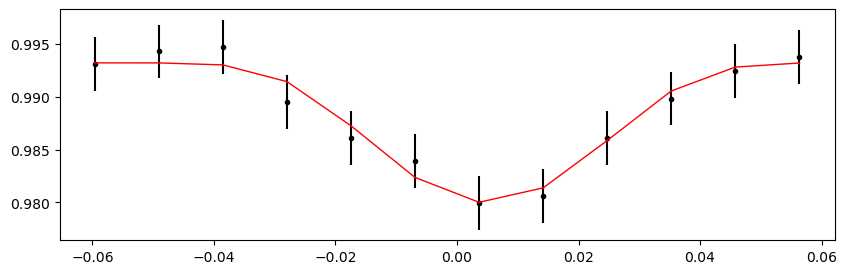

2808.12581116 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.69it/s]


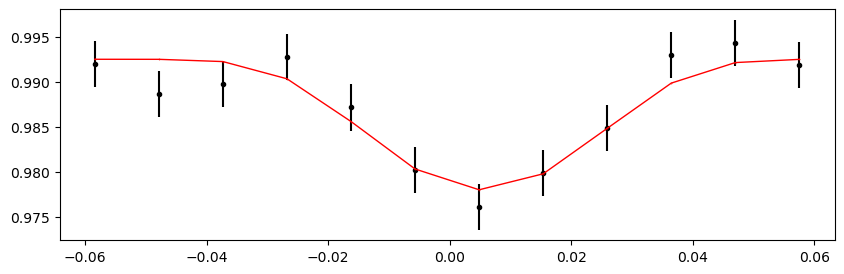

2808.78473602 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.56it/s]


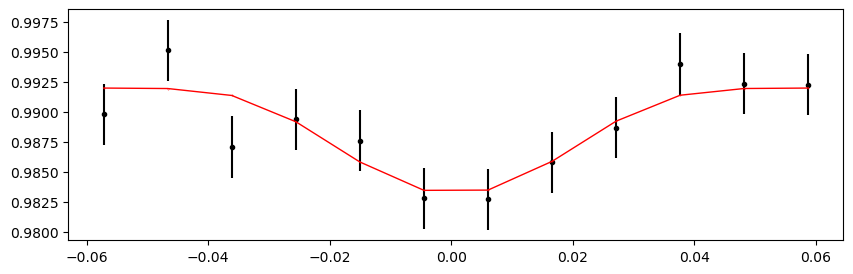

2809.4436608799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.48it/s]


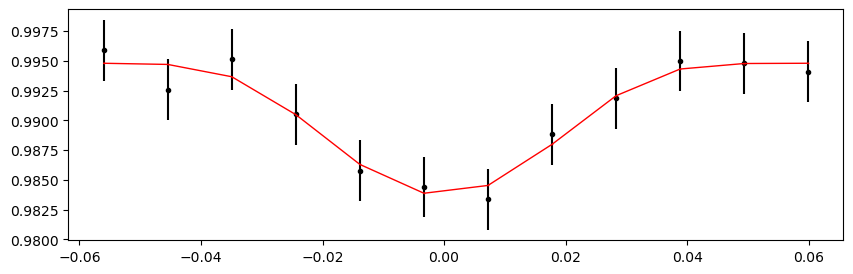

2811.4204354599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.48it/s]


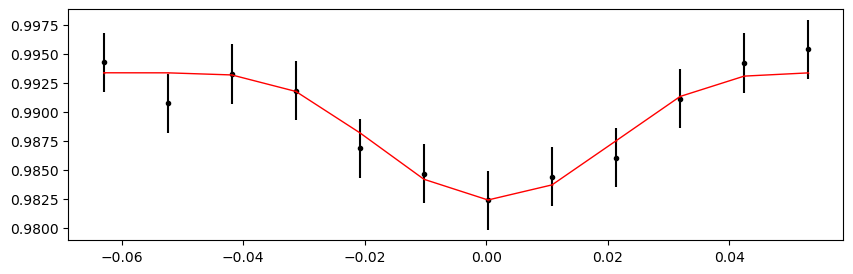

2812.07936032 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.44it/s]


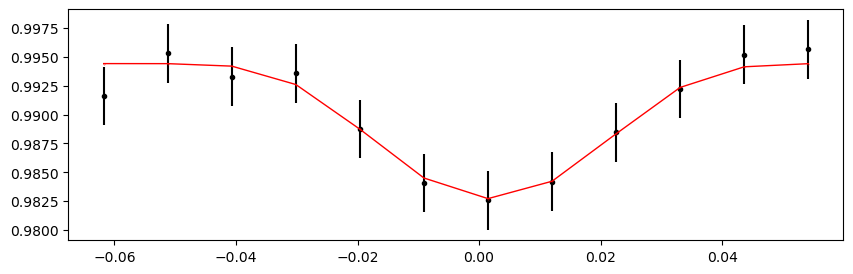

2812.73828518 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.43it/s]


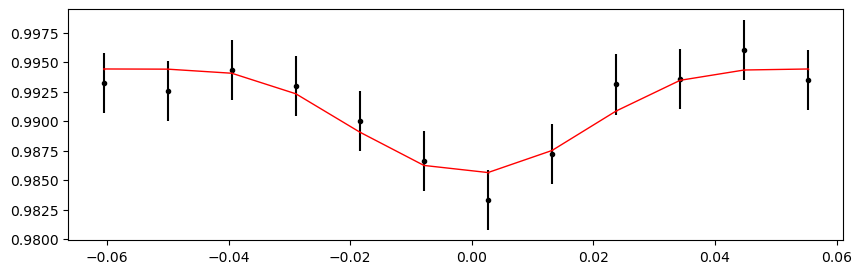

2813.3972100399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.47it/s]


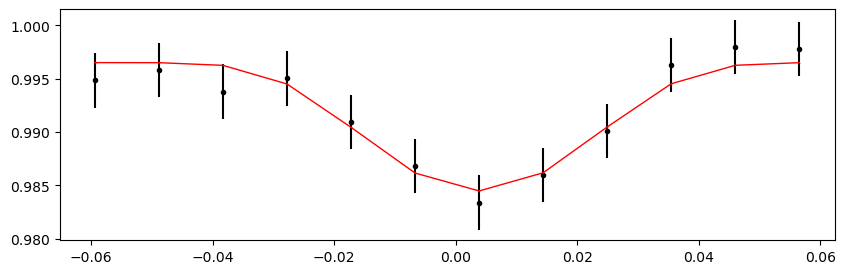

2814.0561349 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.84it/s]


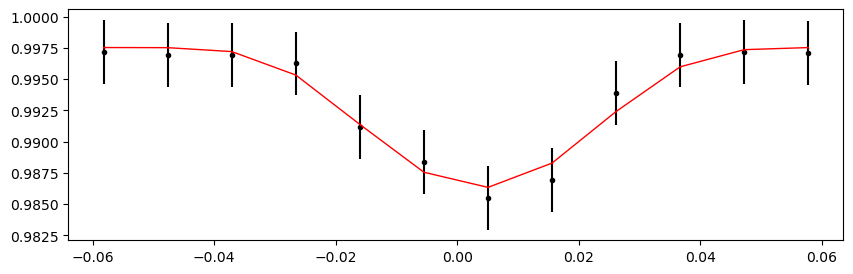

2814.71505976 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.76it/s]


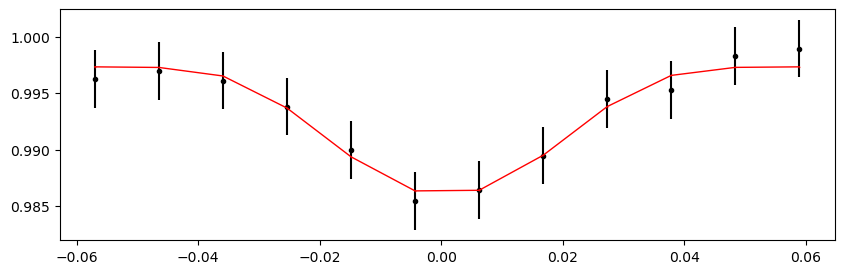

2815.3739846199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 433.71it/s]


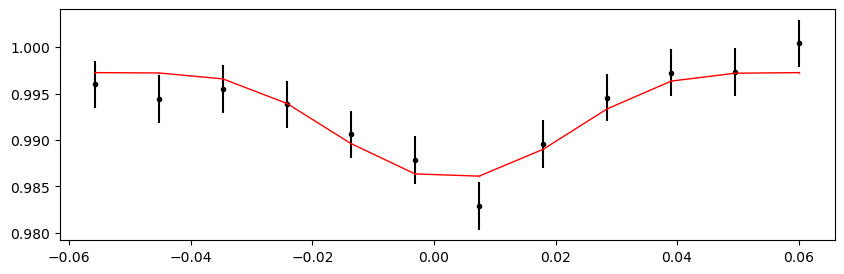

2816.03290948 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.23it/s]


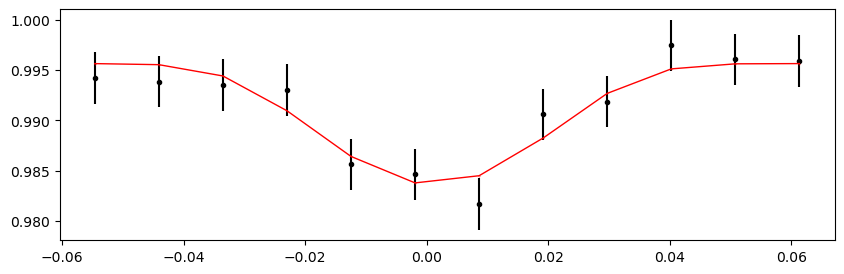

2816.6918343400002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 440.40it/s]


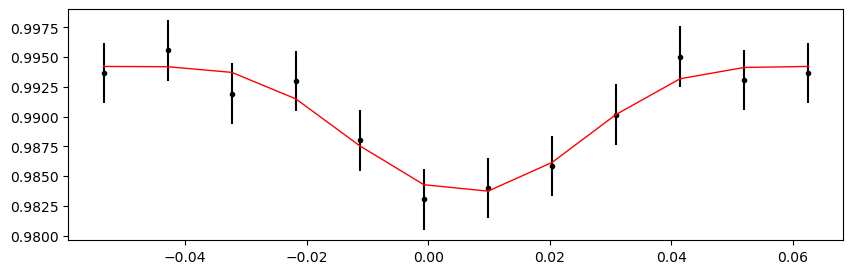

2817.3507591999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 385.02it/s]


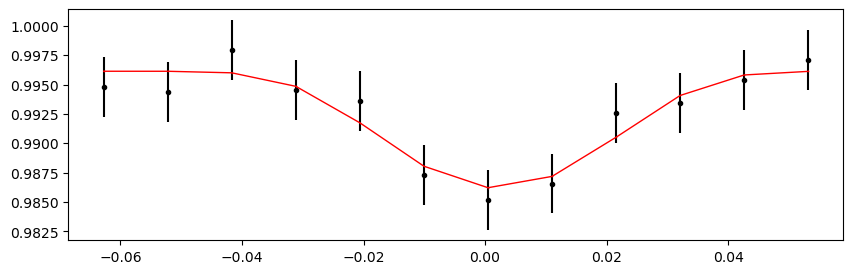

2818.00968406 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.00it/s]


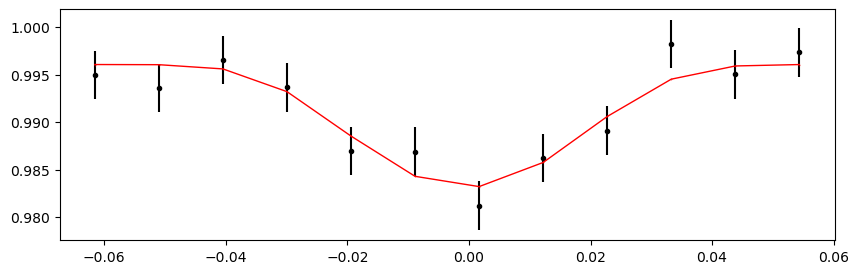

2818.66860892 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.09it/s]


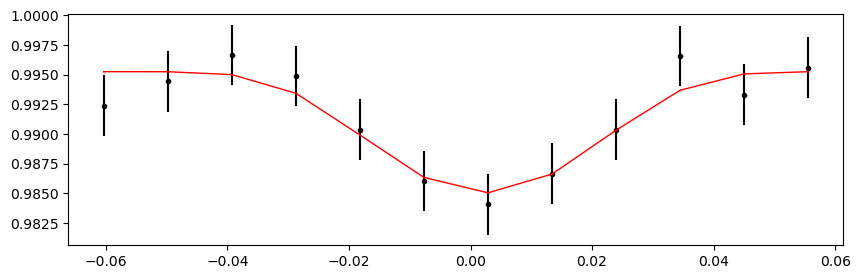

2819.3275337799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.93it/s]


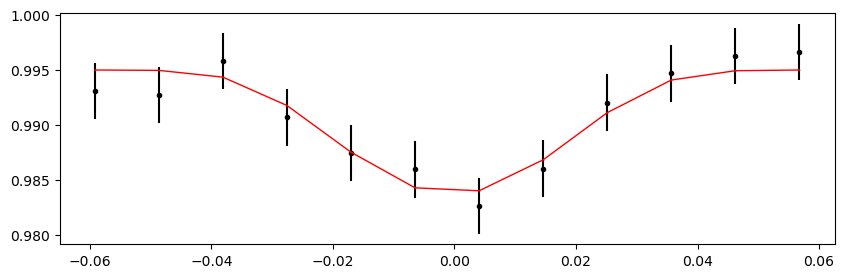

2819.98645864 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 444.41it/s]


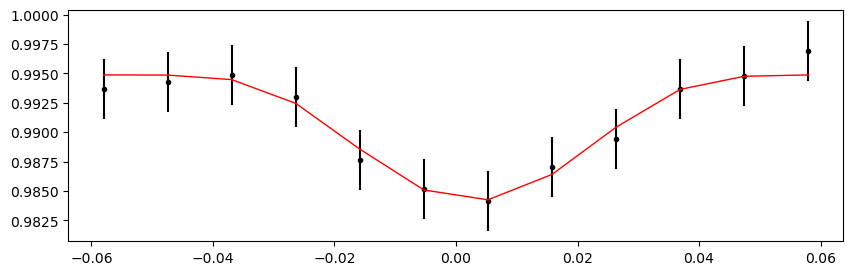

2820.6453835 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 446.69it/s]


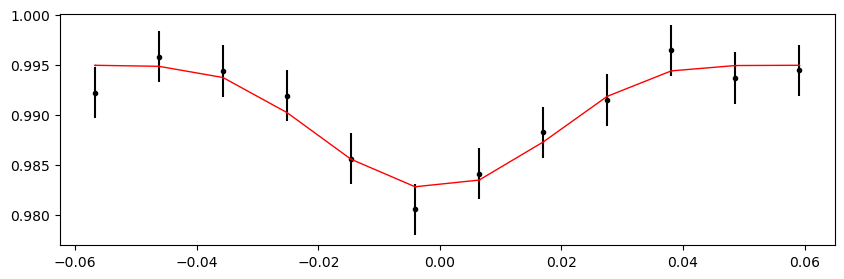

2821.3043083599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.27it/s]


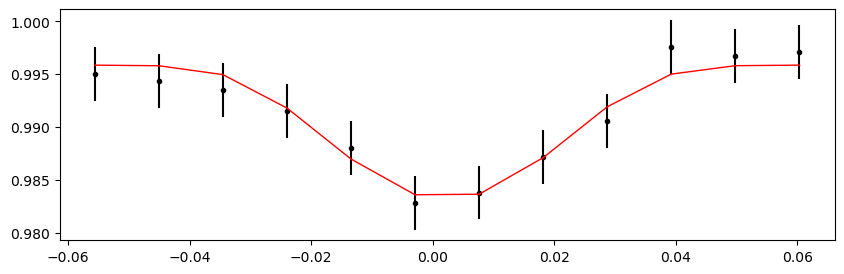

2821.96323322 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 434.85it/s]


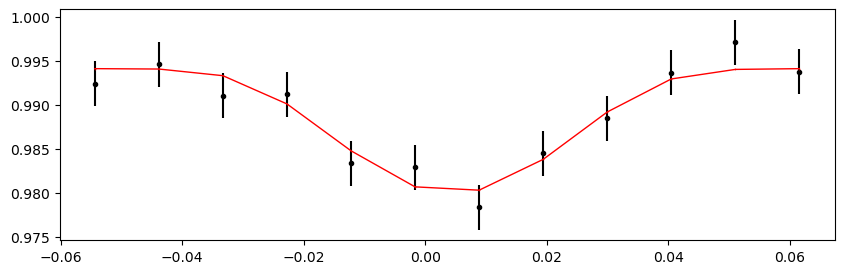

2822.62215808 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.36it/s]


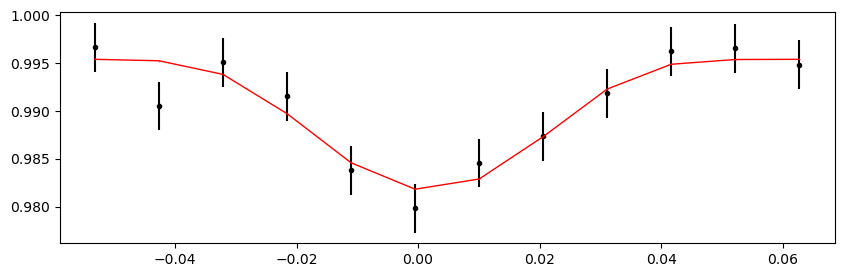

2823.2810829399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 432.00it/s]


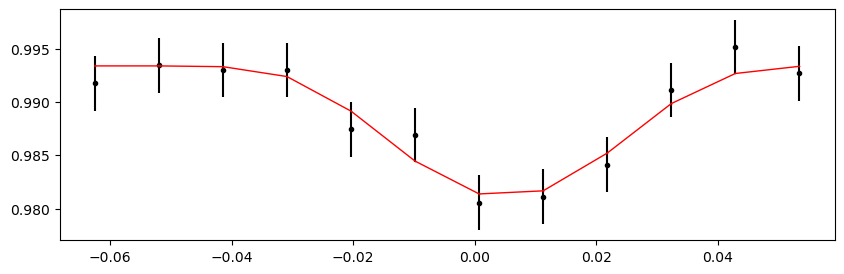

2823.9400078 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.95it/s]


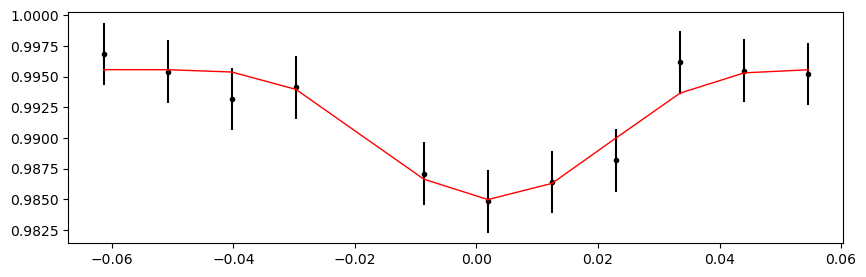

2825.25785752 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 431.69it/s]


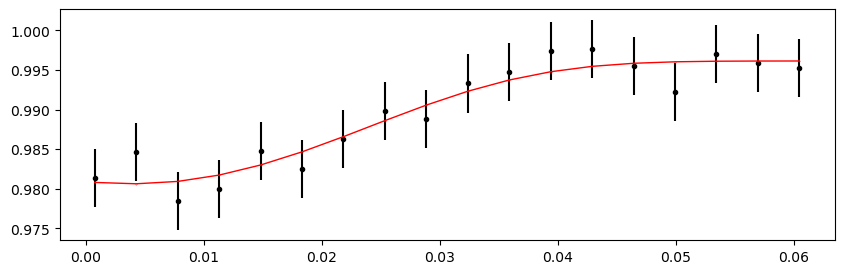

2825.91678238 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.00it/s]


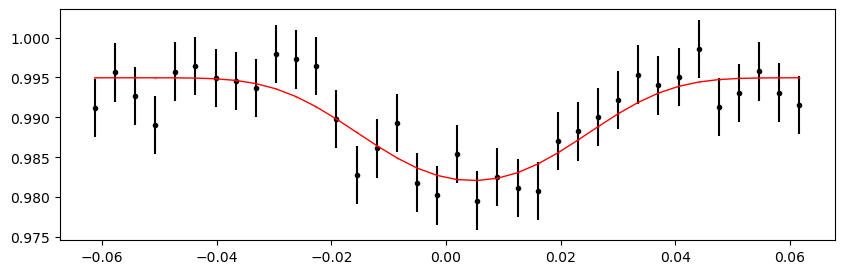

2826.57570724 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 416.77it/s]


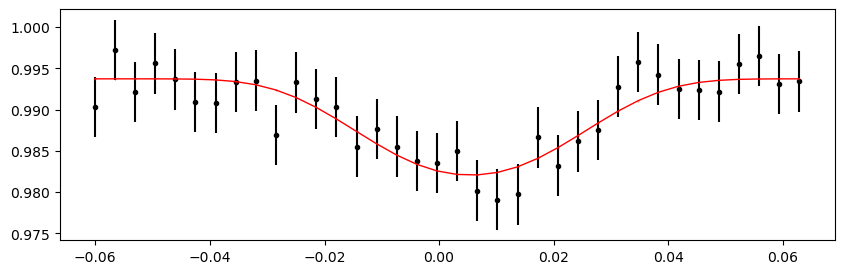

2827.2346321 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.52it/s]


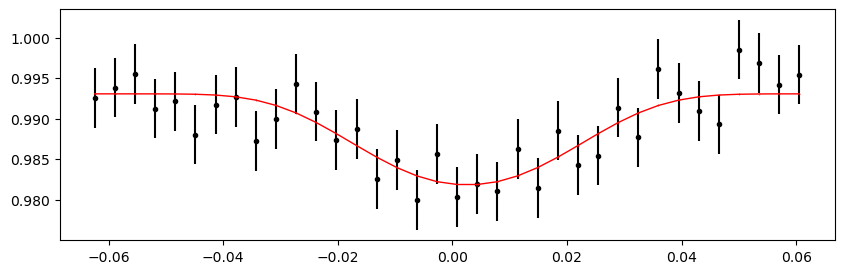

2827.89355696 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.56it/s]


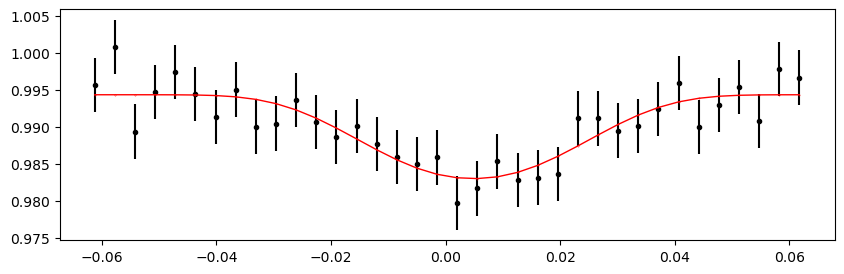

2828.55248182 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.57it/s]


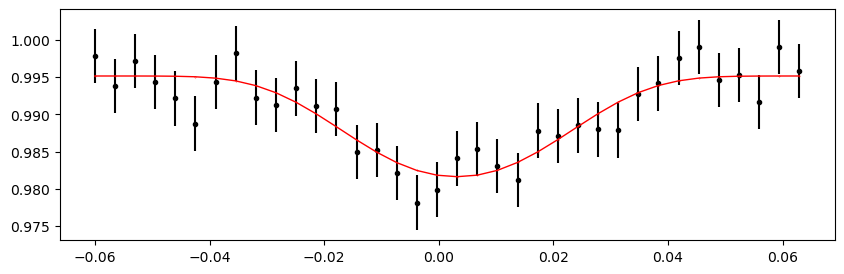

2829.21140668 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.69it/s]


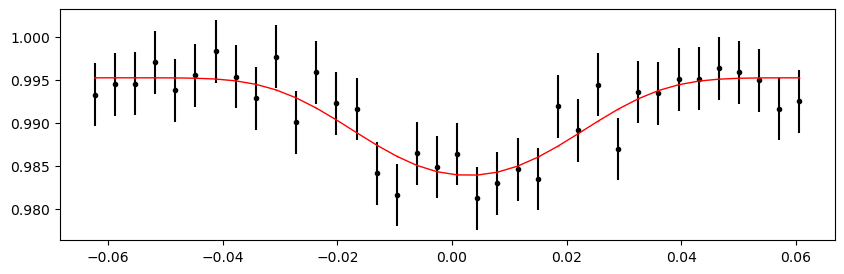

2829.87033154 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.49it/s]


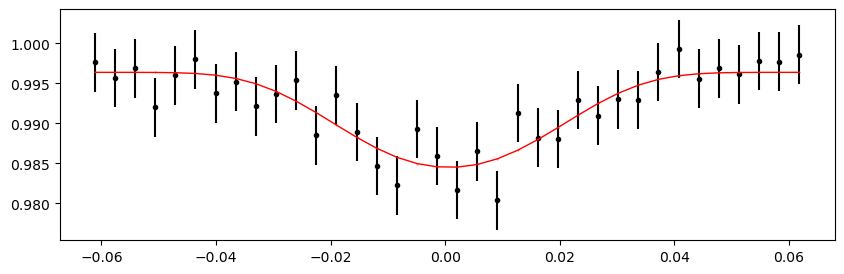

2830.5292564 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.07it/s]


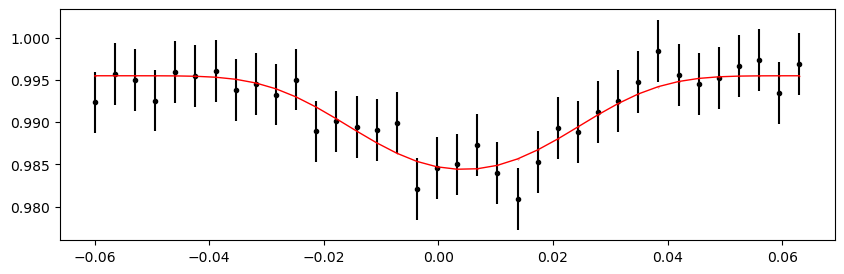

2831.18818126 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.37it/s]


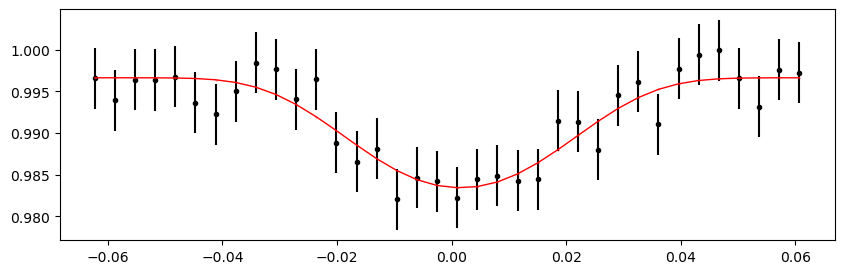

2832.50603098 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.56it/s]


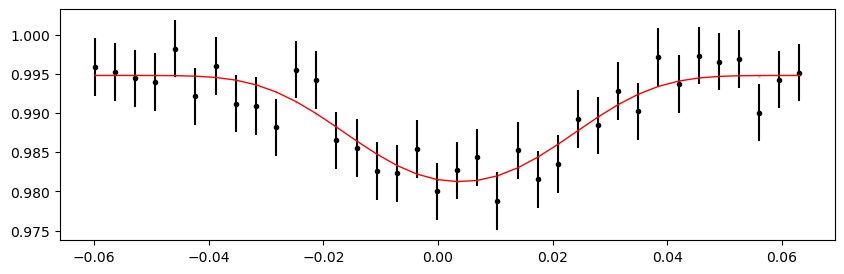

2833.16495584 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.19it/s]


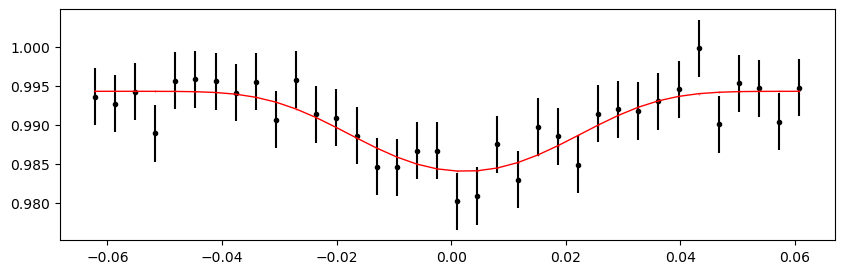

2833.8238807 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.85it/s]


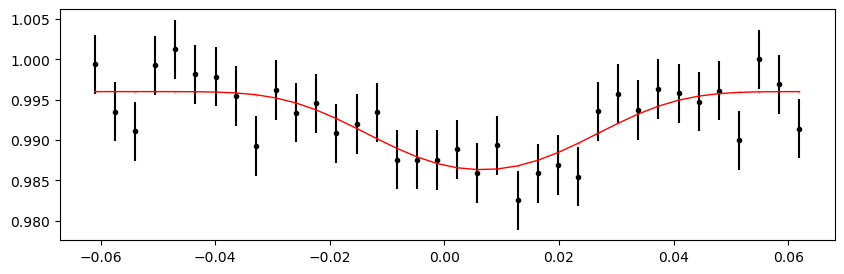

2834.48280556 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.32it/s]


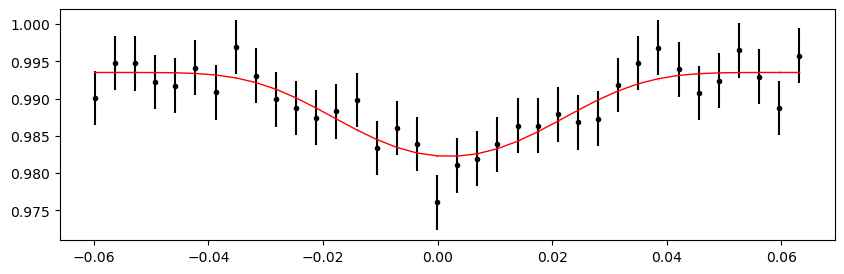

2835.14173042 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.19it/s]


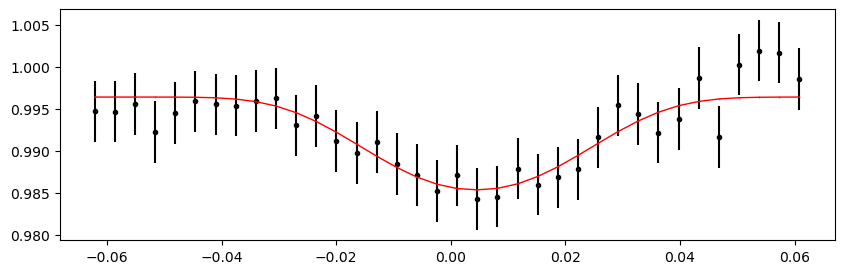

2835.80065528 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 429.51it/s]


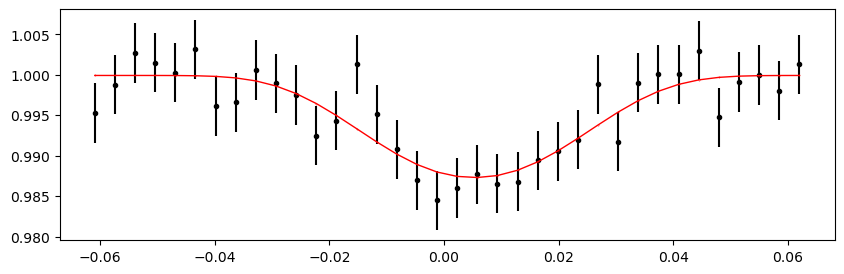

2836.45958014 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.87it/s]


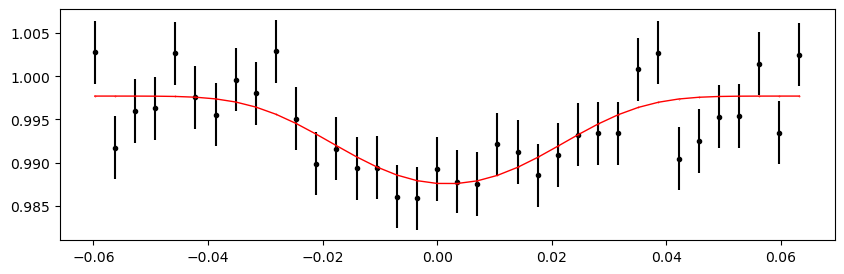

2837.118505 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.44it/s]


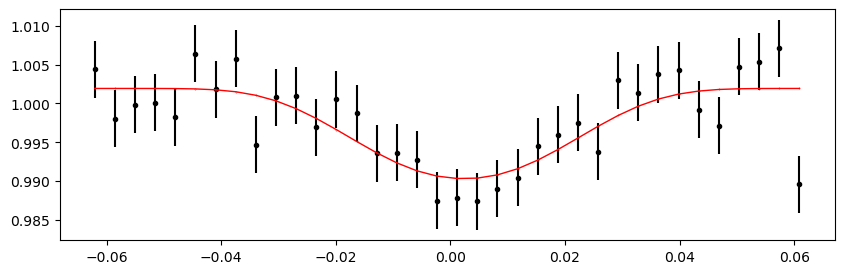

2837.7774298599998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.20it/s]


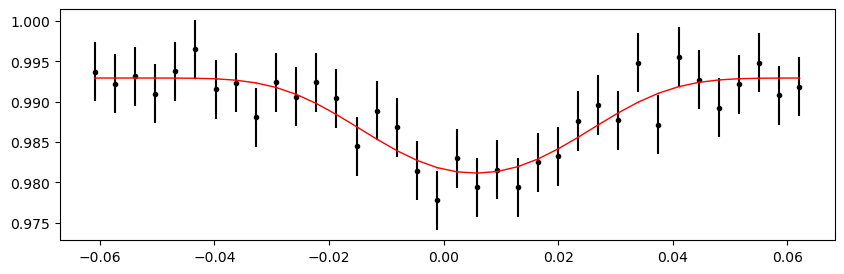

2838.43635472 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.06it/s]


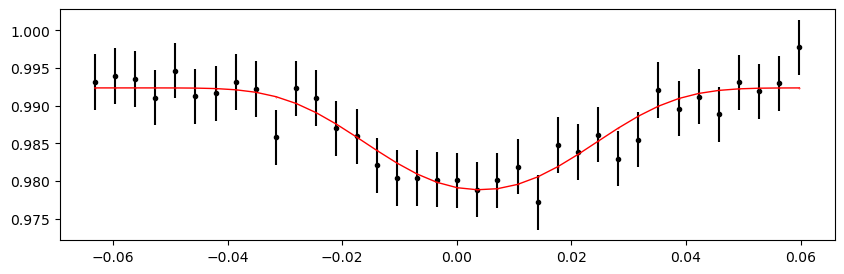

2839.09527958 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.05it/s]


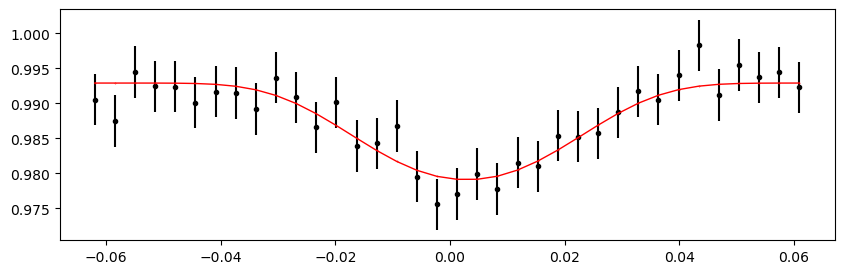

2839.7542044399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.37it/s]


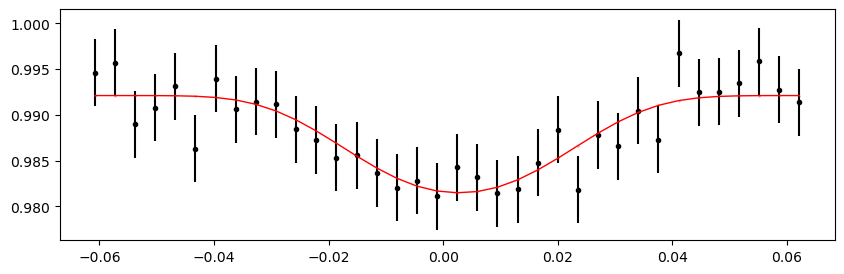

2840.4131293 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.70it/s]


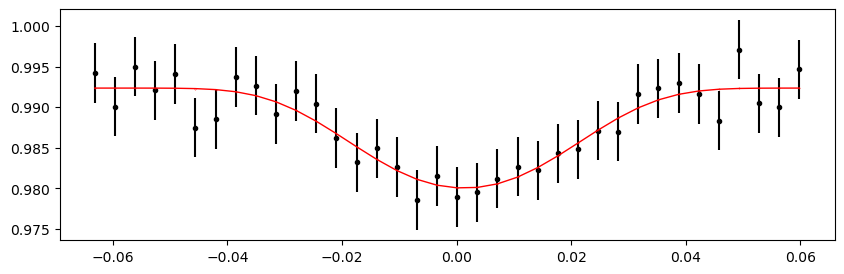

2841.07205416 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.73it/s]


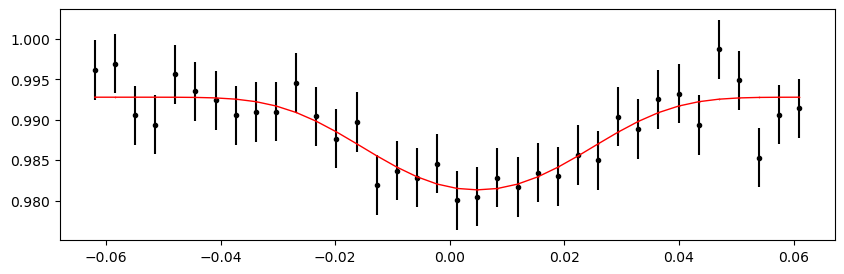

2841.7309790199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.53it/s]


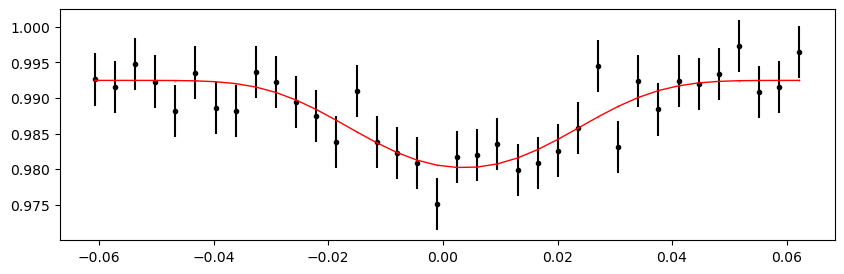

2842.38990388 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.18it/s]


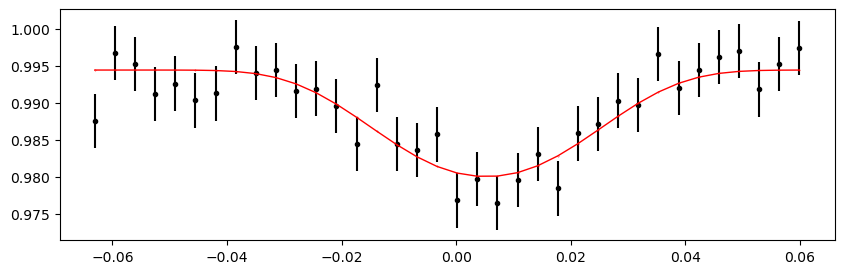

2843.04882874 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.06it/s]


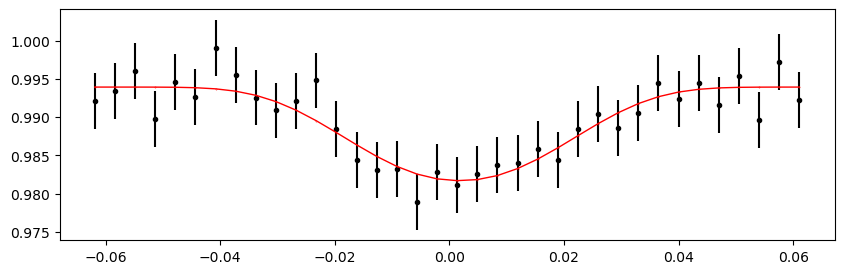

2843.7077535999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.93it/s]


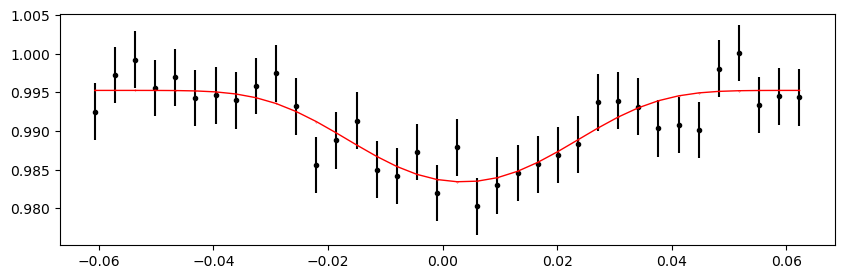

2844.36667846 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.65it/s]


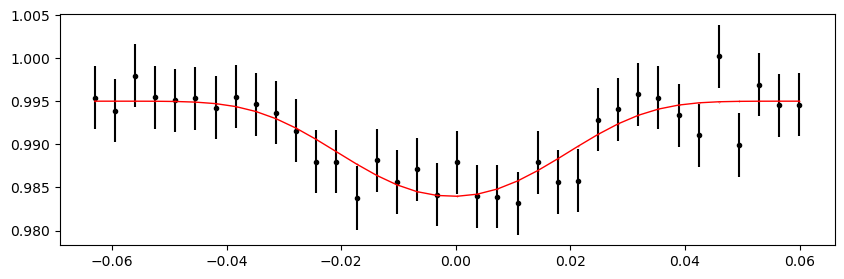

2845.02560332 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.87it/s]


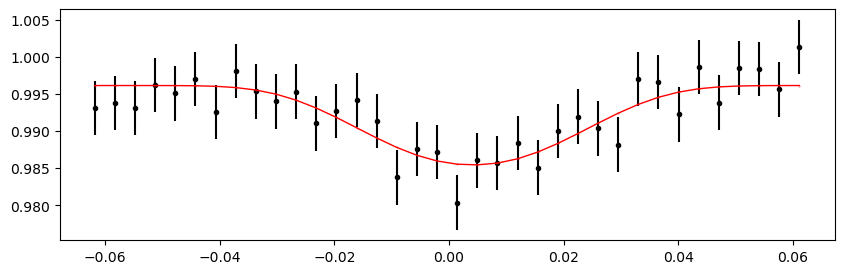

2845.6845281799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 407.54it/s]


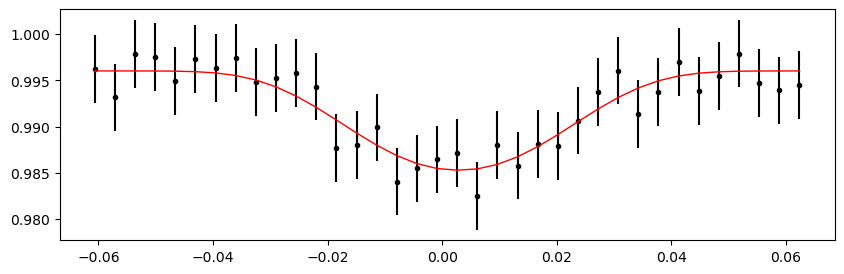

2846.34345304 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.74it/s]


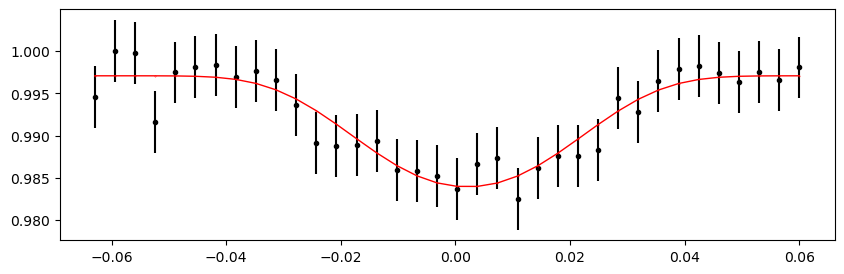

2847.0023779 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.11it/s]


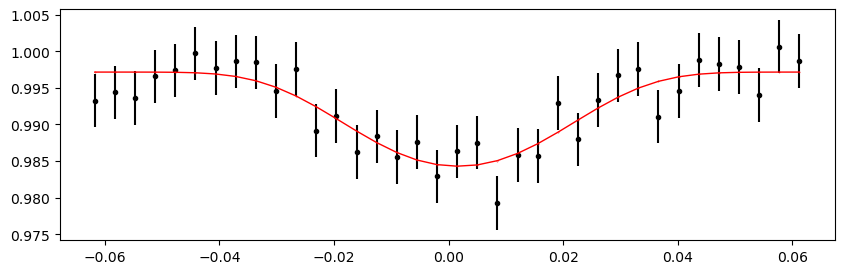

2847.6613027599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.88it/s]


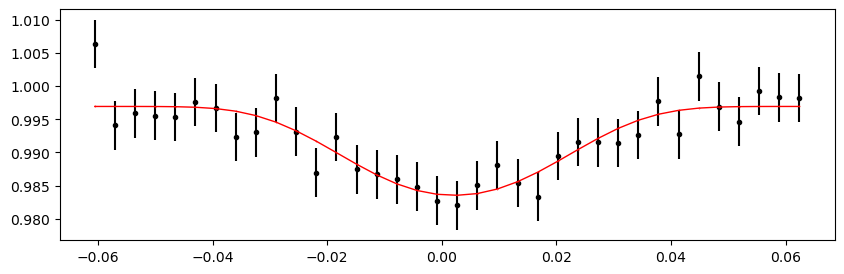

2848.32022762 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.20it/s]


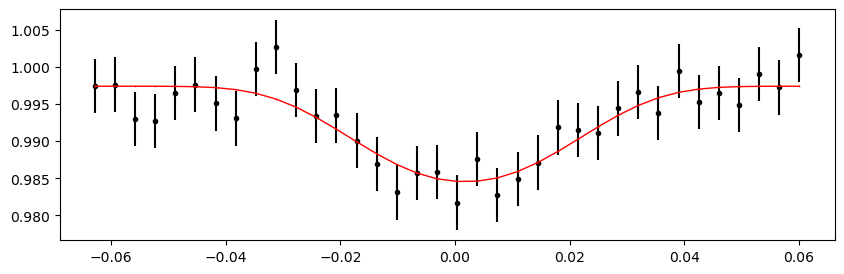

2848.97915248 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.48it/s]


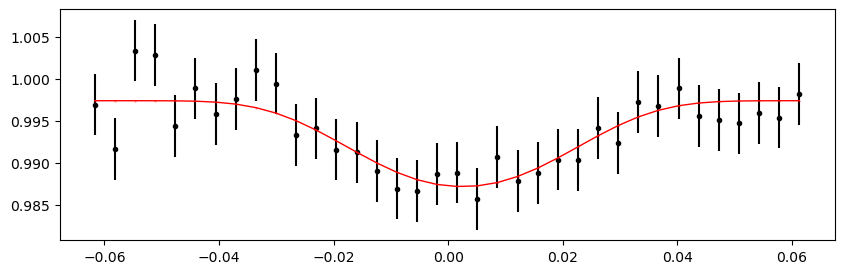

2849.6380773399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.08it/s]


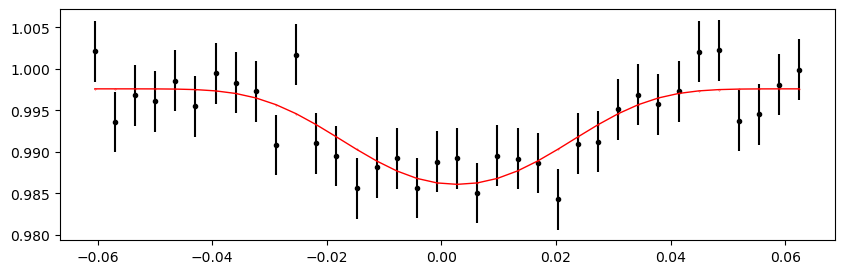

2850.2970022 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.13it/s]


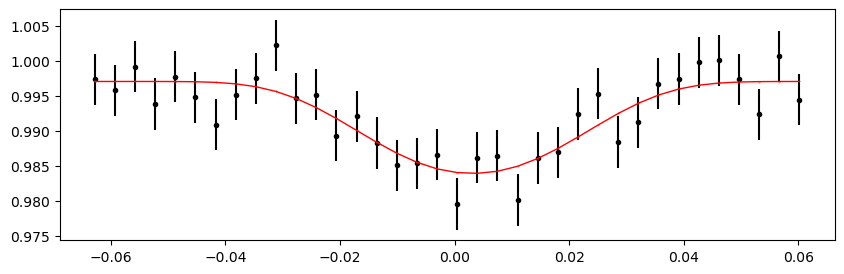

2850.95592706 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.76it/s]


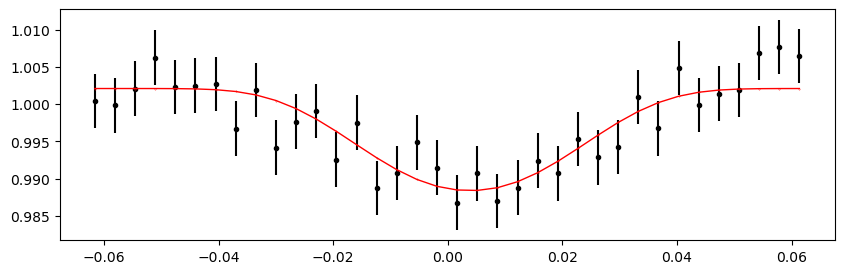

2851.6148519199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.43it/s]


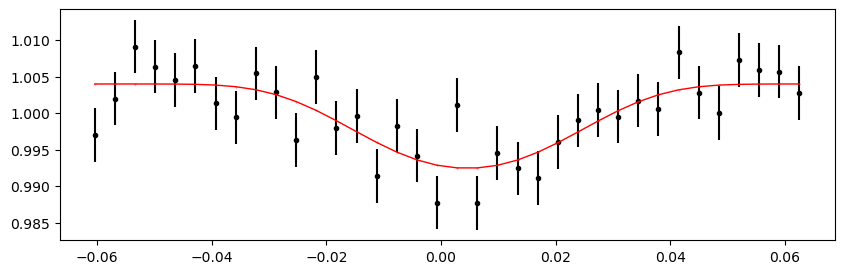

2852.27377678 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.47it/s]


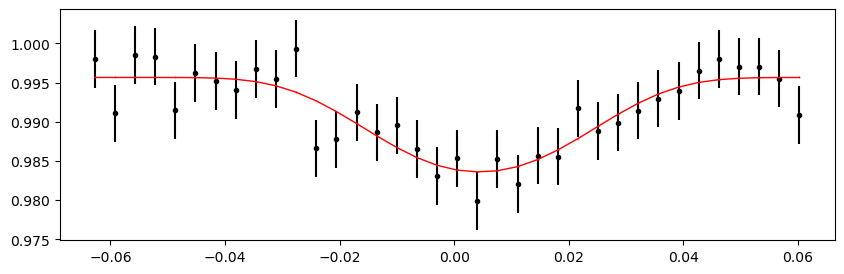

2852.9327016400002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.97it/s]


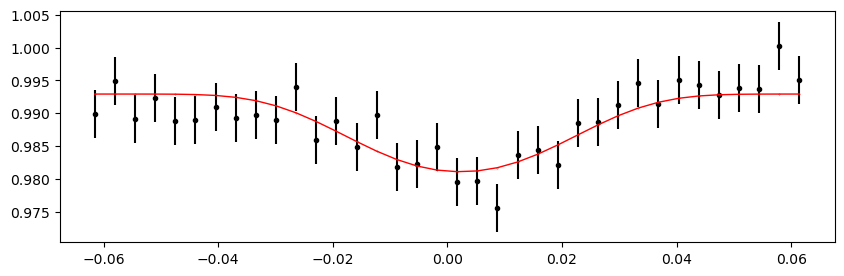

2853.5916264999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.59it/s]


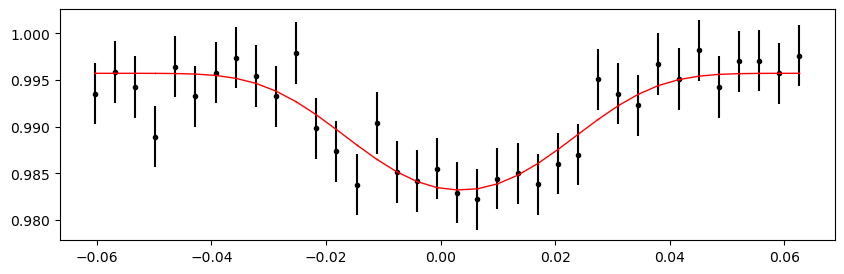

2854.25055136 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.39it/s]


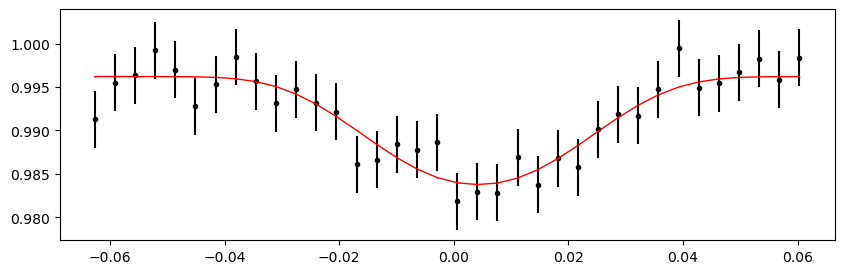

2854.90947622 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.28it/s]


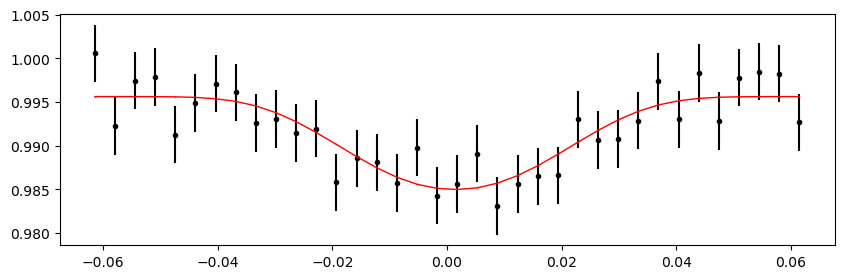

2855.5684010799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.10it/s]


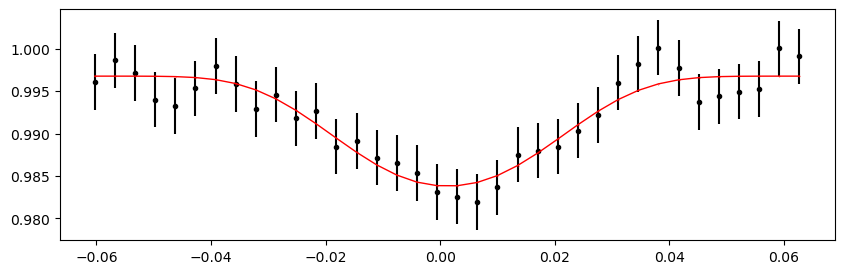

2856.22732594 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.13it/s]


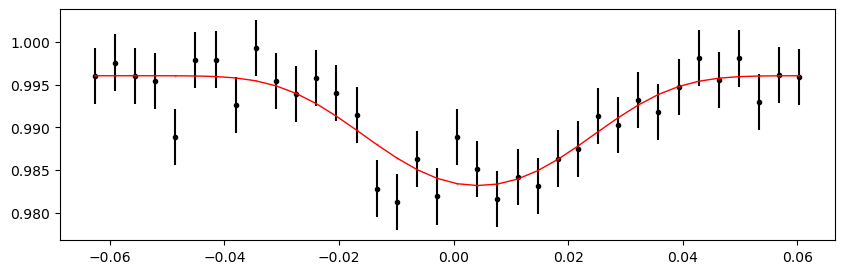

2856.8862508 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.81it/s]


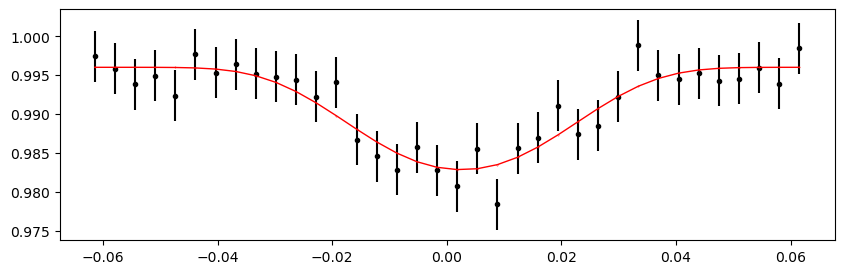

2857.5451756599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.60it/s]


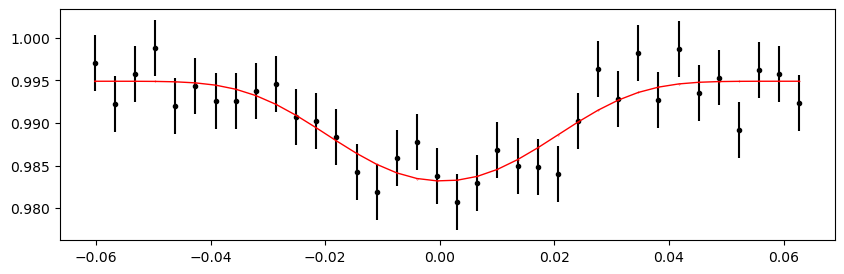

2858.20410052 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.47it/s]


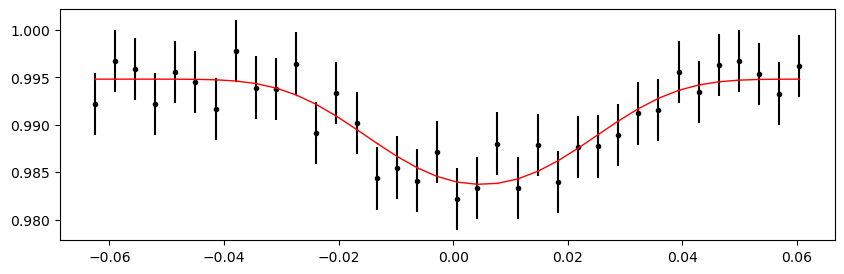

2858.86302538 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.42it/s]


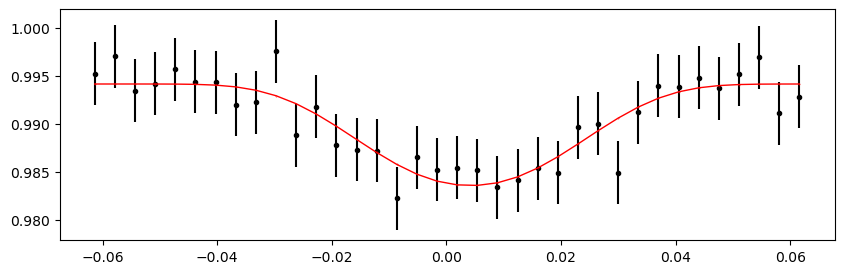

2859.5219502399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.53it/s]


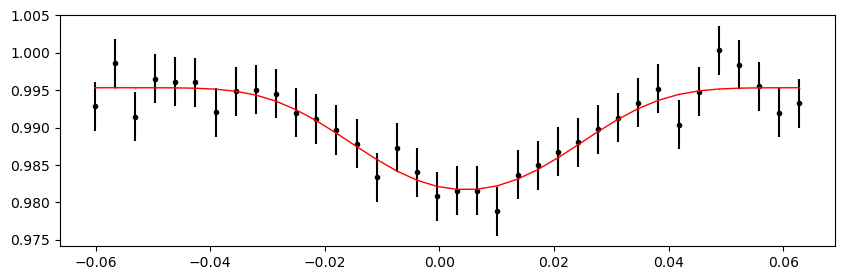

2860.1808751 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.92it/s]


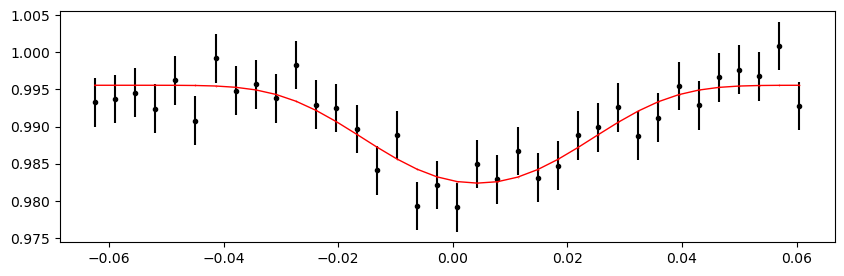

2860.83979996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.89it/s]


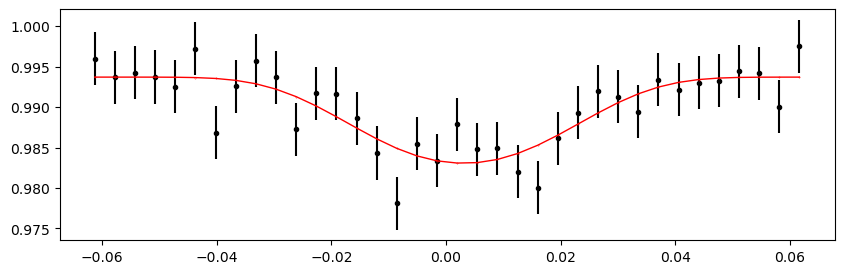

2861.49872482 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.34it/s]


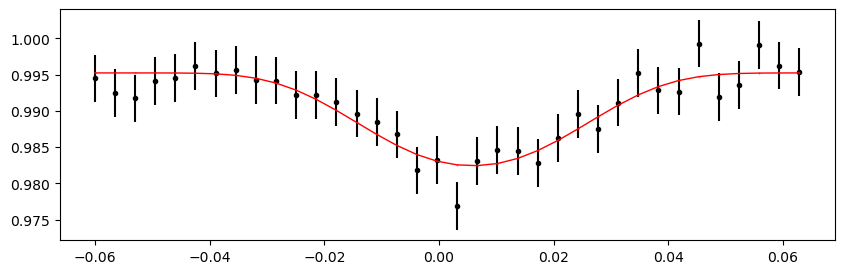

2862.15764968 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.57it/s]


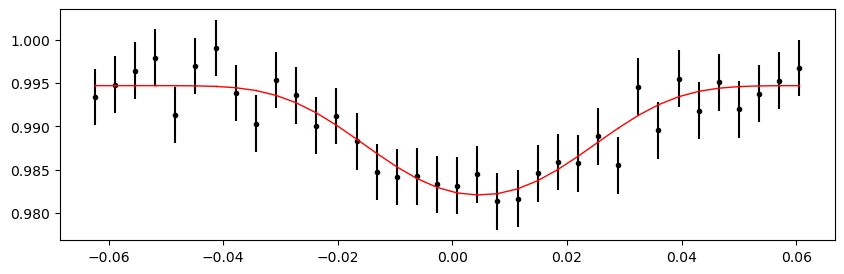

2862.81657454 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.33it/s]


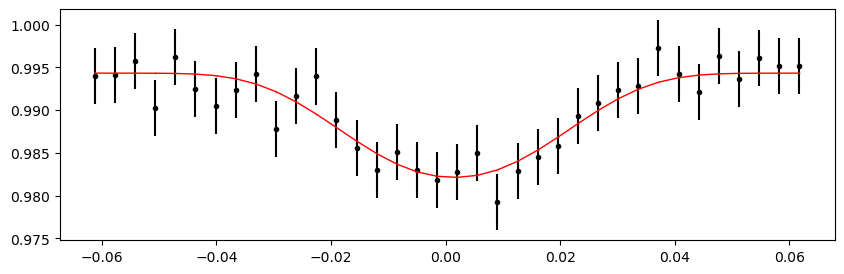

2866.7701237 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.90it/s]


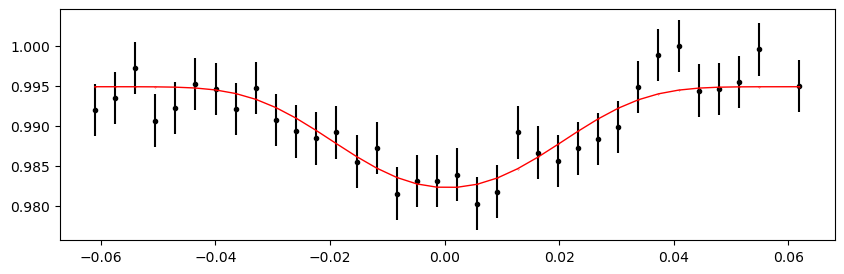

Time 2867.42904856 does not have enough data points: 4
2868.08797342 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.04it/s]


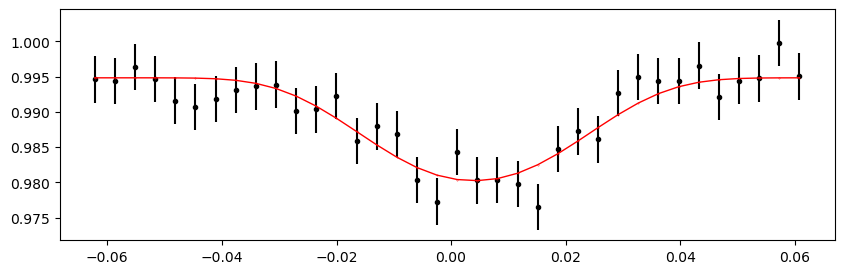

2868.74689828 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.84it/s]


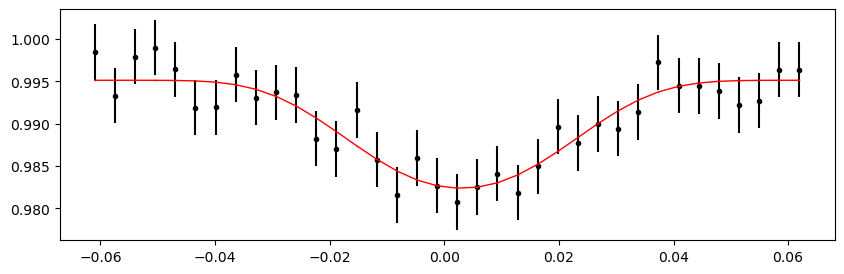

2869.40582314 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.72it/s]


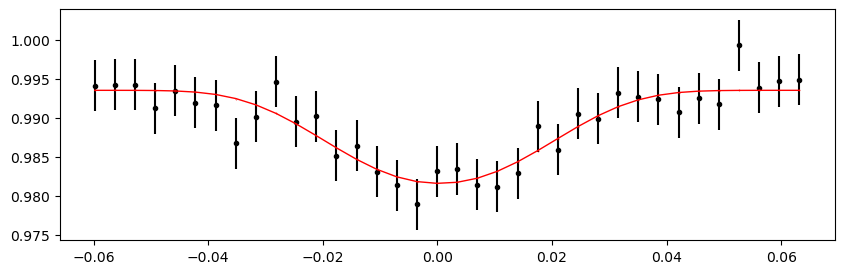

2870.064748 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.84it/s]


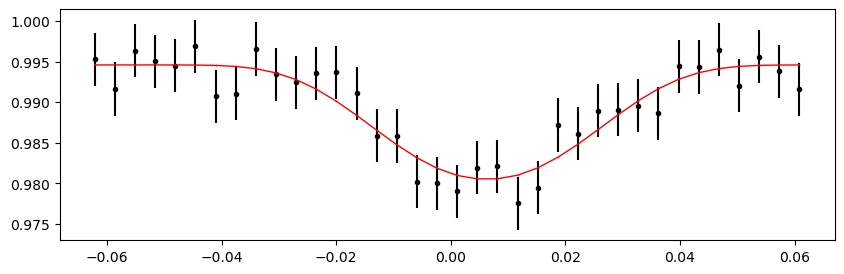

2870.72367286 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.90it/s]


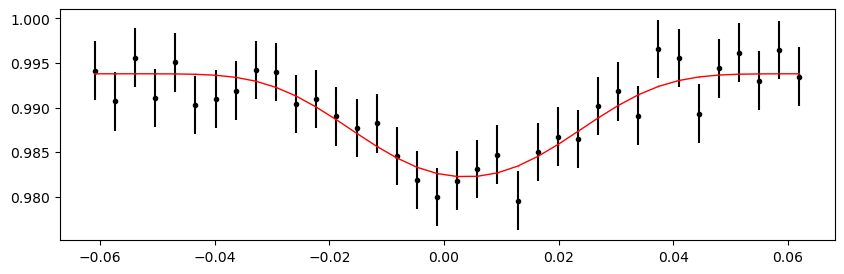

2871.38259772 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.12it/s]


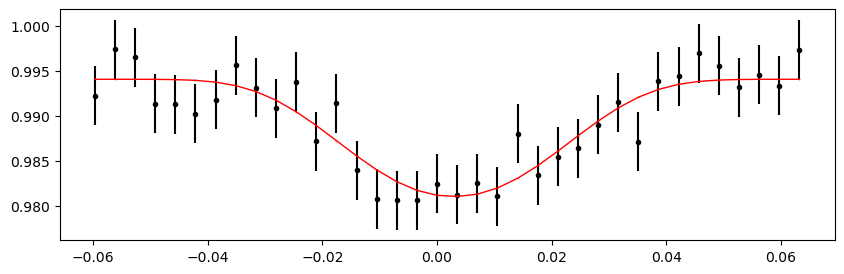

2872.0415225799998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.39it/s]


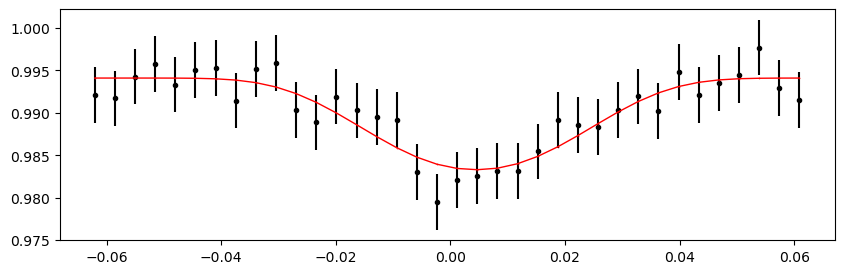

2872.70044744 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.05it/s]


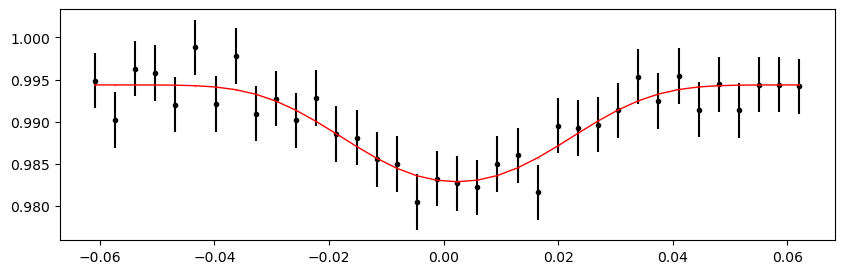

2873.3593723 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.33it/s]


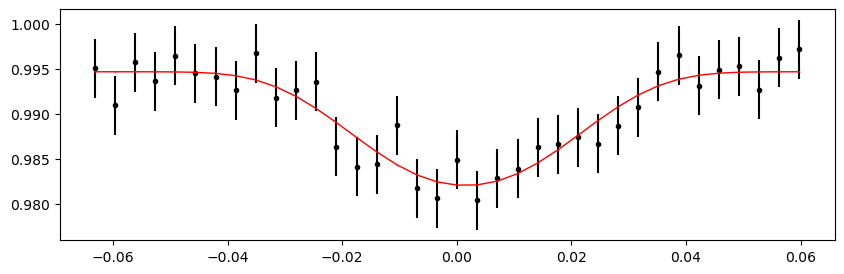

2874.0182971599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.65it/s]


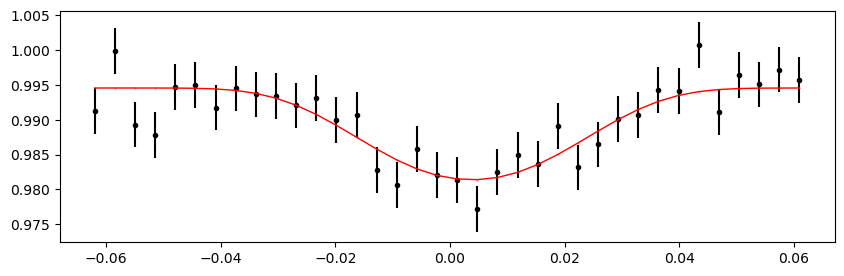

2875.33614688 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.15it/s]


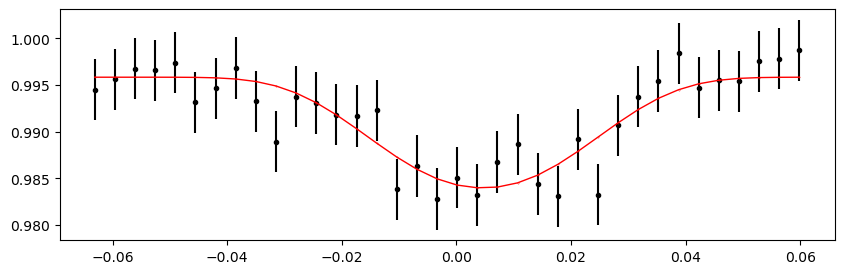

2875.9950717399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.49it/s]


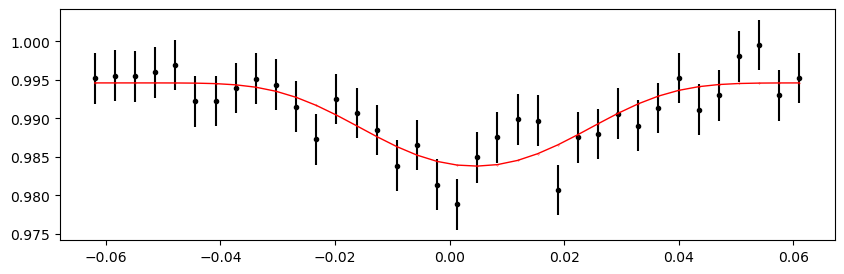

2876.6539966 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.73it/s]


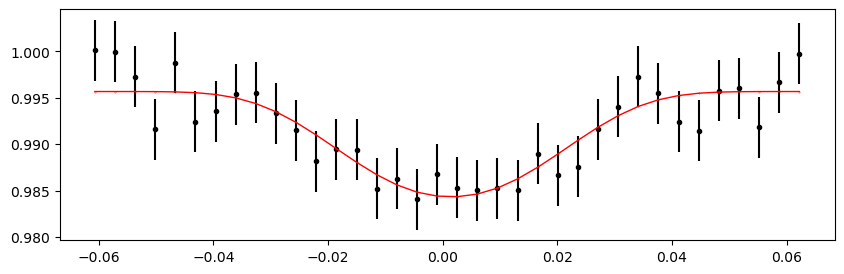

2877.31292146 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.18it/s]


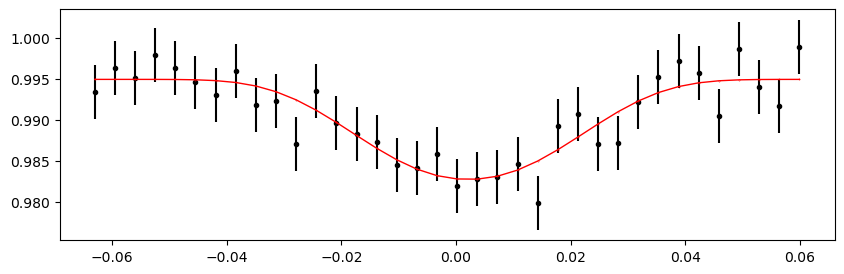

2877.9718463199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.56it/s]


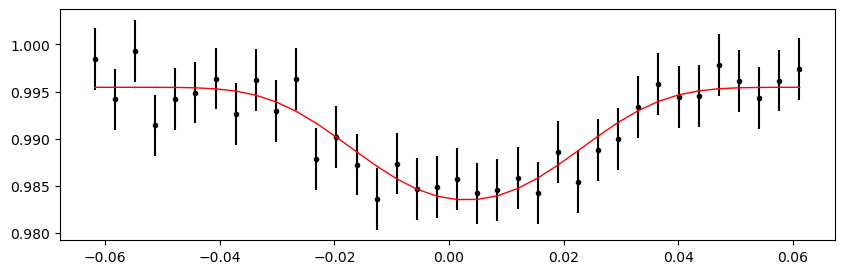

2878.63077118 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.33it/s]


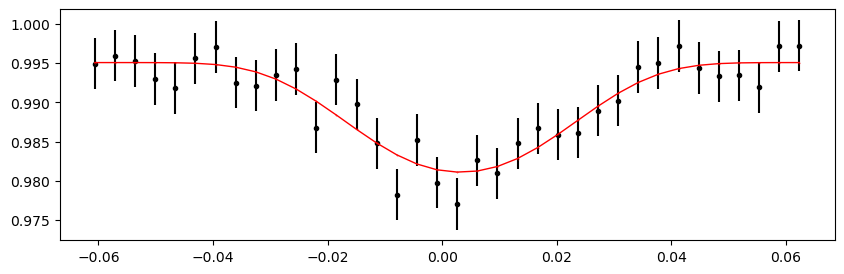

2879.28969604 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.53it/s]


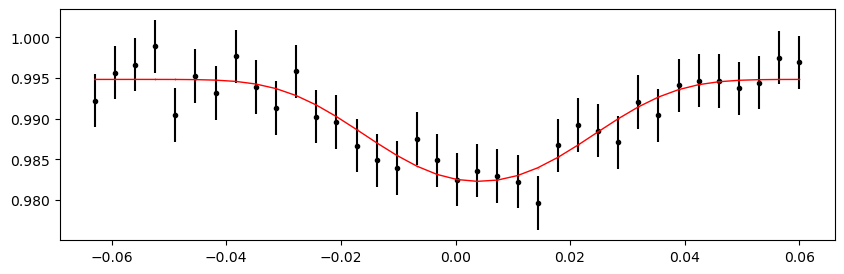

2879.9486208999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.70it/s]


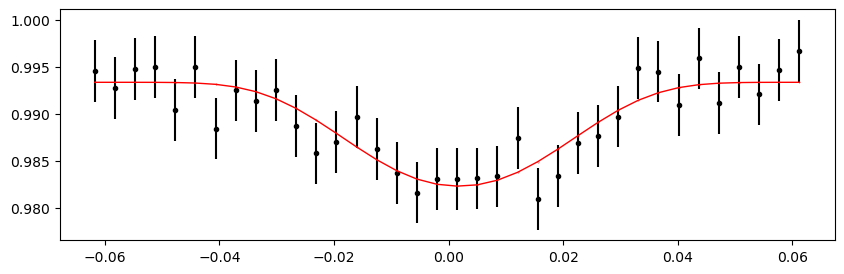

2880.60754576 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.87it/s]


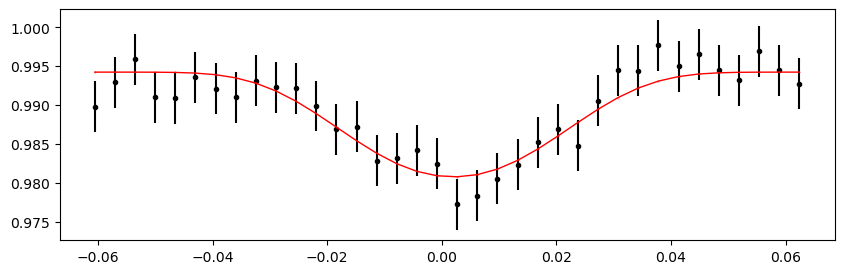

2881.26647062 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.74it/s]


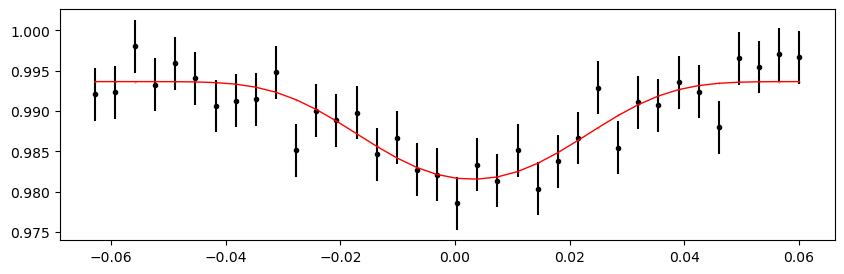

2881.9253954799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.83it/s]


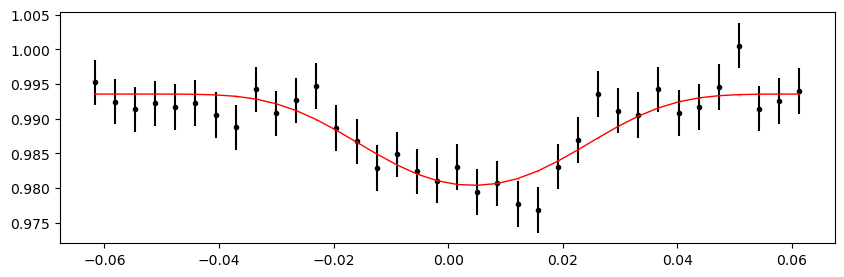

2882.58432034 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.26it/s]


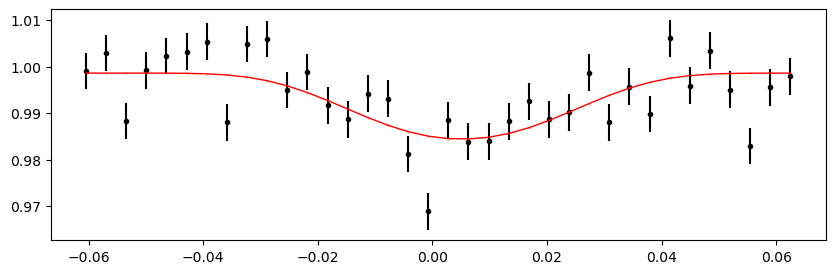

2883.2432452 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.87it/s]


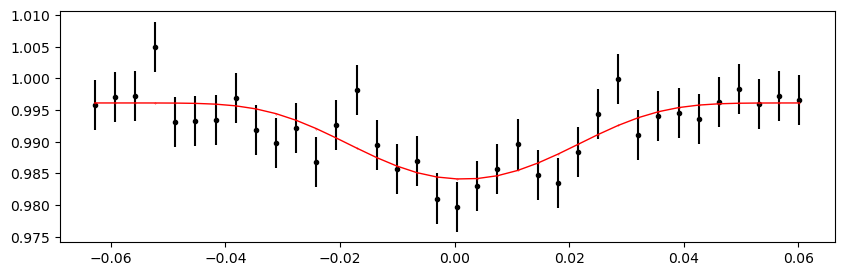

2883.9021700599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.60it/s]


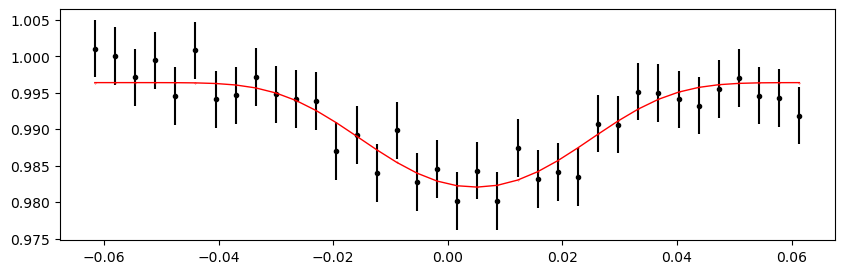

2884.56109492 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.57it/s]


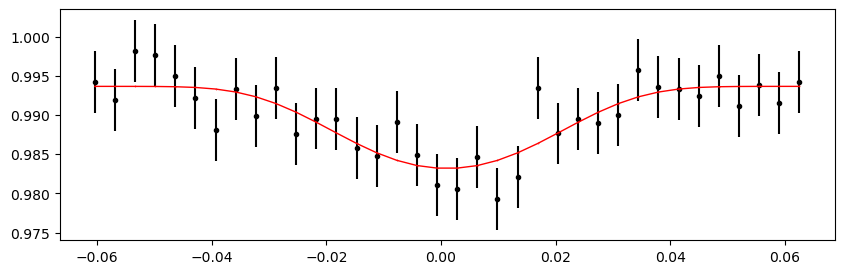

2885.22001978 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.97it/s]


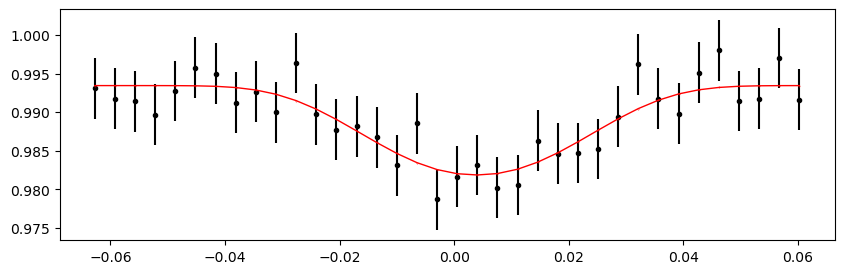

2885.8789446399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.23it/s]


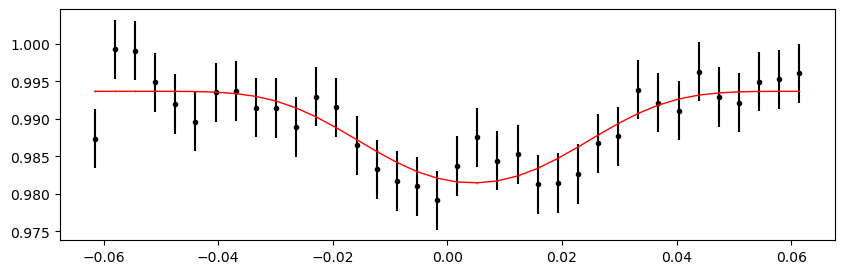

2886.5378695 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.01it/s]


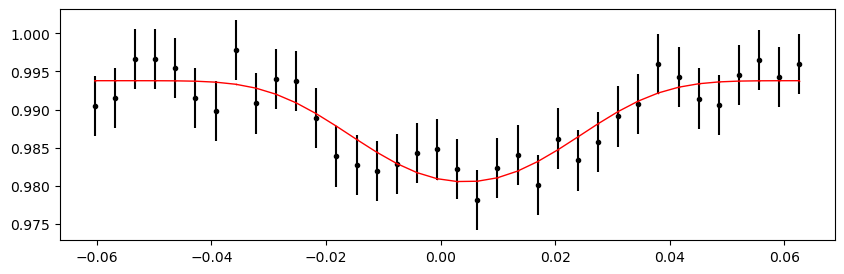

2887.1967943600002 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.32it/s]


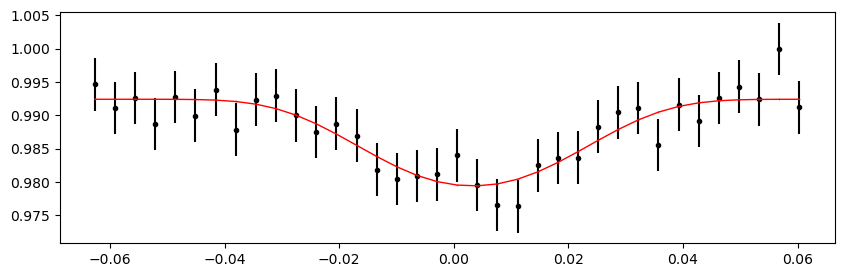

2887.8557192199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.01it/s]


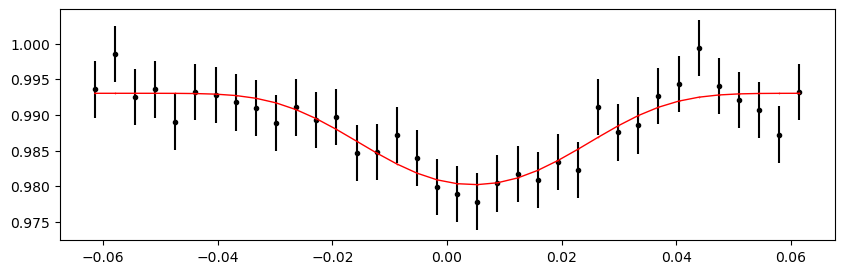

2888.51464408 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.76it/s]


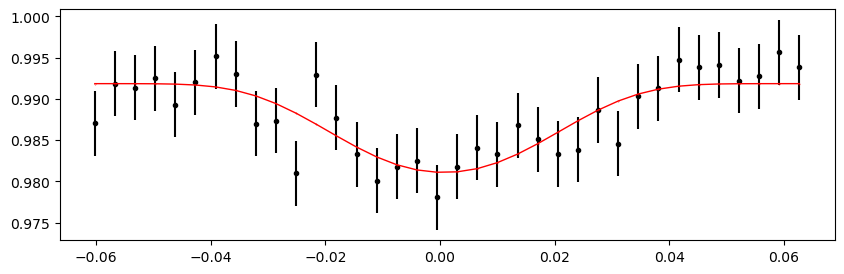

2889.17356894 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.95it/s]


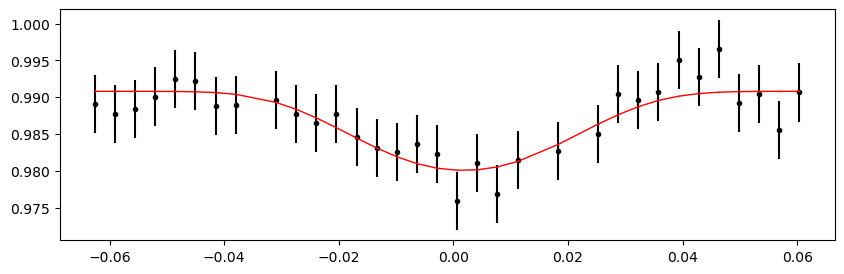

2889.8324937999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 412.30it/s]


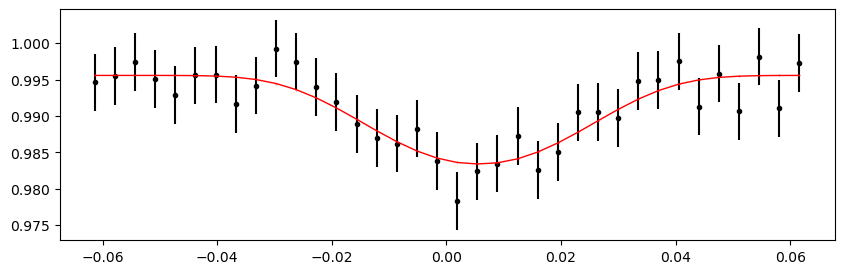

2890.49141866 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.99it/s]


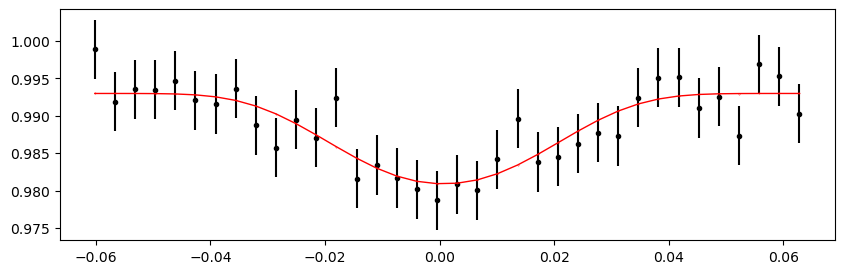

2891.15034352 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.98it/s]


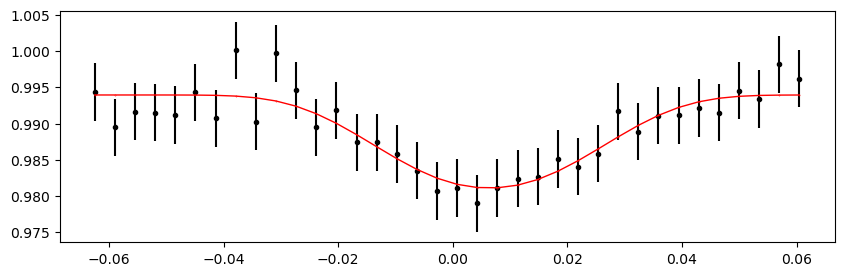

2891.8092683799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.79it/s]


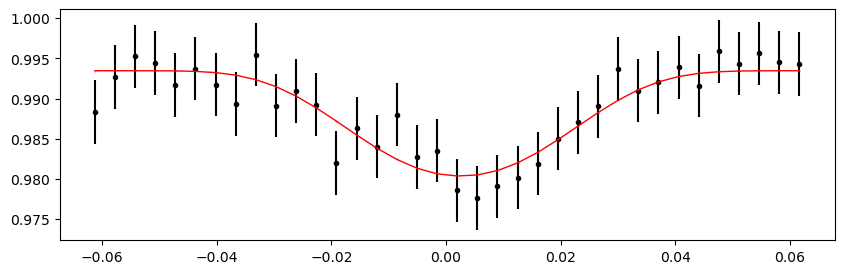

2892.46819324 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 373.49it/s]


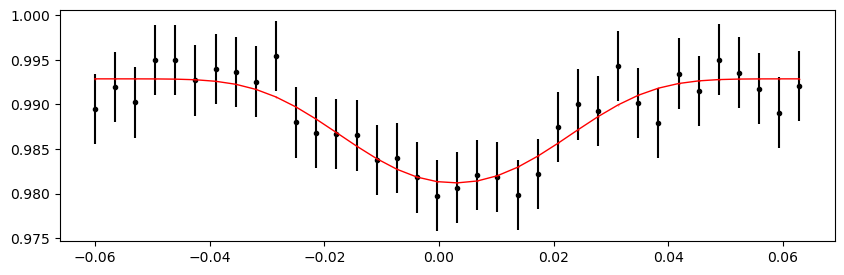

2893.1271181 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:27<00:00, 361.90it/s]


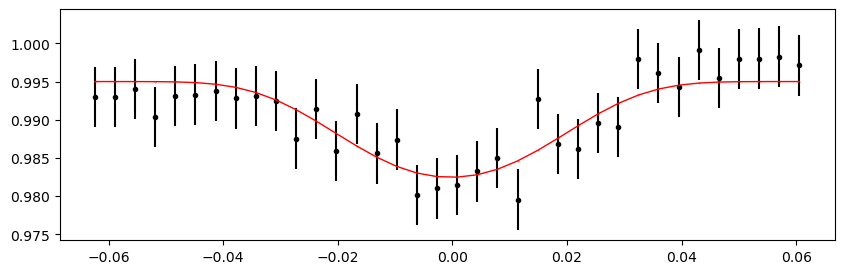

2893.7860429599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 386.34it/s]


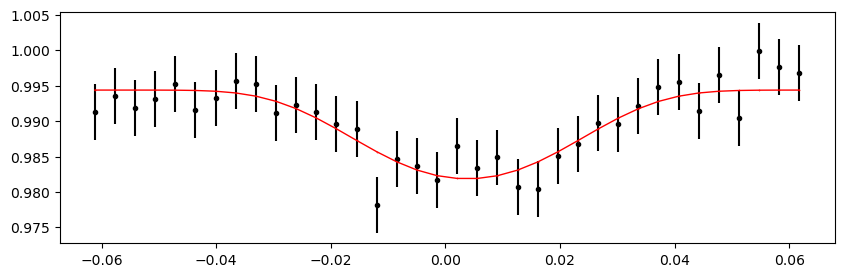

2894.44496782 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 393.64it/s]


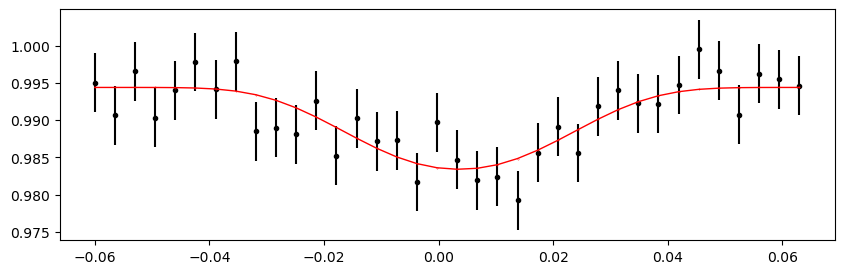

2895.10389268 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.16it/s]


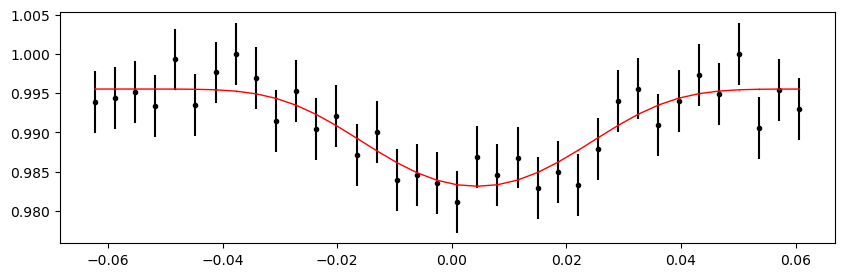

2895.7628175399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.87it/s]


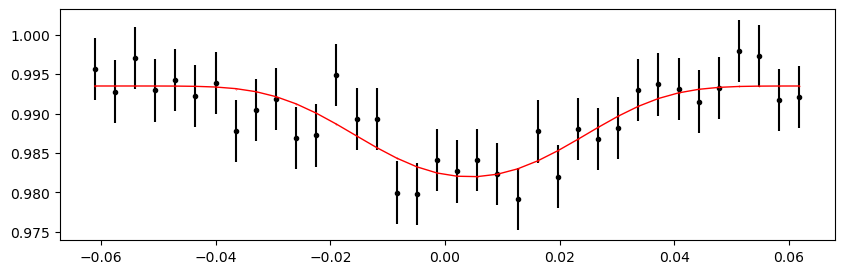

2896.4217424 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 506.14it/s]


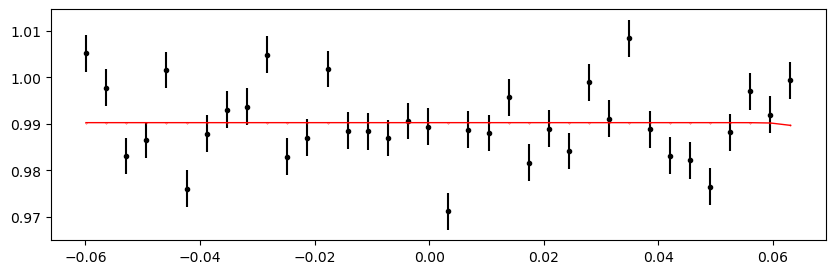

2897.08066726 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.47it/s]


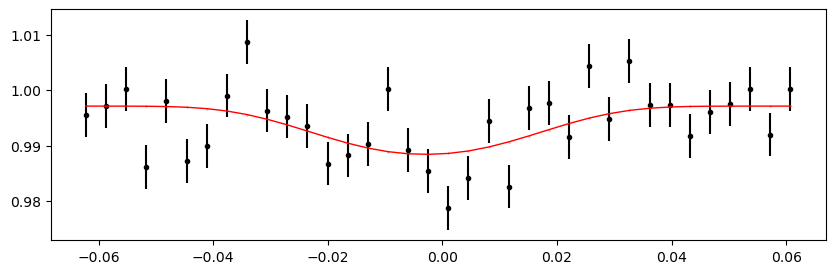

2897.73959212 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.95it/s]


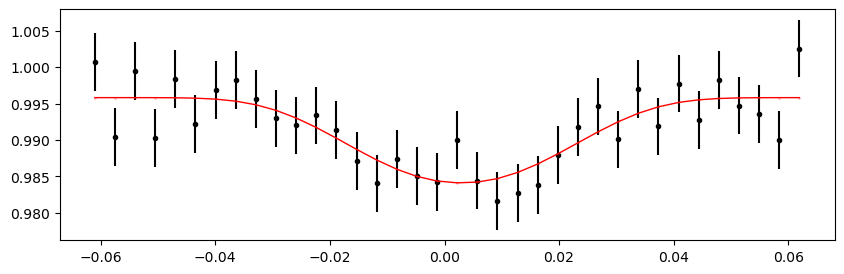

2898.39851698 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 416.93it/s]


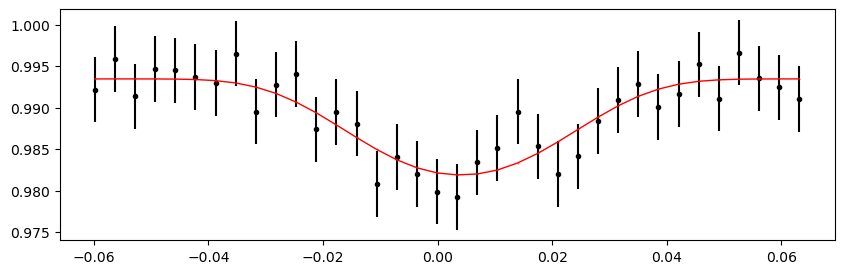

2899.05744184 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.69it/s]


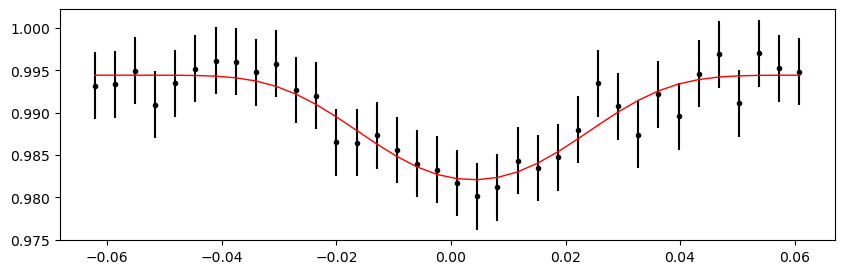

2899.7163667 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 416.38it/s]


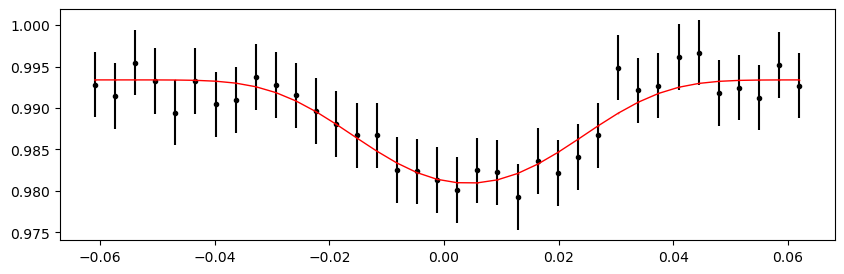

2900.37529156 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.49it/s]


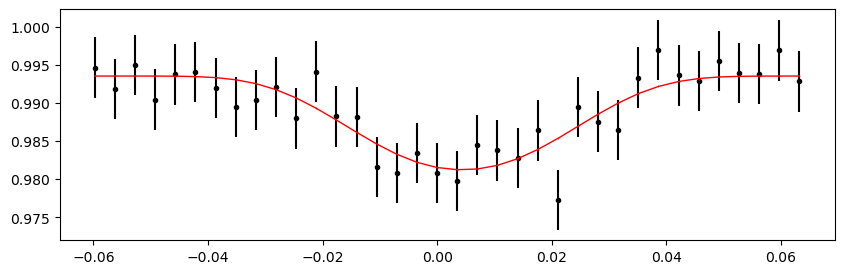

2901.03421642 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.04it/s]


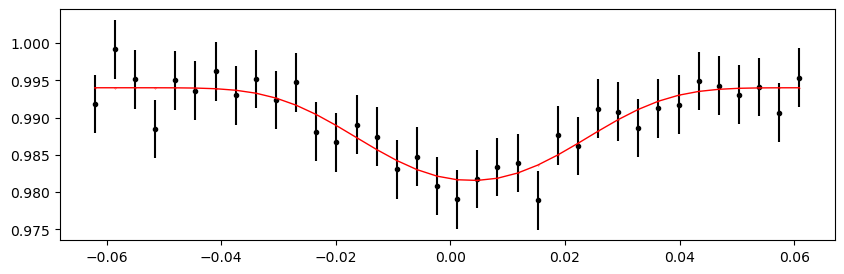

2901.69314128 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.82it/s]


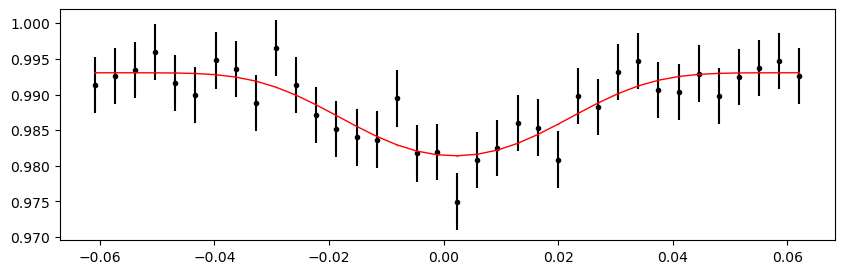

2902.35206614 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.52it/s]


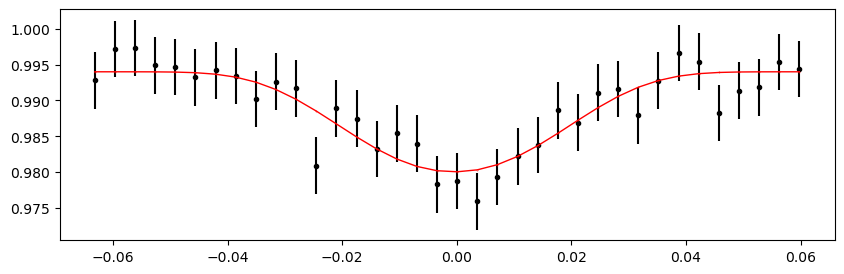

2903.010991 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.39it/s]


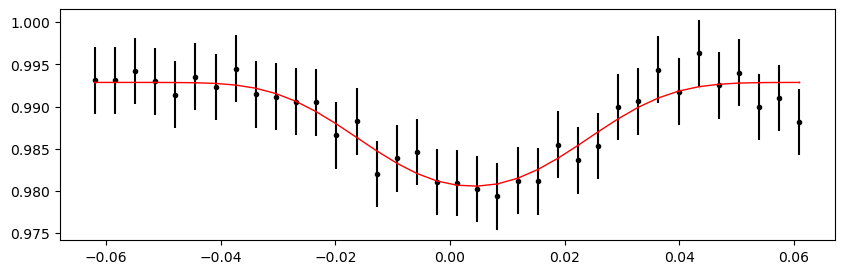

2903.66991586 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.27it/s]


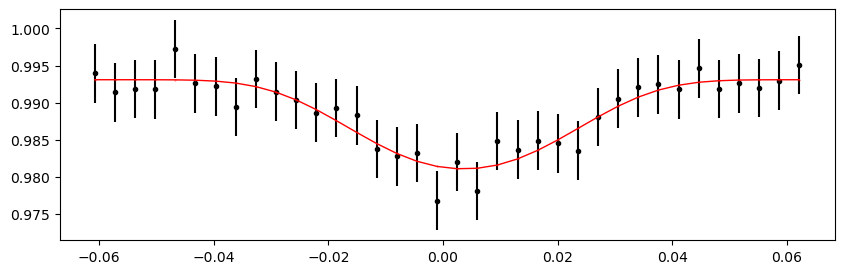

2904.32884072 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.19it/s]


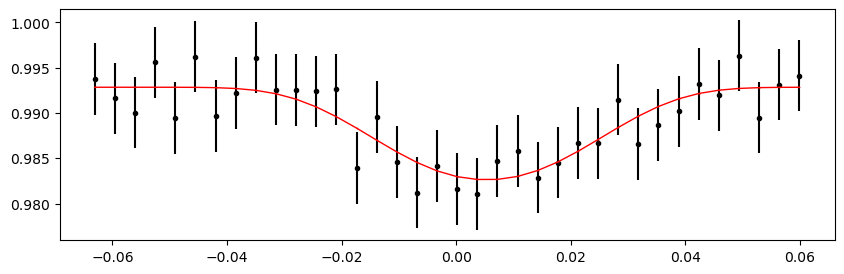

2904.98776558 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.11it/s]


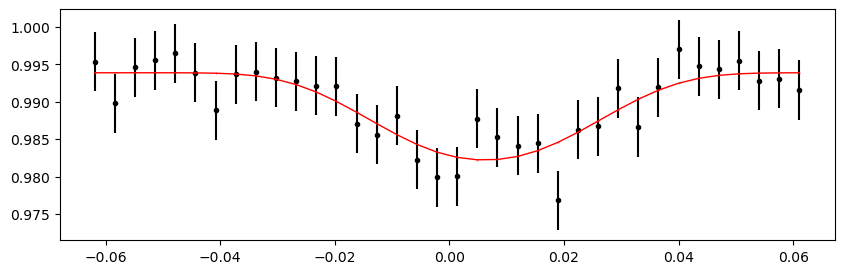

2905.64669044 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.18it/s]


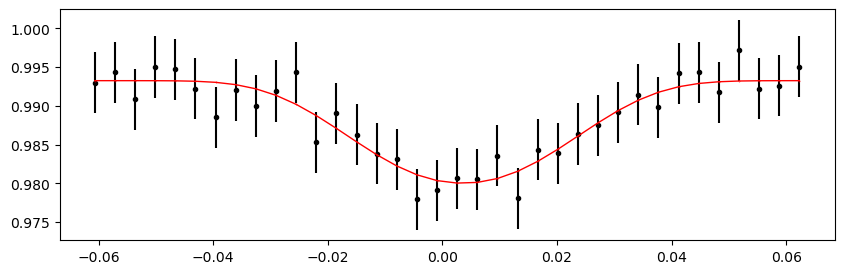

2906.3056152999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.49it/s]


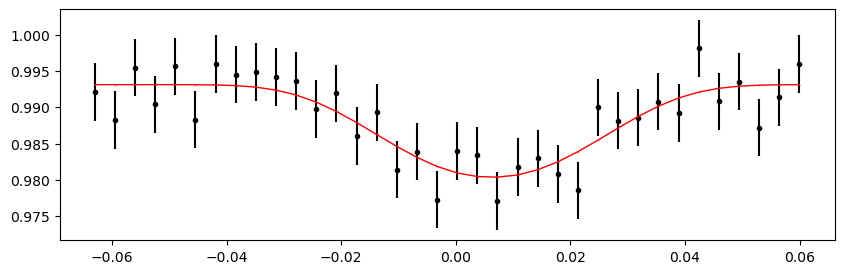

2906.96454016 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.56it/s]


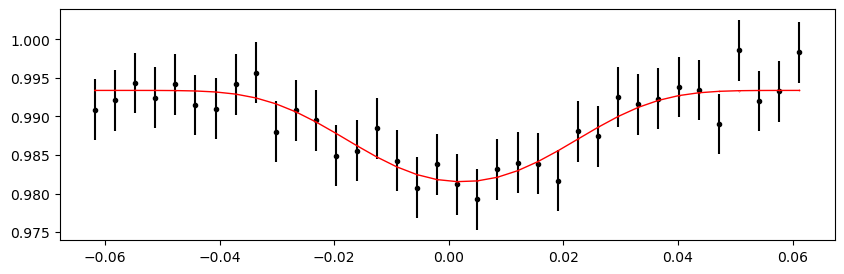

2907.62346502 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.46it/s]


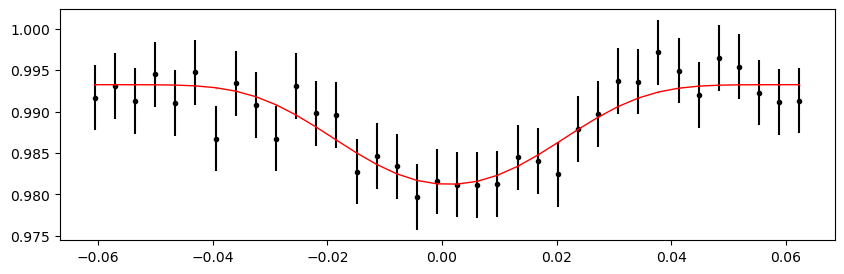

2908.2823898799998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 410.82it/s]


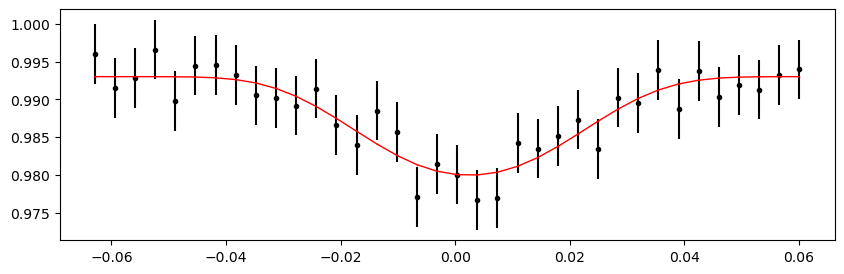

2908.94131474 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 416.23it/s]


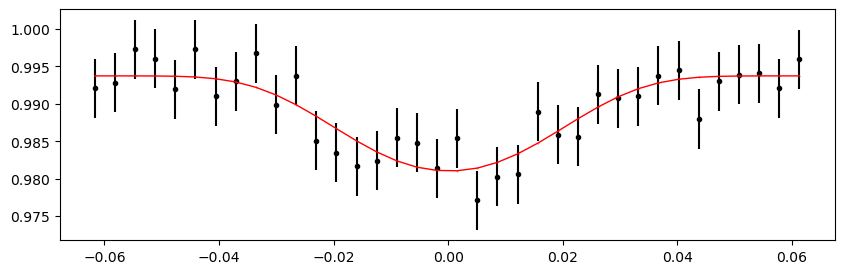

2909.6002396 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 425.53it/s]


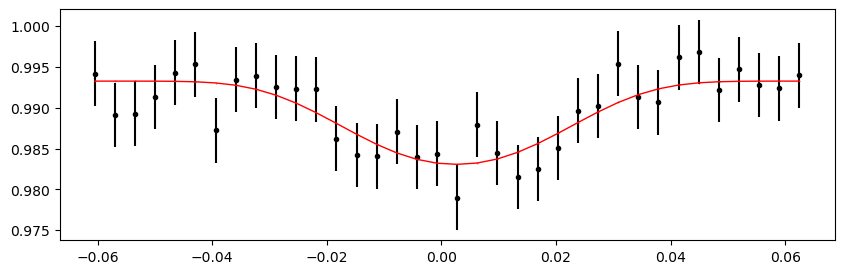

2910.2591644599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.19it/s]


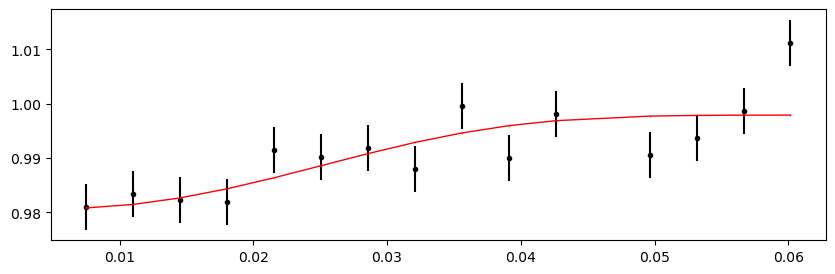

2910.91808932 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.34it/s]


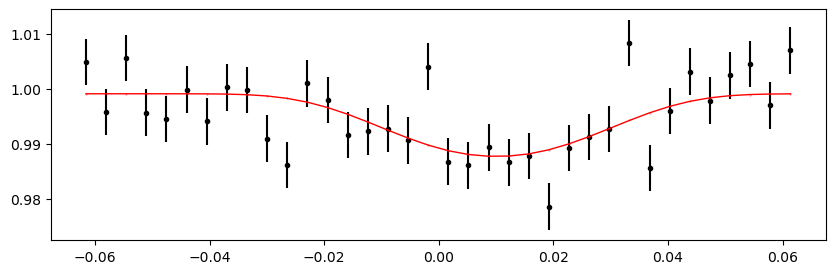

2911.57701418 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.98it/s]


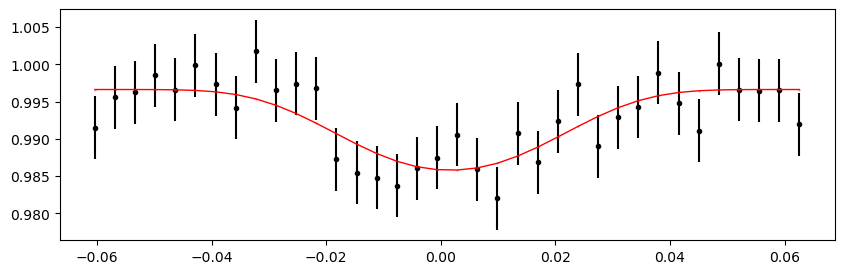

2912.2359390399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.78it/s]


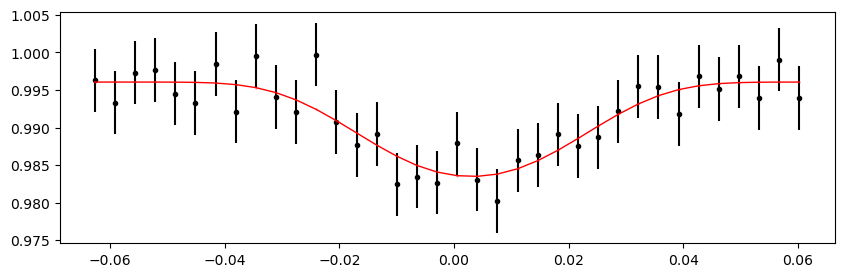

2912.8948639 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.60it/s]


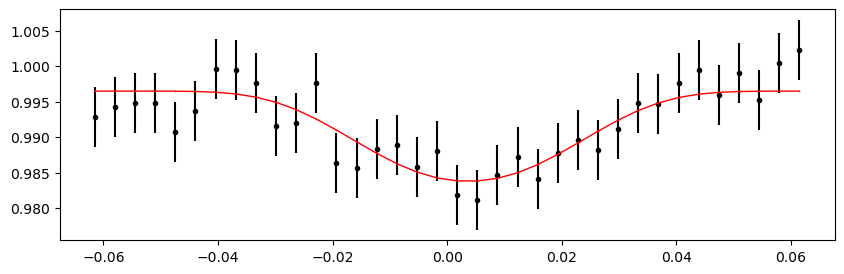

2913.55378876 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.62it/s]


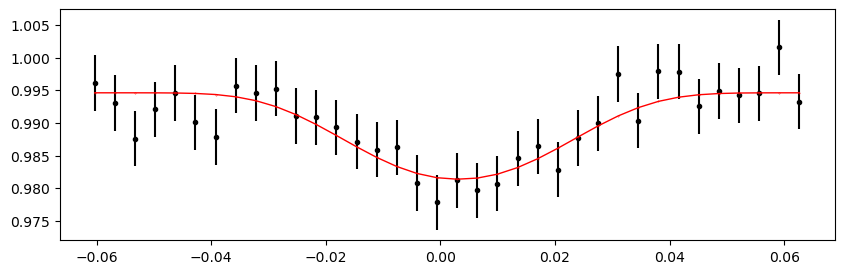

2914.2127136199997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.06it/s]


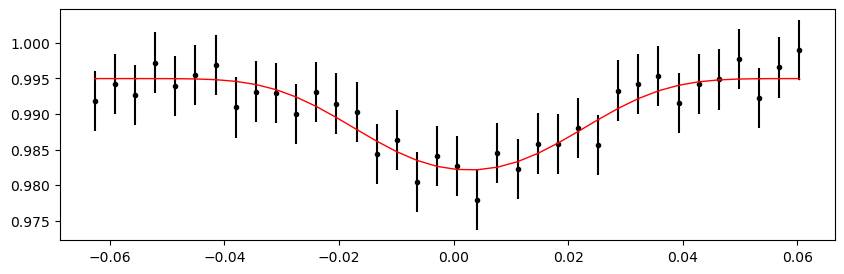

2914.87163848 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 416.41it/s]


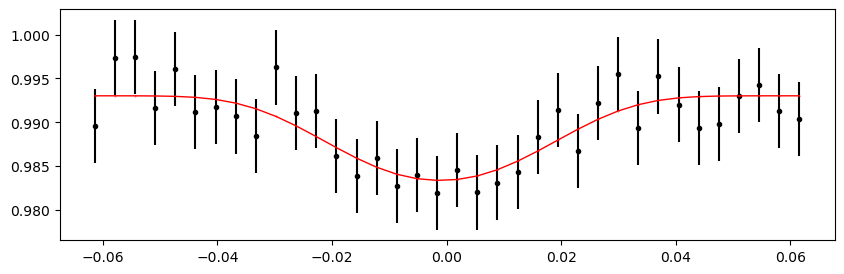

2915.53056334 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.94it/s]


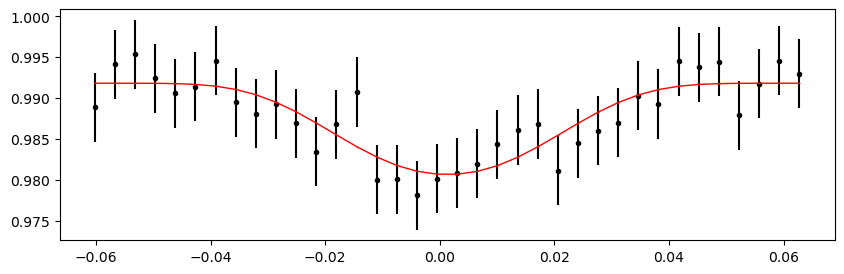

2916.1894881999997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.21it/s]


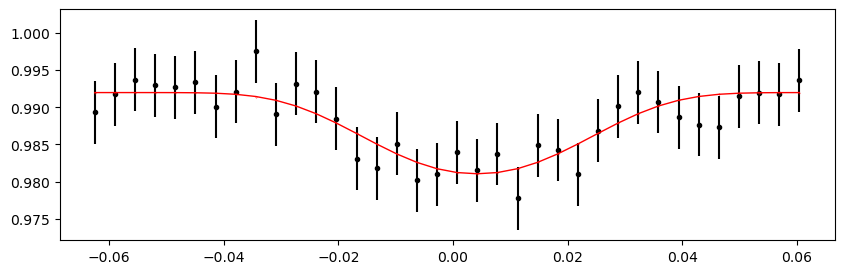

2917.50733792 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.60it/s]


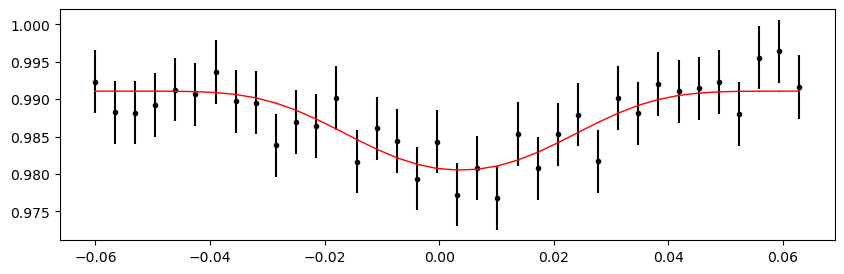

2918.1662627799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.10it/s]


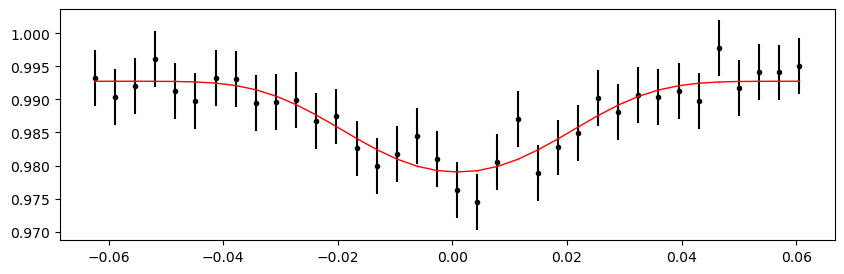

2918.82518764 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.92it/s]


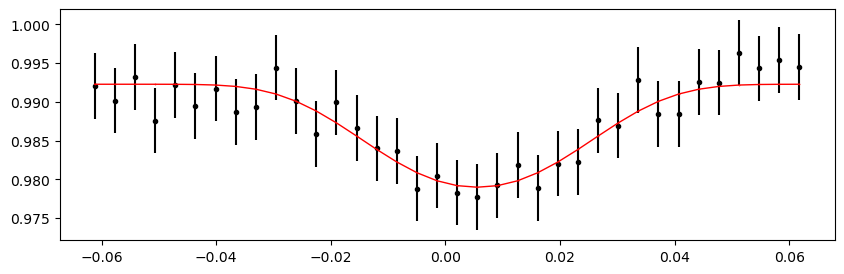

2919.4841125 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.17it/s]


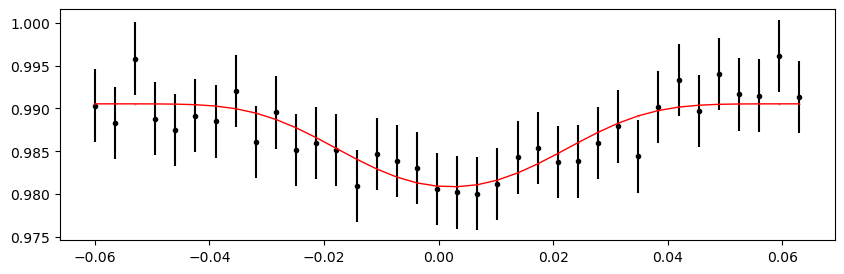

2920.1430373599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.97it/s]


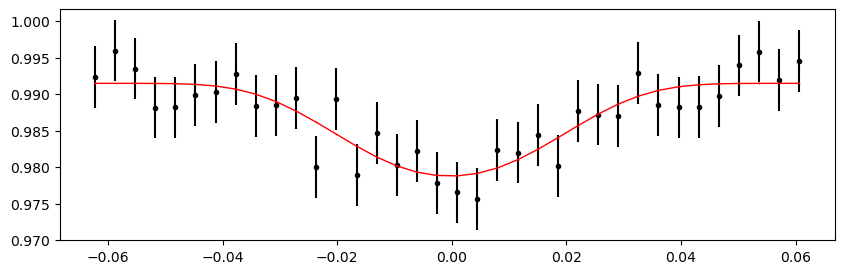

2920.80196222 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.98it/s]


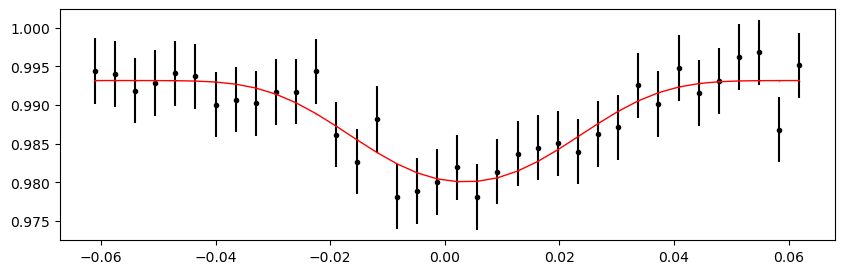

2921.46088708 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.21it/s]


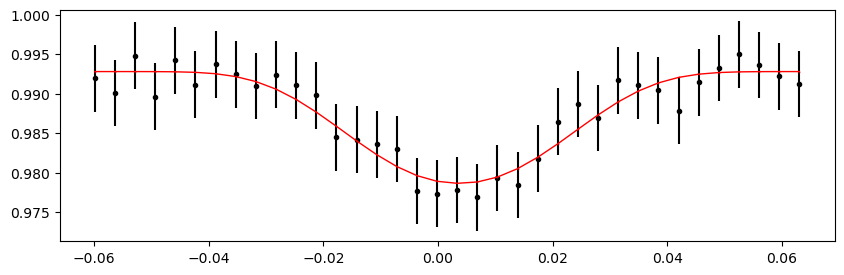

2922.1198119399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.74it/s]


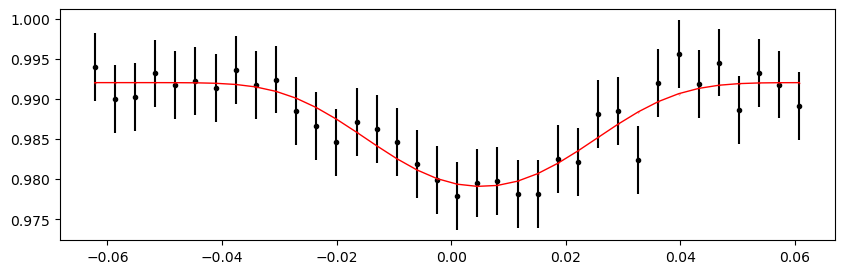

2922.7787368 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.88it/s]


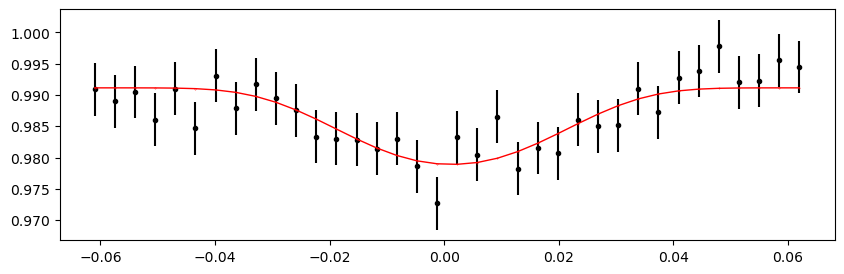

2924.0965865199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.75it/s]


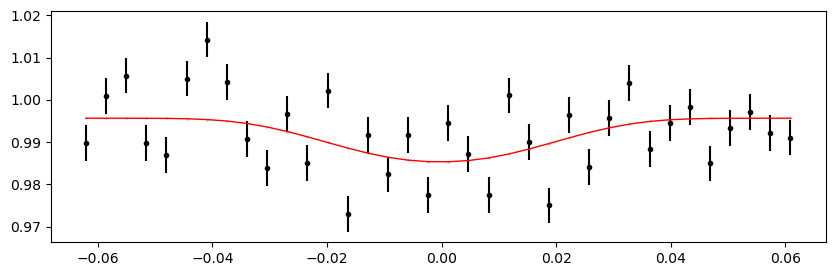

2924.75551138 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.42it/s]


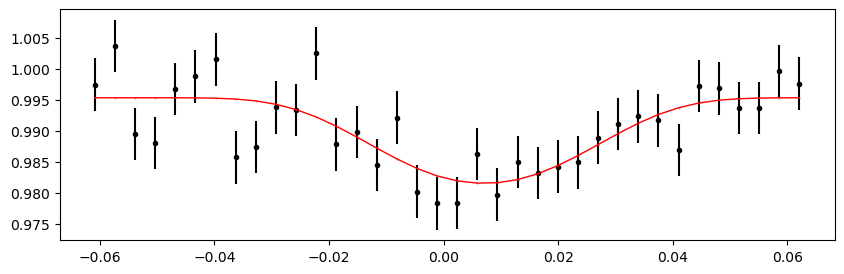

2925.41443624 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.59it/s]


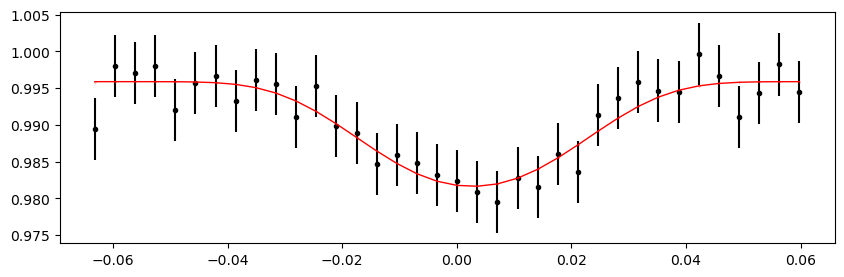

2926.0733610999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.86it/s]


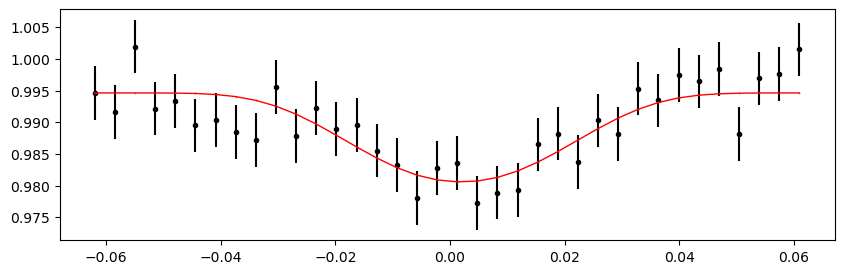

2926.73228596 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.83it/s]


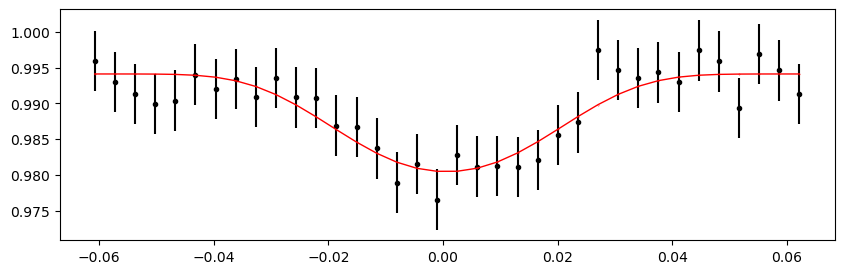

2927.39121082 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.48it/s]


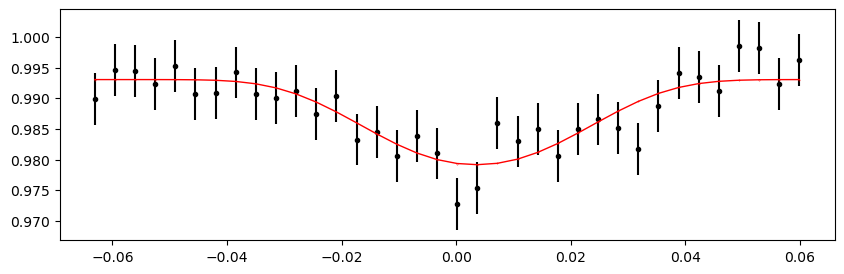

2928.0501356799996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.49it/s]


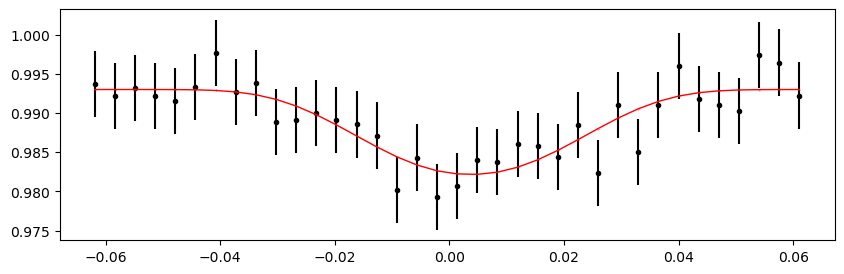

2928.70906054 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 416.28it/s]


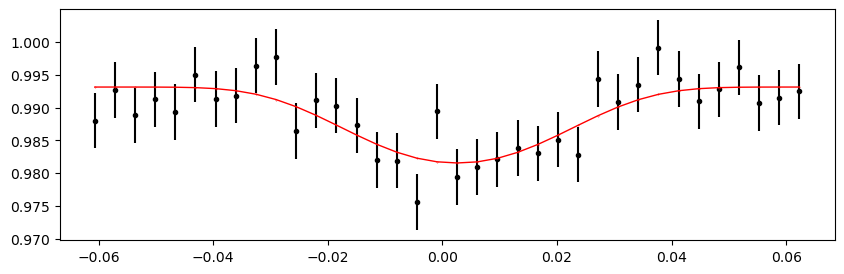

2929.3679854 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 416.39it/s]


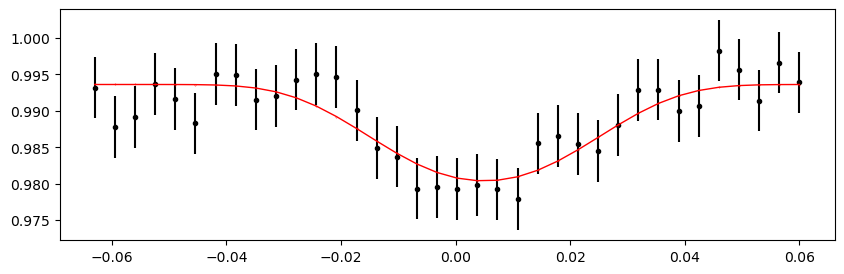

2930.0269102599996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.36it/s]


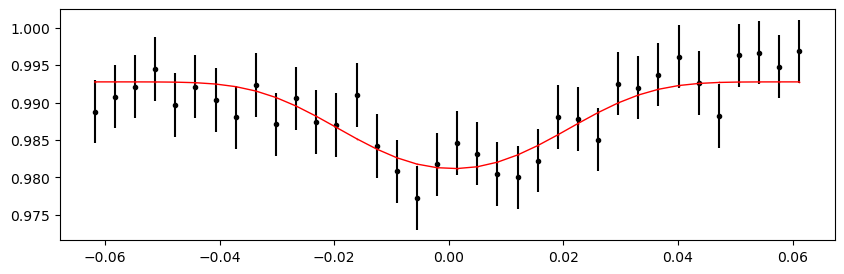

2930.68583512 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.89it/s]


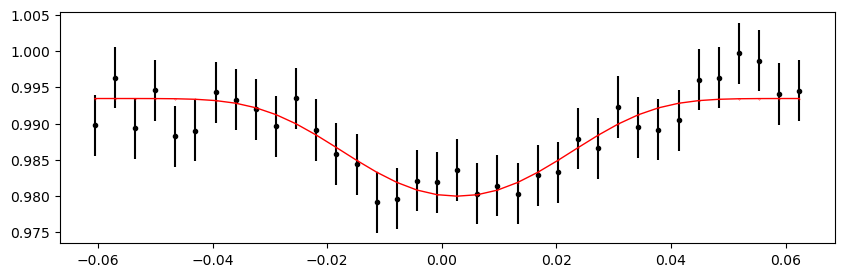

2931.34475998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.69it/s]


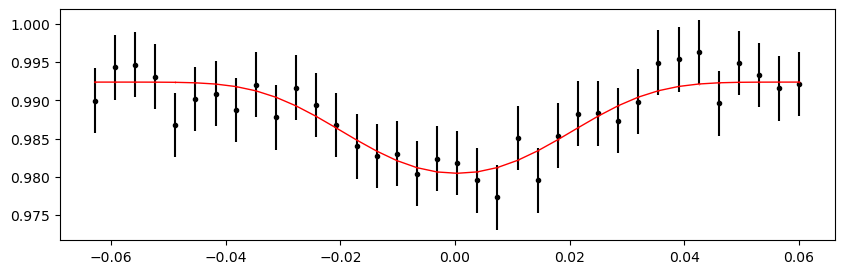

2932.00368484 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.12it/s]


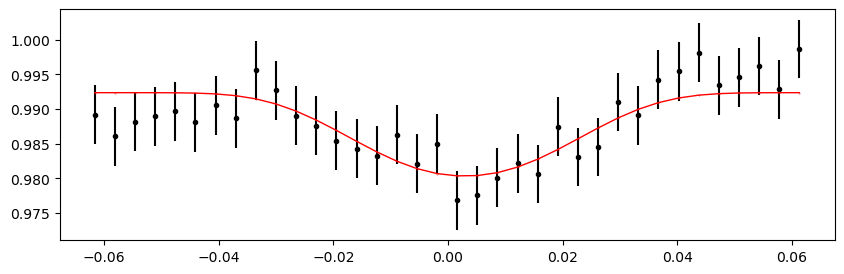

2932.6626097 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.40it/s]


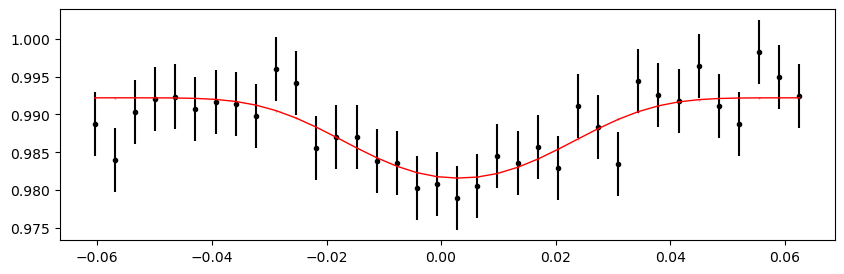

2933.32153456 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.30it/s]


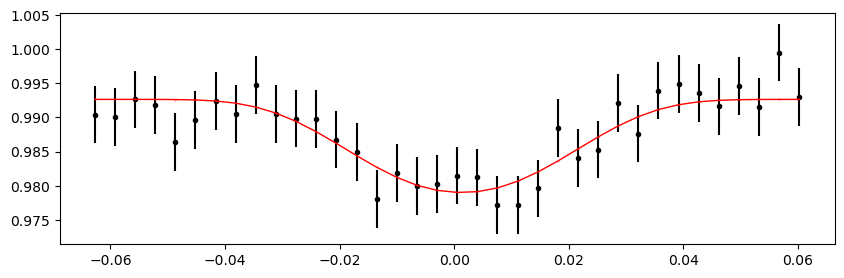

2933.98045942 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.71it/s]


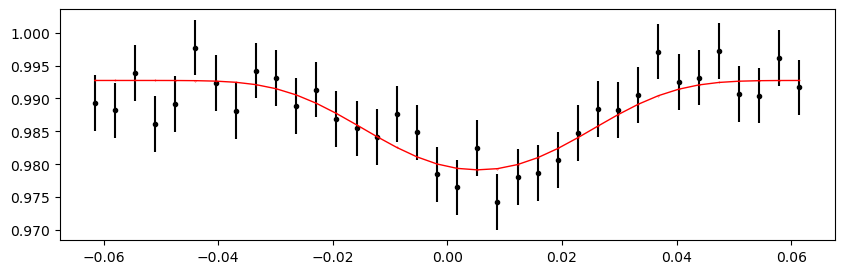

2934.63938428 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.09it/s]


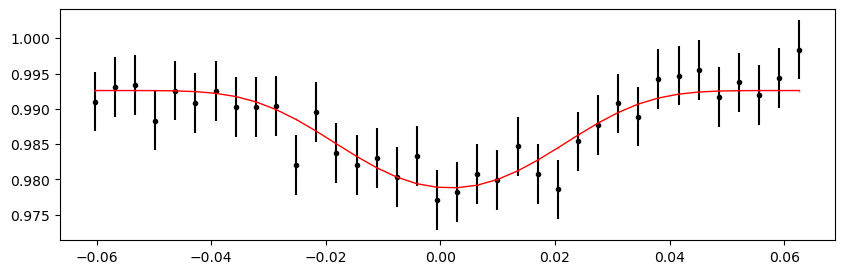

2935.29830914 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 424.43it/s]


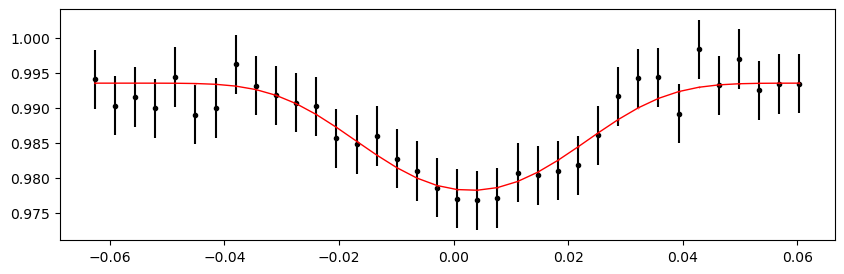

2935.957234 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.75it/s]


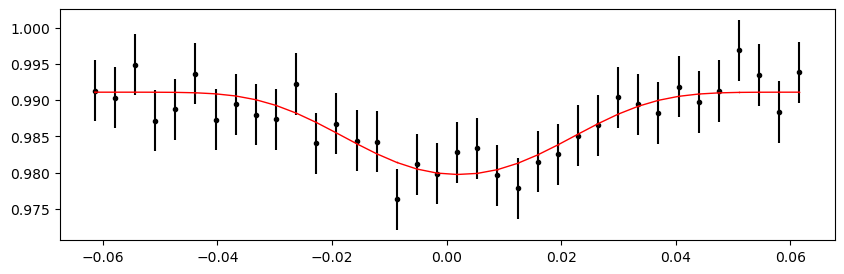

2936.61615886 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.15it/s]


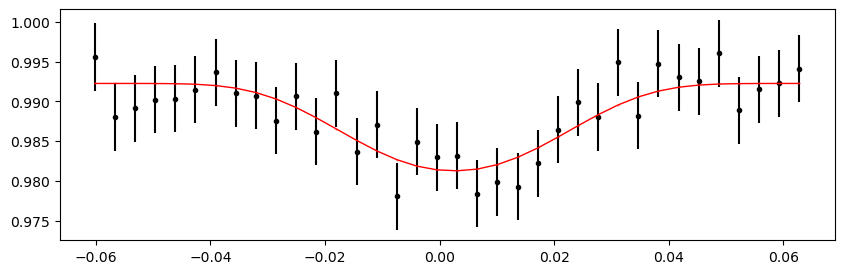

2937.27508372 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.69it/s]


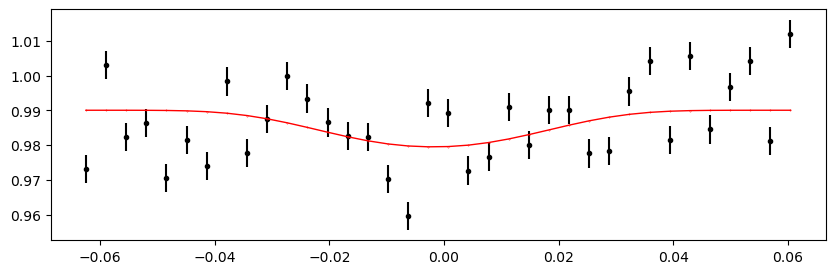

2937.93400858 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.77it/s]


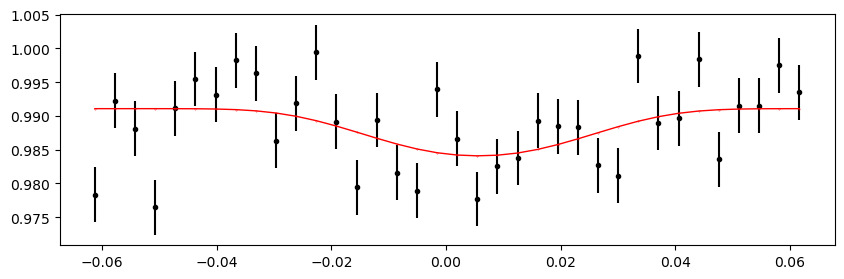

2938.59293344 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.23it/s]


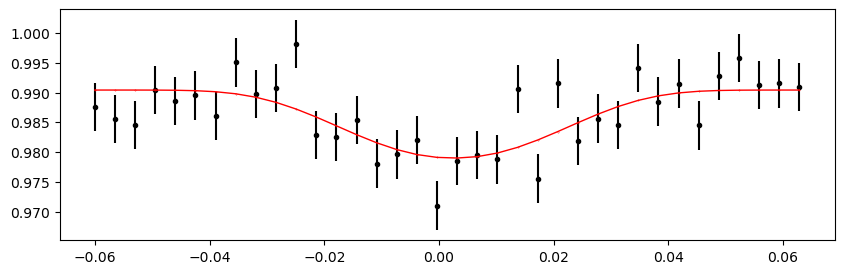

2939.2518583 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.60it/s]


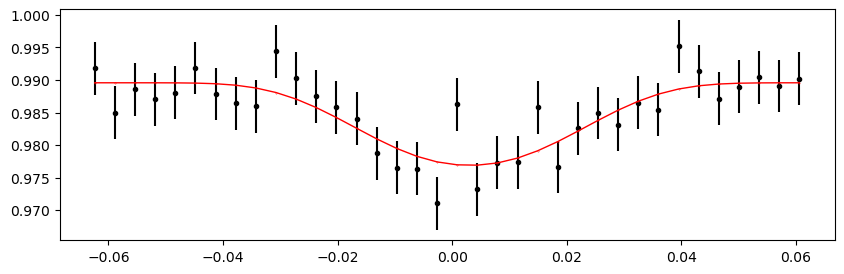

2939.91078316 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 416.74it/s]


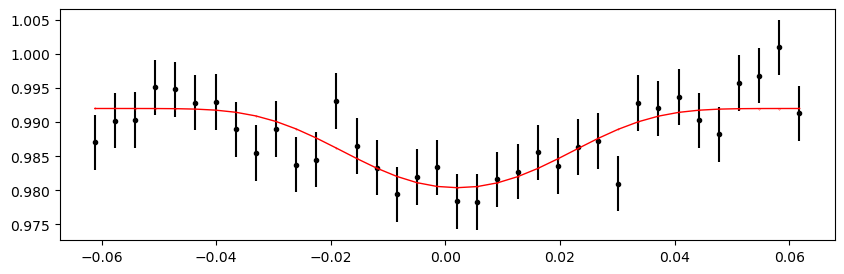

2940.56970802 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.78it/s]


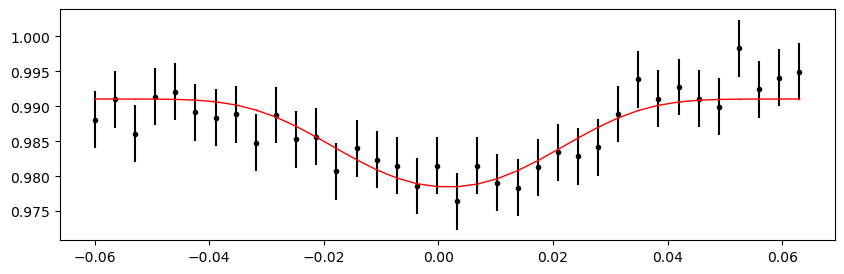

2941.22863288 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.11it/s]


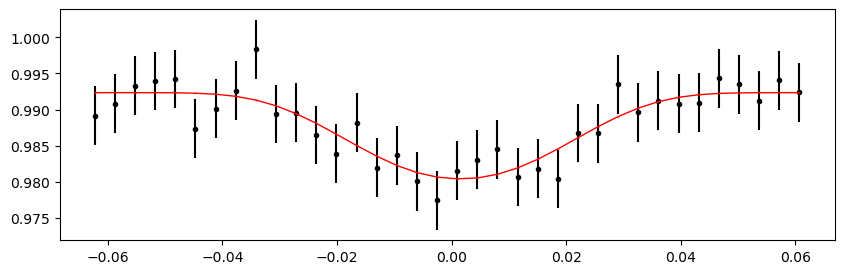

2941.88755774 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.83it/s]


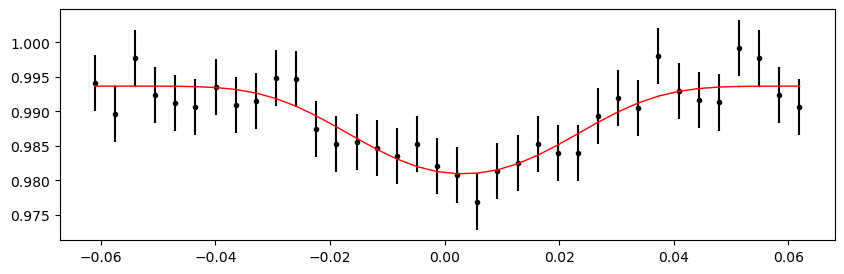

2942.5464825999998 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 417.53it/s]


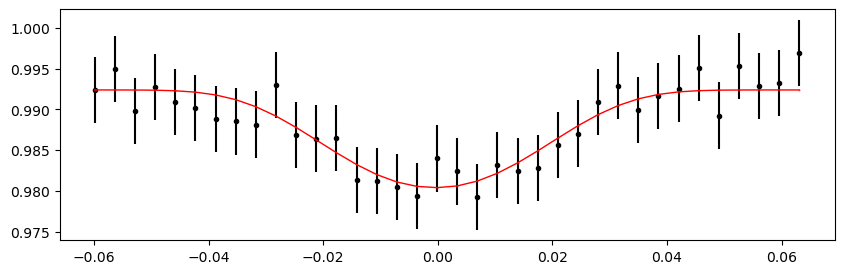

2943.20540746 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.28it/s]


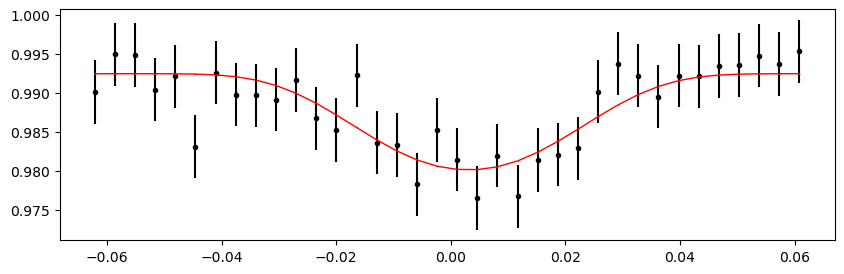

2944.5232571799997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.39it/s]


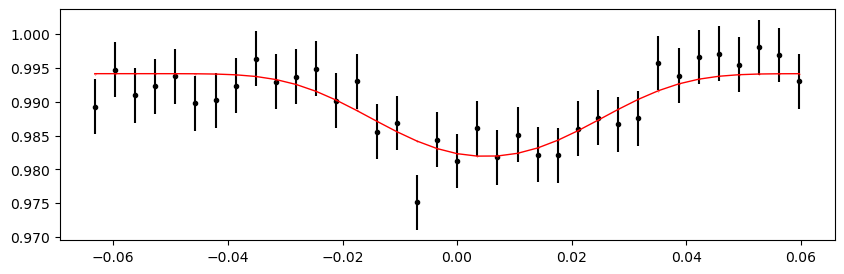

2945.18218204 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 416.88it/s]


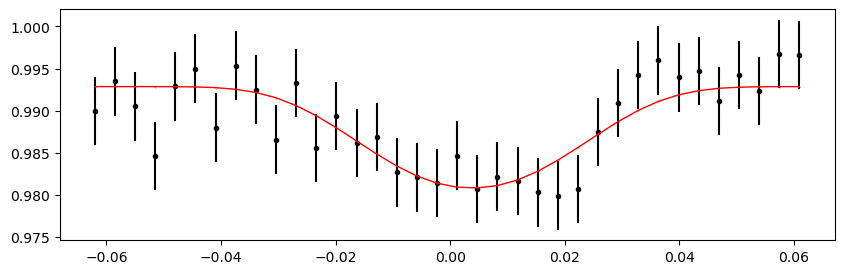

2945.8411069 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.37it/s]


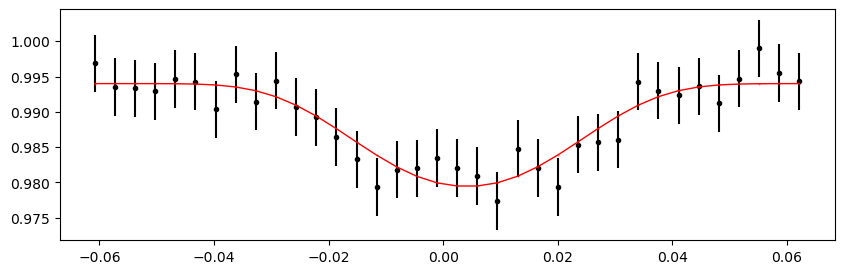

2946.5000317599997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.82it/s]


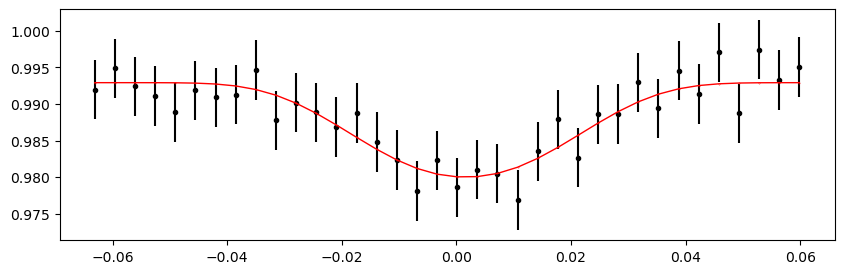

2947.15895662 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.16it/s]


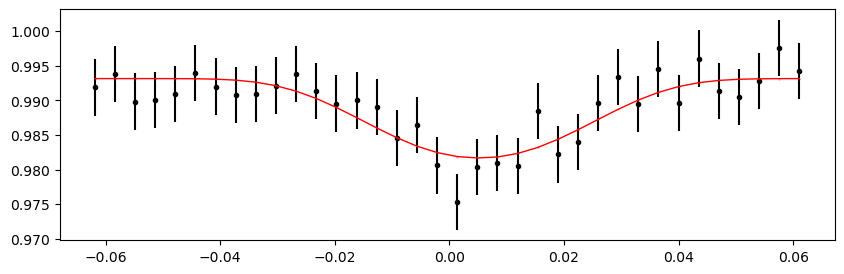

2947.81788148 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.85it/s]


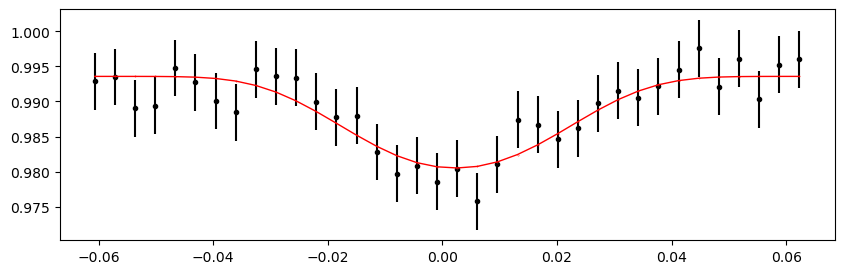

2948.4768063399997 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.72it/s]


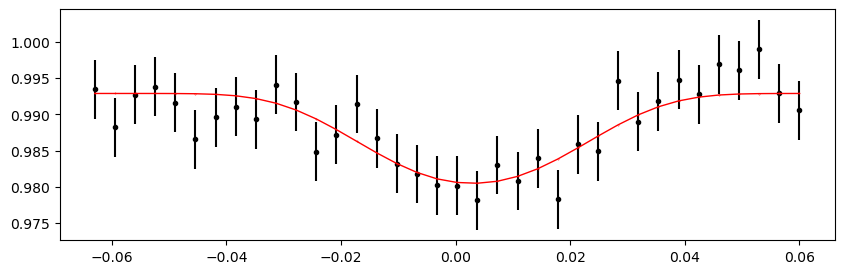

2949.1357312 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.32it/s]


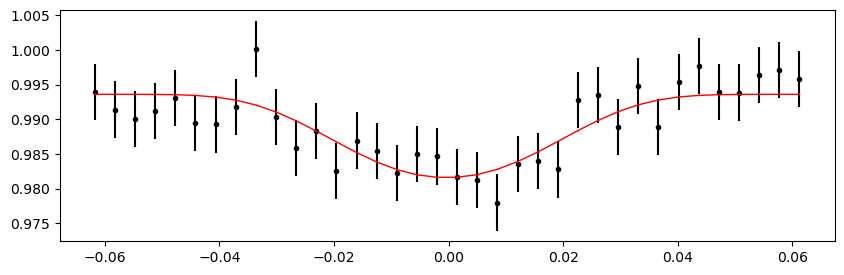

Time 2949.79465606 does not have enough data points: 5
2955.06605494 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.44it/s]


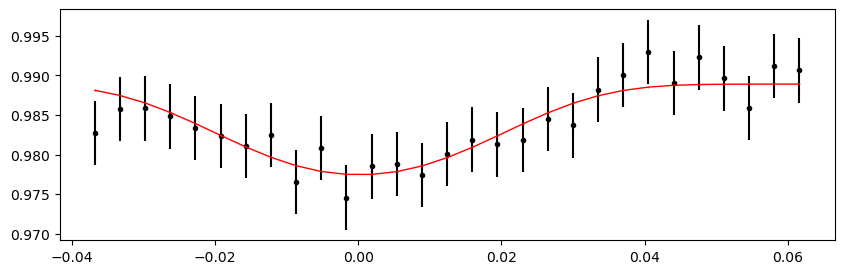

2955.7249798 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 421.04it/s]


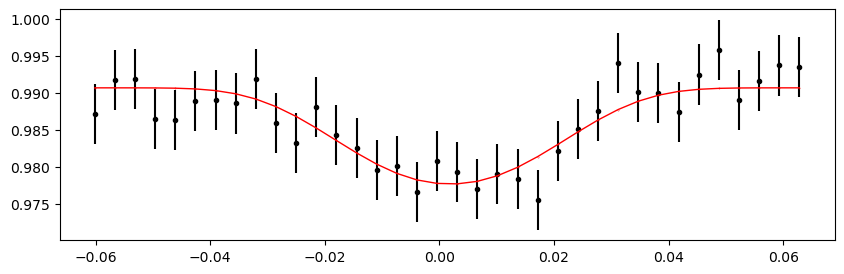

2957.04282952 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 420.82it/s]


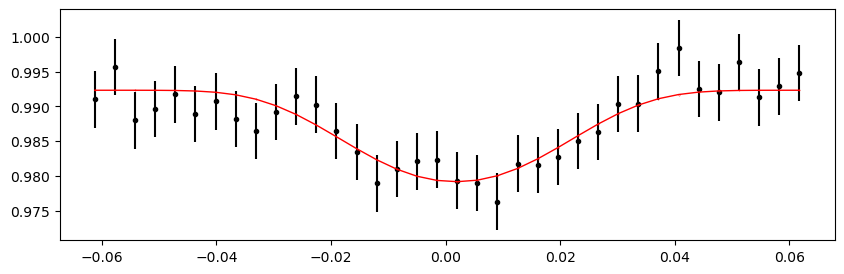

2957.70175438 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.36it/s]


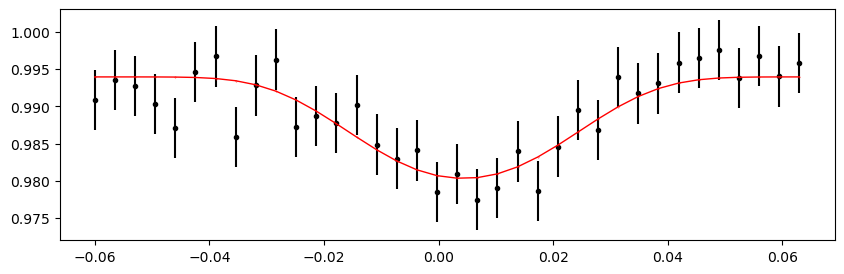

2958.3606792399996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 422.33it/s]


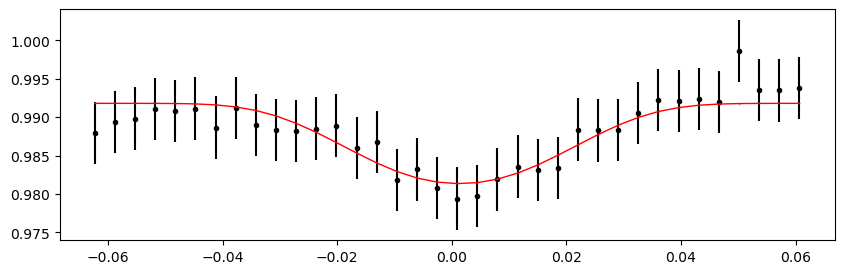

2959.0196041 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.10it/s]


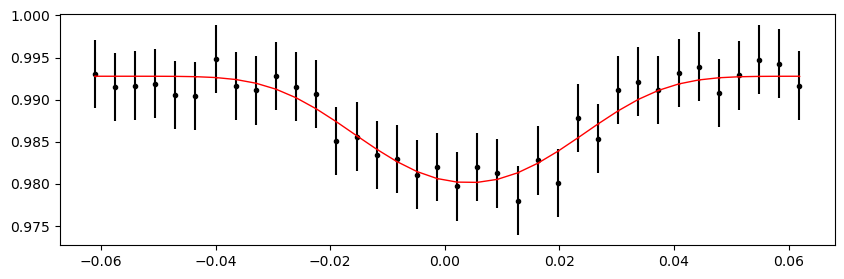

2959.67852896 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 415.58it/s]


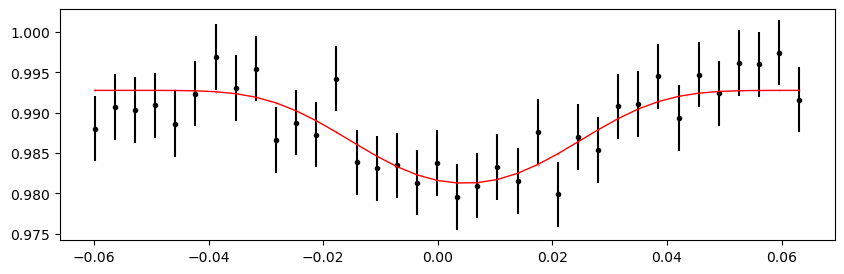

2960.3374538199996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 412.12it/s]


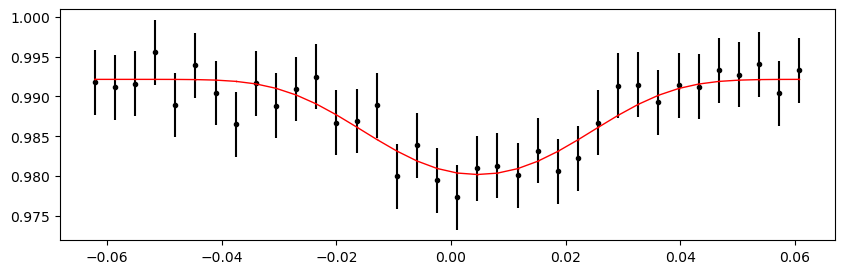

2960.99637868 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.38it/s]


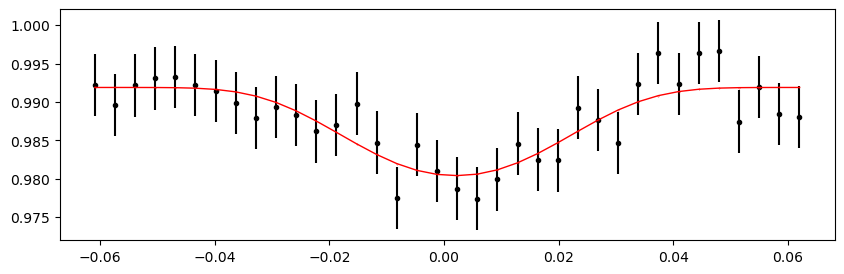

2961.65530354 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 419.80it/s]


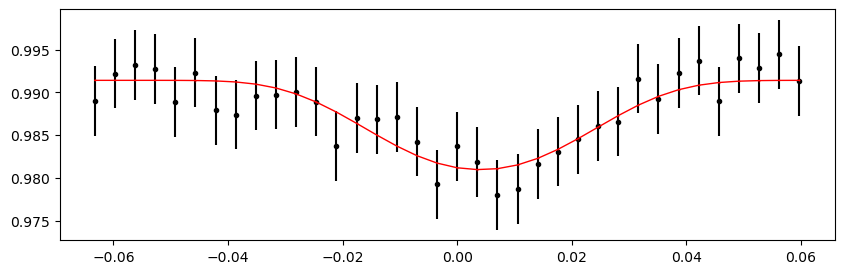

2962.3142283999996 0.9972590827504733 -0.01141763491675456 0.22594590701634074


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.60it/s]


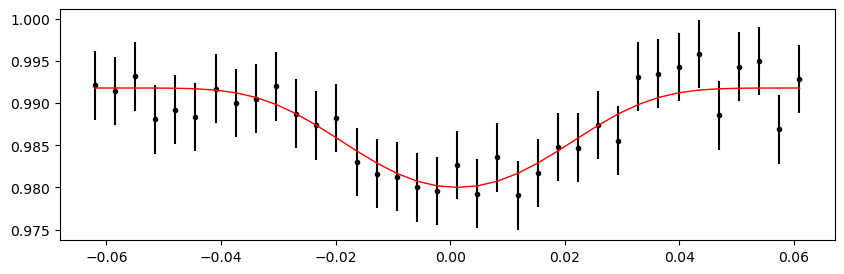

In [70]:
%matplotlib inline

# from importlib import reload
# reload(etv_functions)

print("Fitting individual primary eclipses...")
etv_functions.fit_each_eclipse(data_primary, n_transits, t0_primary, period, mean_alpha0, mean_alpha1, mean_t0, mean_d, mean_Tau, outfile_path,
                               min_number_data=10,   # accomodate the 10min cadence data, give up on 30min cadence data (too few points (usually 4) per eclipse)
                              )
!$NOTIFY_CMD "Individual primary eclipses fit done"


Fitting individual secondary eclipses...
Existing manifest file found, will skip previously processed LCs and append to end of manifest file
Time 1683.67307514 does not have enough data points: 4
Time 1684.332 does not have enough data points: 4
Time 1684.99092486 does not have enough data points: 4
Time 1685.64984972 does not have enough data points: 4
Time 1686.30877458 does not have enough data points: 4
Time 1686.96769944 does not have enough data points: 4
Time 1687.6266243 does not have enough data points: 4
Time 1688.28554916 does not have enough data points: 4
Time 1688.9444740200001 does not have enough data points: 4
Time 1689.60339888 does not have enough data points: 4
Time 1690.26232374 does not have enough data points: 4
Time 1690.9212486000001 does not have enough data points: 4
Time 1691.58017346 does not have enough data points: 4
Time 1692.23909832 does not have enough data points: 4
Time 1692.89802318 does not have enough data points: 4
Time 1693.55694804 does not ha

100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 516.91it/s]


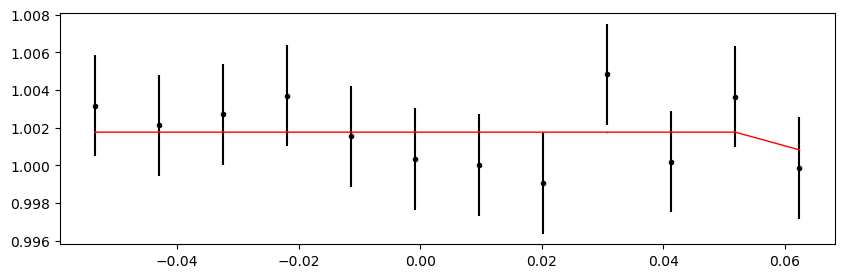

2408.49042114 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.13it/s]


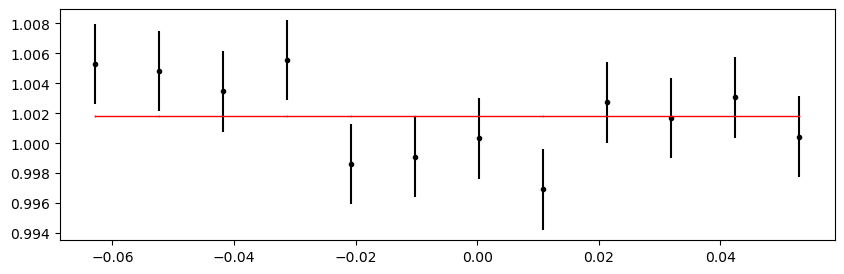

2409.149346 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 538.72it/s]


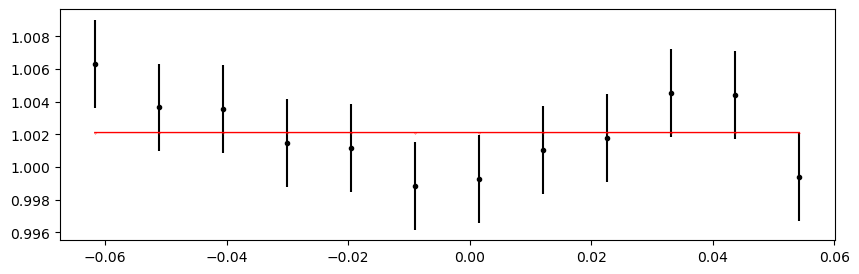

2409.80827086 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 529.98it/s]


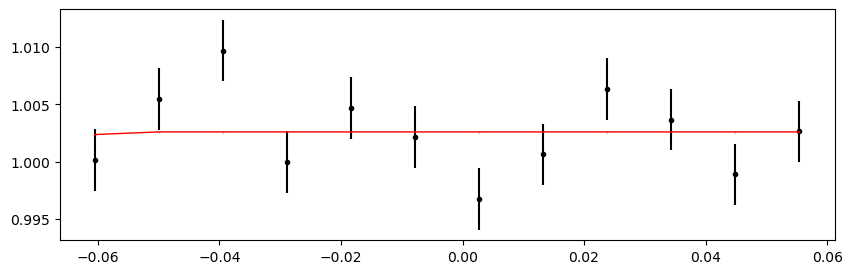

2410.46719572 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 537.69it/s]


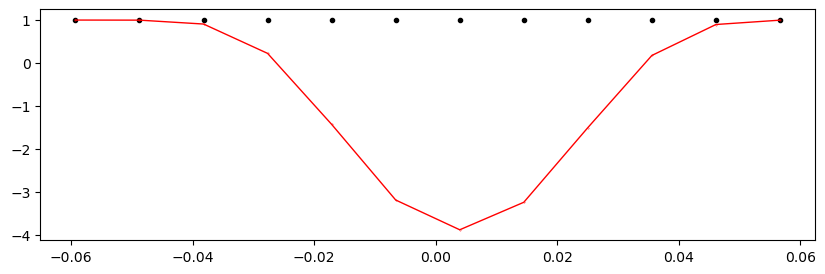

2411.12612058 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 522.99it/s]


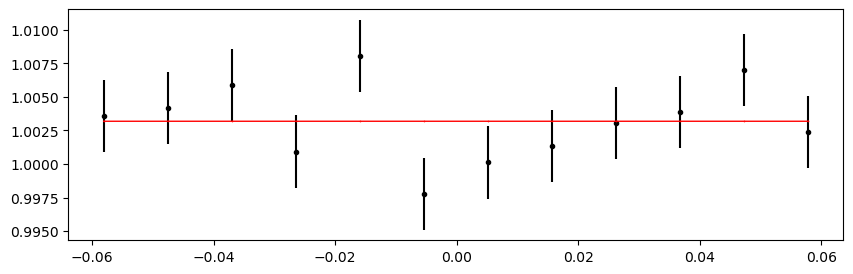

2411.78504544 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 495.16it/s]


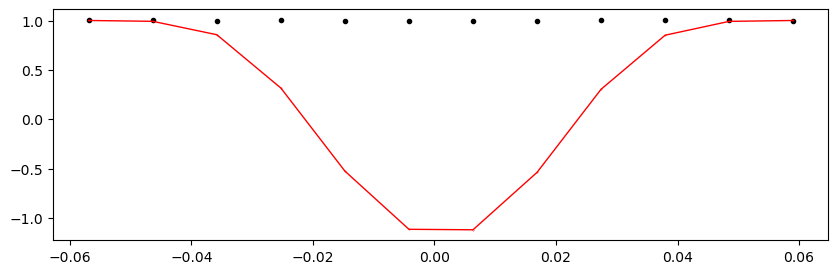

2412.4439703 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 525.62it/s]


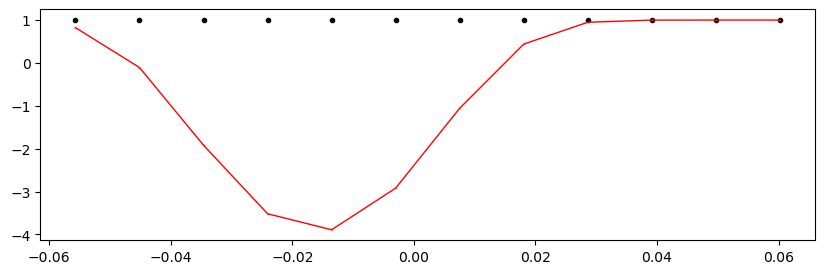

2413.10289516 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 536.68it/s]


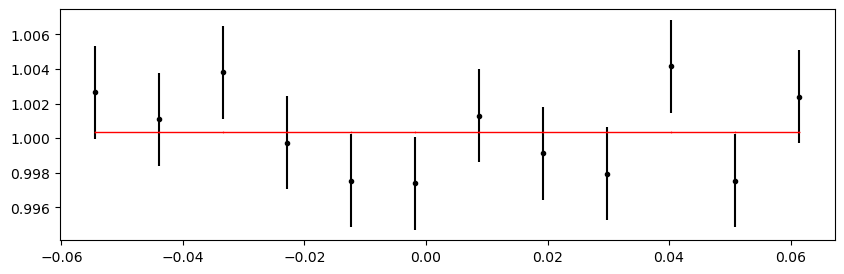

2413.76182002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.34it/s]


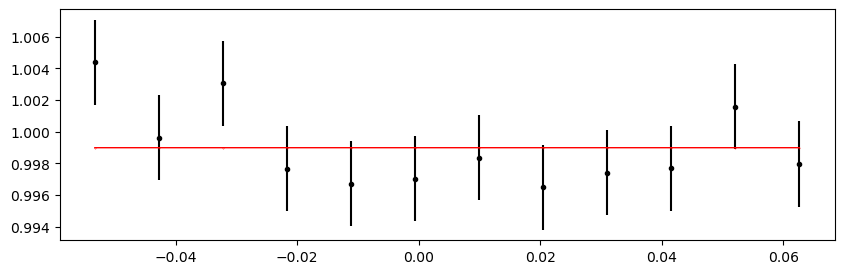

2414.42074488 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 527.56it/s]


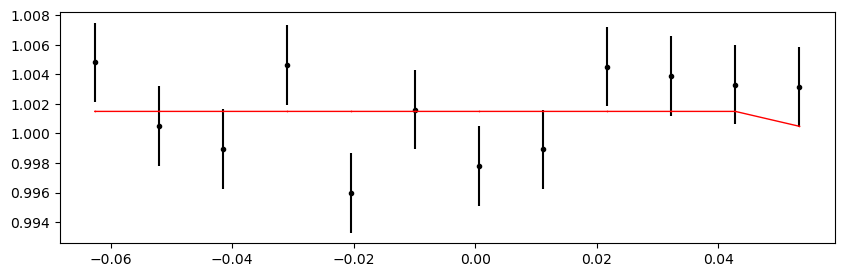

2415.07966974 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.45it/s]


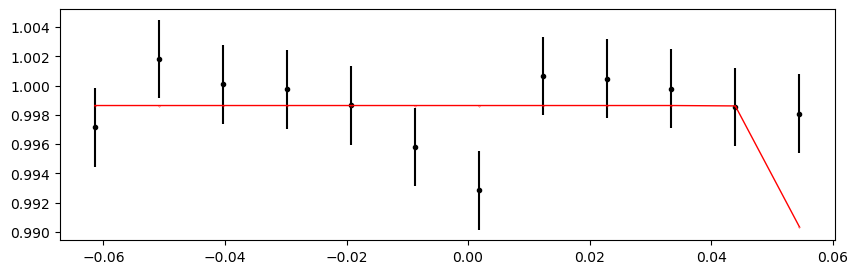

2415.7385946 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.52it/s]


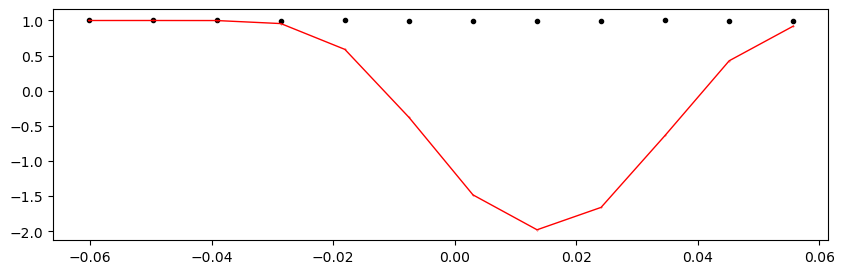

2416.39751946 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.82it/s]


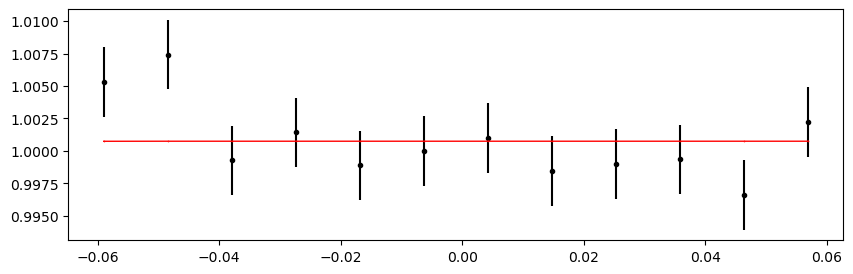

2417.05644432 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.25it/s]


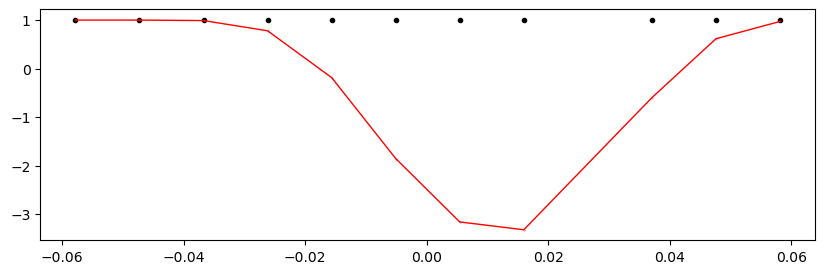

2417.71536918 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.31it/s]


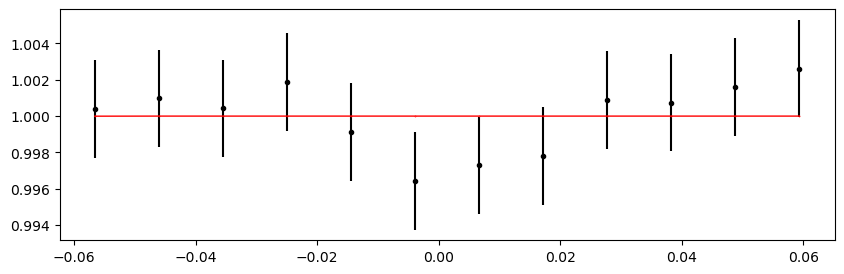

2418.3742940399998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.57it/s]


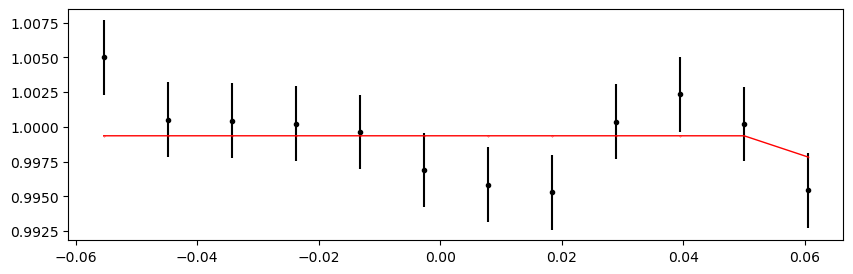

2420.3510686199998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.18it/s]


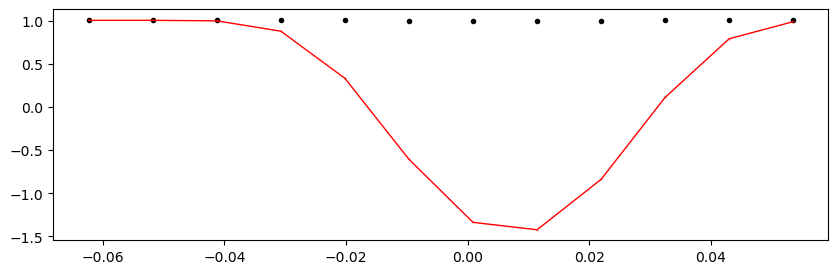

2421.00999348 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.43it/s]


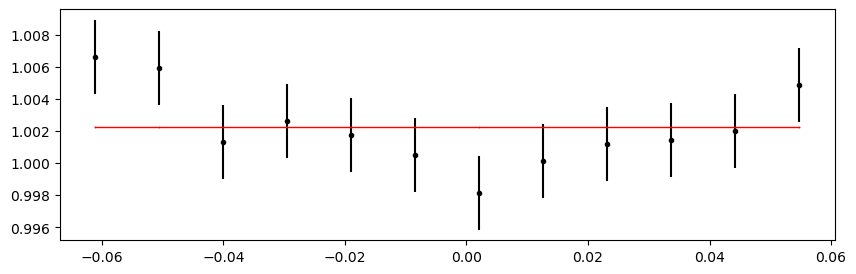

2421.66891834 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.95it/s]


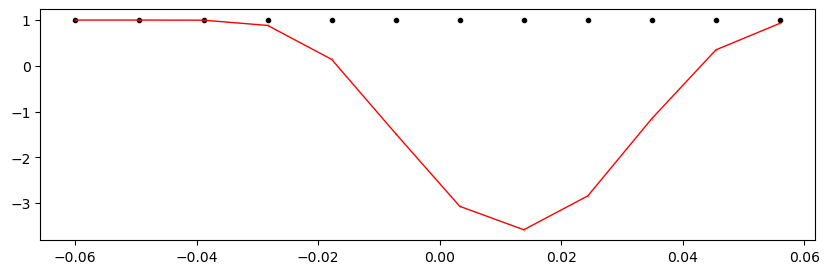

2422.3278431999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.33it/s]


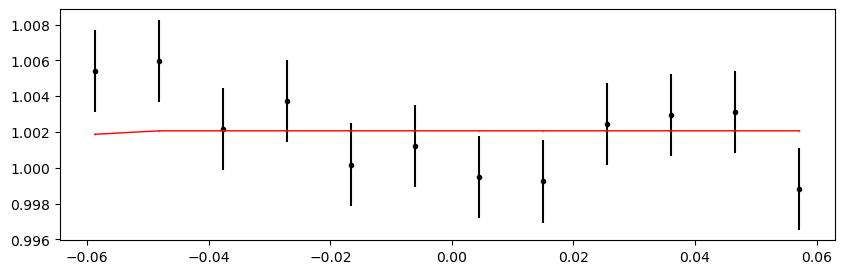

2422.98676806 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 522.50it/s]


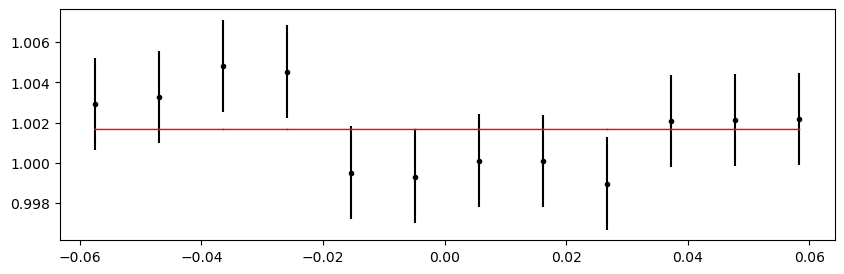

2423.64569292 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.85it/s]


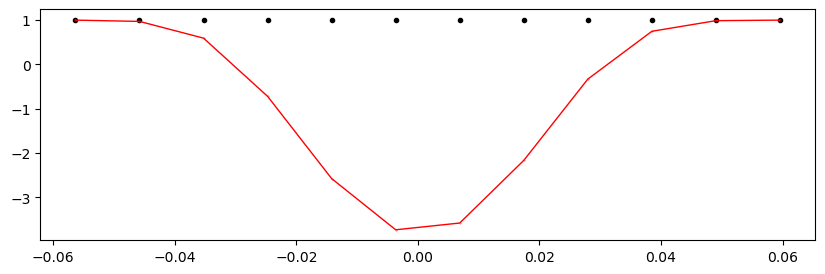

2424.3046177799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 464.87it/s]


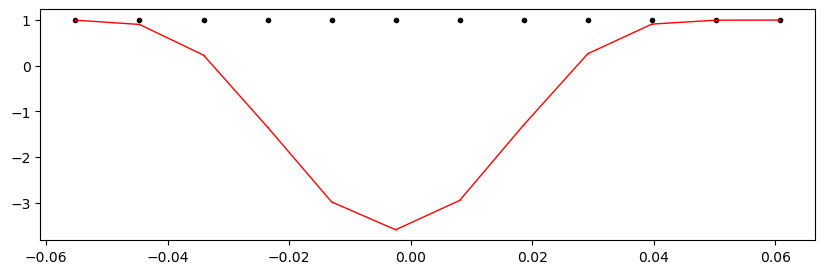

2424.96354264 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 487.44it/s]


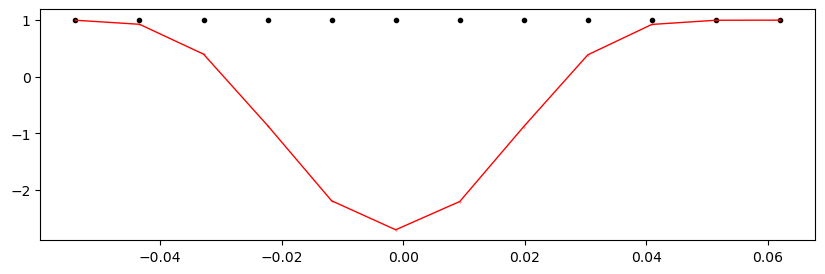

2425.6224675 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.83it/s]


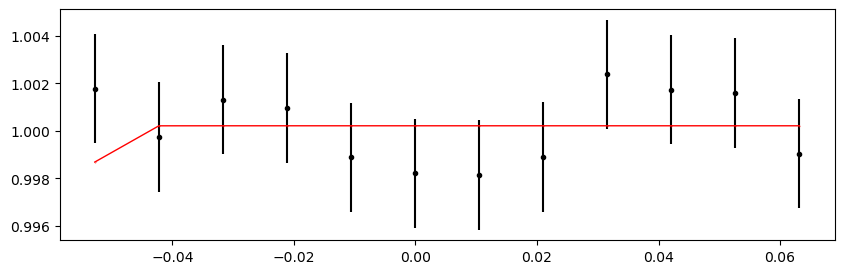

2426.2813923599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.69it/s]


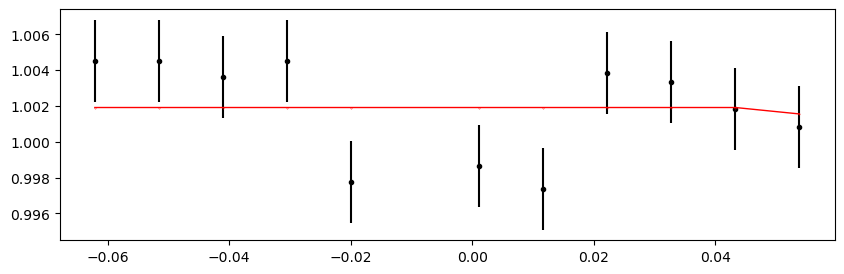

2426.94031722 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 453.88it/s]


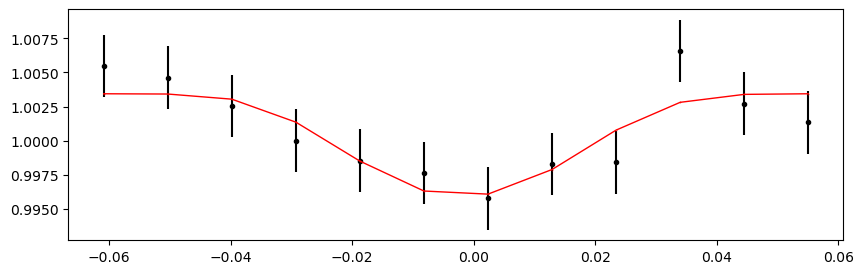

2427.59924208 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.86it/s]


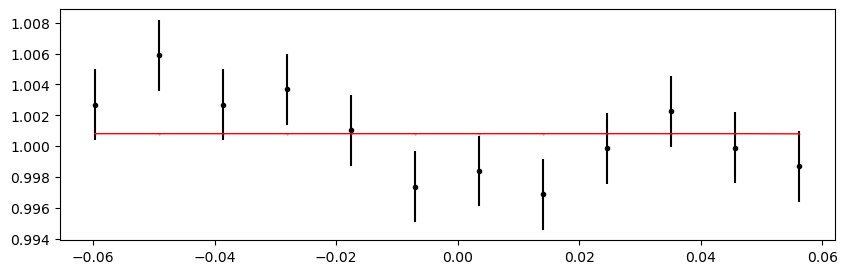

2428.25816694 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 536.24it/s]


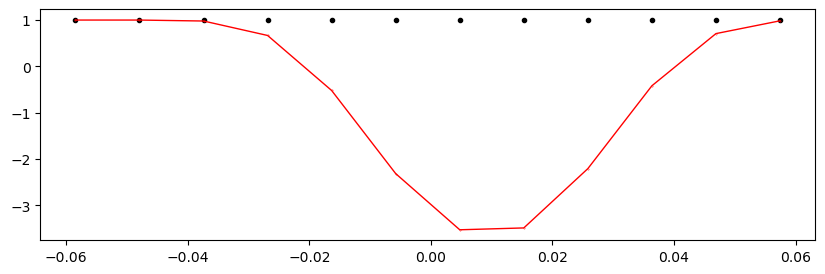

2428.9170918 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 540.95it/s]


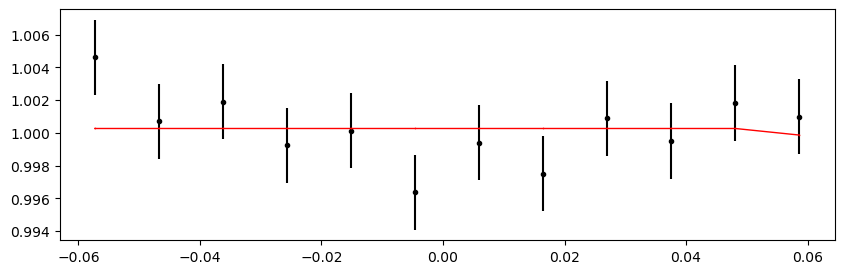

2429.57601666 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 539.13it/s]


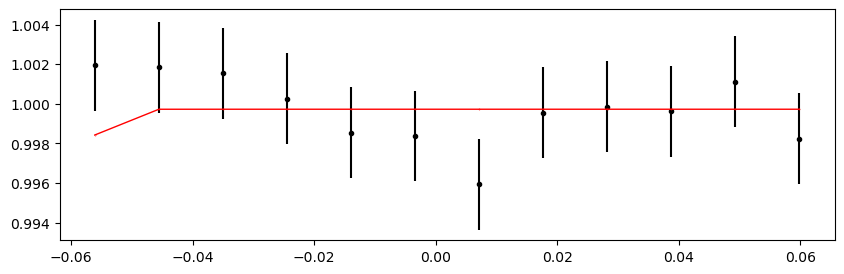

2430.23494152 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 537.26it/s]


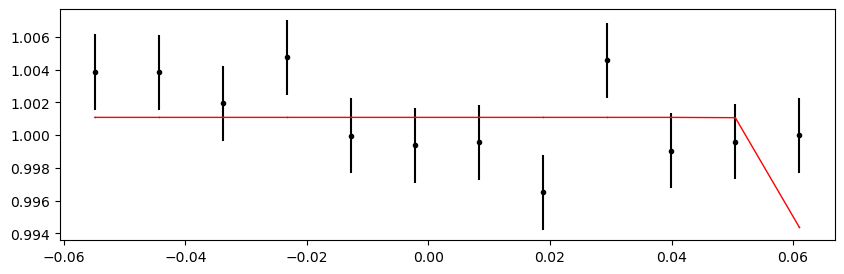

2430.89386638 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.63it/s]


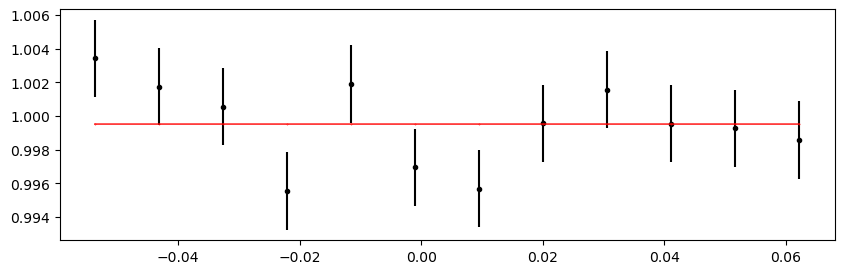

2431.55279124 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.70it/s]


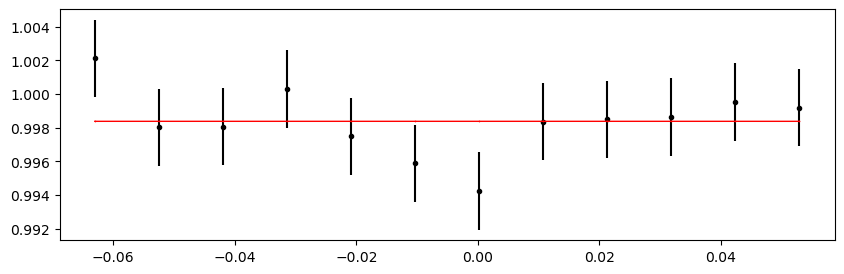

2432.2117161 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.00it/s]


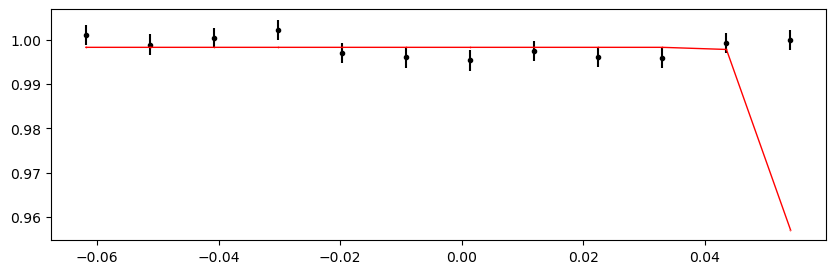

2434.18849068 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.16it/s]


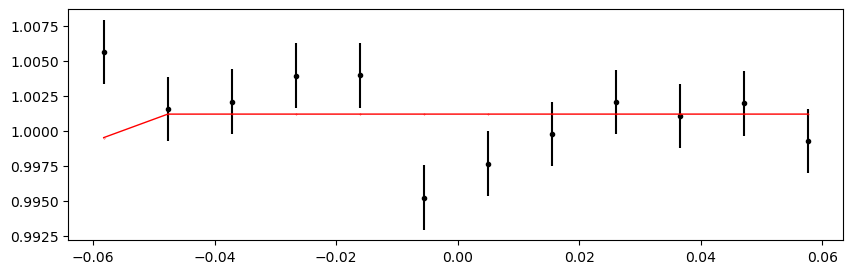

2434.84741554 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 535.47it/s]


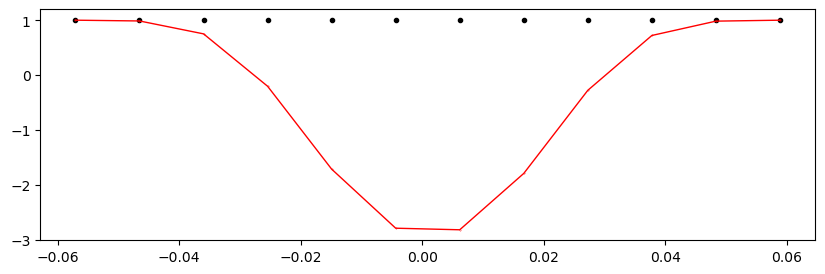

2435.5063404 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.28it/s]


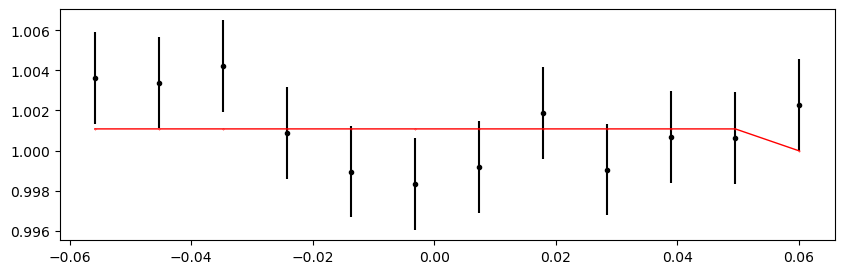

2436.16526526 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 525.36it/s]


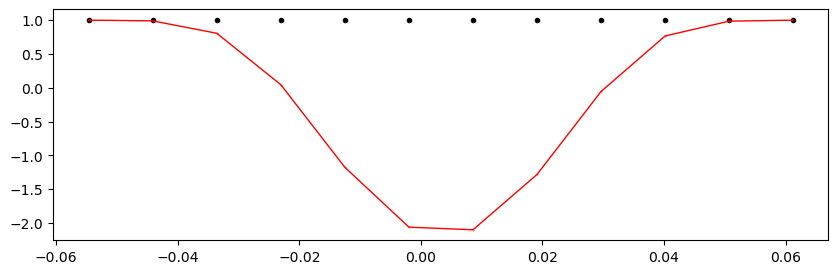

2436.82419012 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 538.69it/s]


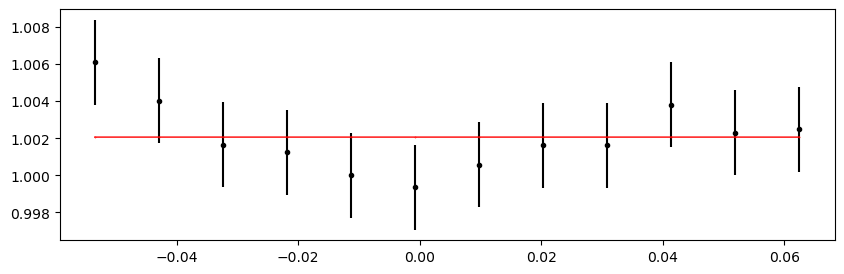

2437.48311498 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.36it/s]


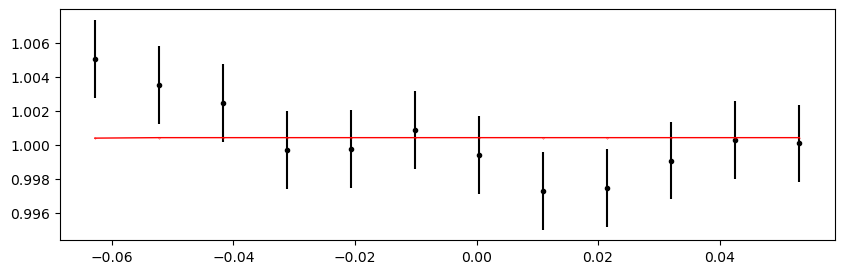

2438.14203984 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 538.69it/s]


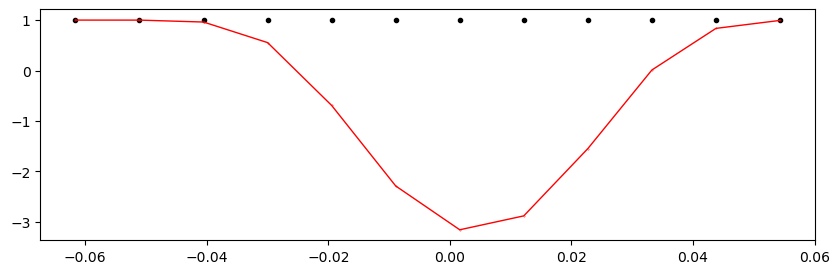

2438.8009647 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.07it/s]


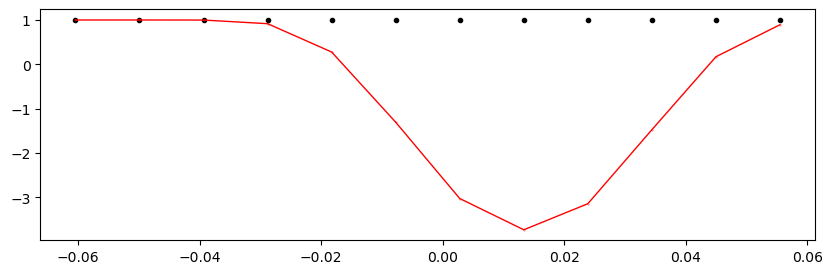

2439.45988956 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.76it/s]


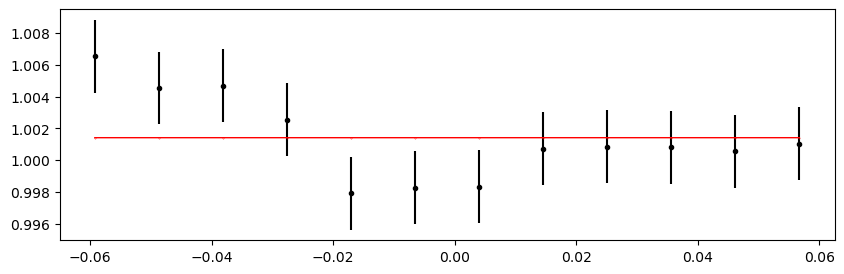

2440.11881442 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.20it/s]


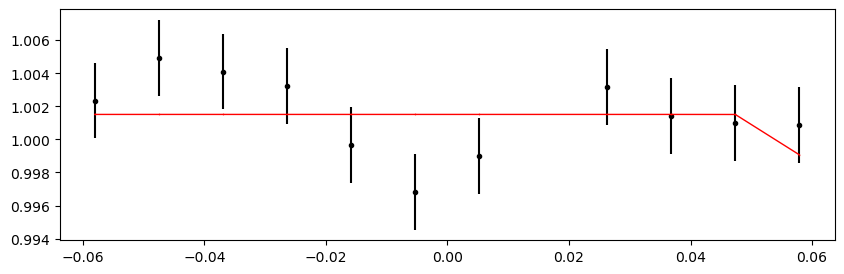

2440.77773928 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.44it/s]


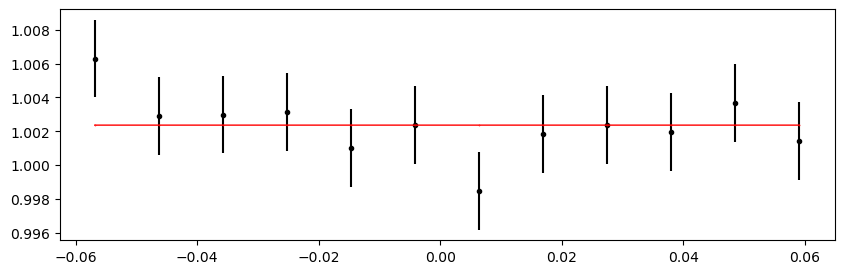

2441.43666414 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.93it/s]


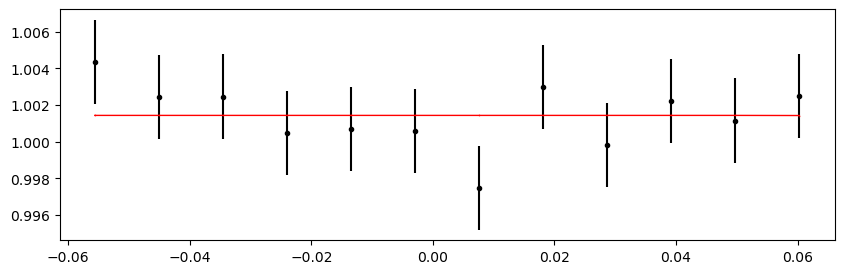

2442.095589 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.89it/s]


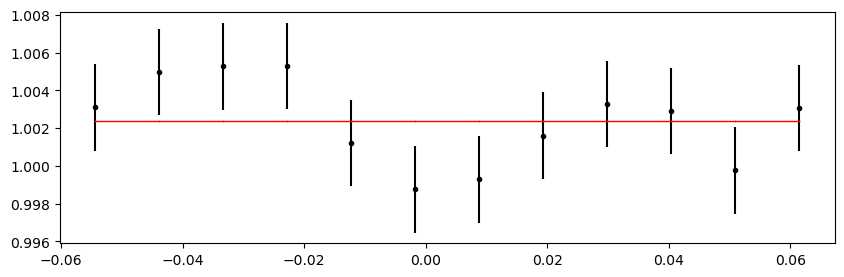

2442.75451386 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.49it/s]


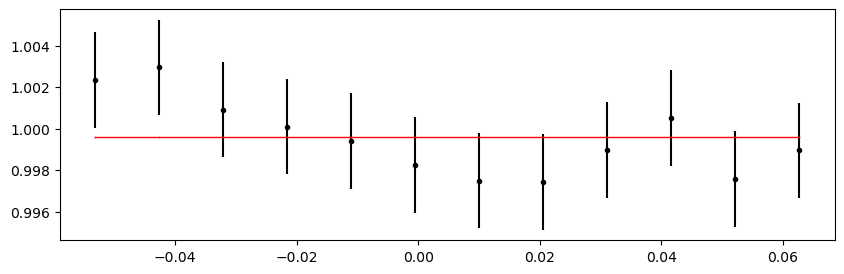

2443.41343872 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.13it/s]


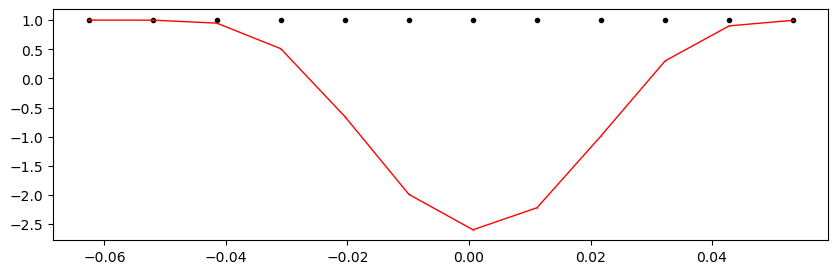

2444.07236358 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.41it/s]


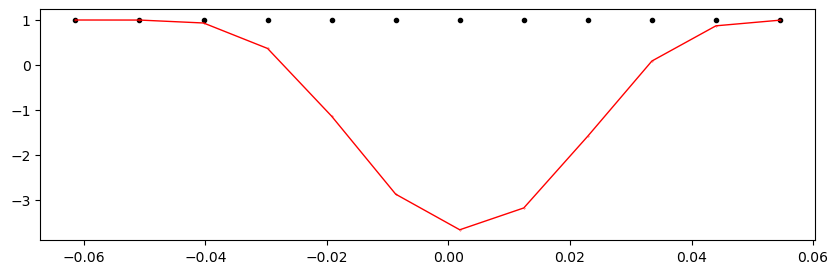

2444.73128844 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.33it/s]


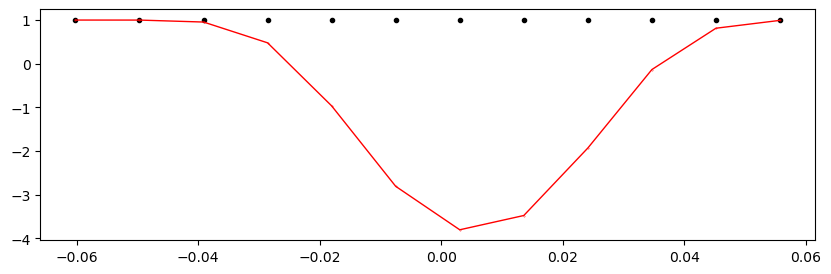

2445.3902133 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.05it/s]


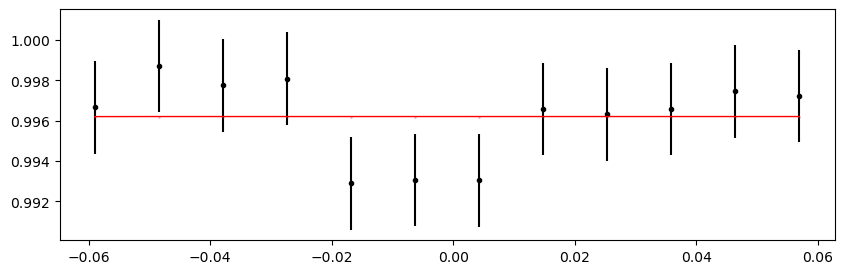

2446.04913816 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.33it/s]


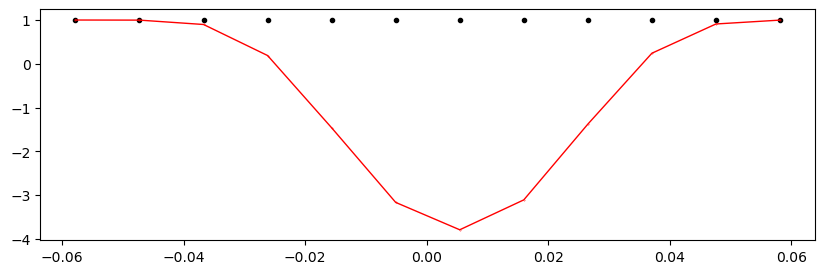

Time 2579.81088474 does not have enough data points: 7
2580.4698096 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.57it/s]


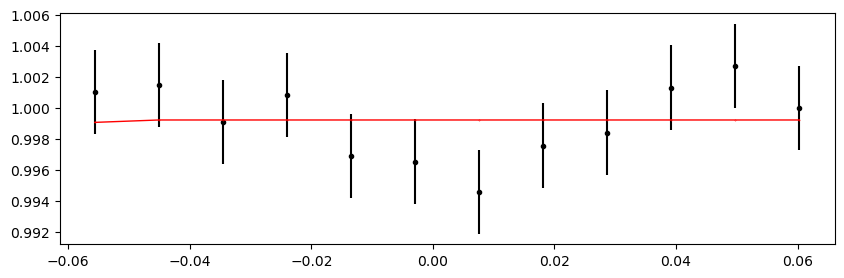

2581.12873446 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.50it/s]


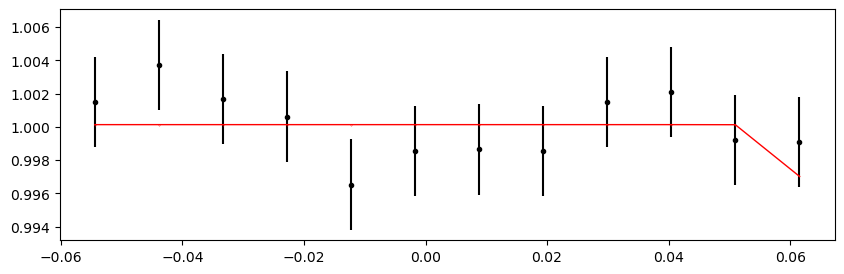

2581.78765932 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.79it/s]


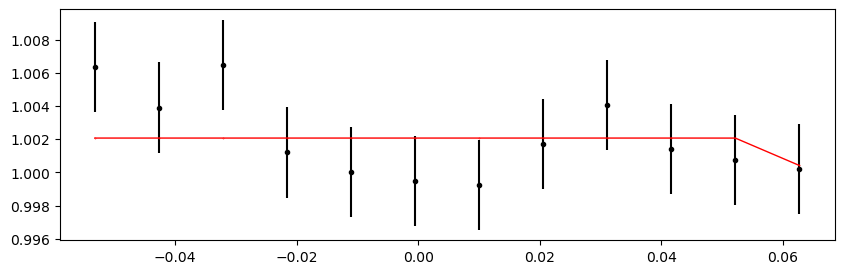

2582.44658418 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.57it/s]


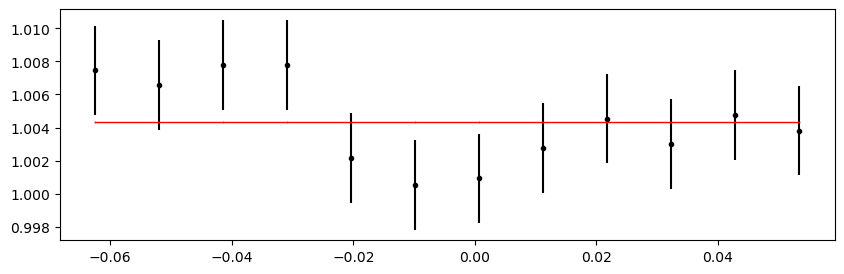

2583.10550904 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.47it/s]


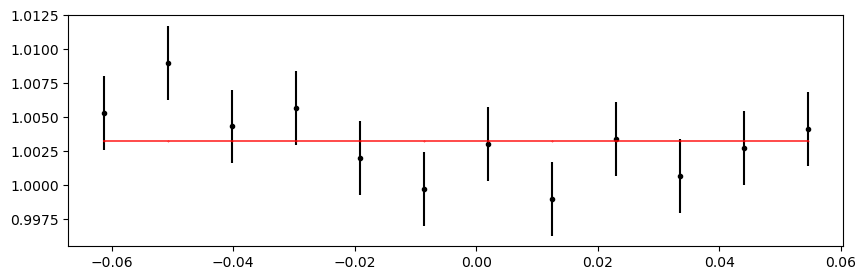

2583.7644339 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.57it/s]


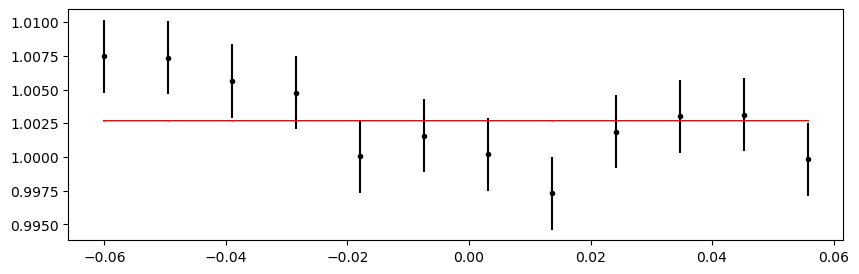

2584.42335876 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.52it/s]


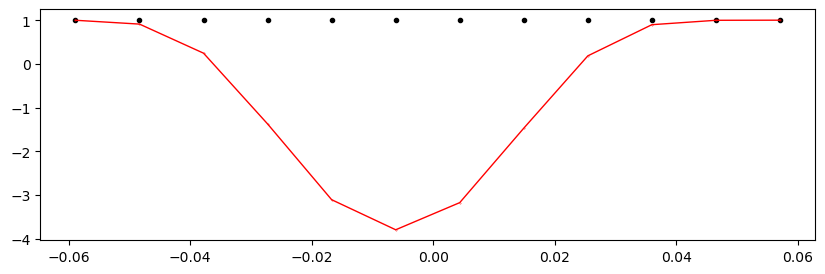

2585.08228362 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.12it/s]


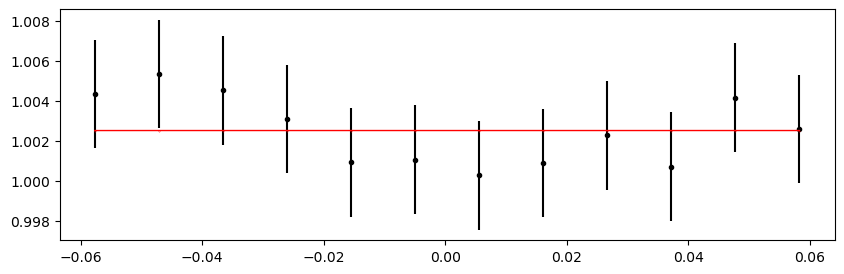

2585.74120848 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.51it/s]


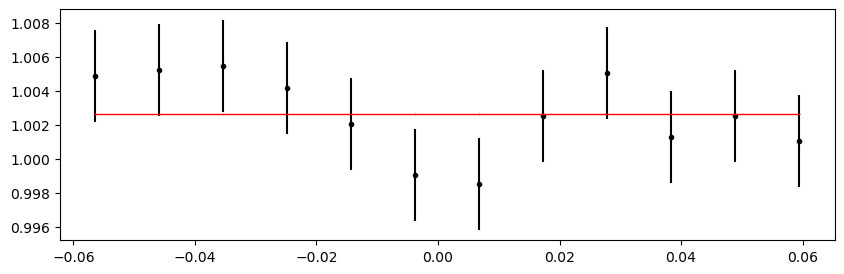

2586.40013334 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.30it/s]


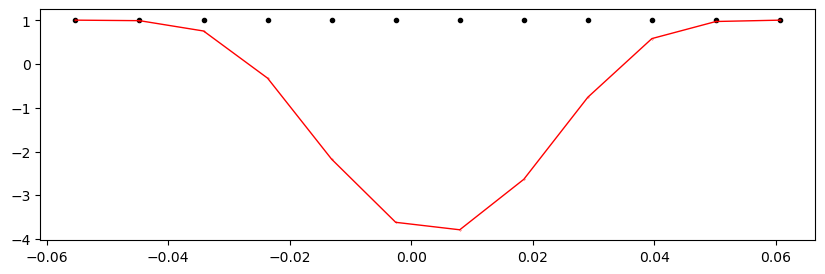

2587.0590582 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.55it/s]


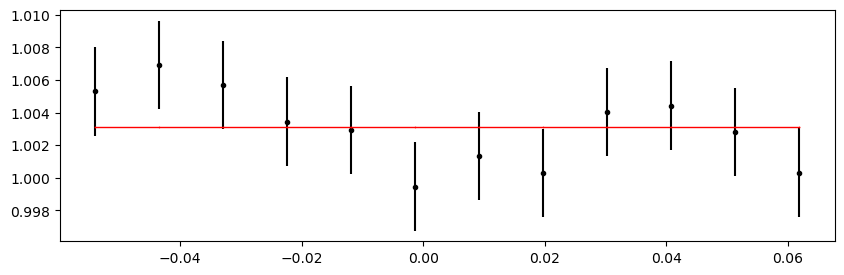

2587.71798306 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.98it/s]


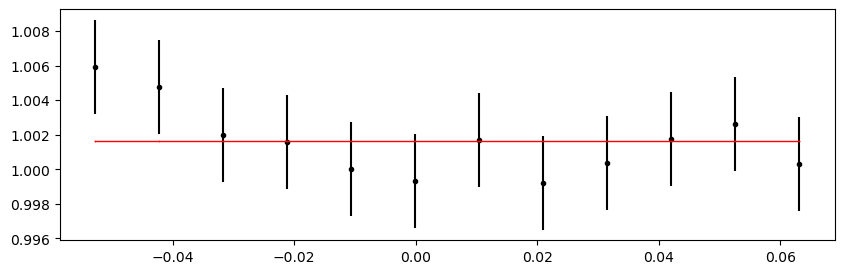

2588.37690792 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.65it/s]


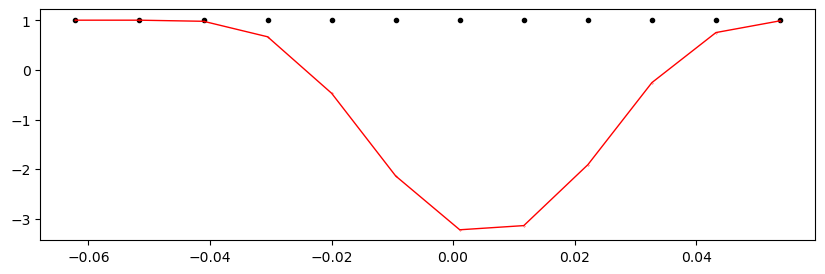

2589.03583278 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 481.06it/s]


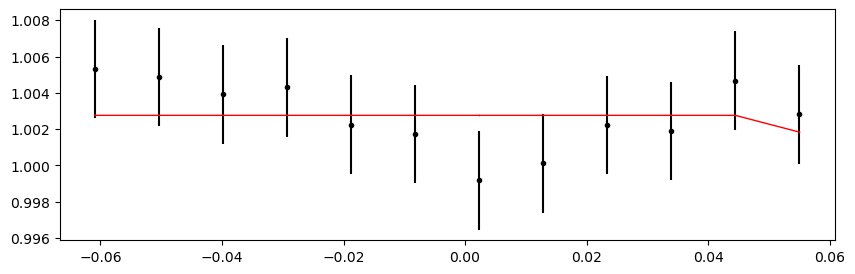

2589.69475764 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.19it/s]


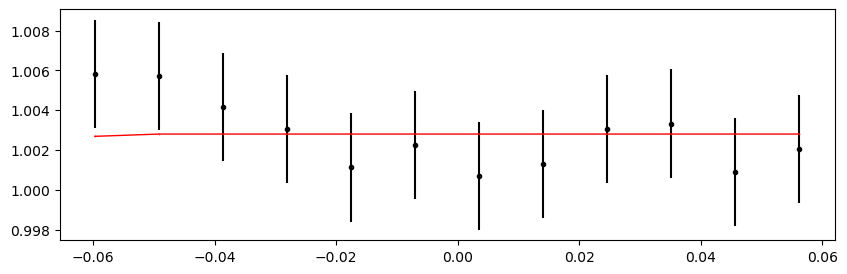

2590.3536825 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 540.13it/s]


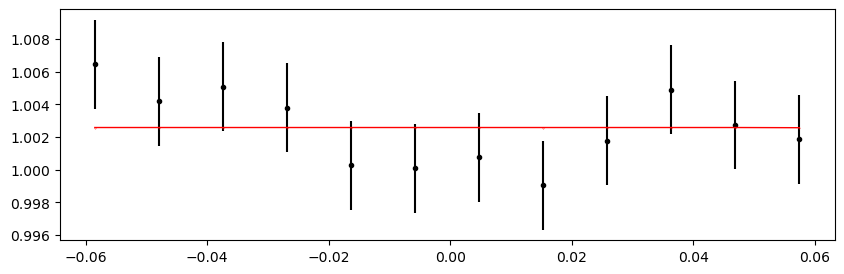

2591.01260736 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 539.56it/s]


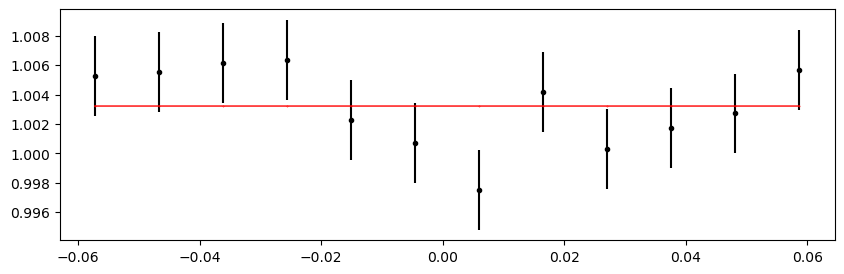

2591.67153222 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.47it/s]


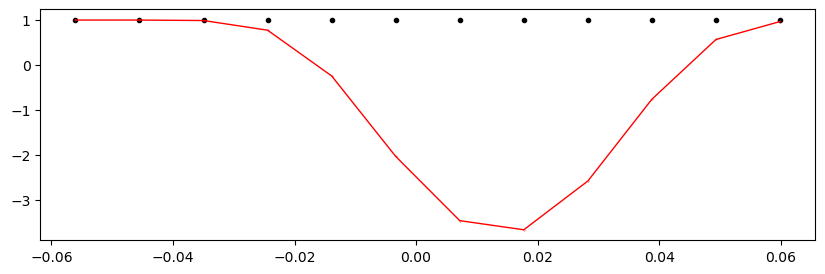

2592.33045708 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.83it/s]


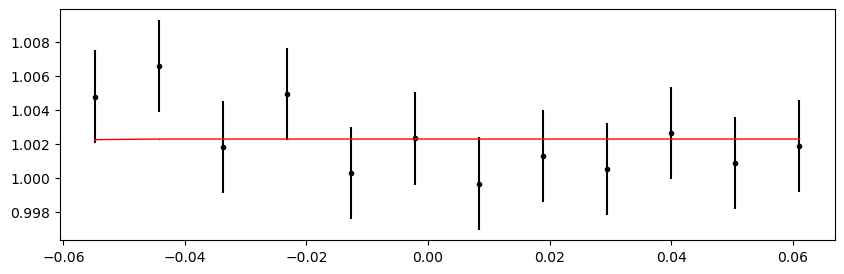

Time 2592.98938194 does not have enough data points: 1
2594.30723166 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 529.94it/s]


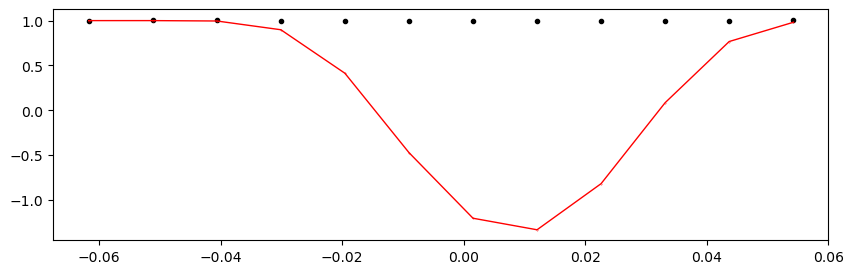

2594.96615652 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.91it/s]


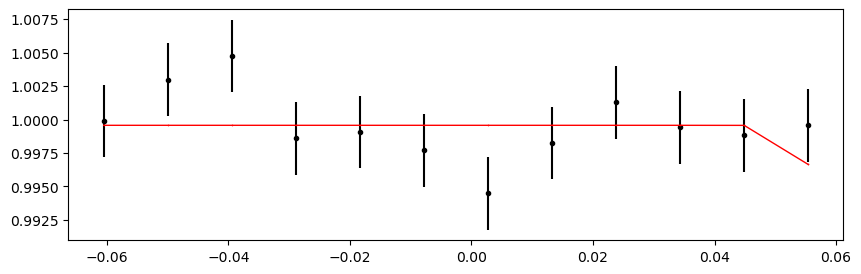

2595.6250813799998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.00it/s]


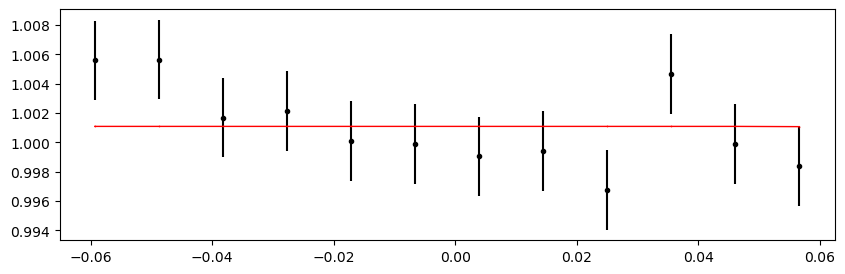

2596.28400624 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.16it/s]


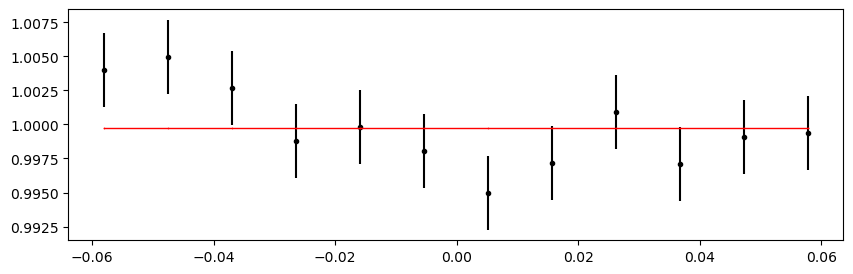

2596.9429311 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.48it/s]


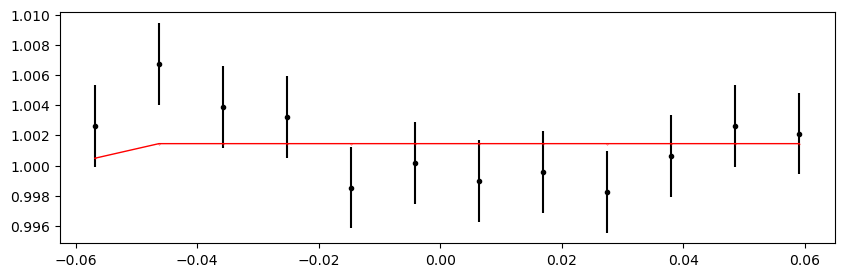

2597.6018559599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.08it/s]


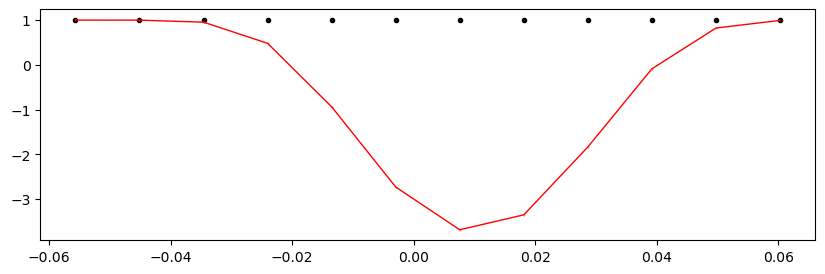

2598.26078082 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.42it/s]


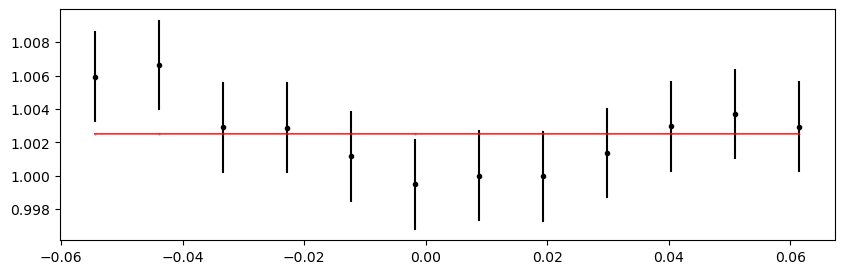

2598.91970568 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.34it/s]


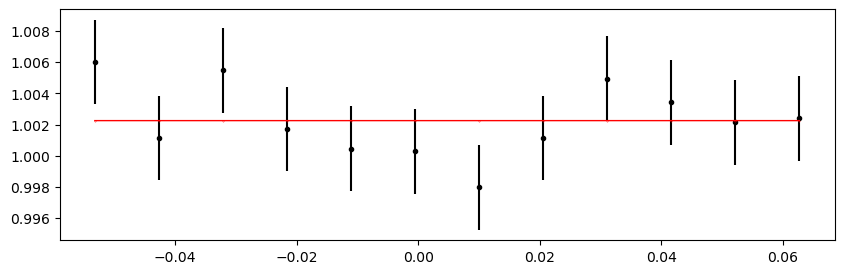

2599.5786305399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.82it/s]


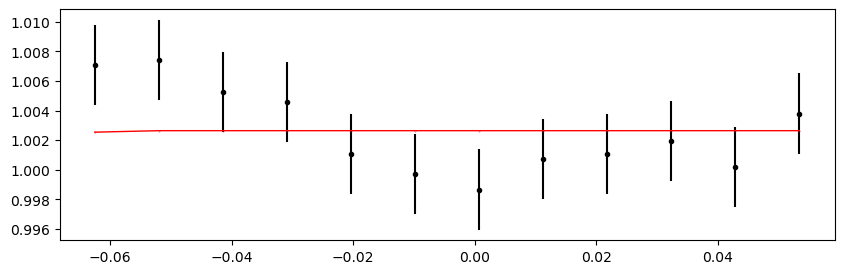

2600.2375554 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 531.87it/s]


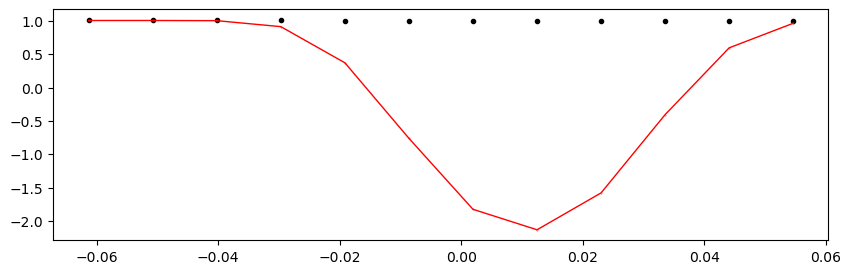

2600.89648026 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.17it/s]


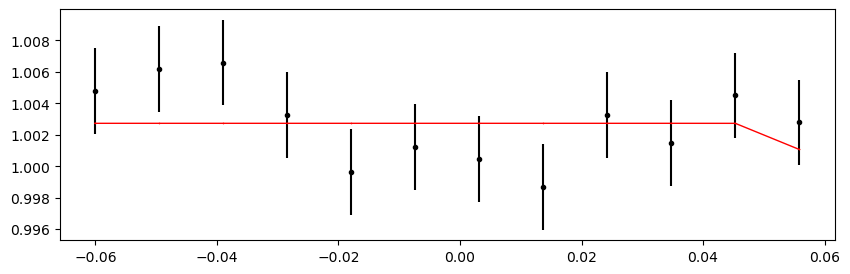

2601.5554051199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.76it/s]


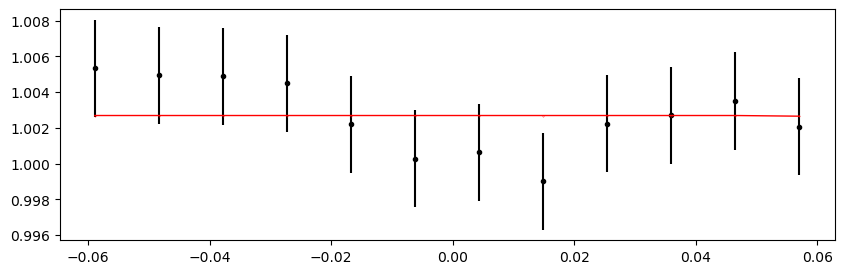

2602.21432998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.18it/s]


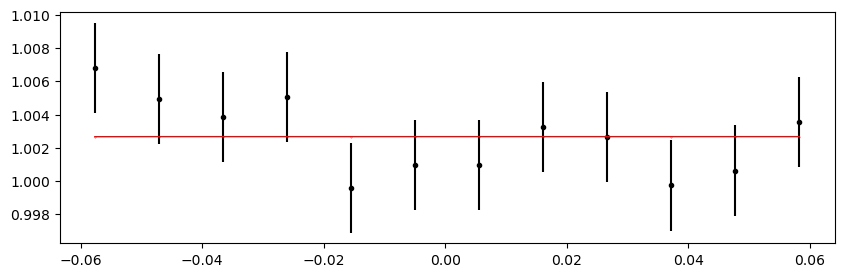

2602.87325484 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.10it/s]


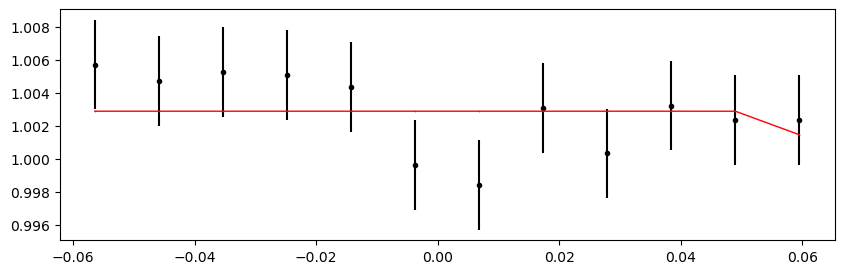

2603.5321796999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.38it/s]


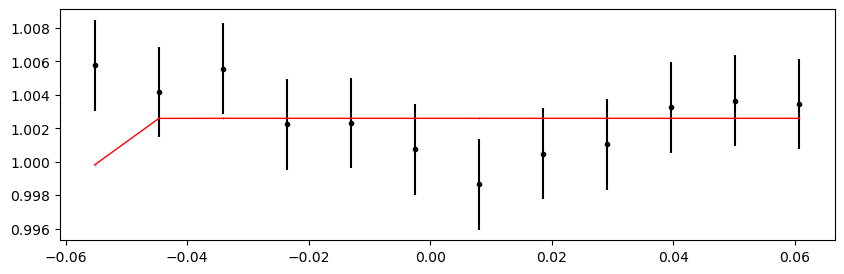

2604.19110456 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.93it/s]


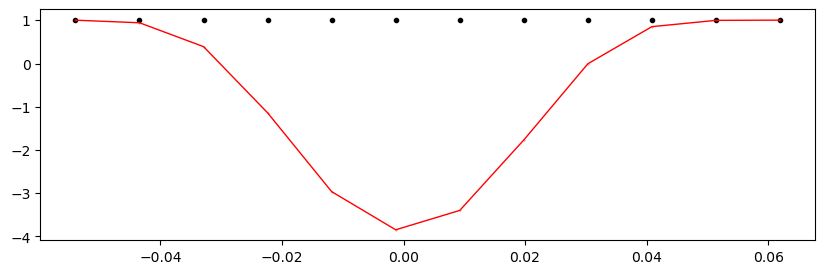

2604.85002942 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 539.71it/s]


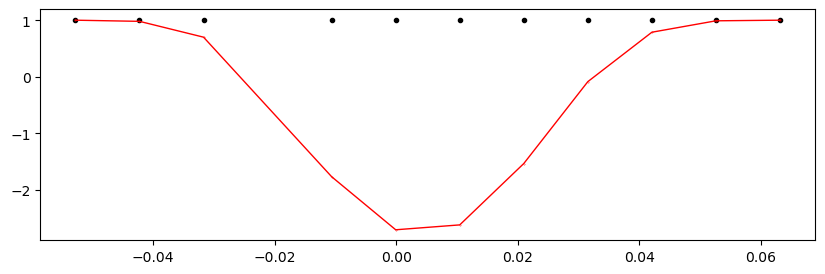

2605.50895428 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.25it/s]


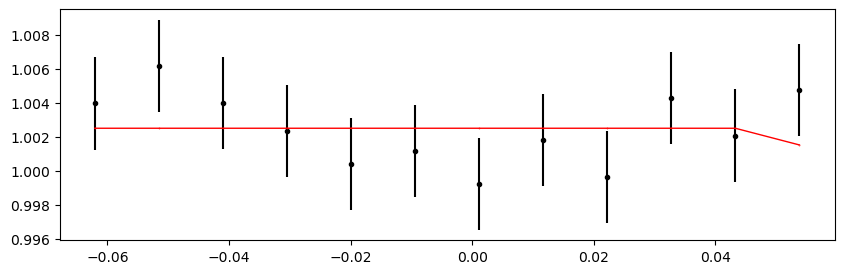

2606.16787914 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.12it/s]


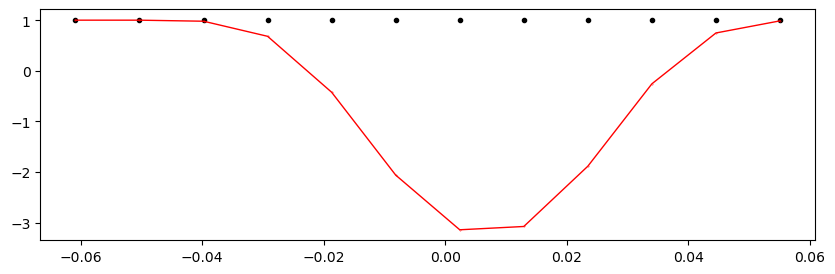

2606.826804 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.05it/s]


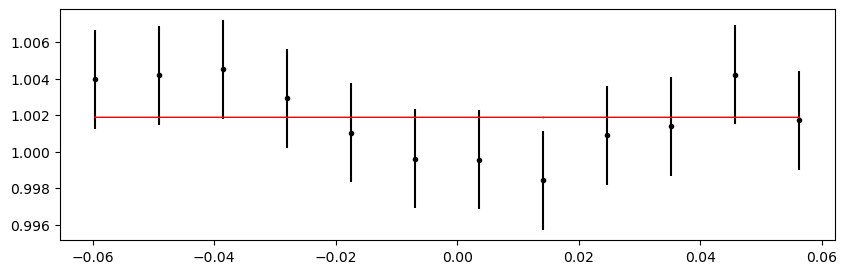

2608.14465372 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 532.10it/s]


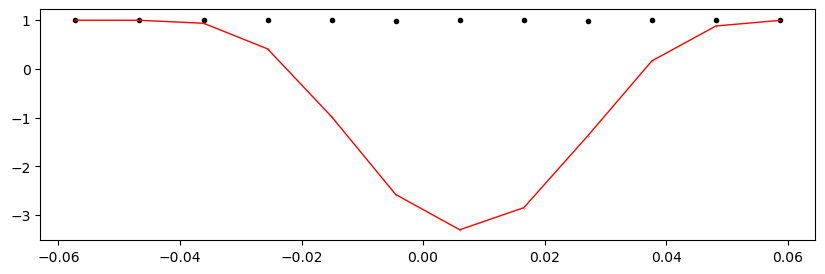

2608.80357858 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.26it/s]


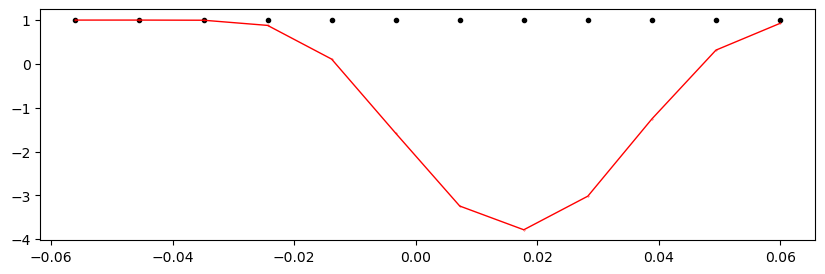

2609.46250344 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 435.09it/s]


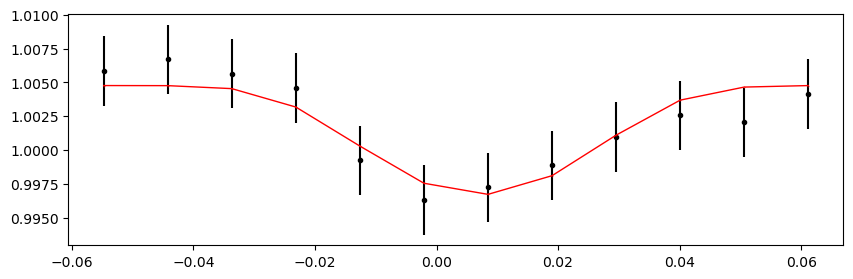

2610.1214283 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.84it/s]


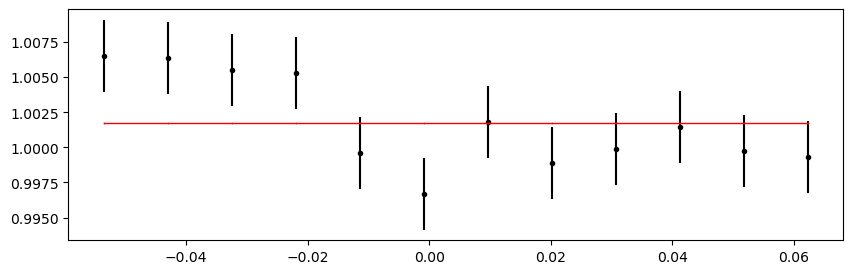

2610.7803531600002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.30it/s]


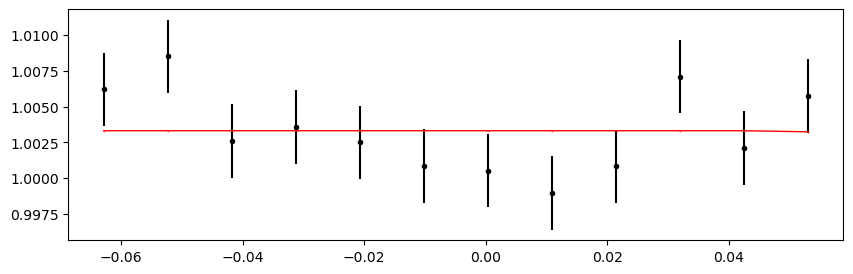

2611.43927802 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.79it/s]


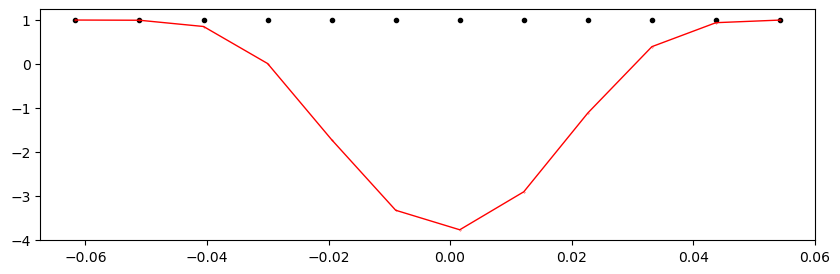

2612.09820288 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.31it/s]


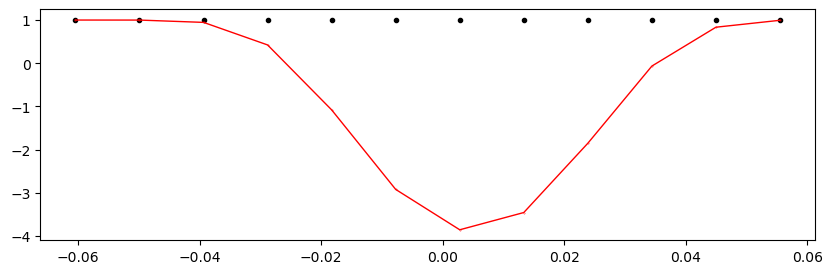

2612.75712774 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 533.91it/s]


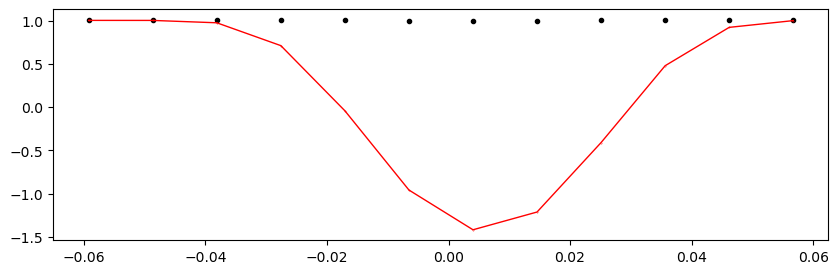

2613.4160526 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.34it/s]


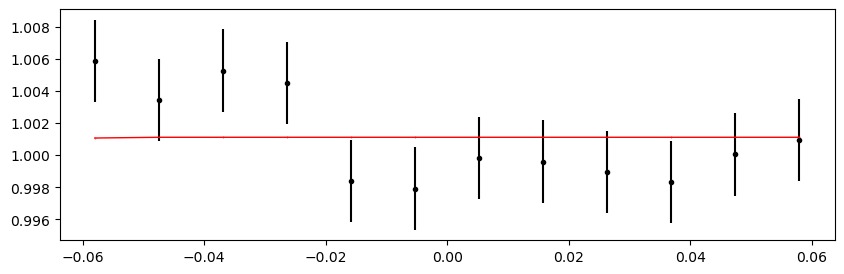

2614.07497746 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 536.44it/s]


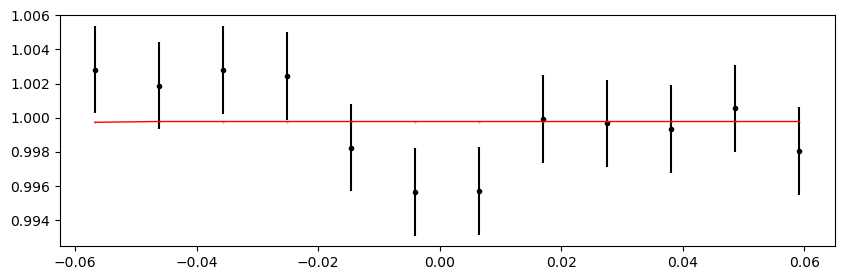

2614.73390232 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.66it/s]


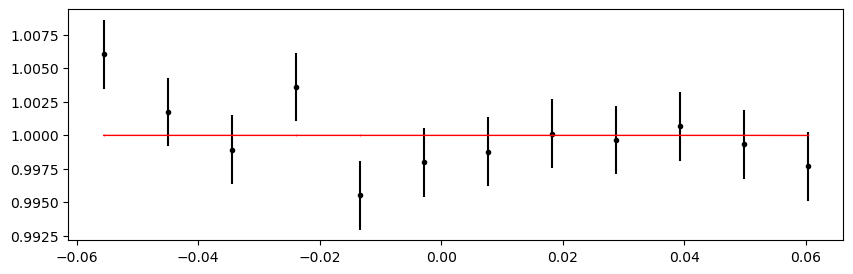

2615.39282718 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.54it/s]


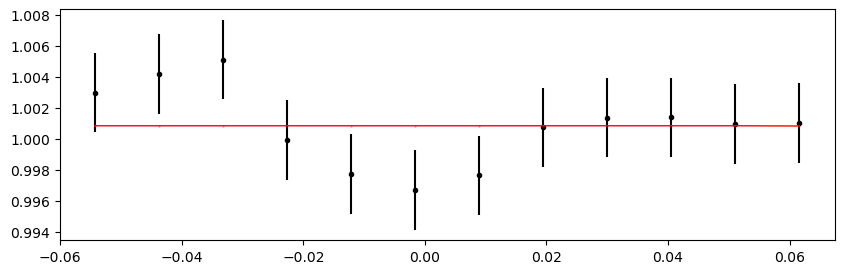

2616.05175204 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.49it/s]


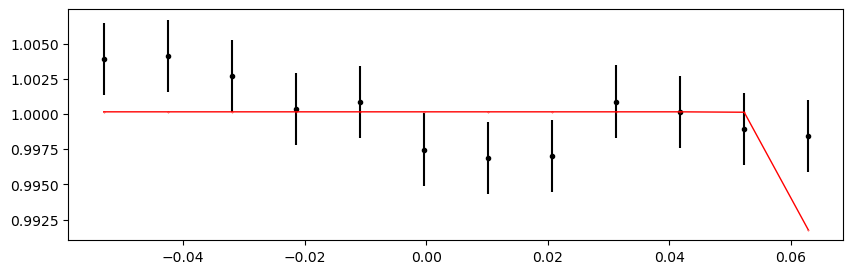

2616.7106769 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.99it/s]


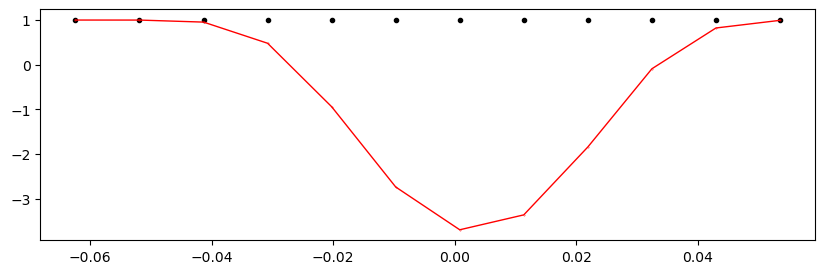

2617.36960176 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.03it/s]


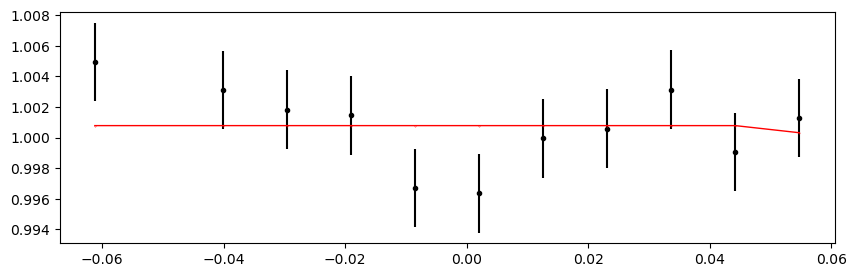

2618.02852662 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.73it/s]


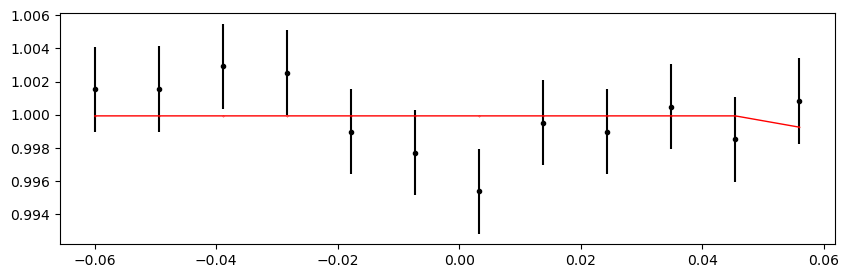

2618.68745148 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.26it/s]


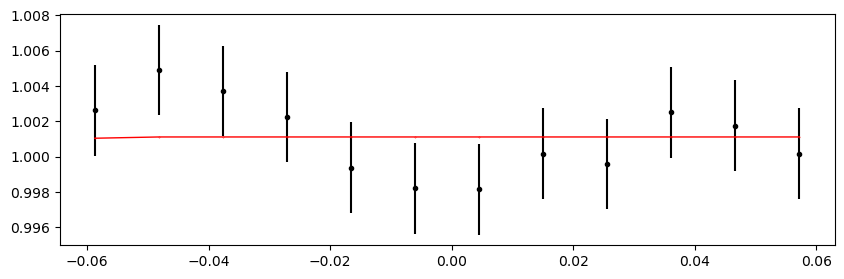

2619.34637634 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.20it/s]


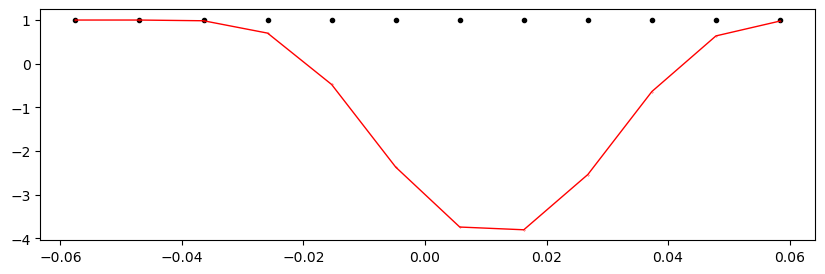

2620.0053012 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.96it/s]


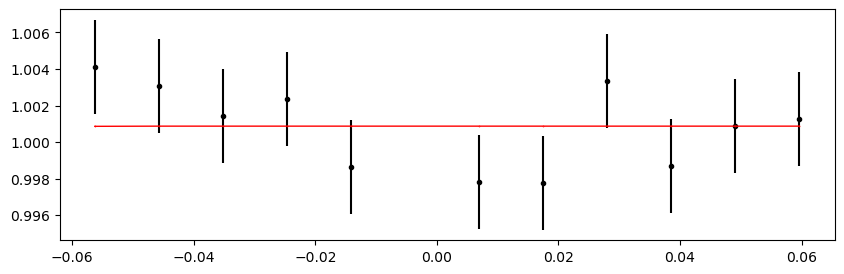

2620.66422606 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.61it/s]


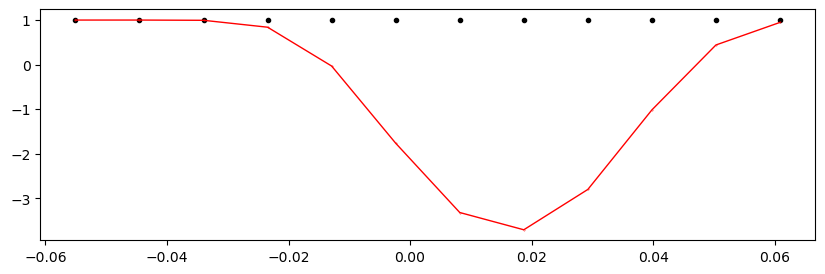

2621.32315092 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.80it/s]


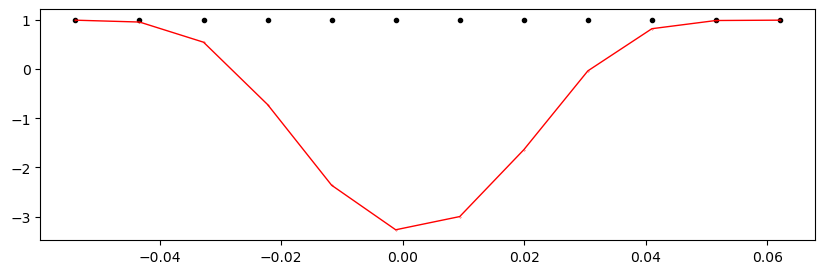

2623.2999255 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.50it/s]


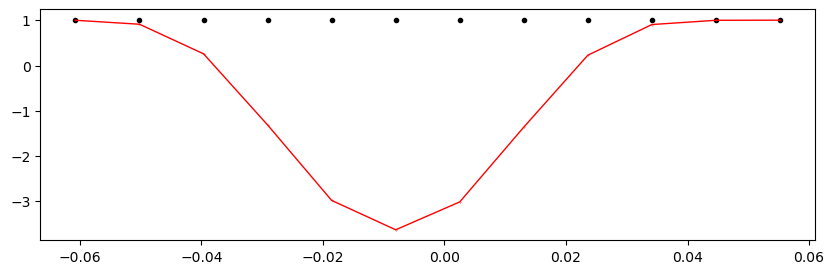

2623.95885036 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.48it/s]


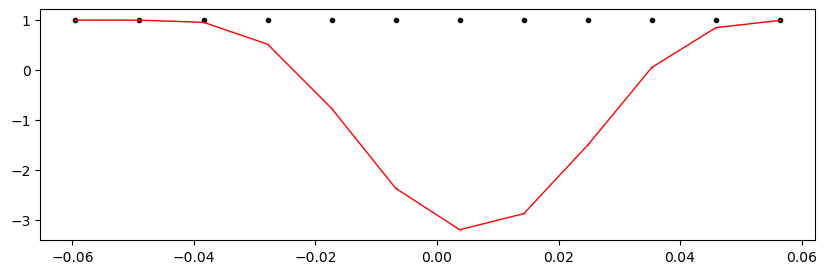

2624.61777522 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.33it/s]


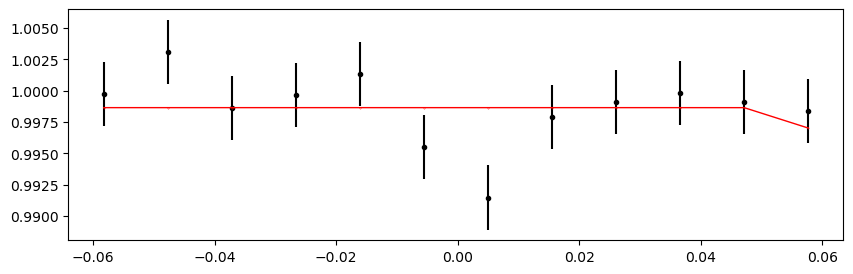

2625.27670008 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.67it/s]


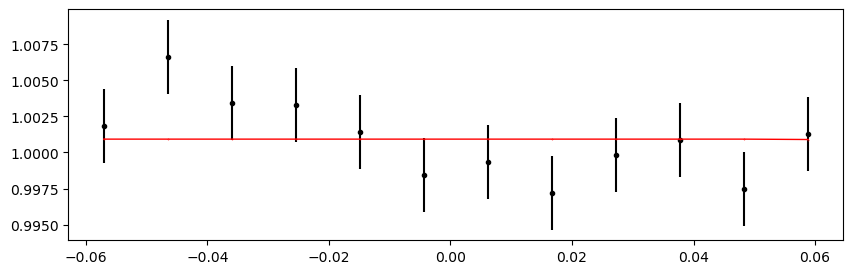

Time 2625.93562494 does not have enough data points: 10
2626.5945498 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.25it/s]


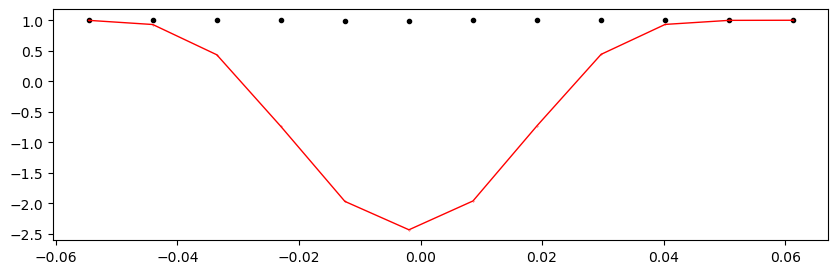

2627.25347466 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.47it/s]


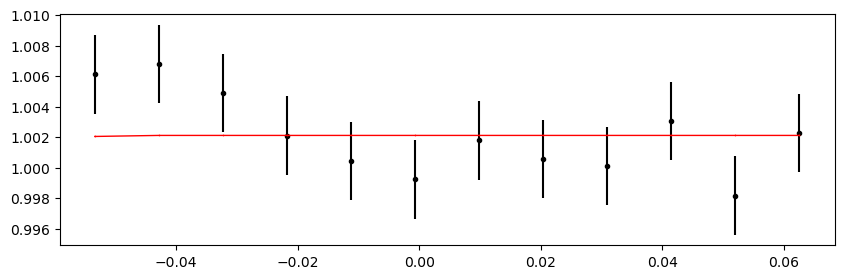

2627.91239952 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 455.68it/s]


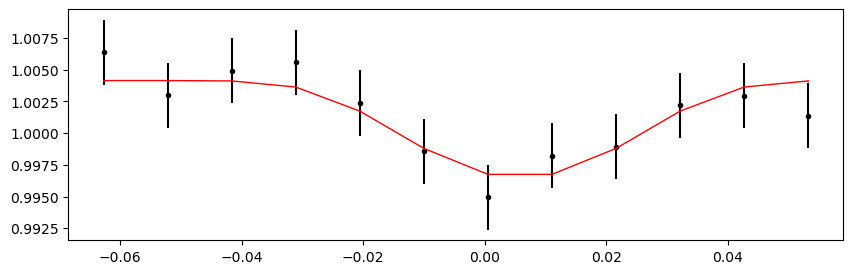

2628.57132438 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.64it/s]


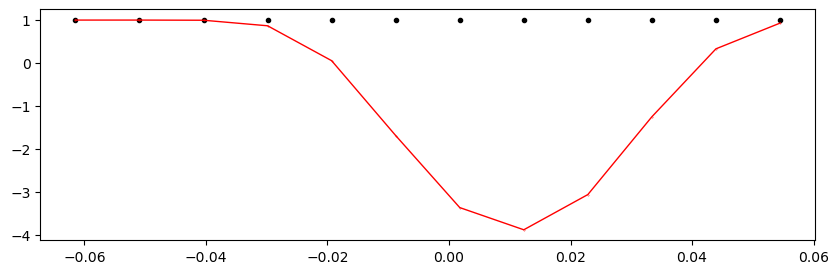

2629.23024924 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.56it/s]


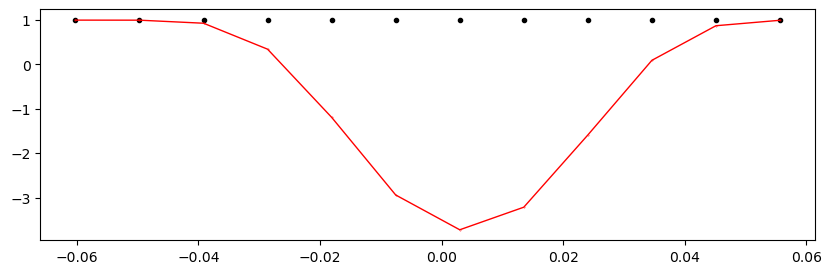

2629.8891740999998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.54it/s]


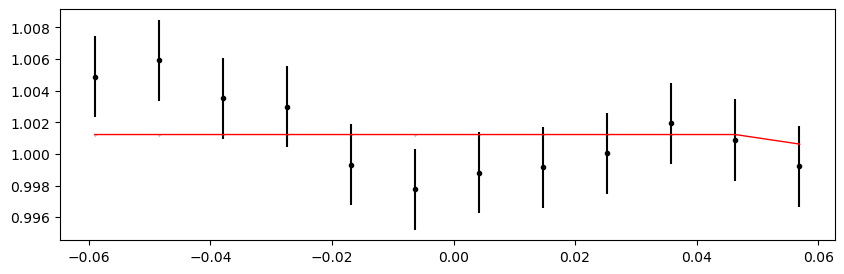

2630.54809896 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.84it/s]


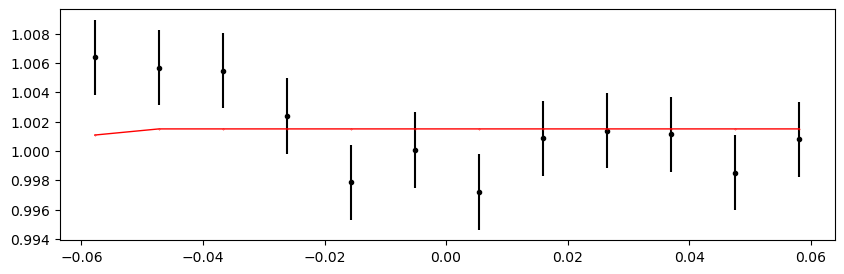

2631.20702382 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.26it/s]


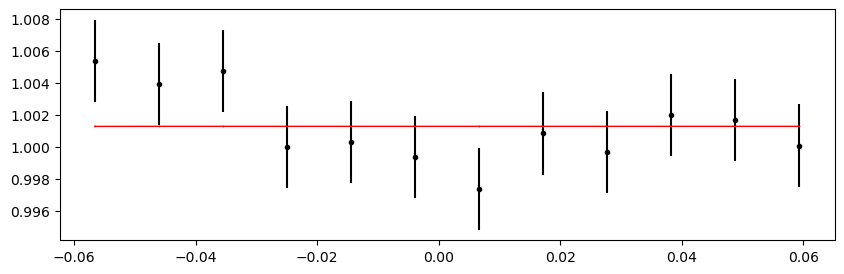

2631.8659486799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.48it/s]


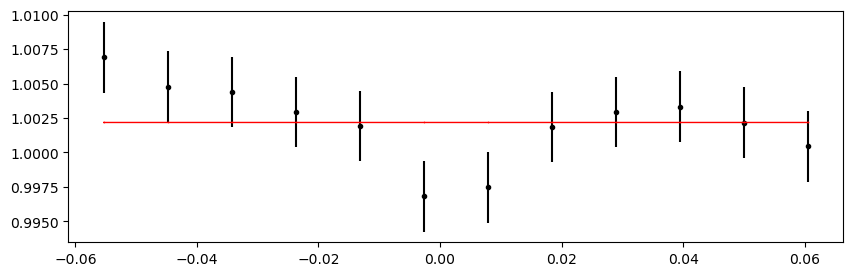

2632.52487354 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.30it/s]


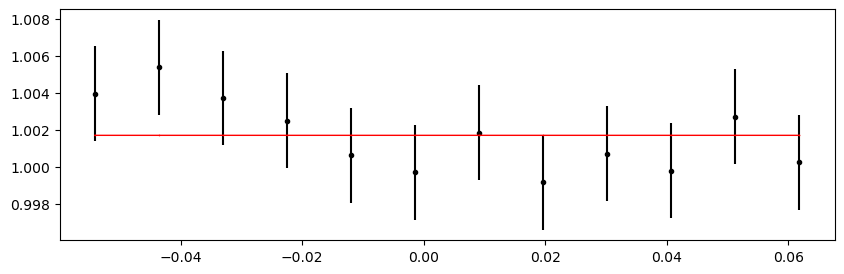

2633.1837984 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.00it/s]


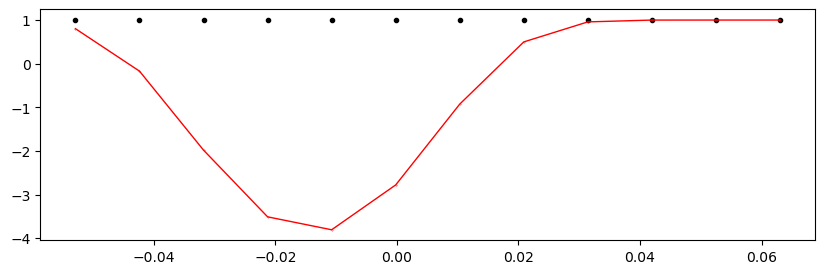

2633.8427232599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.15it/s]


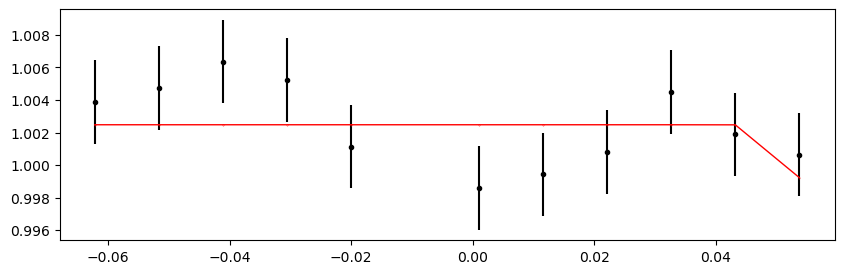

2634.50164812 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.45it/s]


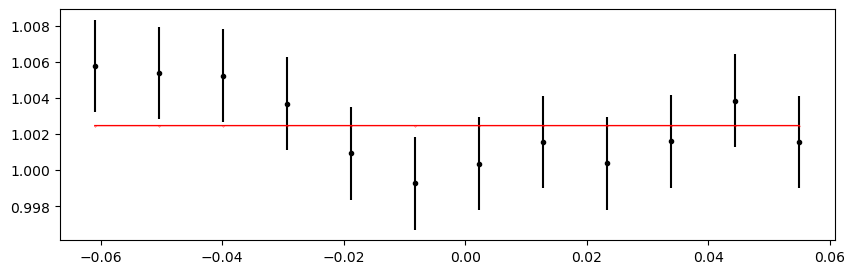

2635.16057298 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.00it/s]


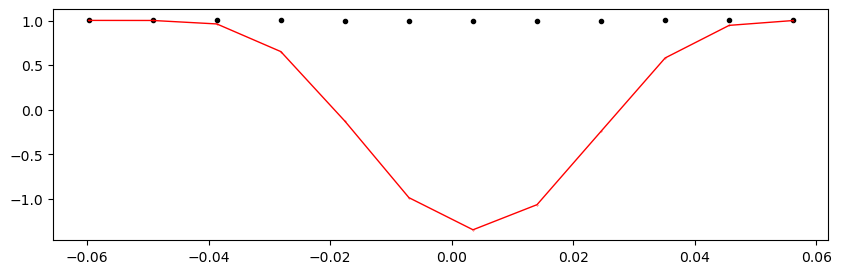

2635.8194978399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.42it/s]


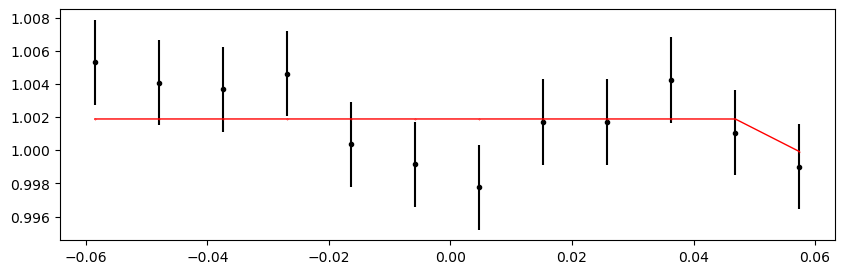

2637.7962724199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.82it/s]


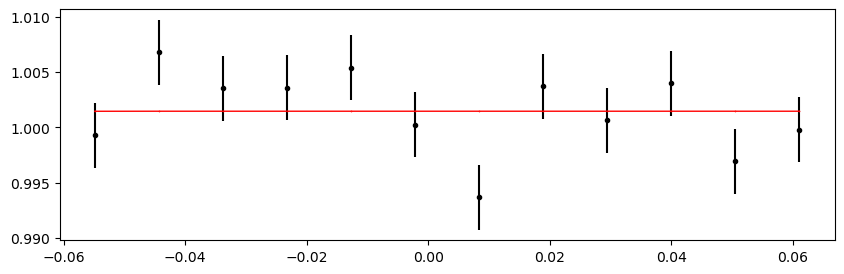

2638.45519728 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.42it/s]


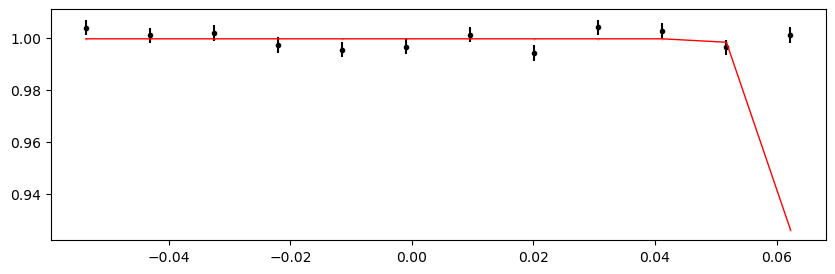

2639.11412214 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.49it/s]


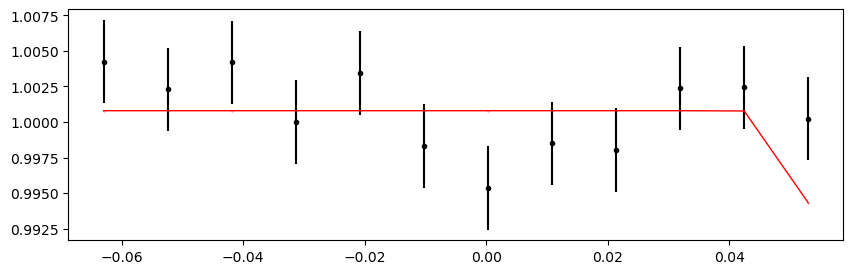

Time 2639.7730469999997 does not have enough data points: 10
2640.43197186 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 558.24it/s]


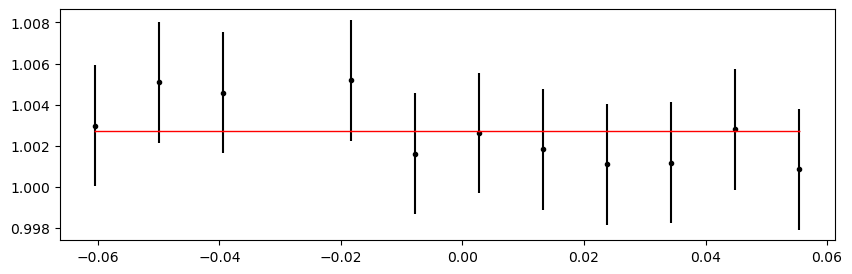

2641.09089672 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.88it/s]


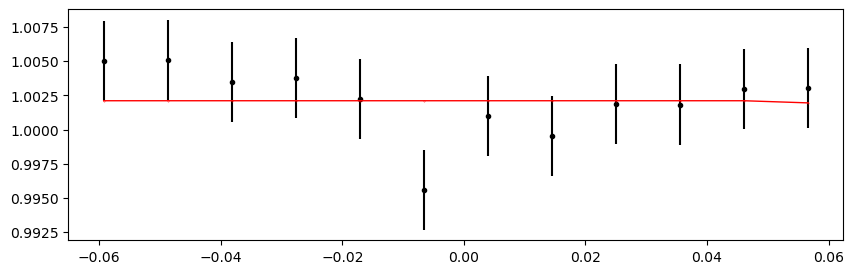

2641.74982158 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.33it/s]


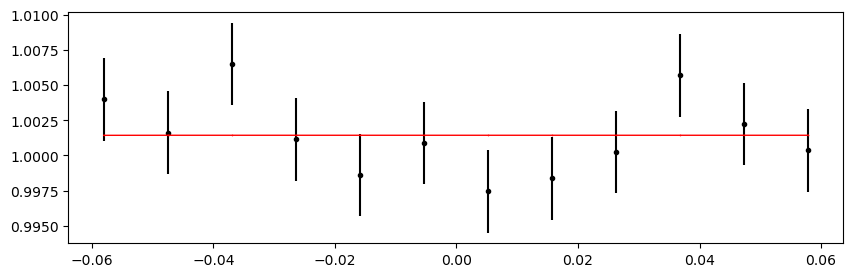

2642.40874644 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.04it/s]


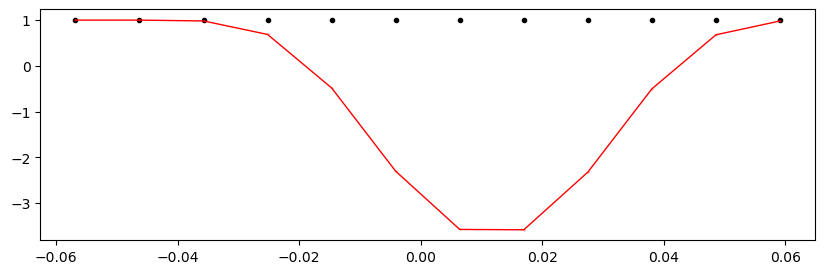

2643.0676713 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.38it/s]


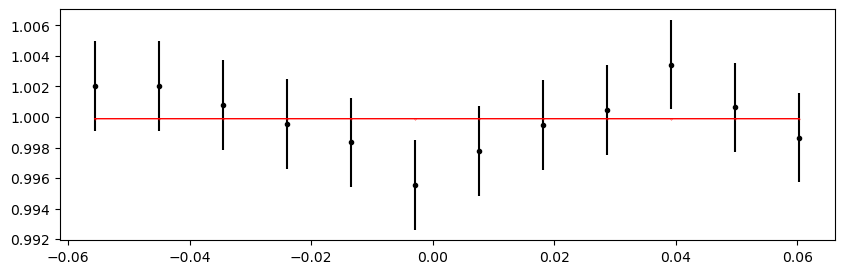

2643.72659616 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.21it/s]


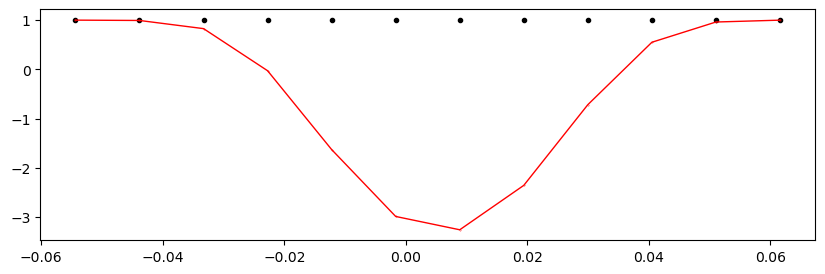

2644.38552102 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.54it/s]


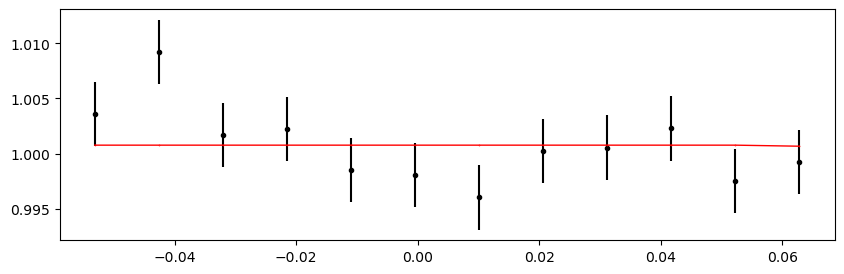

2645.0444458800002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.83it/s]


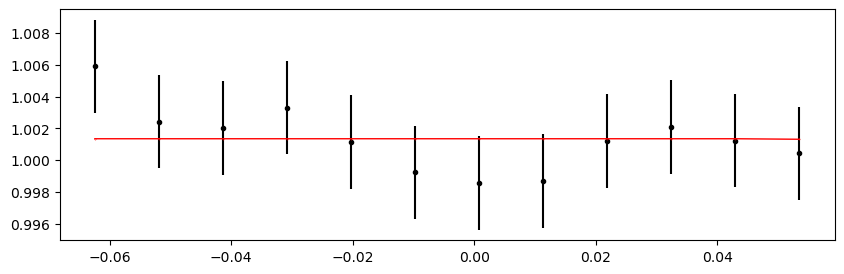

Time 2645.70337074 does not have enough data points: 10
2646.3622956 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.86it/s]


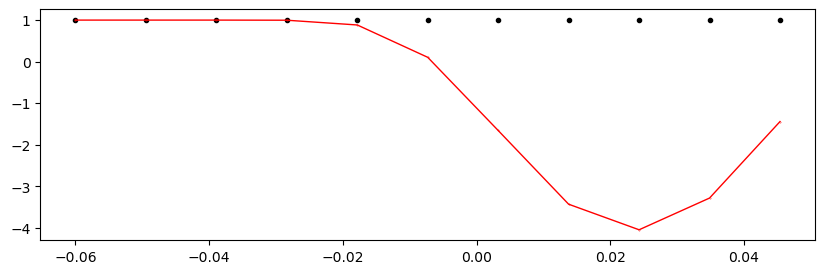

2647.02122046 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.69it/s]


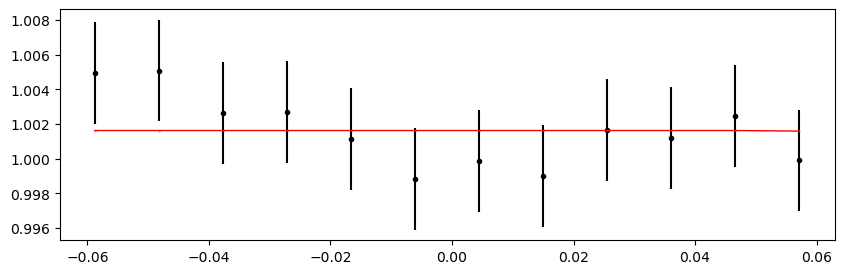

2647.68014532 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.43it/s]


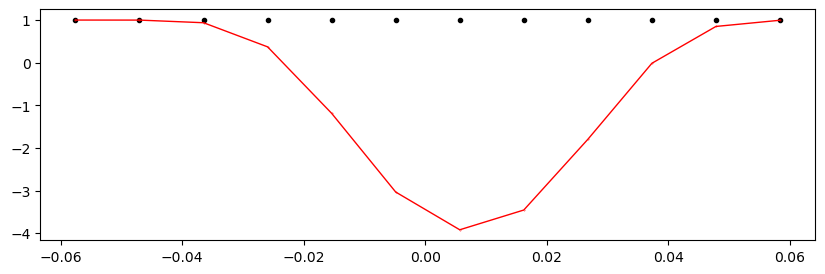

2648.33907018 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.32it/s]


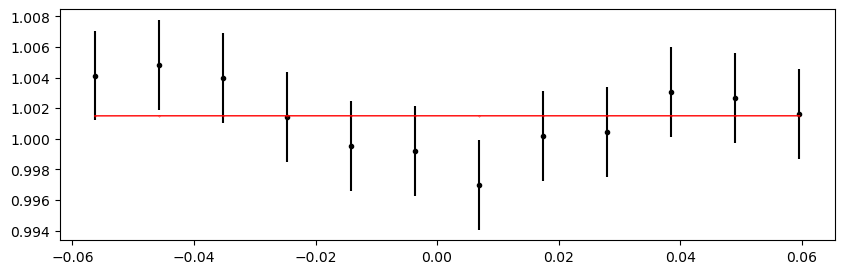

2648.99799504 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.11it/s]


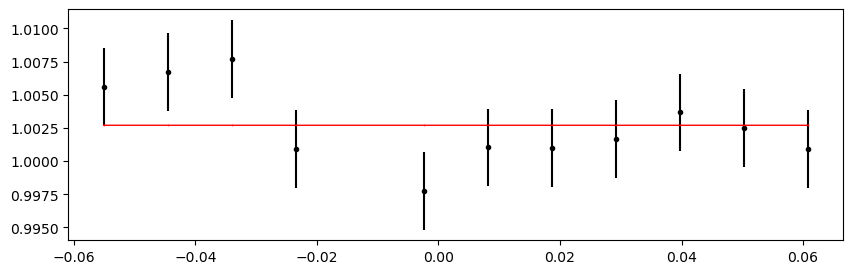

2649.6569199 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.10it/s]


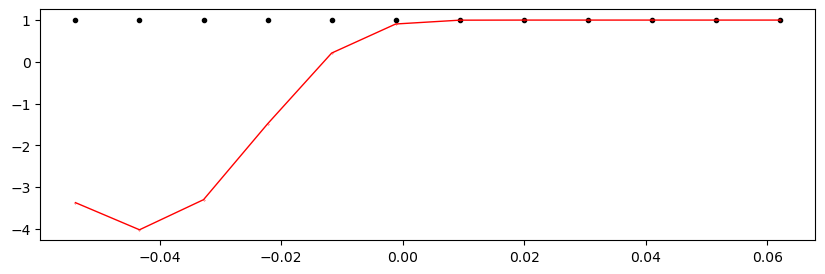

2650.31584476 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.74it/s]


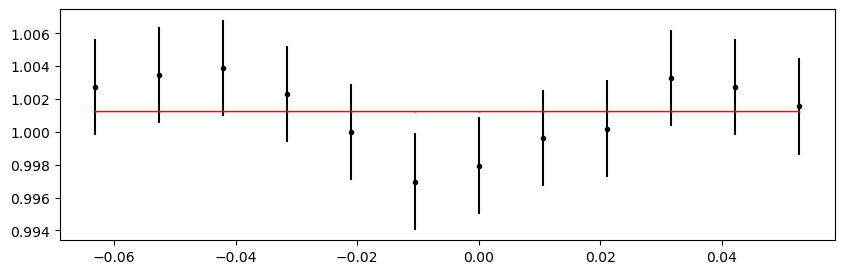

2651.63369448 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.41it/s]


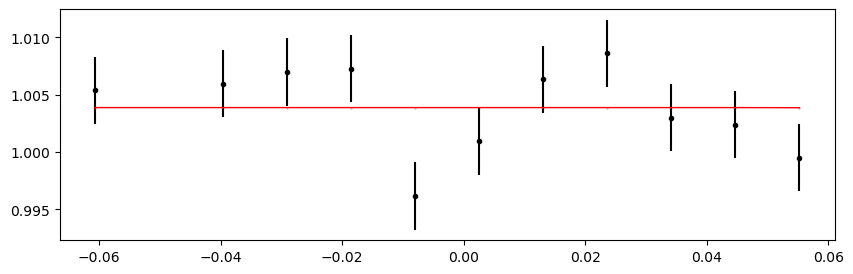

2652.29261934 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.80it/s]


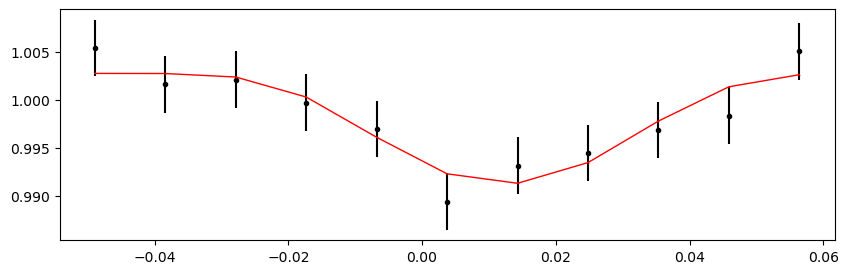

2652.9515442 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.40it/s]


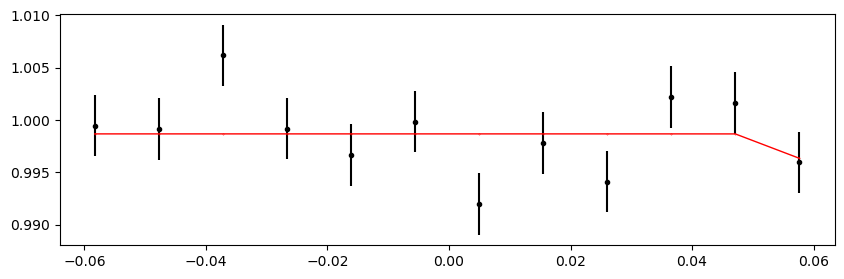

Time 2653.61046906 does not have enough data points: 10
2654.26939392 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.31it/s]


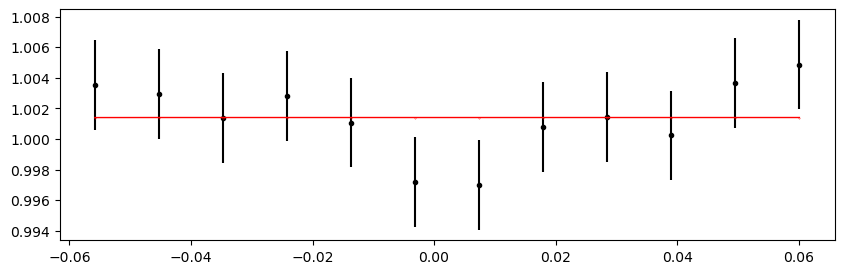

2654.92831878 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.99it/s]


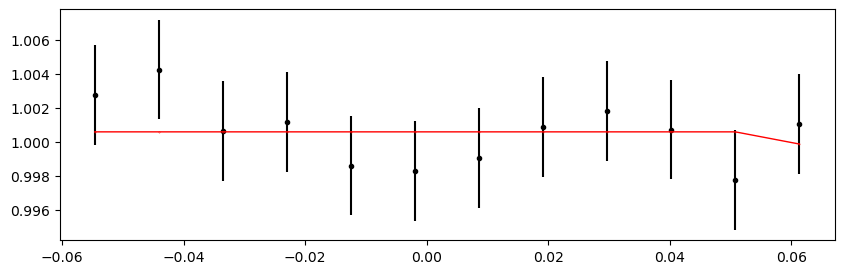

2655.58724364 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.79it/s]


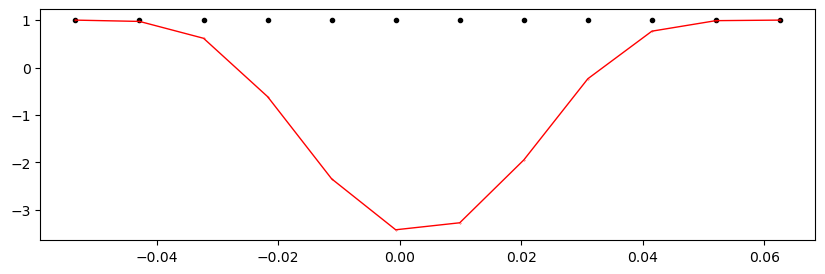

2656.2461685 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.36it/s]


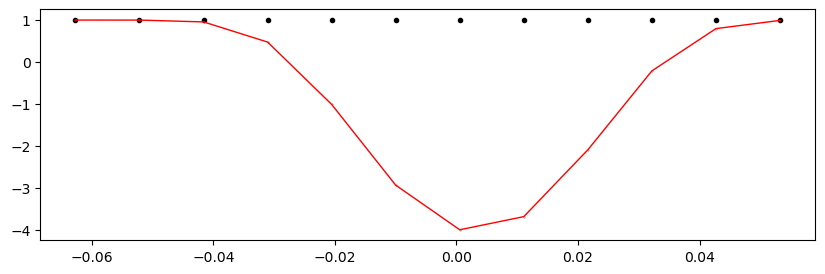

2656.90509336 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.33it/s]


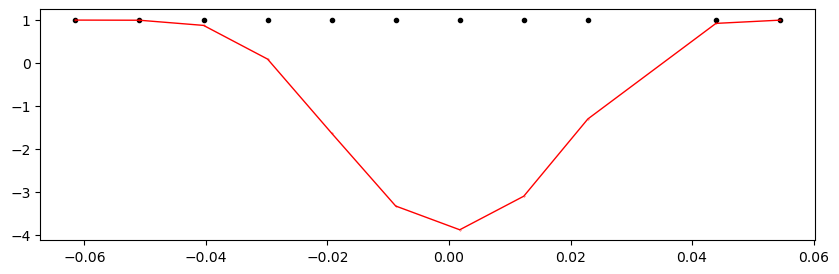

2657.56401822 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.18it/s]


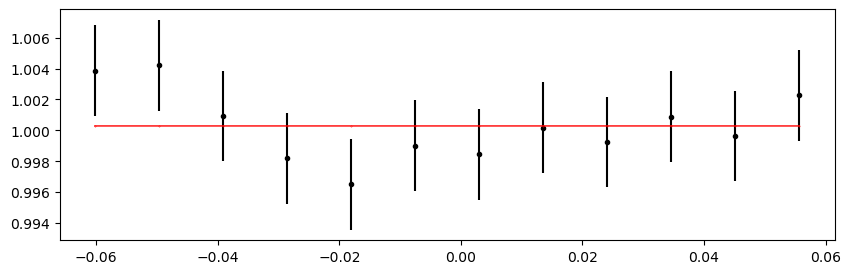

2658.22294308 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.90it/s]


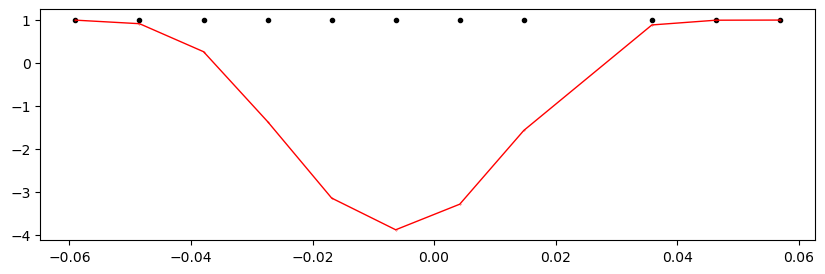

2658.88186794 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.84it/s]


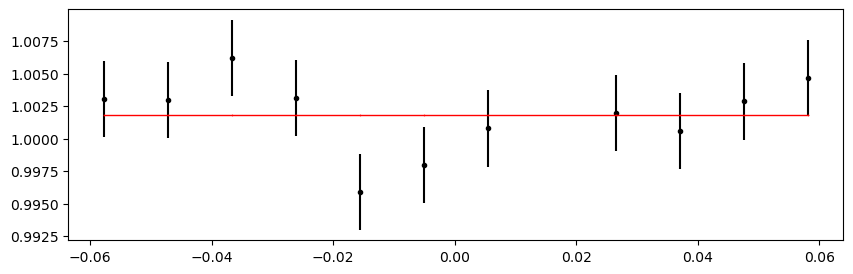

2659.5407928 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.61it/s]


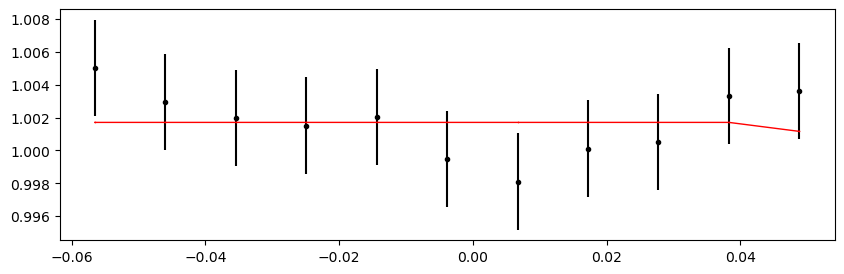

2660.19971766 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.76it/s]


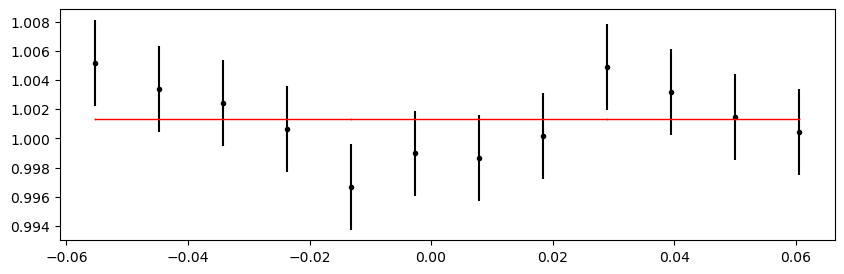

2660.85864252 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.53it/s]


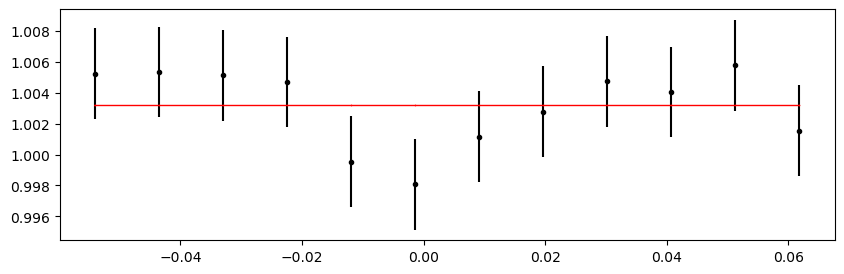

2661.51756738 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.41it/s]


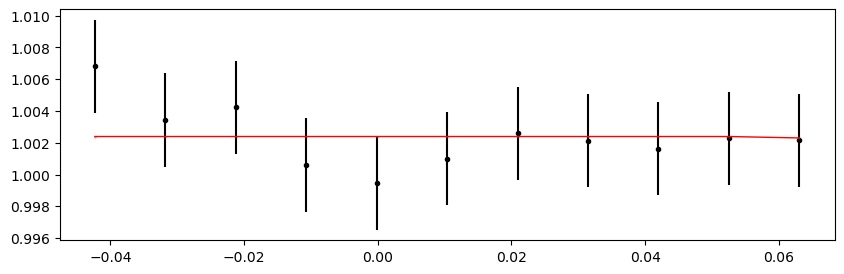

2662.17649224 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.48it/s]


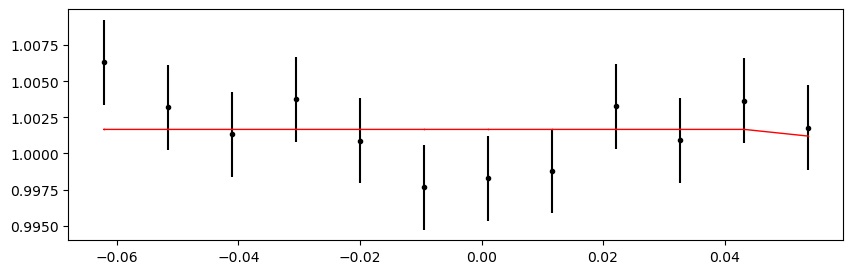

2662.8354171 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.30it/s]


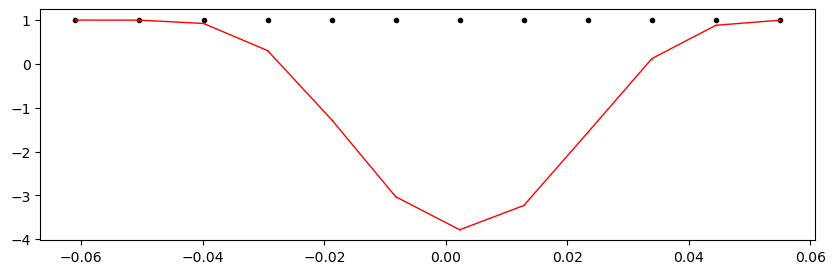

2663.49434196 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.63it/s]


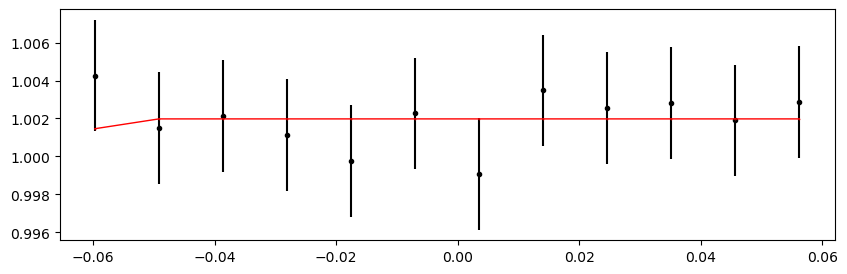

2664.1532668199998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.16it/s]


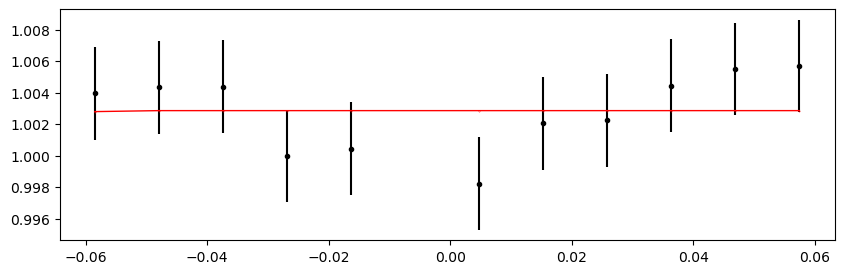

2665.47111654 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.87it/s]


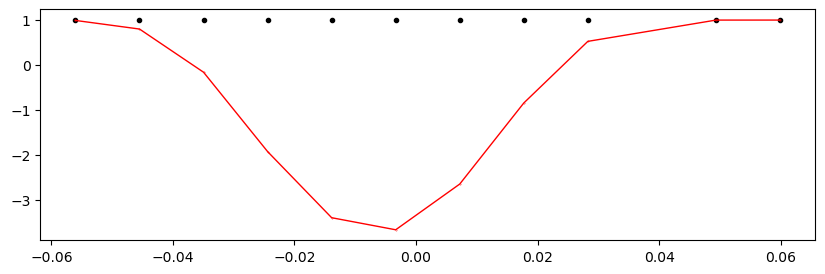

2666.1300413999998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.70it/s]


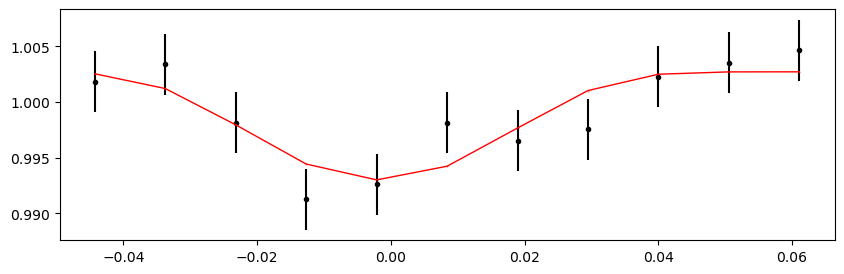

2666.78896626 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.35it/s]


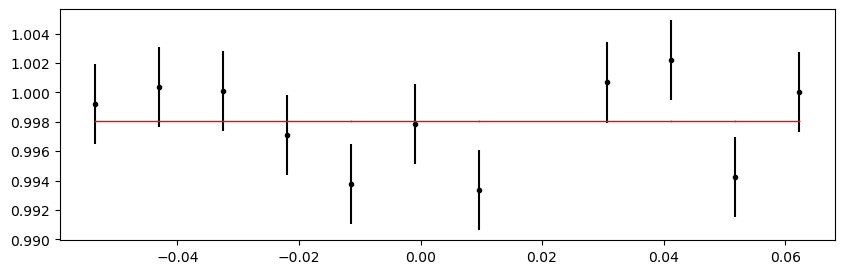

2667.44789112 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.39it/s]


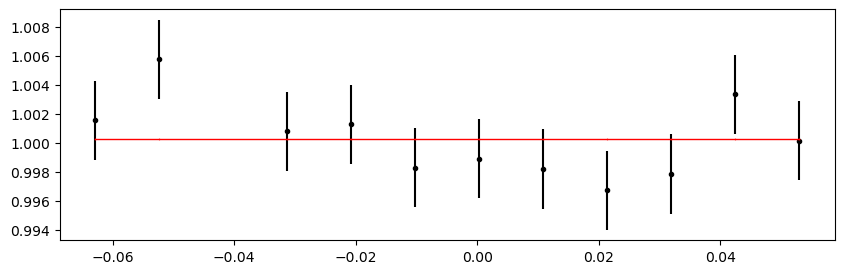

Time 2668.1068159799997 does not have enough data points: 9
2668.76574084 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.42it/s]


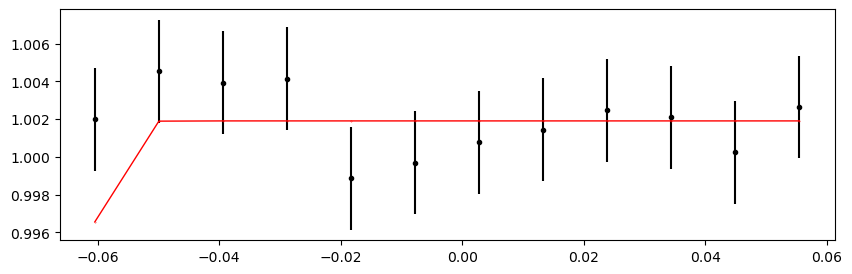

Time 2669.4246657 does not have enough data points: 10
2670.0835905599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.43it/s]


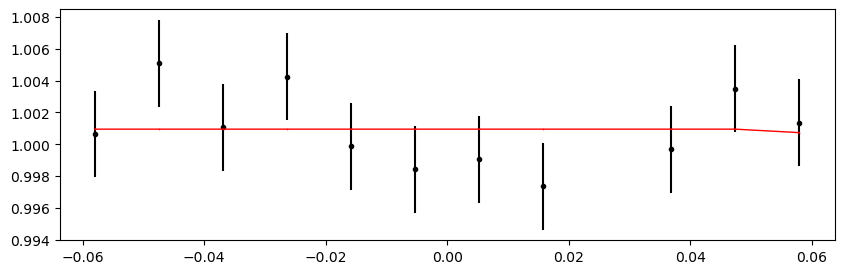

2670.74251542 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.39it/s]


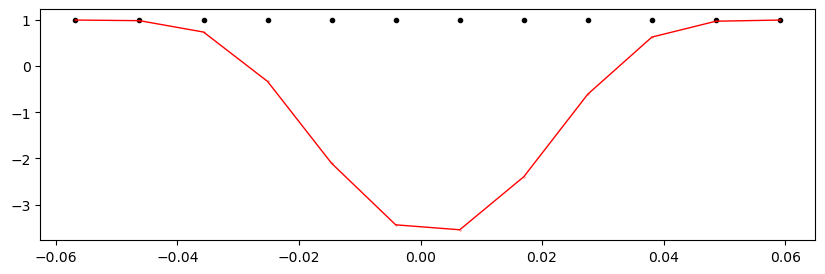

2671.40144028 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.97it/s]


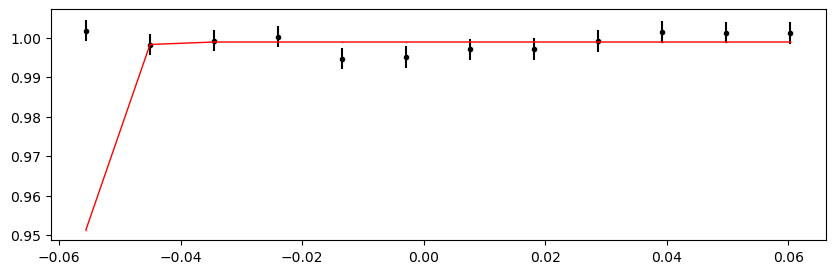

2672.0603651399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.21it/s]


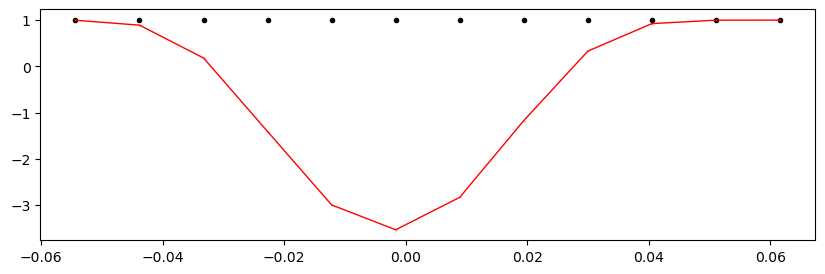

Time 2672.71929 does not have enough data points: 10
Time 2673.37821486 does not have enough data points: 10
2674.0371397199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.72it/s]


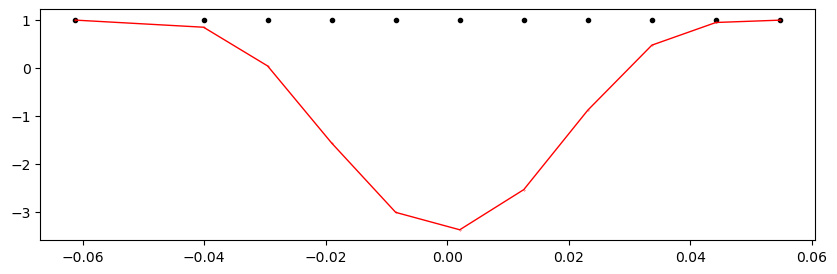

2674.69606458 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.94it/s]


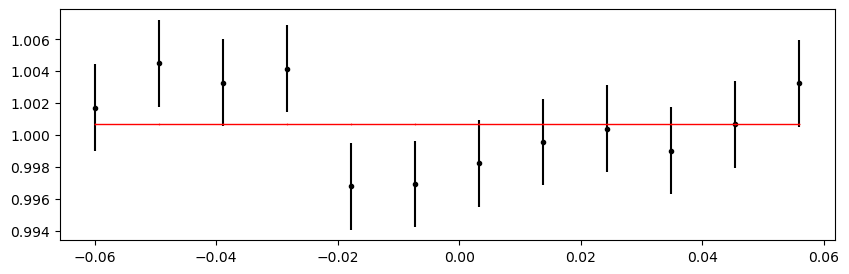

2675.35498944 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.93it/s]


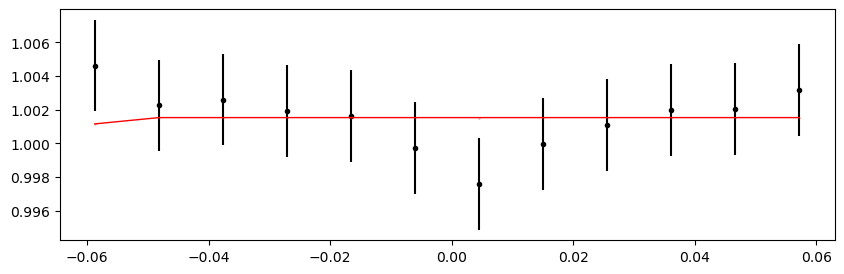

2676.0139143 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.88it/s]


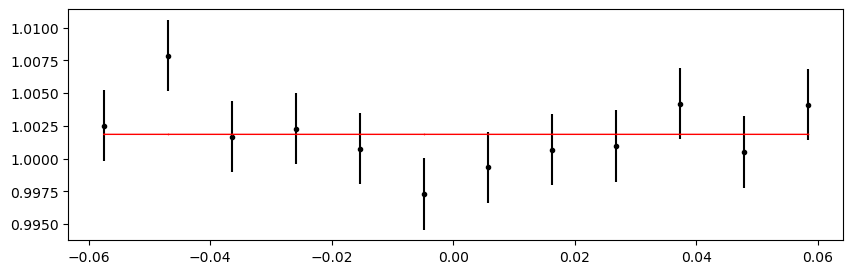

Time 2676.67283916 does not have enough data points: 10
2677.33176402 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.39it/s]


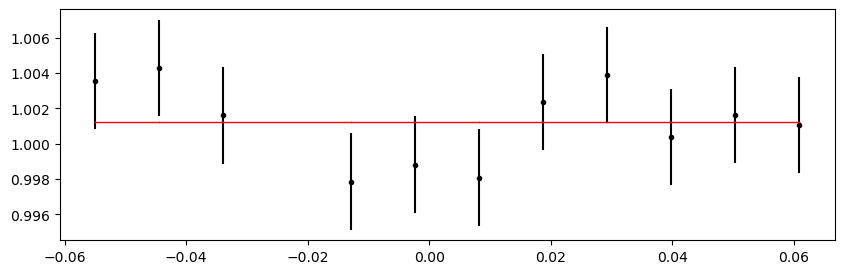

Time 2677.99068888 does not have enough data points: 10
Time 2679.3085386 does not have enough data points: 5
2679.96746346 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.66it/s]


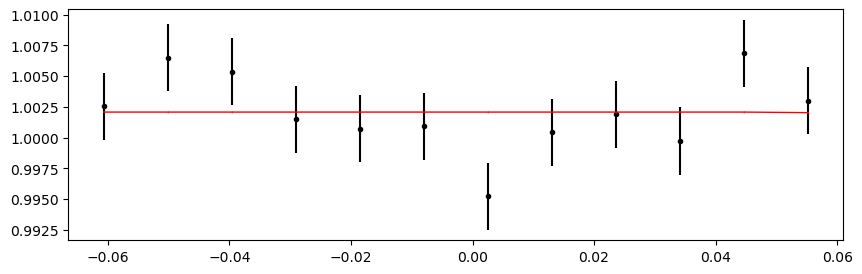

2680.62638832 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.78it/s]


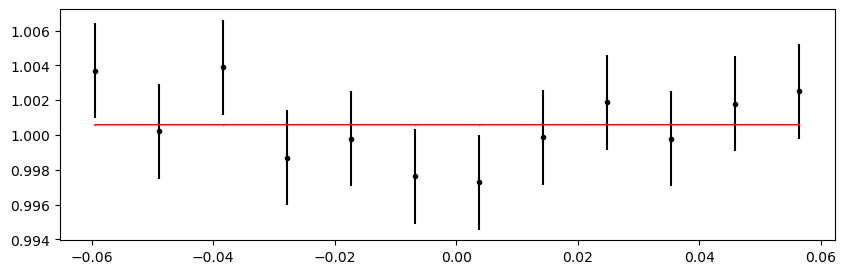

2681.2853131800002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.10it/s]


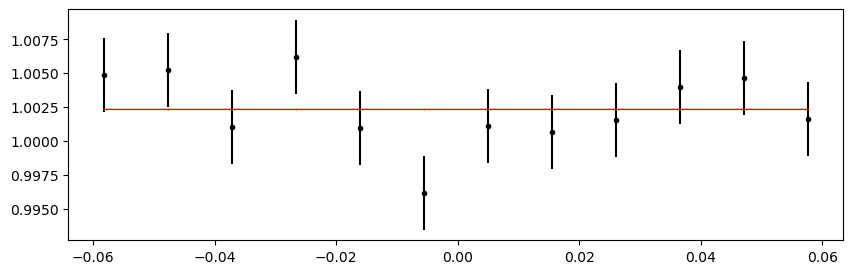

2681.94423804 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.06it/s]


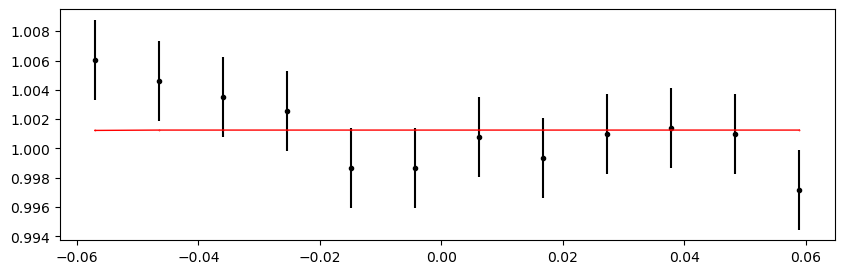

2682.6031629 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.87it/s]


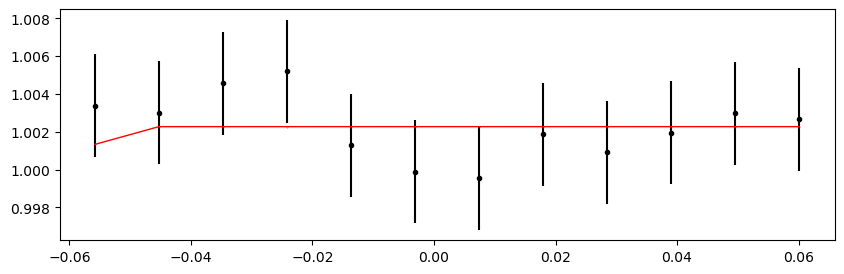

2683.26208776 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.36it/s]


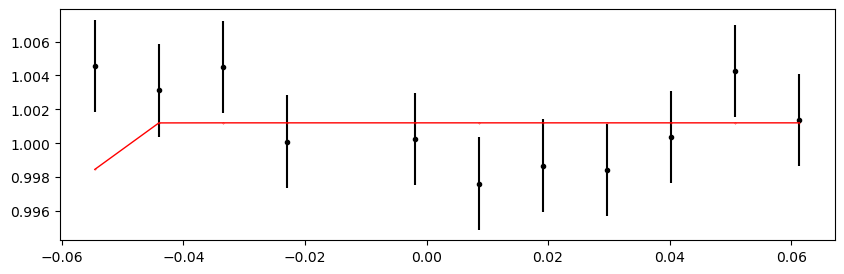

2683.92101262 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.39it/s]


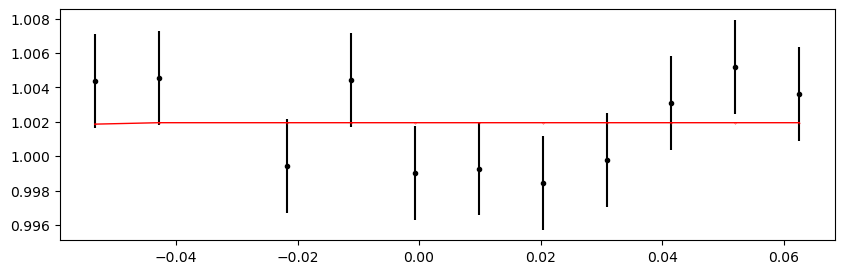

2684.57993748 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.87it/s]


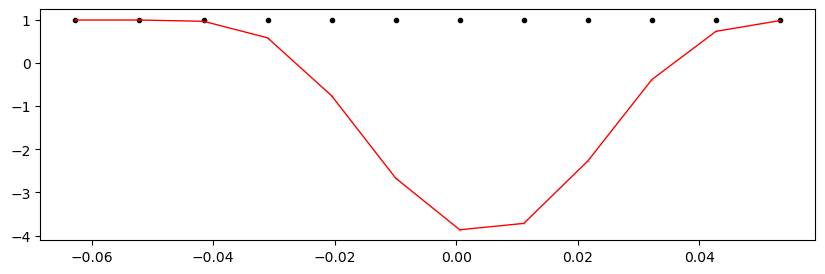

2685.23886234 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.42it/s]


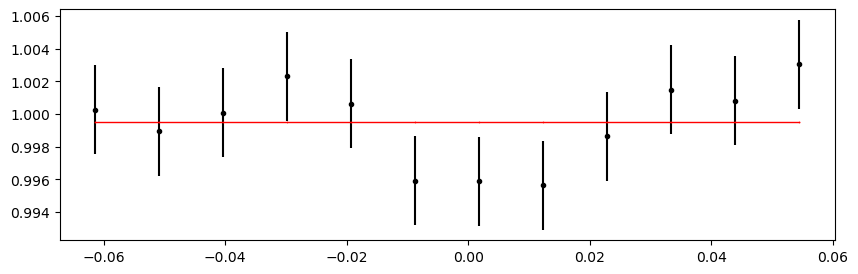

2685.8977872 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.87it/s]


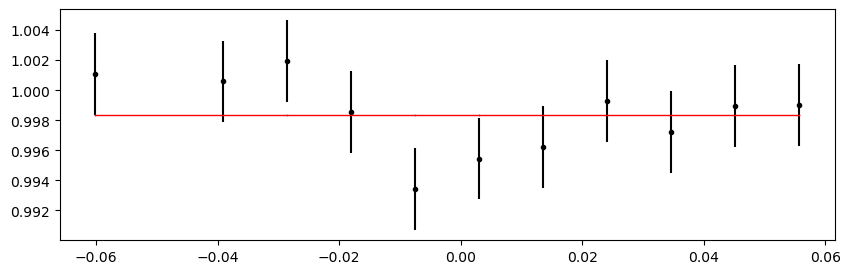

2686.55671206 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.00it/s]


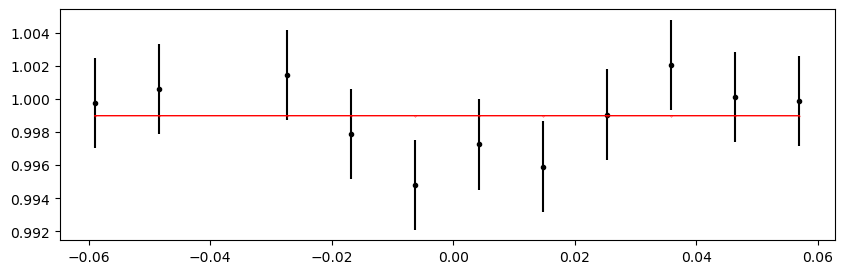

2687.21563692 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.60it/s]


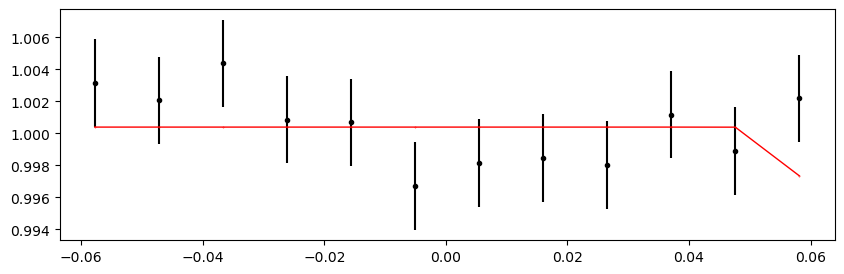

2687.87456178 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.29it/s]


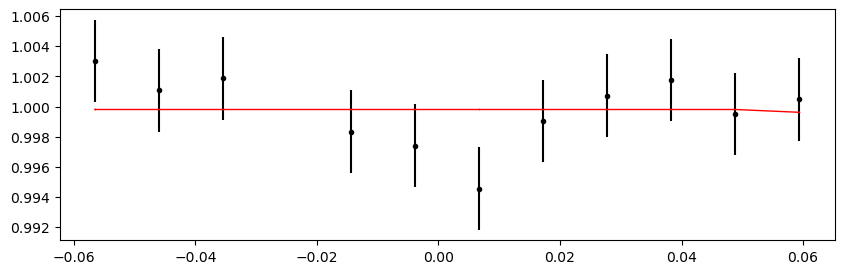

Time 2688.53348664 does not have enough data points: 10
Time 2689.1924115 does not have enough data points: 10
2689.85133636 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.39it/s]


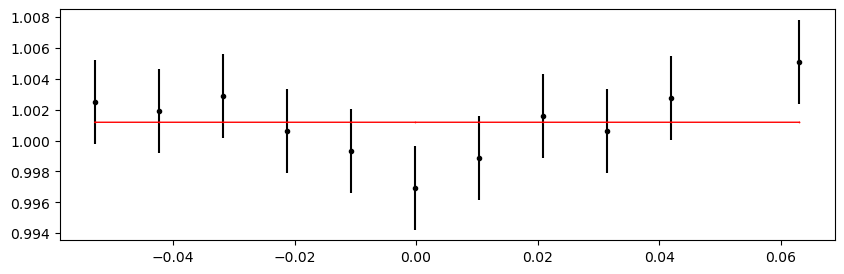

2690.51026122 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.53it/s]


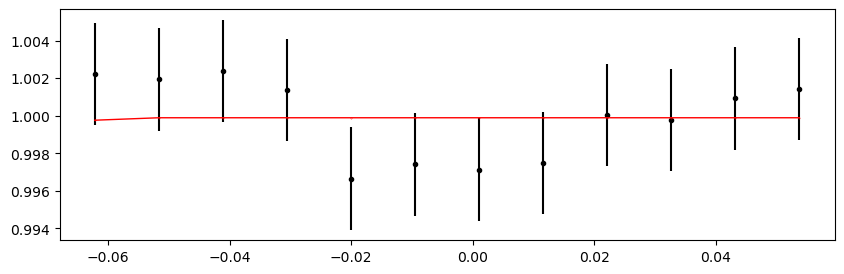

2691.16918608 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.86it/s]


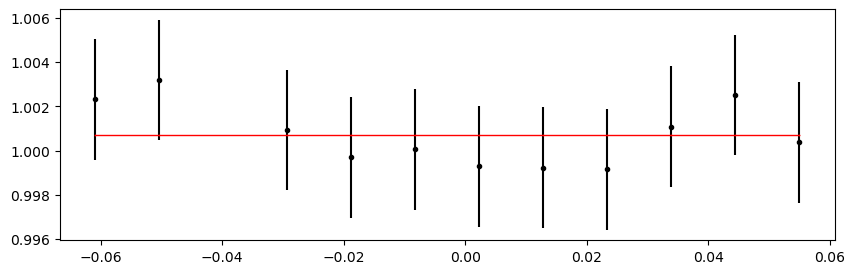

2693.14596066 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 443.20it/s]


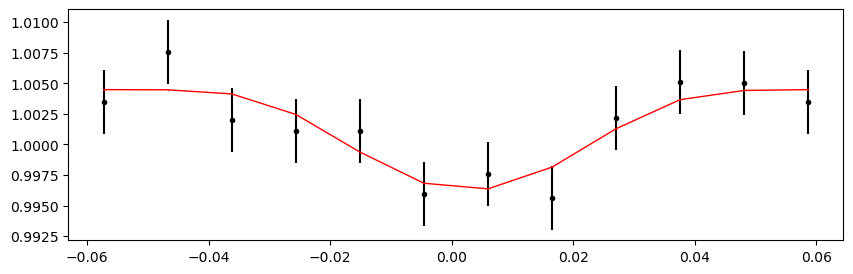

2693.80488552 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.24it/s]


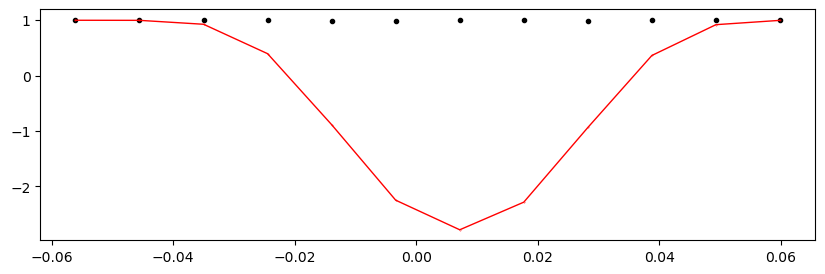

2694.46381038 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.45it/s]


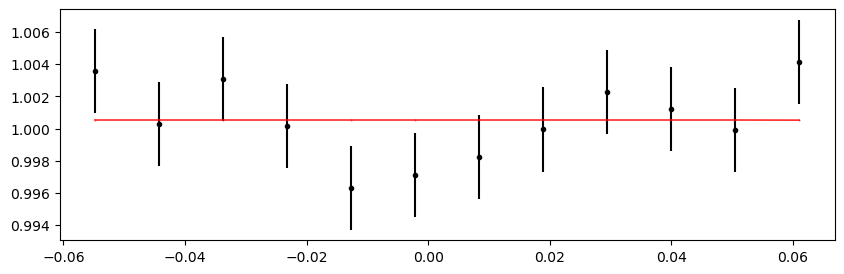

2695.12273524 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 557.31it/s]


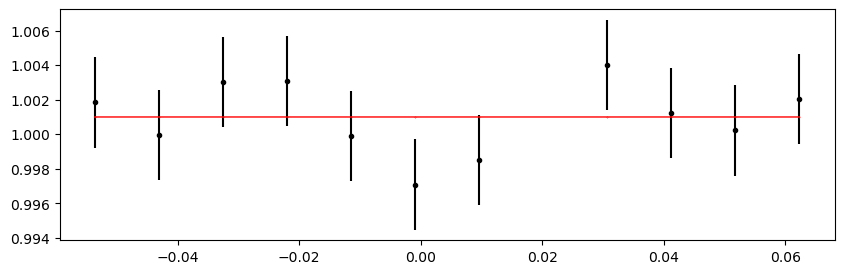

2695.7816601 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 558.75it/s]


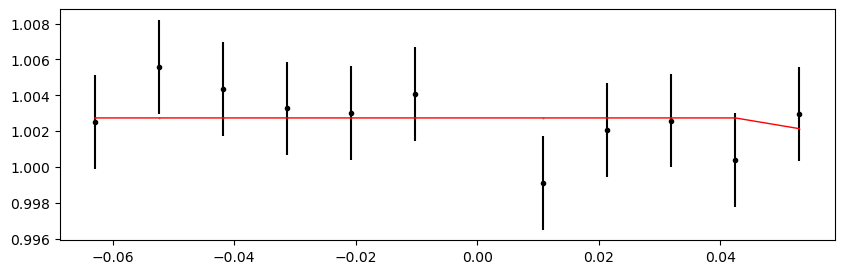

2696.44058496 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.97it/s]


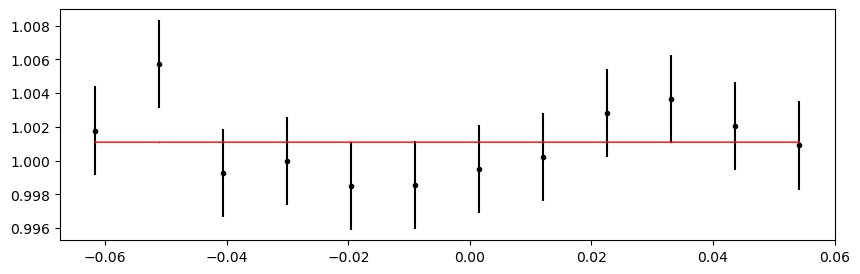

2697.09950982 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.78it/s]


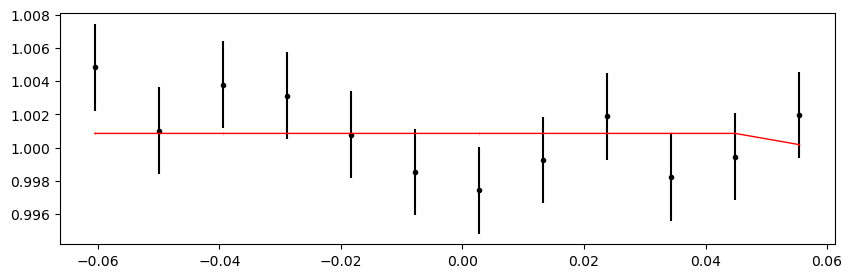

2697.75843468 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.61it/s]


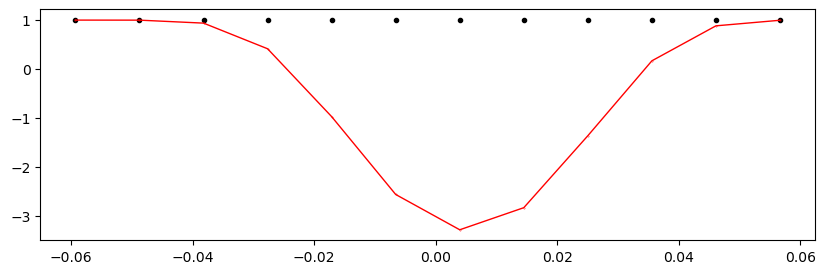

2698.41735954 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.49it/s]


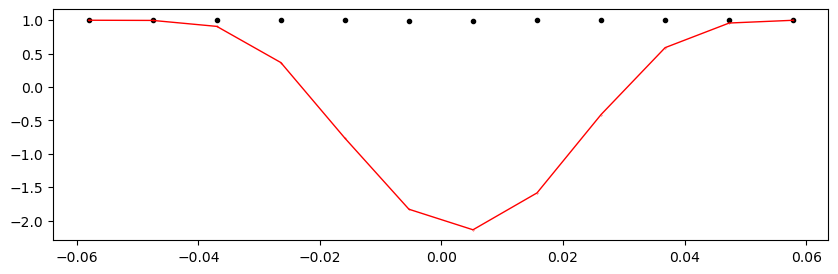

2699.0762844 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.17it/s]


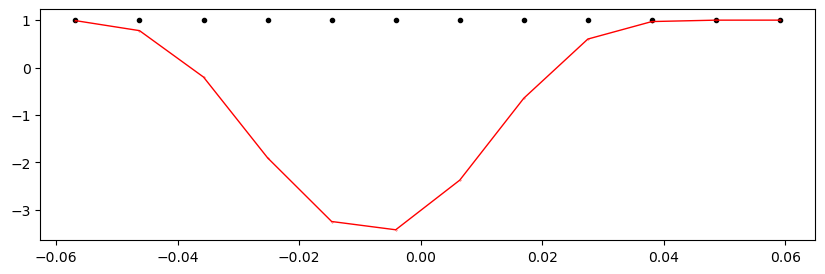

2699.73520926 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.90it/s]


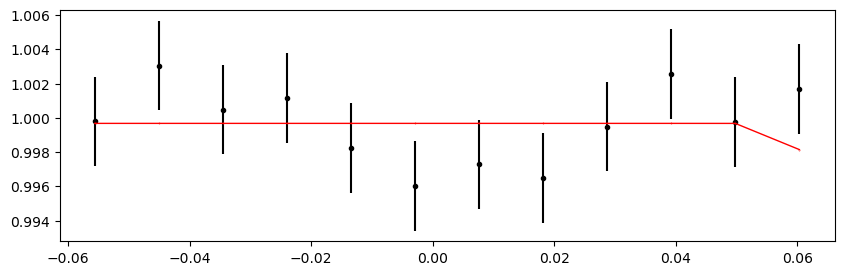

2700.3941341199998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.01it/s]


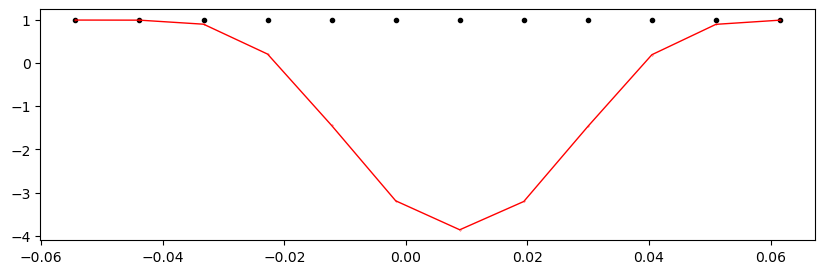

2701.05305898 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.49it/s]


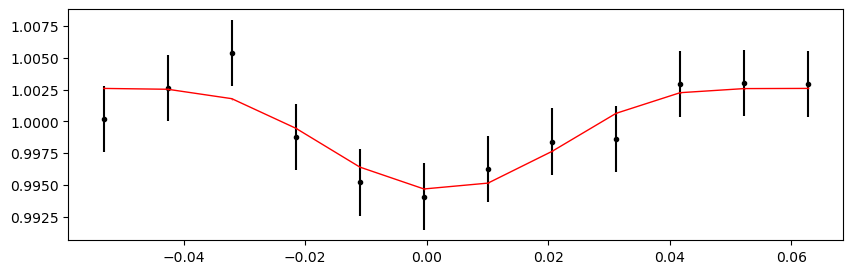

2701.71198384 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 452.47it/s]


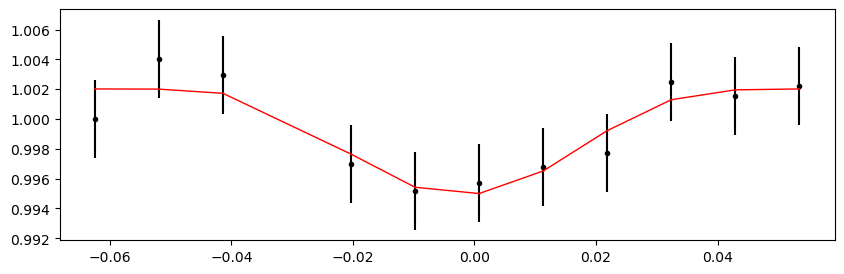

2702.3709086999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.43it/s]


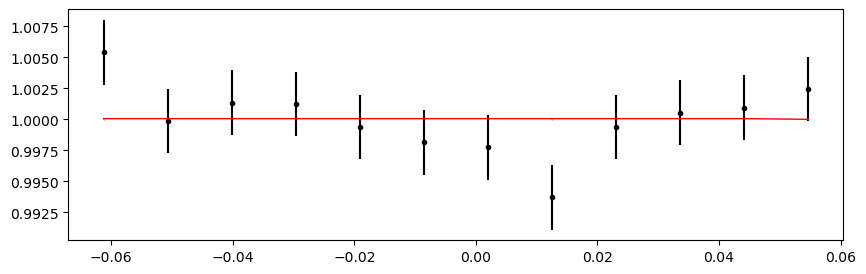

2703.02983356 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 557.27it/s]


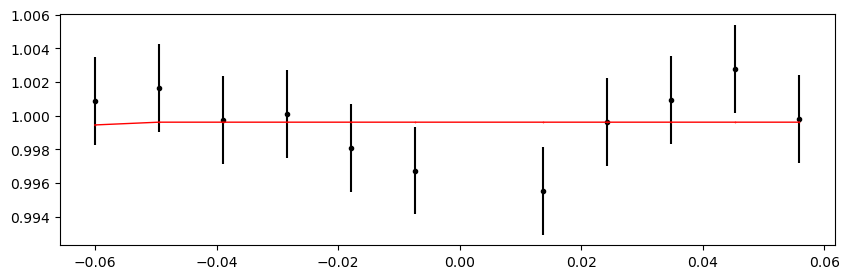

2703.68875842 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.00it/s]


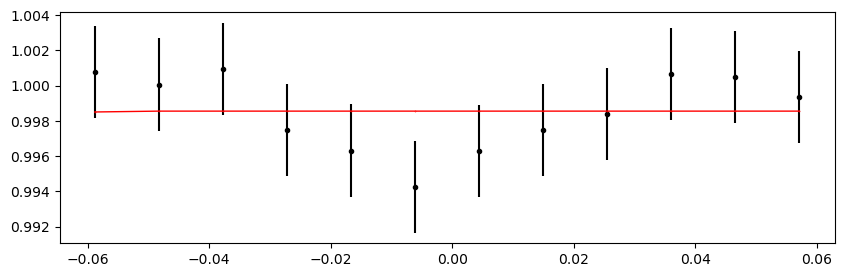

2704.3476832799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 450.20it/s]


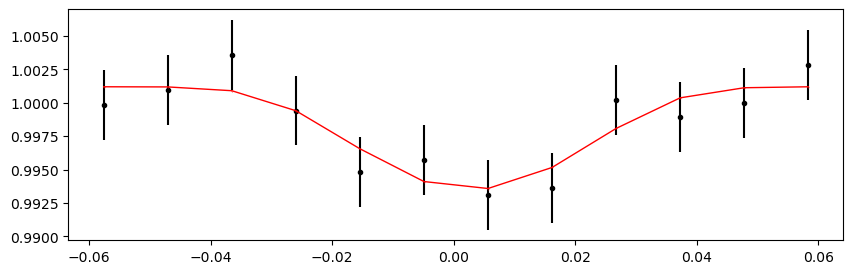

Time 2705.665533 does not have enough data points: 4
2706.3244578599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.70it/s]


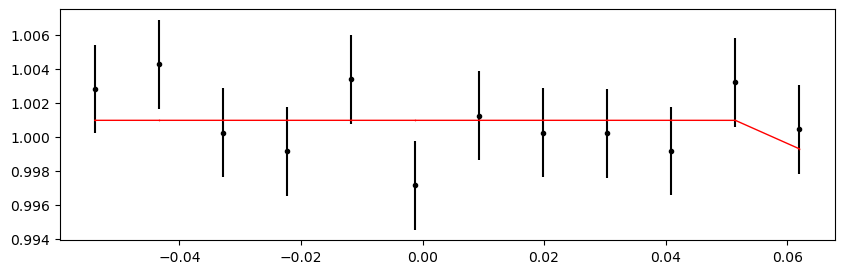

2706.98338272 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.08it/s]


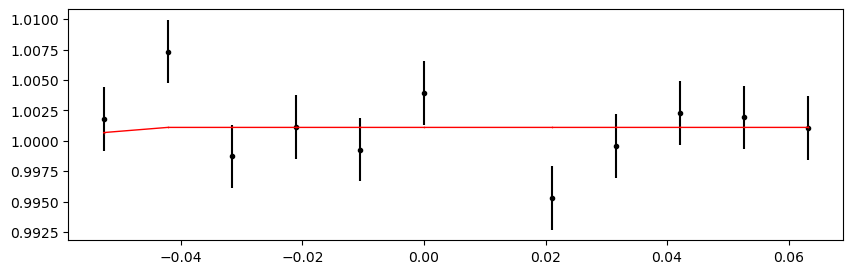

2707.64230758 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.96it/s]


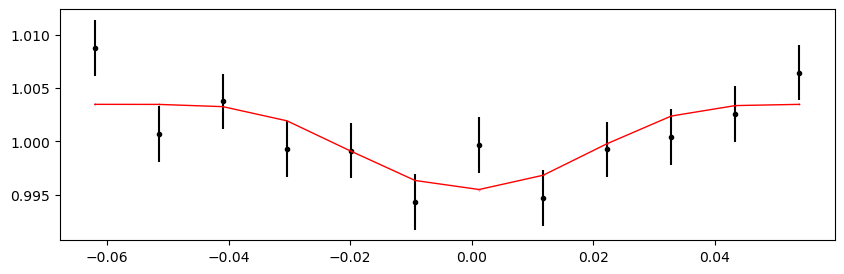

2708.3012324399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.86it/s]


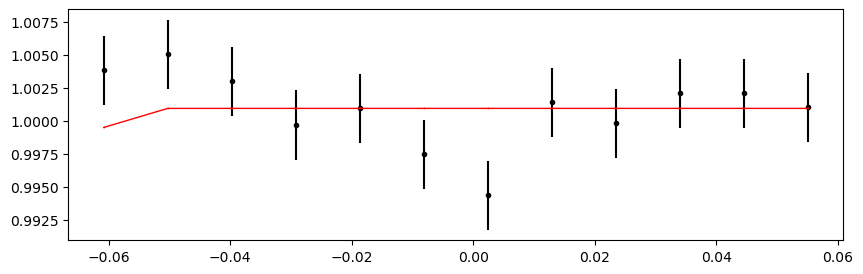

Time 2708.9601573 does not have enough data points: 10
2709.6190821600003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.83it/s]


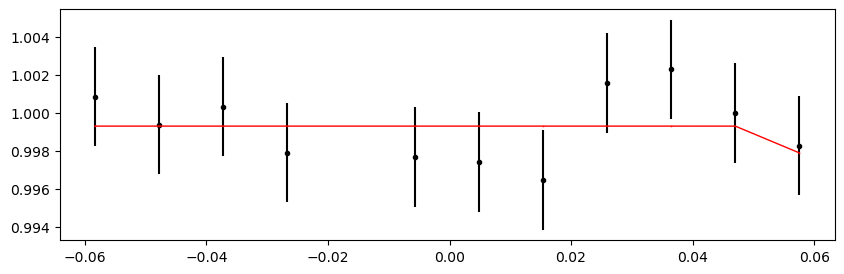

2710.2780070199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.97it/s]


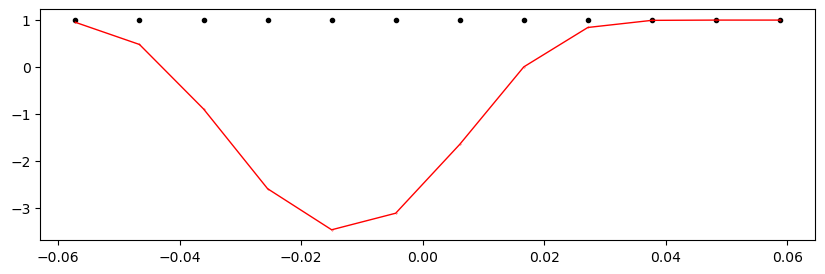

2710.93693188 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.29it/s]


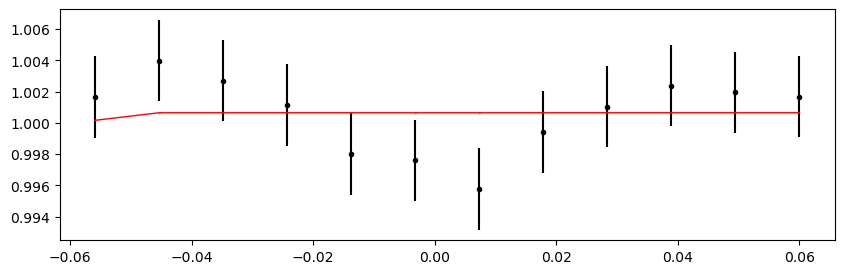

Time 2711.5958567400003 does not have enough data points: 10
2712.2547815999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.42it/s]


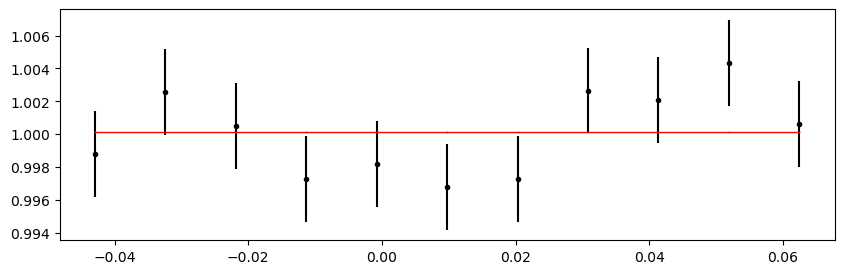

2712.91370646 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.86it/s]


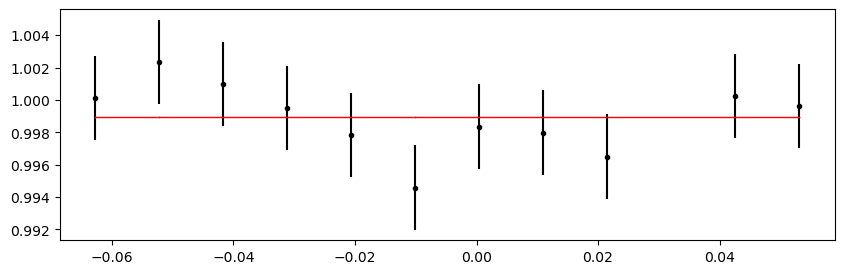

2713.5726313200003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.29it/s]


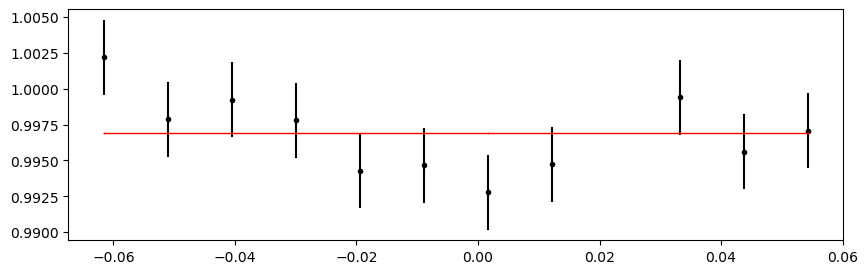

Time 2714.2315561799996 does not have enough data points: 10
2714.89048104 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.03it/s]


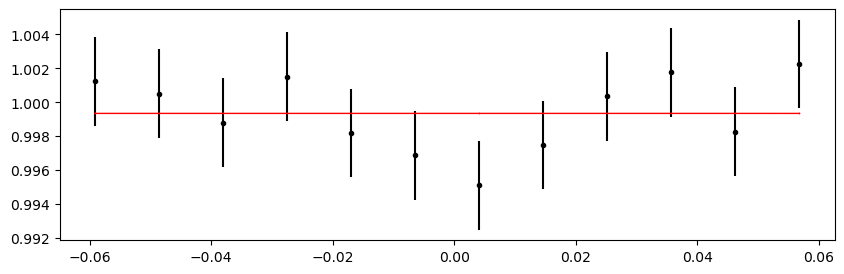

2715.5494059000002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 558.37it/s]


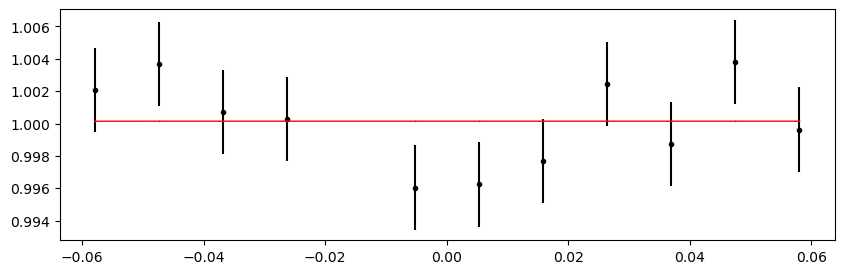

Time 2716.2083307599996 does not have enough data points: 10
Time 2716.86725562 does not have enough data points: 10
Time 2717.52618048 does not have enough data points: 7
2744.5420997399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.01it/s]


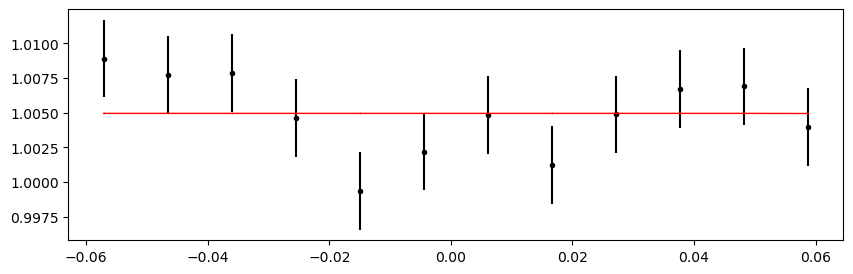

2745.2010246 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.39it/s]


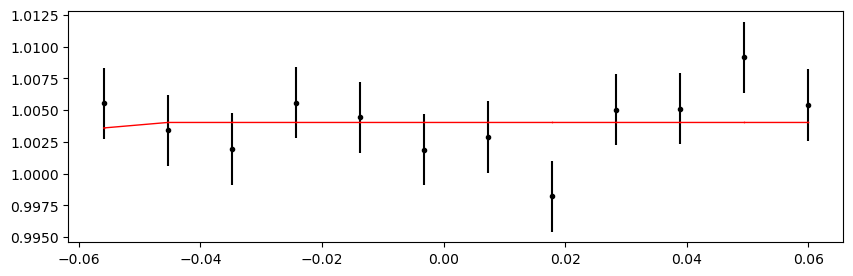

2745.8599494600003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.36it/s]


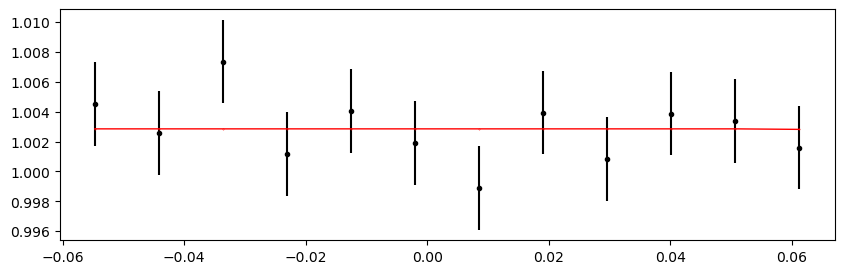

2746.5188743199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.98it/s]


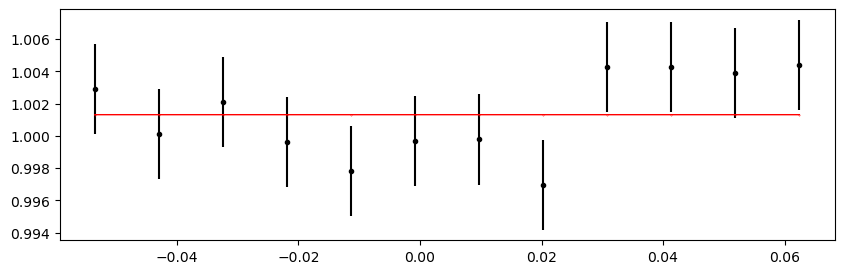

2747.17779918 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.56it/s]


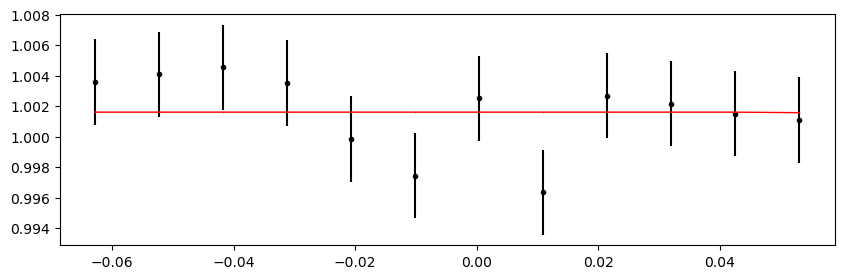

2747.8367240400003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.68it/s]


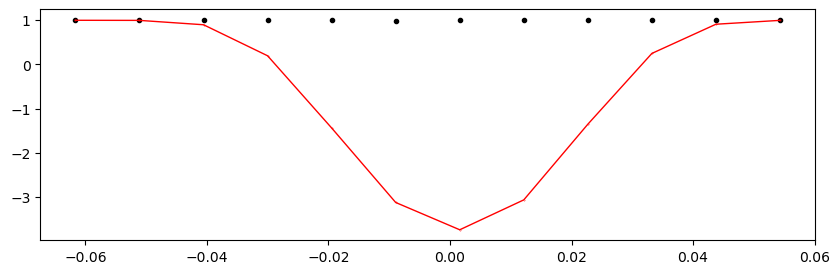

2748.4956488999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.40it/s]


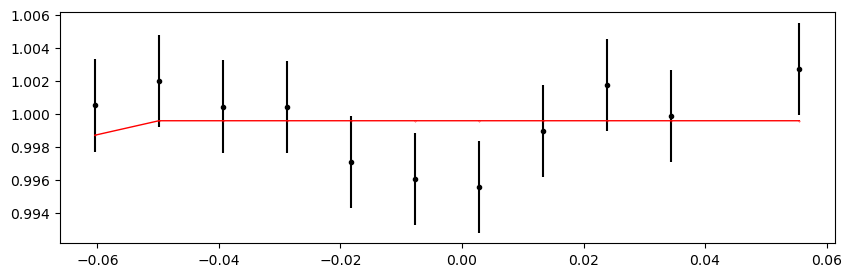

2749.15457376 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.14it/s]


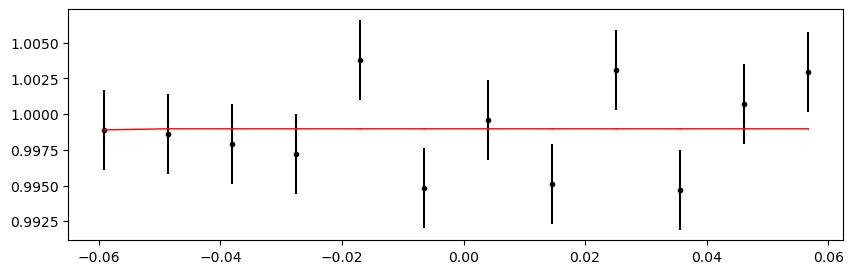

2749.8134986200002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.33it/s]


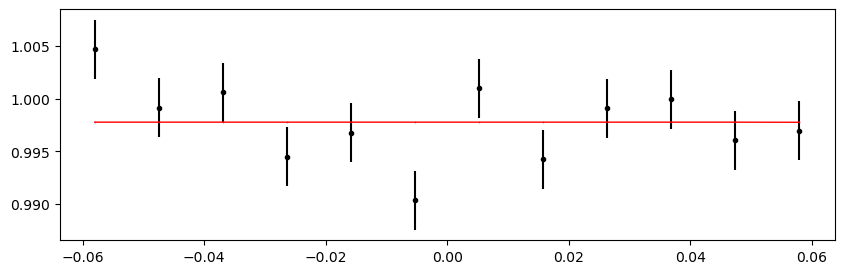

2750.4724234799996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.64it/s]


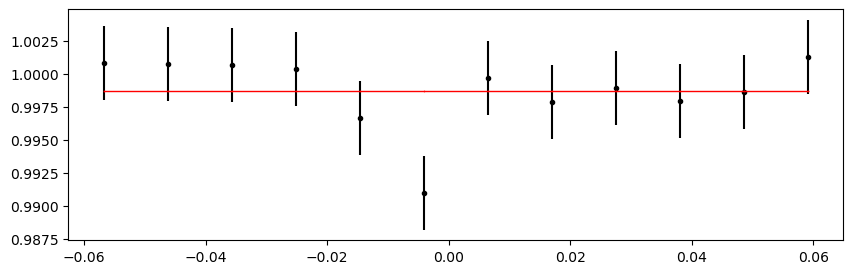

2751.13134834 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.37it/s]


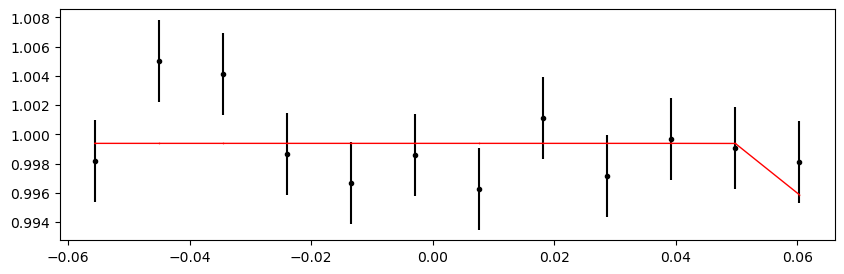

2751.7902732000002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.19it/s]


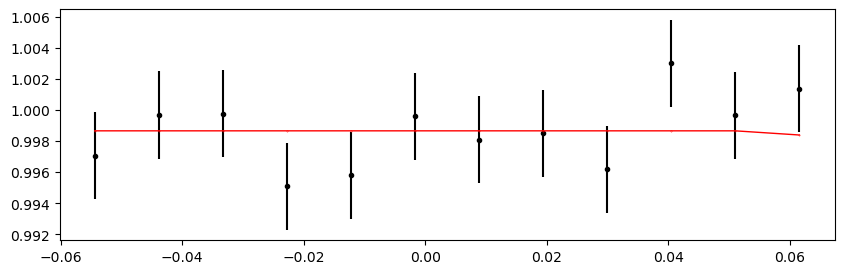

2752.4491980599996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.43it/s]


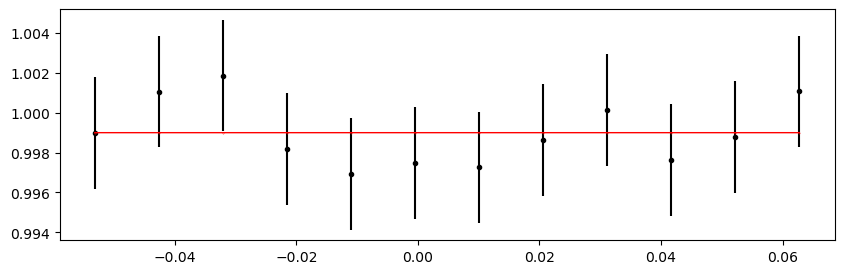

2753.10812292 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.72it/s]


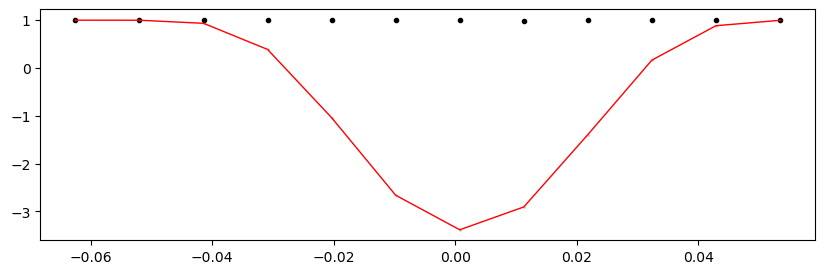

2753.76704778 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.34it/s]


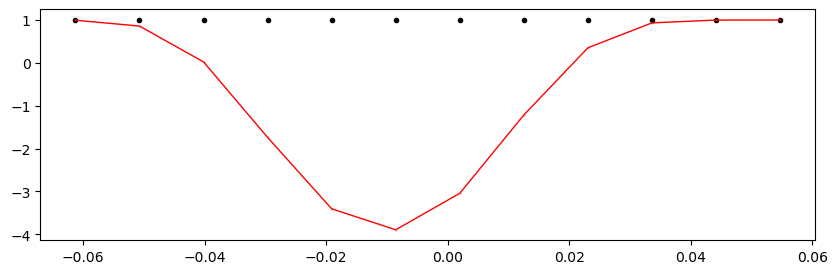

2754.42597264 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.53it/s]


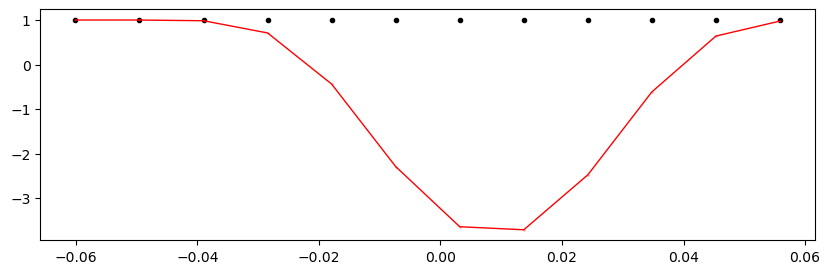

2755.0848975 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.21it/s]


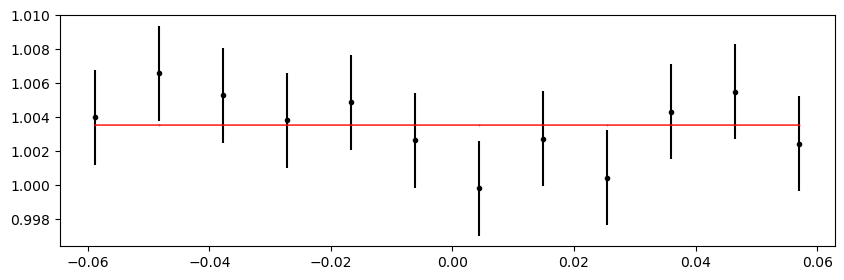

2755.74382236 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.78it/s]


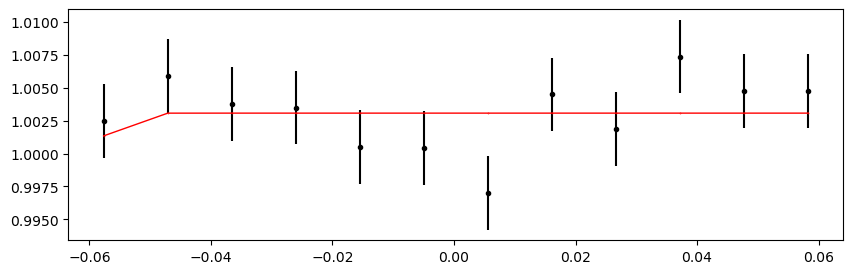

2757.06167208 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.87it/s]


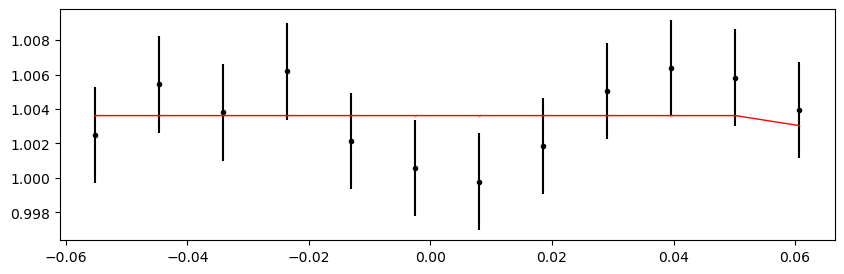

2757.72059694 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.80it/s]


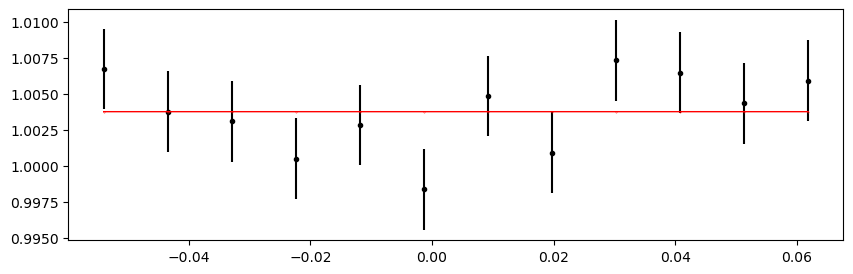

2758.3795218 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.78it/s]


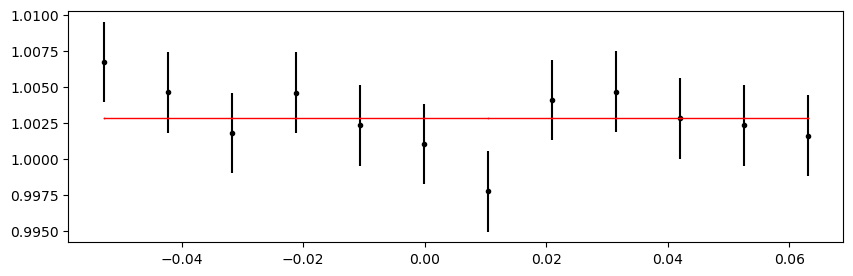

2759.03844666 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.54it/s]


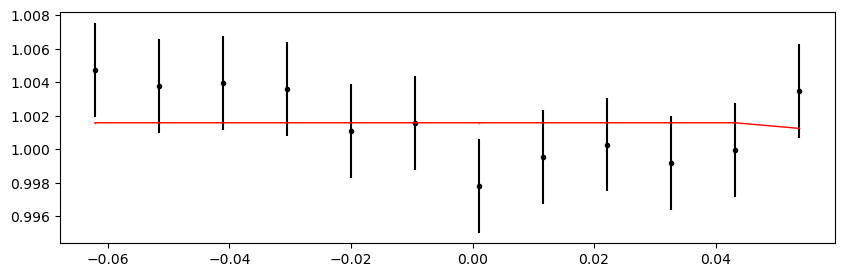

2759.69737152 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.59it/s]


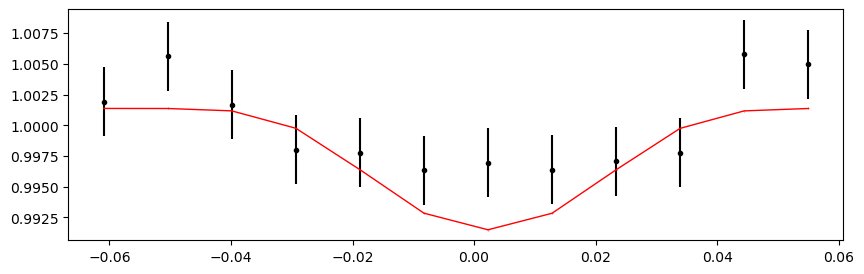

2760.35629638 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.97it/s]


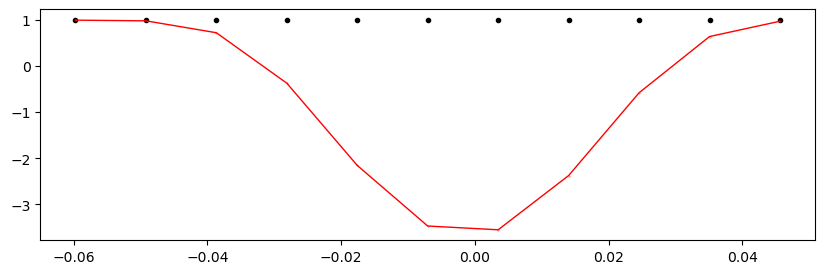

2761.01522124 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 559.22it/s]


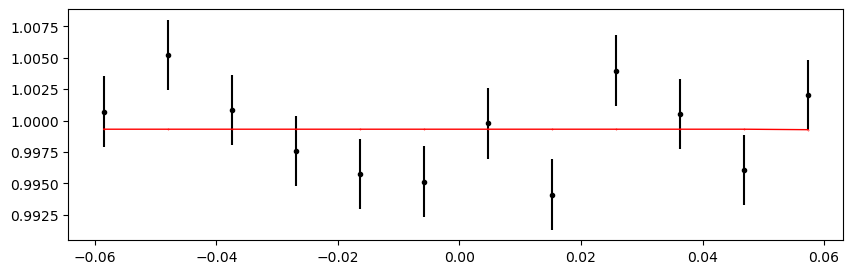

2761.6741461 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 505.12it/s]


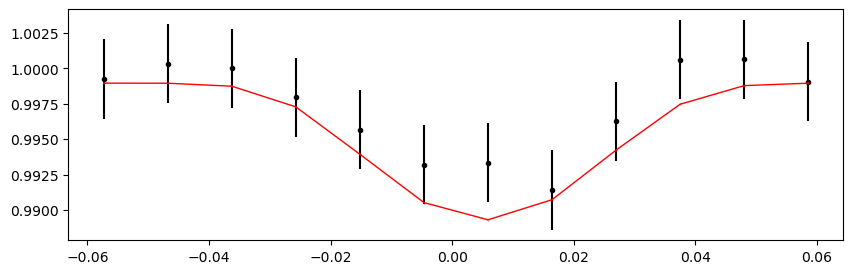

2762.33307096 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.65it/s]


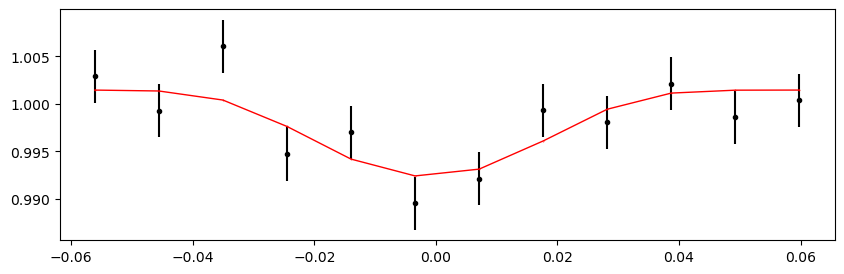

2762.99199582 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.82it/s]


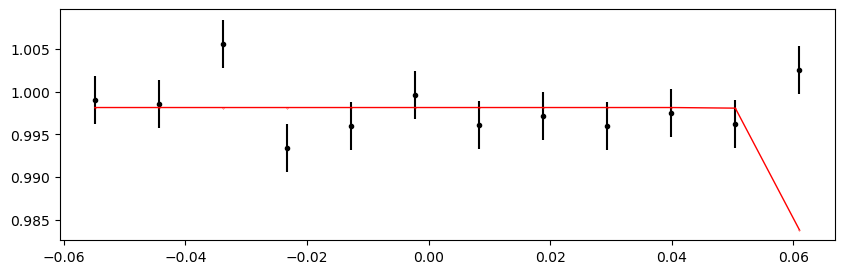

2763.65092068 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.42it/s]


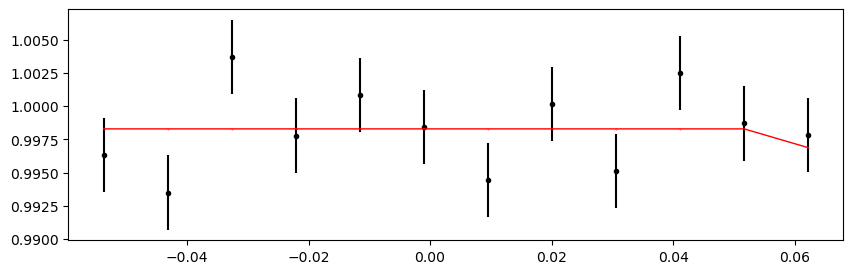

2764.30984554 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.64it/s]


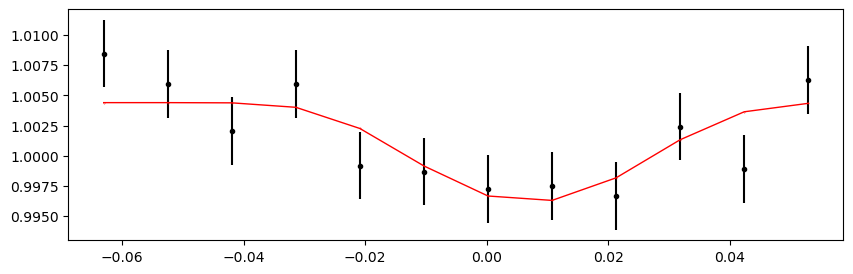

2764.9687704 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 559.61it/s]


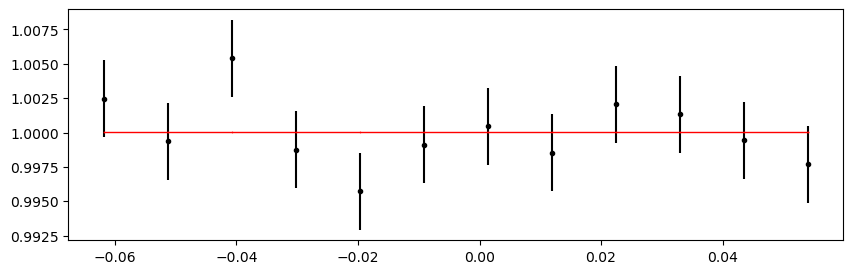

2765.62769526 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 555.07it/s]


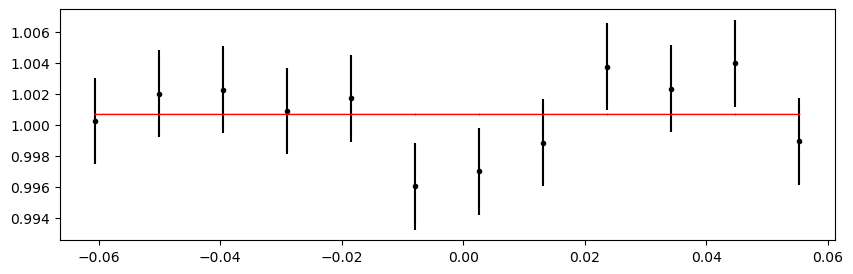

2766.28662012 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.36it/s]


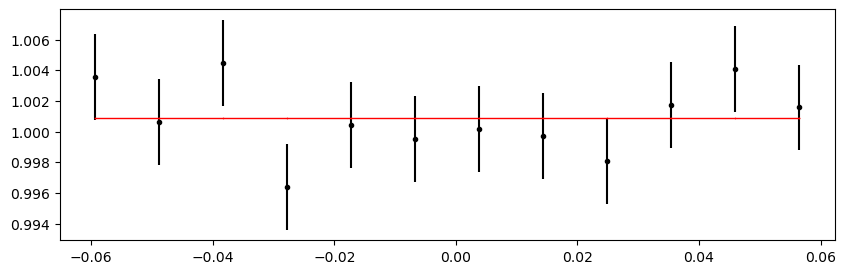

2766.94554498 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.73it/s]


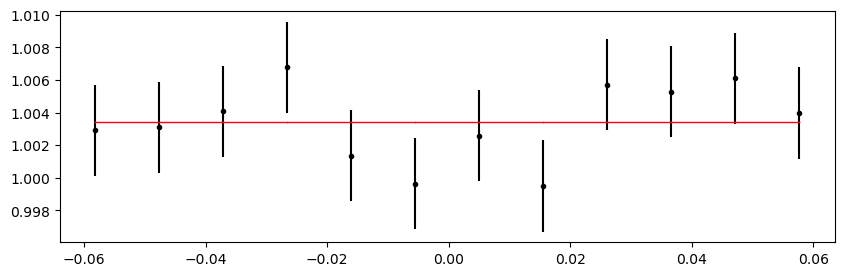

2767.60446984 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.96it/s]


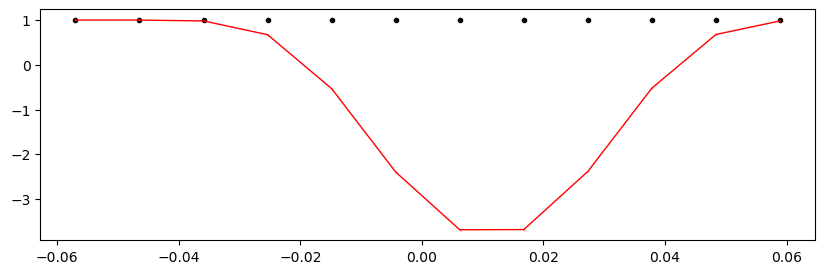

2768.2633947 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.88it/s]


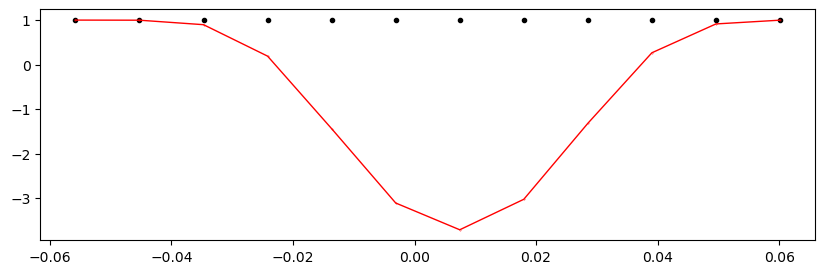

2768.92231956 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 557.68it/s]


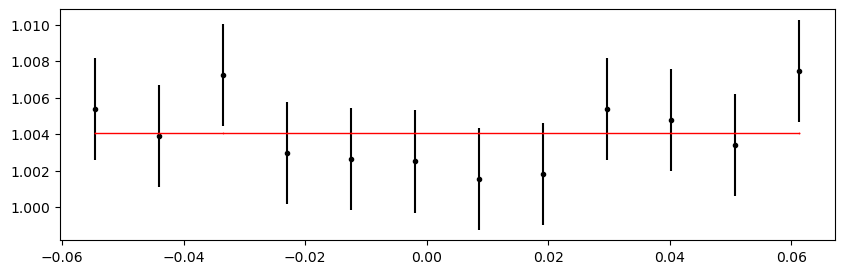

2770.24016928 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.72it/s]


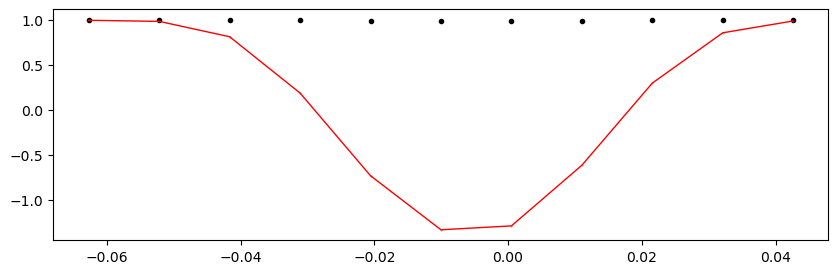

2770.8990941399998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 558.71it/s]


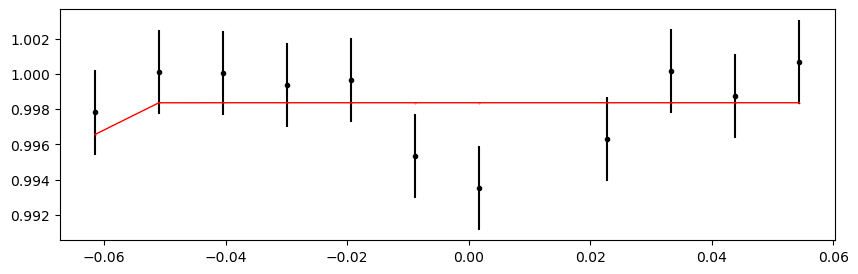

2771.558019 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.98it/s]


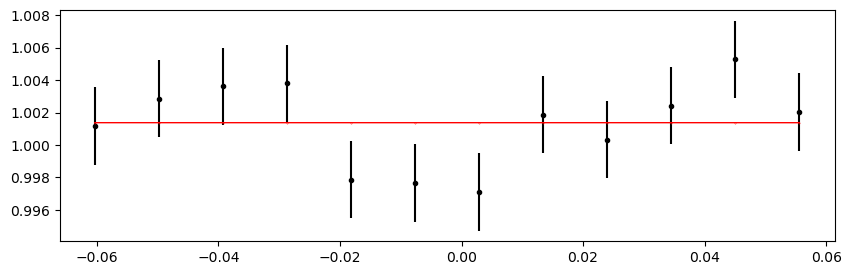

2772.21694386 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.95it/s]


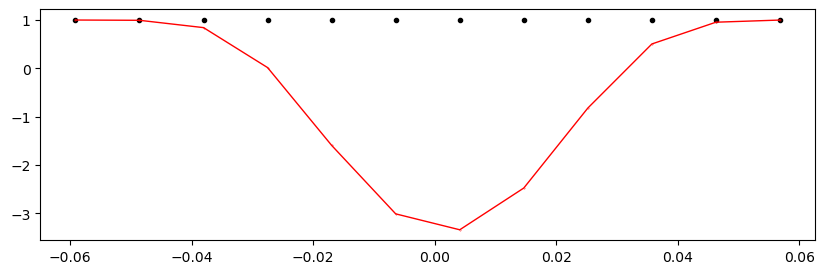

2772.8758687199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.50it/s]


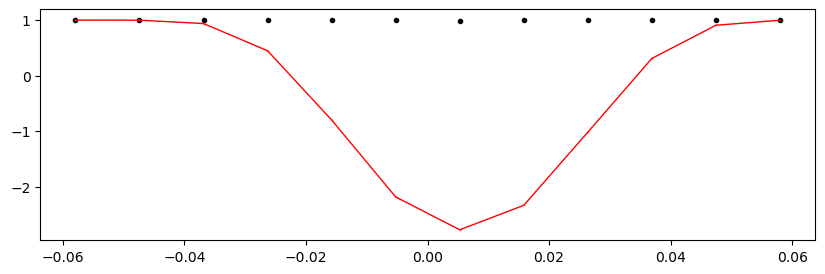

2773.53479358 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 558.19it/s]


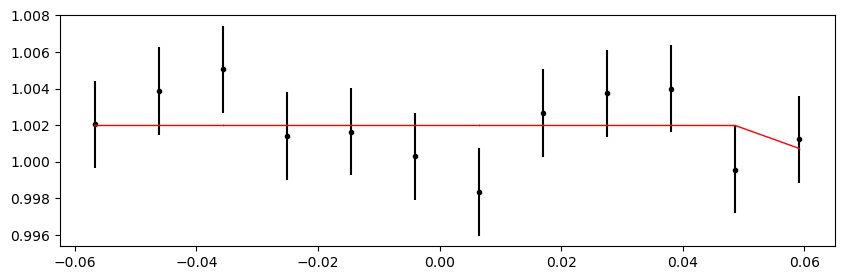

2774.19371844 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 557.77it/s]


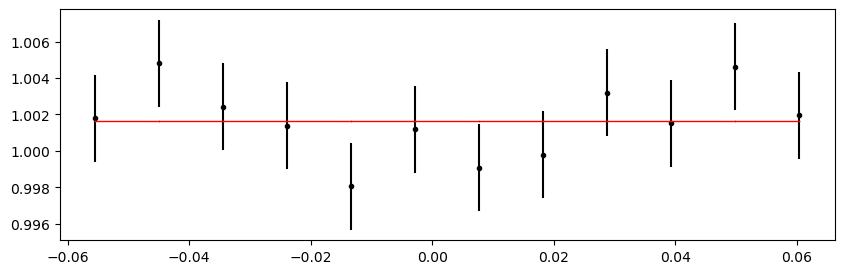

2774.8526432999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.91it/s]


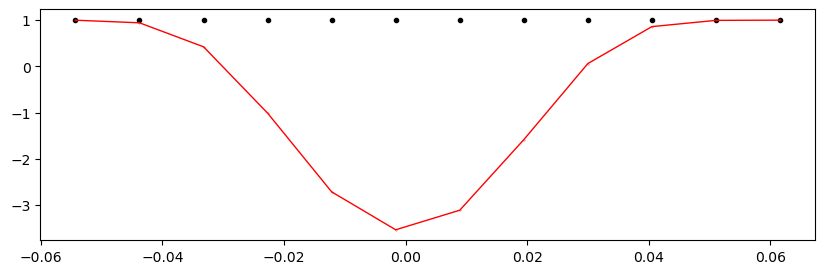

2775.51156816 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.51it/s]


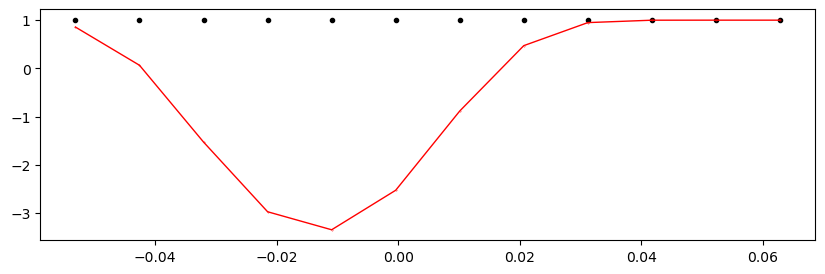

2776.17049302 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.87it/s]


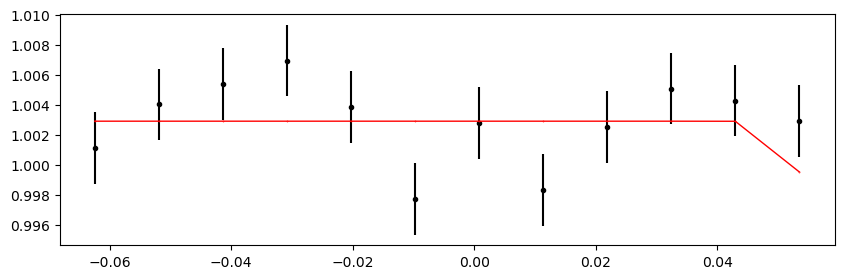

2776.8294178799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 557.32it/s]


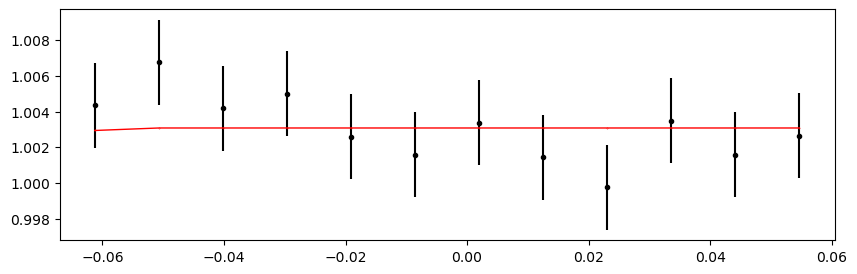

2777.48834274 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.18it/s]


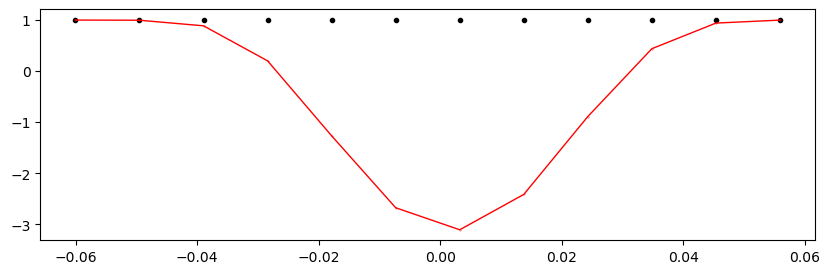

2778.1472676 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.38it/s]


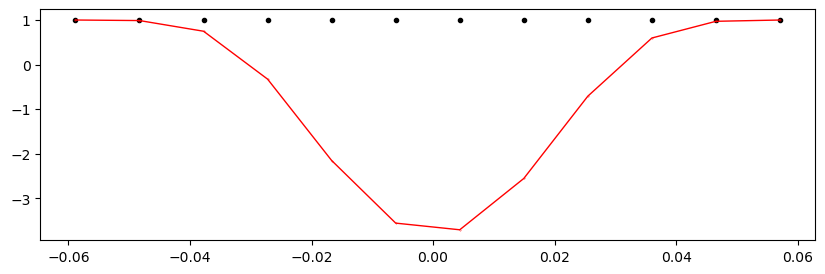

2778.8061924599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.40it/s]


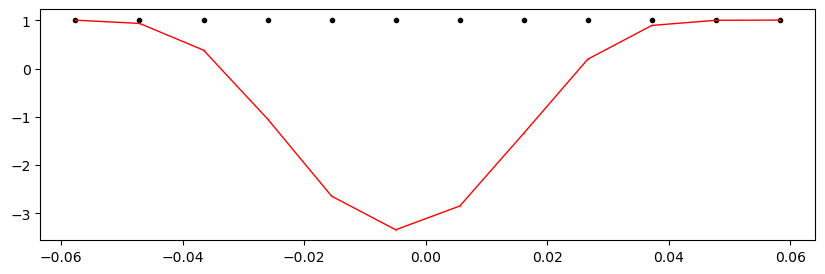

2779.46511732 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 370.85it/s]


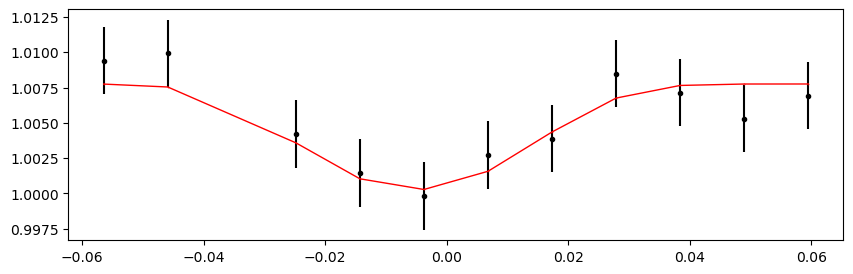

2780.12404218 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 405.08it/s]


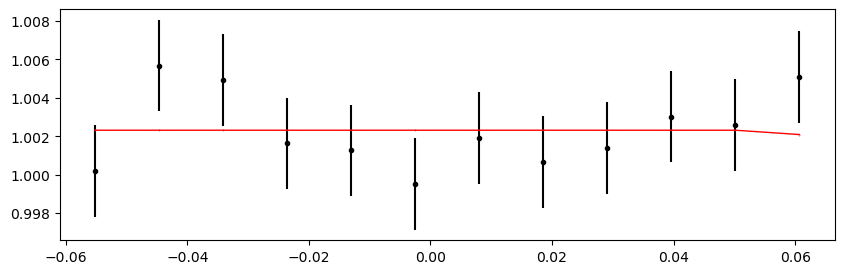

2780.7829670399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.36it/s]


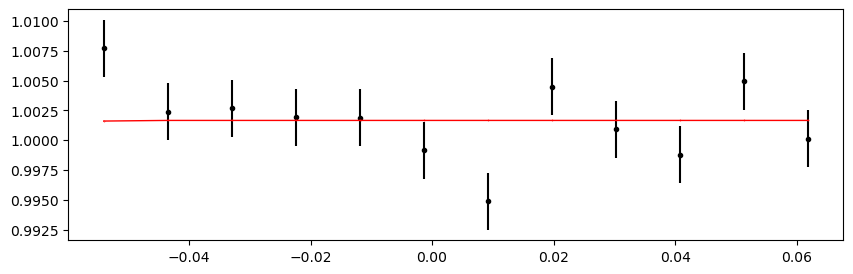

2781.4418919 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 488.20it/s]


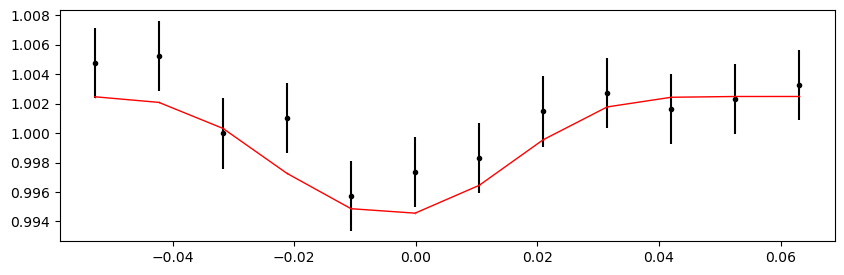

2782.1008167600003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.08it/s]


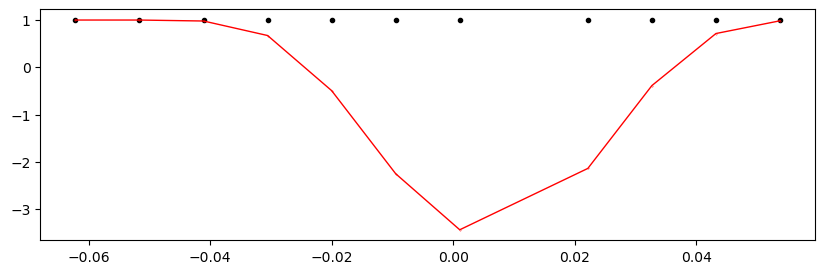

2784.0775913400003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.69it/s]


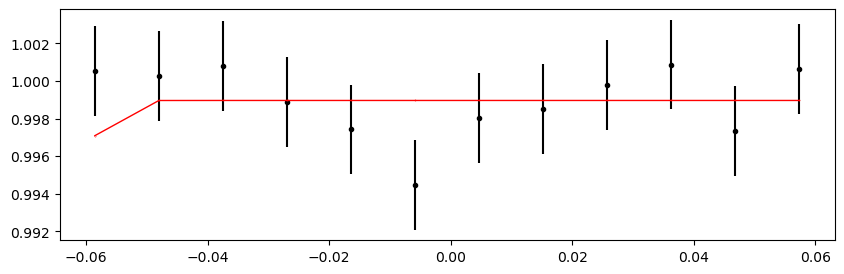

2784.7365161999996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.76it/s]


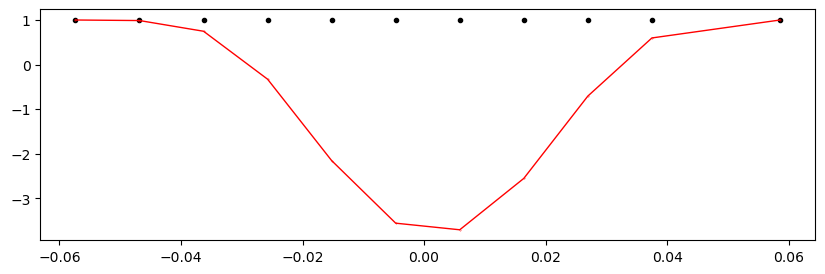

2785.39544106 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.79it/s]


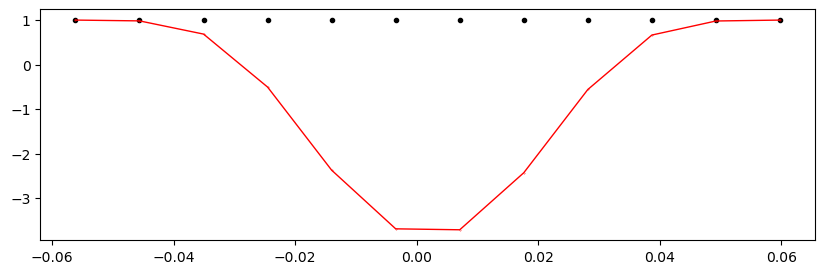

2786.0543659200002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.84it/s]


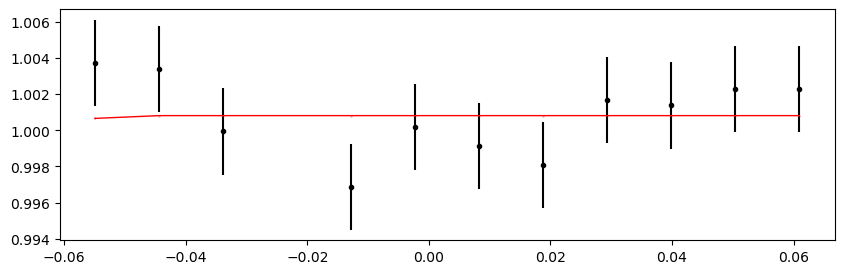

2786.7132907799996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.57it/s]


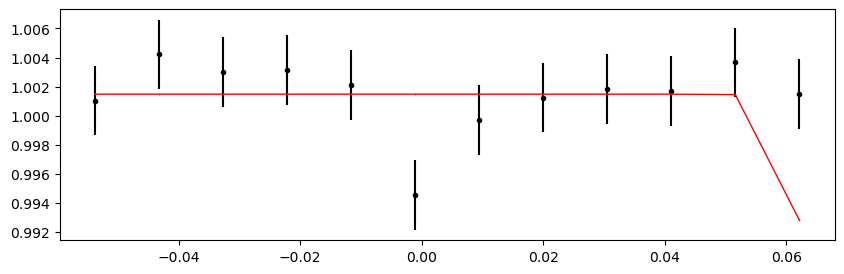

2787.37221564 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.39it/s]


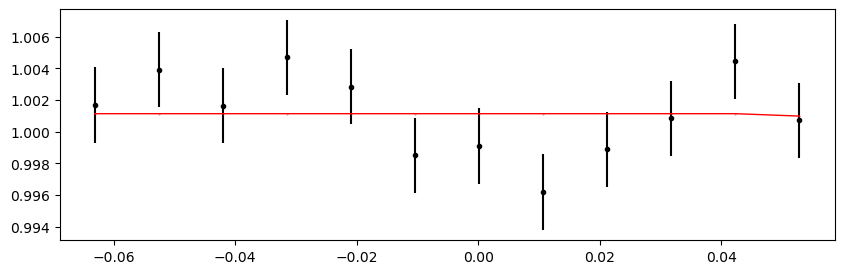

2788.0311405 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 556.84it/s]


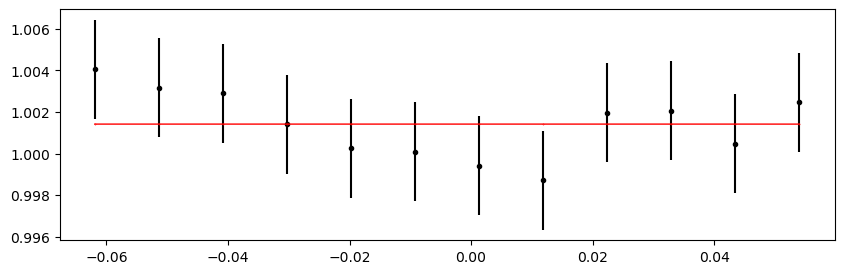

2788.6900653599996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.90it/s]


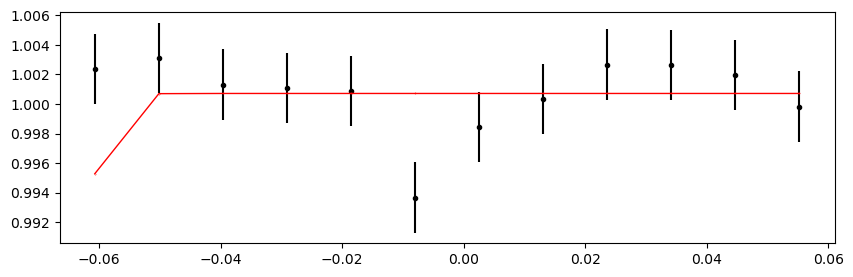

2789.34899022 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.66it/s]


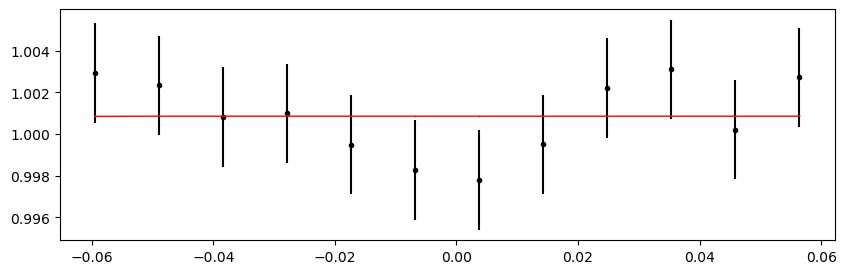

2790.00791508 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 554.26it/s]


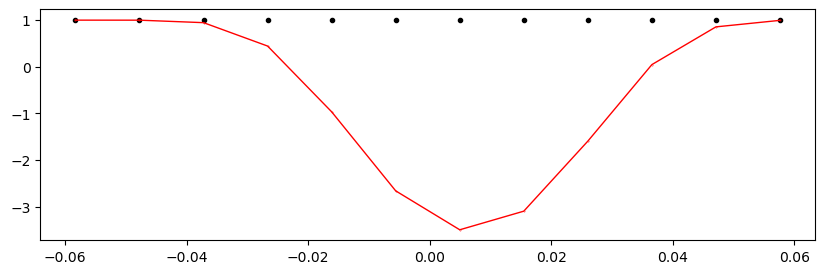

2790.66683994 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 524.94it/s]


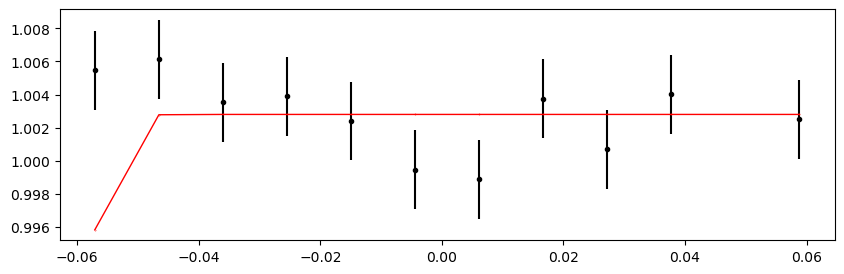

2791.3257648 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 542.74it/s]


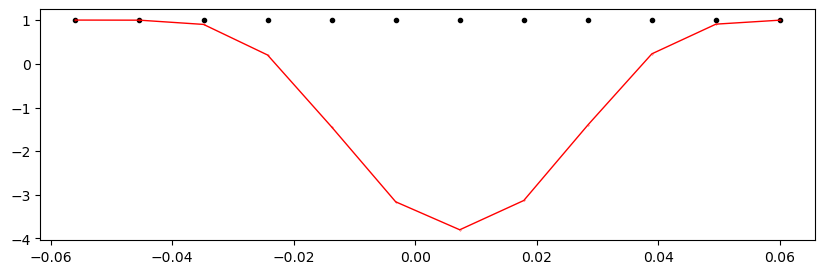

2791.98468966 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 469.15it/s]


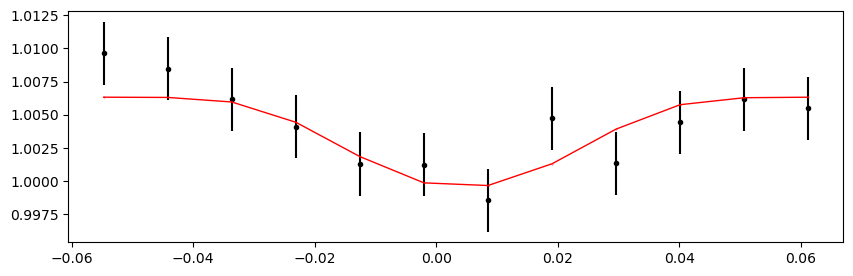

2792.64361452 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.96it/s]


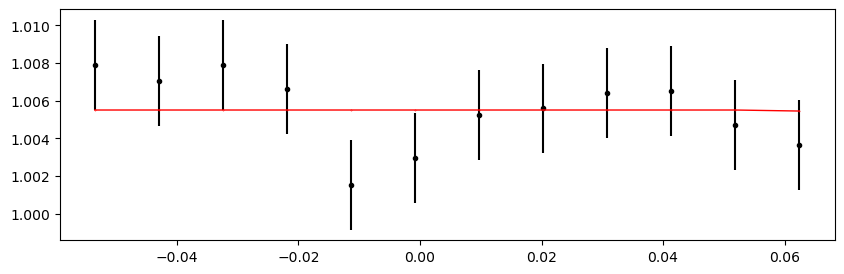

2793.30253938 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.24it/s]


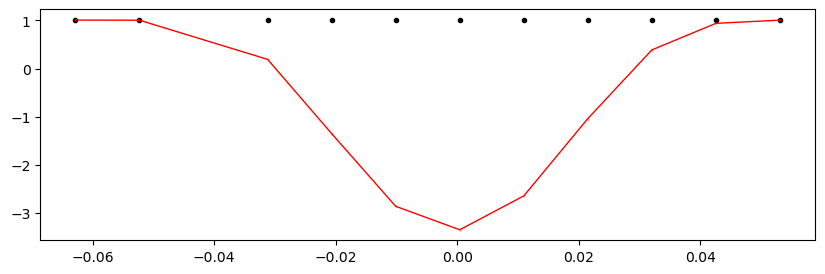

2793.96146424 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.34it/s]


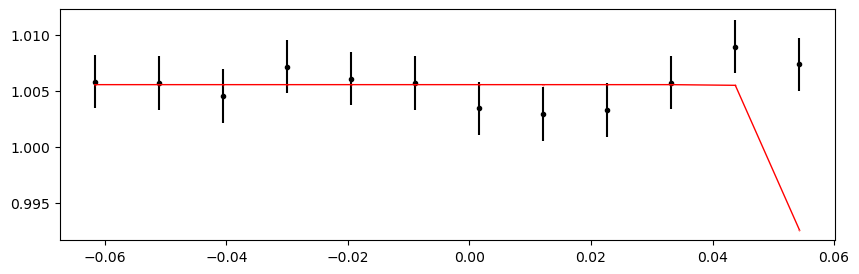

2794.6203891 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.60it/s]


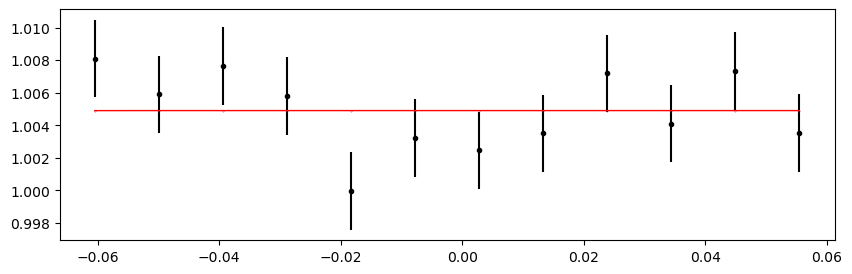

2795.27931396 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.41it/s]


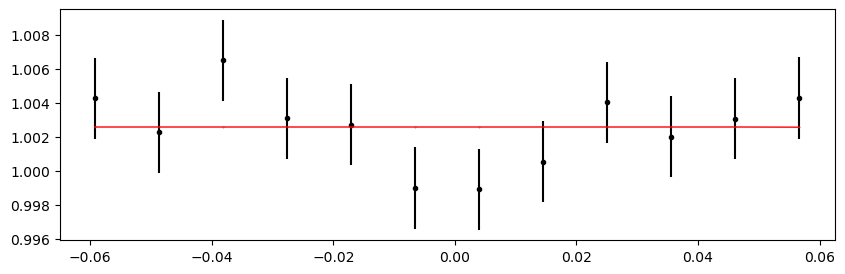

2795.93823882 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.70it/s]


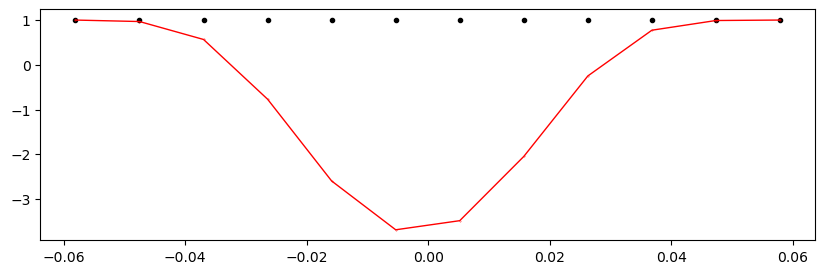

2797.25608854 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.79it/s]


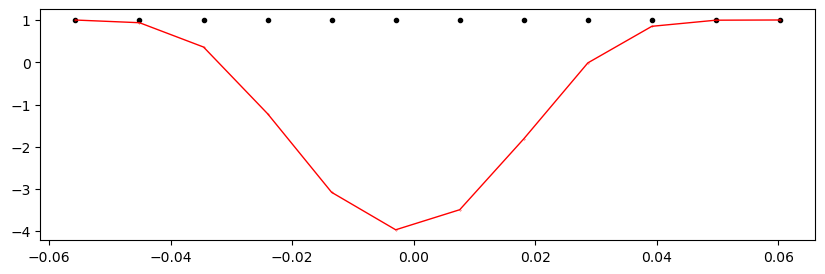

2797.9150134 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.79it/s]


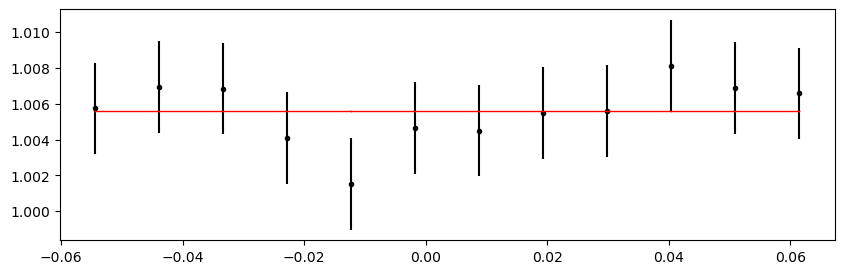

2798.57393826 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.94it/s]


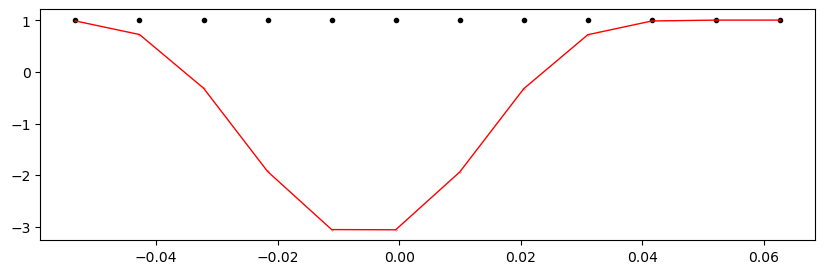

2799.23286312 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 544.82it/s]


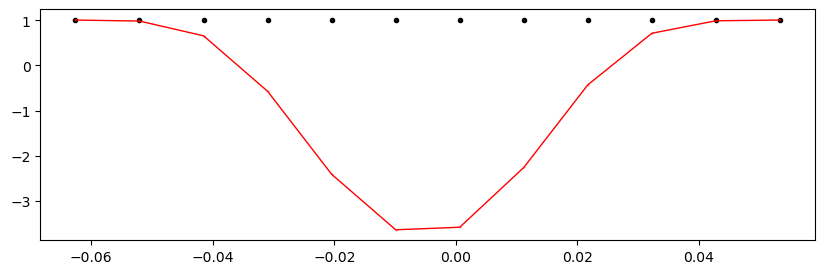

2799.89178798 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.85it/s]


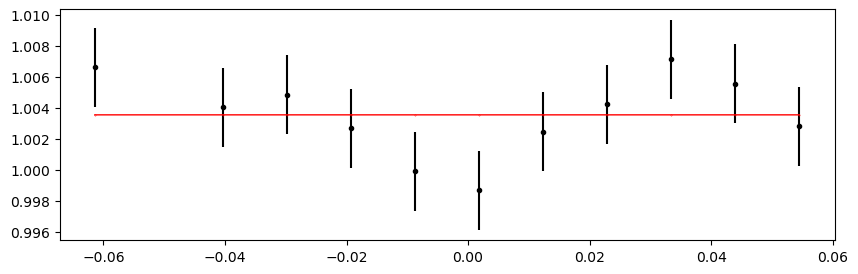

2800.55071284 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 537.48it/s]


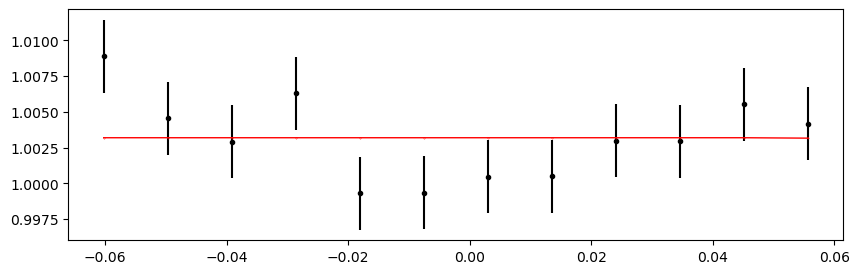

2801.2096377 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.11it/s]


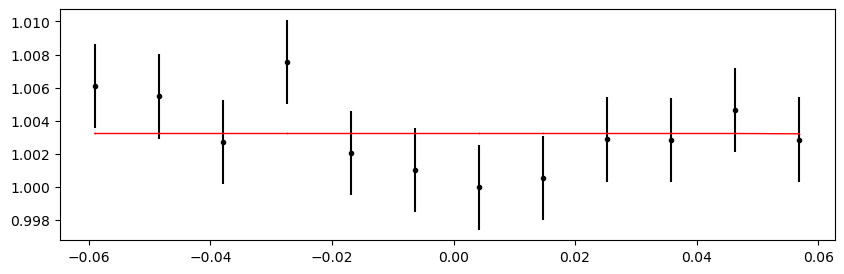

2801.86856256 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.64it/s]


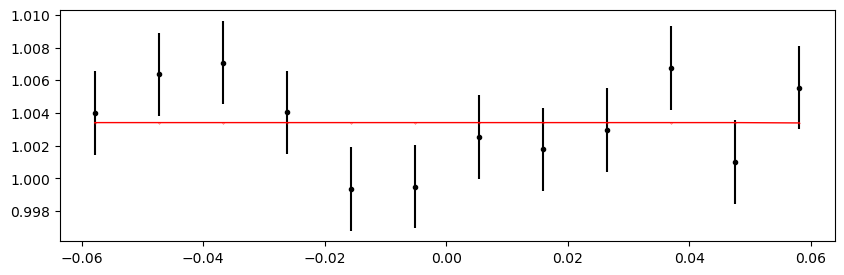

2802.52748742 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.01it/s]


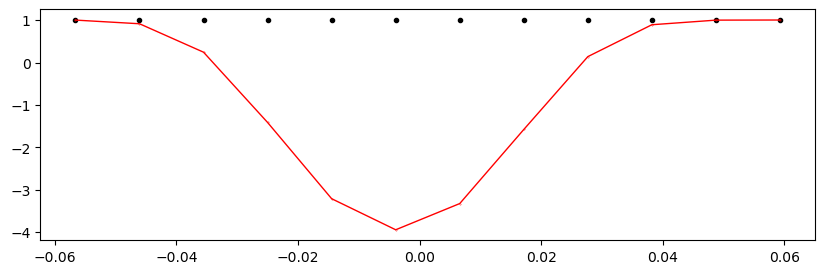

2803.18641228 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 504.44it/s]


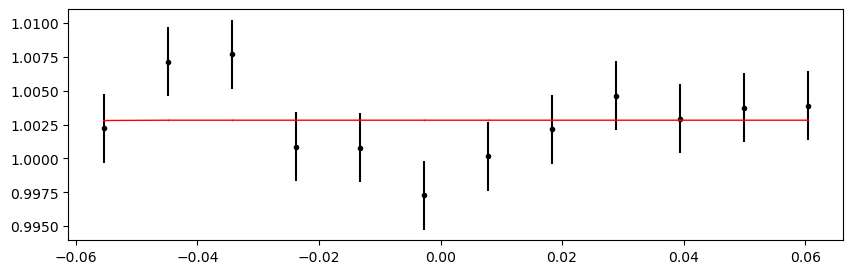

2803.84533714 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.06it/s]


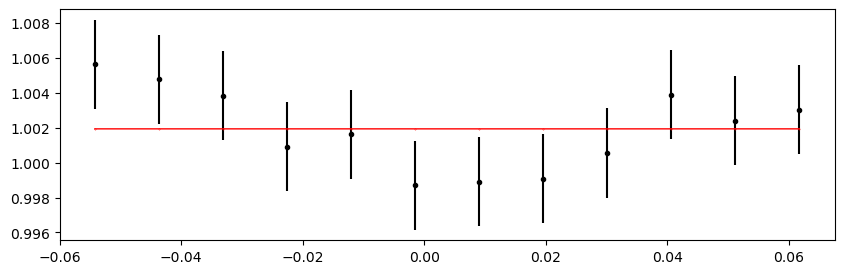

2804.504262 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.98it/s]


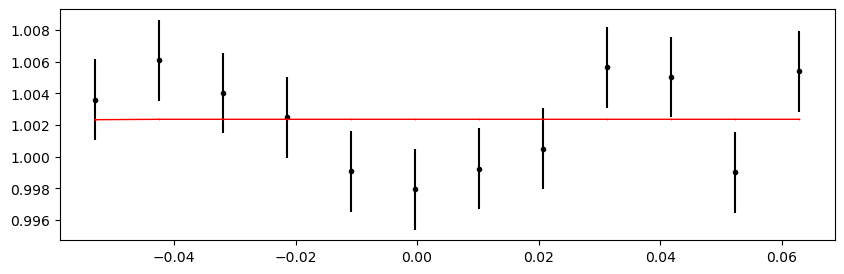

2805.1631868599998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.29it/s]


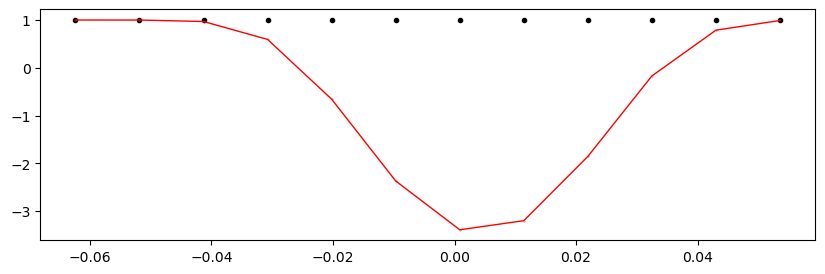

2805.82211172 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.65it/s]


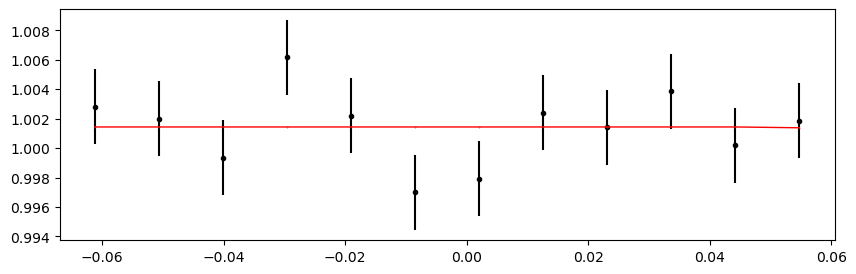

2806.48103658 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 541.27it/s]


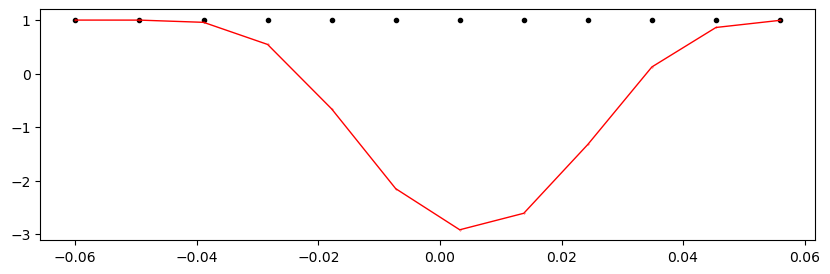

2807.1399614399998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 519.76it/s]


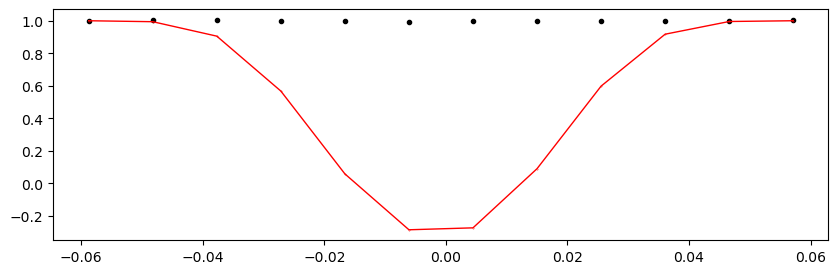

2807.7988863 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.42it/s]


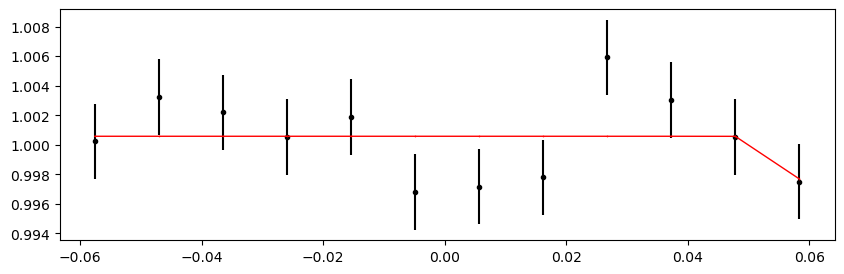

2808.45781116 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.34it/s]


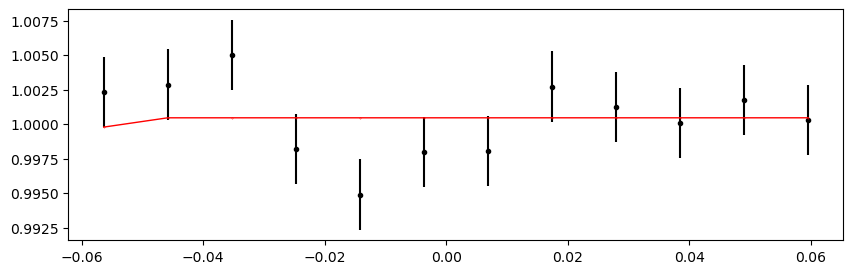

2809.1167360199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.05it/s]


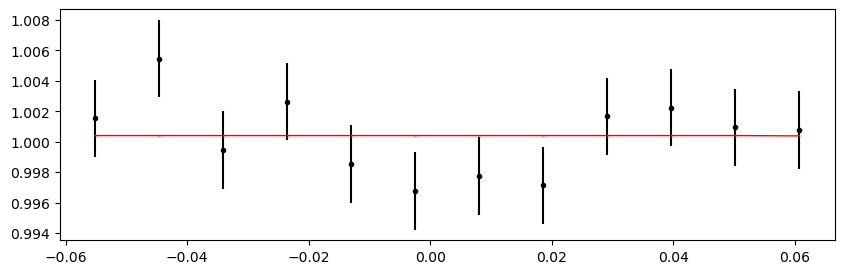

2809.77566088 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 536.21it/s]


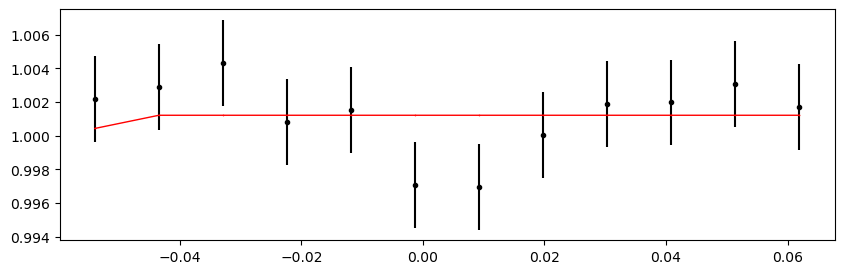

2811.0935105999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 546.01it/s]


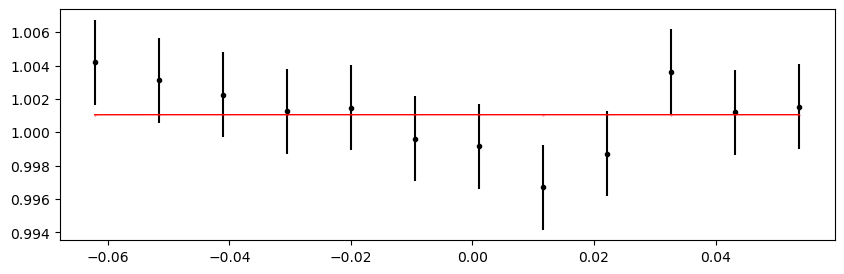

2811.75243546 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 553.10it/s]


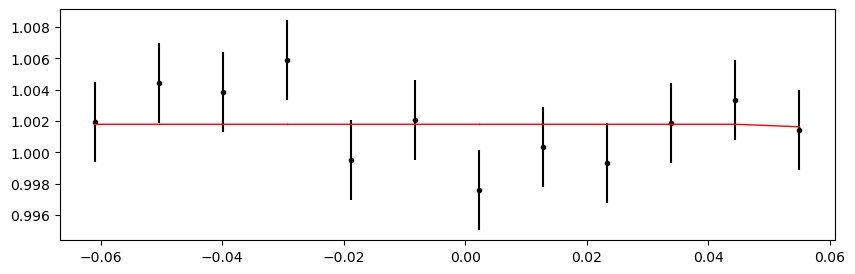

2812.41136032 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.81it/s]


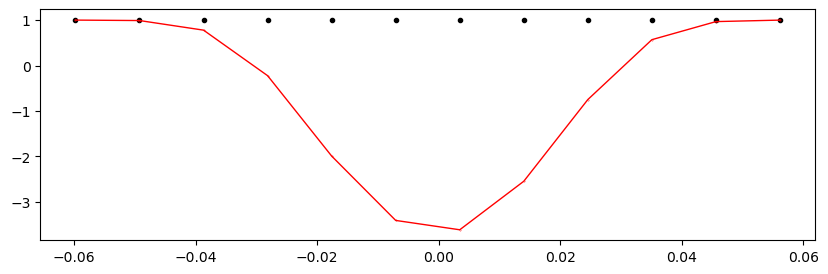

2813.0702851799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.48it/s]


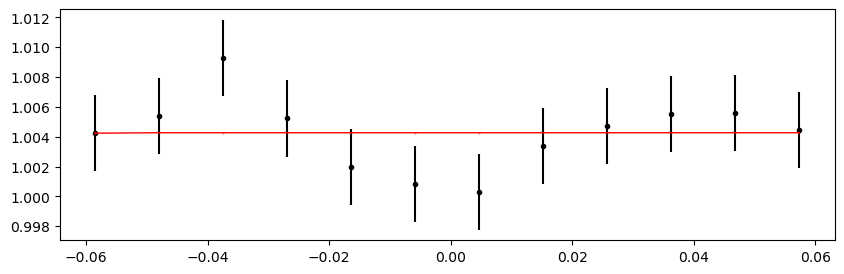

2813.72921004 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.98it/s]


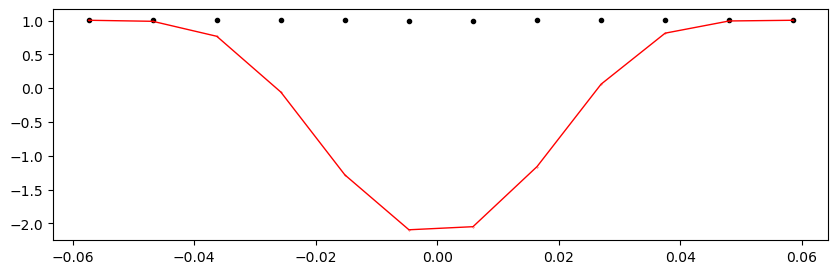

2814.3881349 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 543.18it/s]


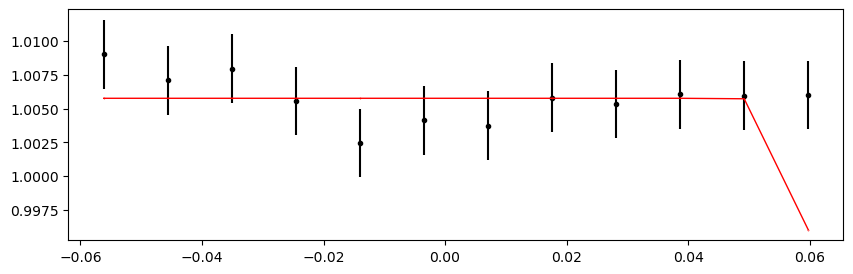

2815.0470597599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.63it/s]


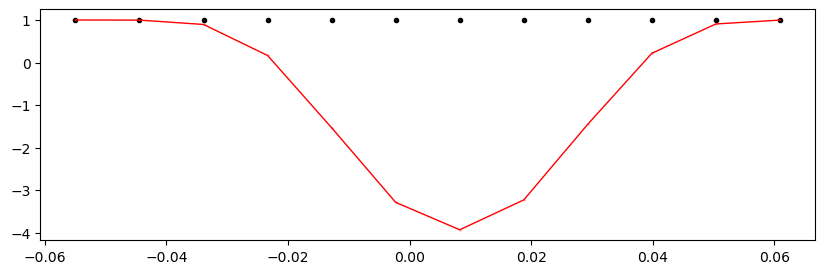

2815.70598462 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.29it/s]


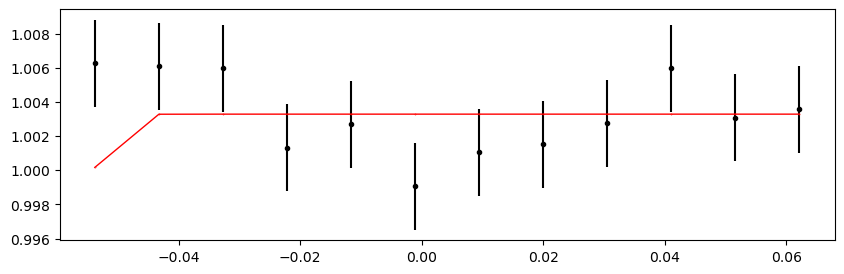

2816.3649094800003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.52it/s]


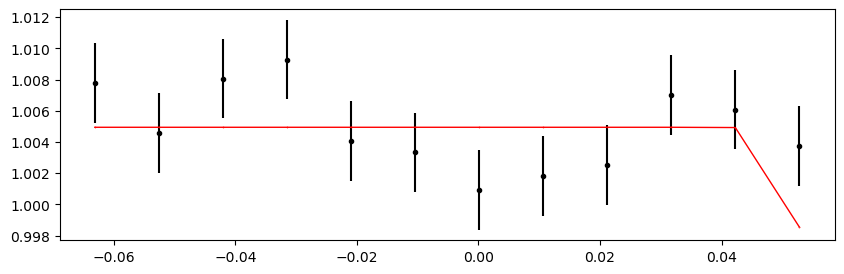

2817.0238343399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 551.58it/s]


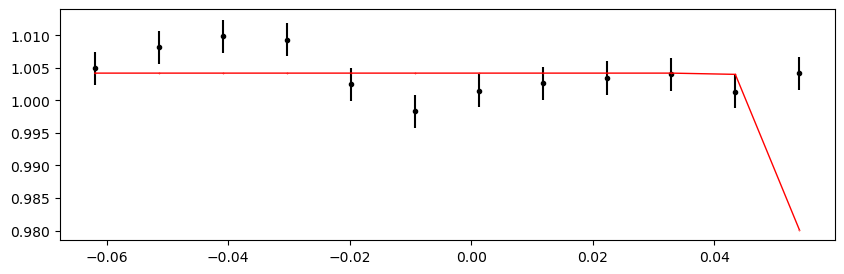

2817.6827592 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.82it/s]


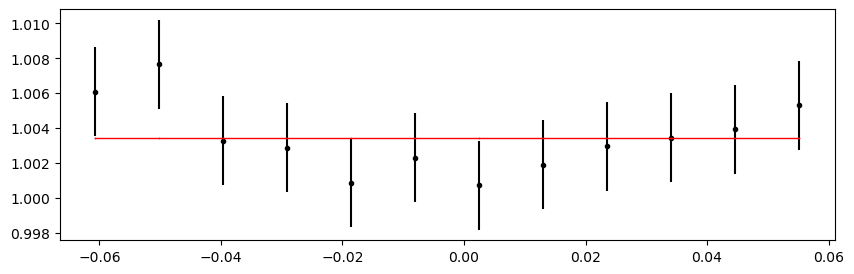

2818.3416840600003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.58it/s]


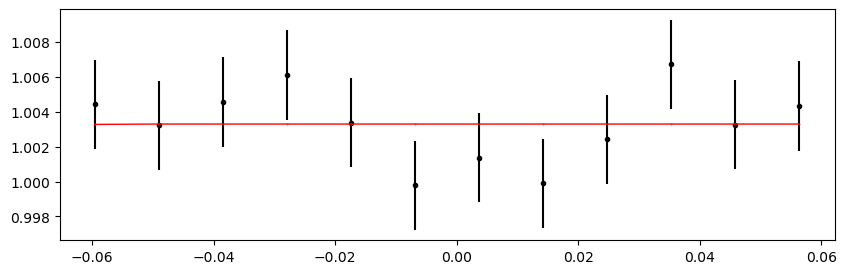

2819.0006089199996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 547.20it/s]


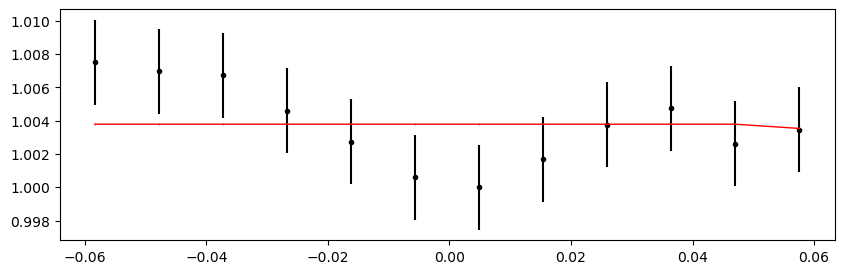

2819.65953378 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 552.19it/s]


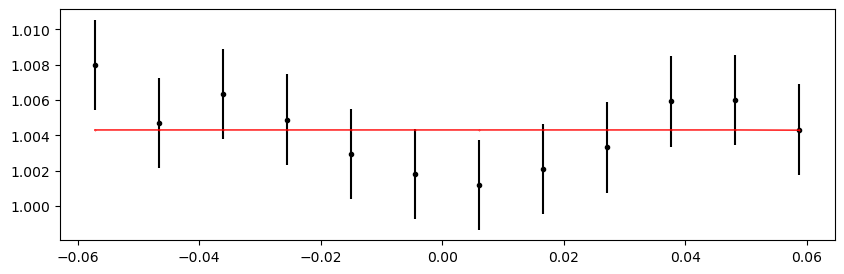

2820.3184586400002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 549.60it/s]


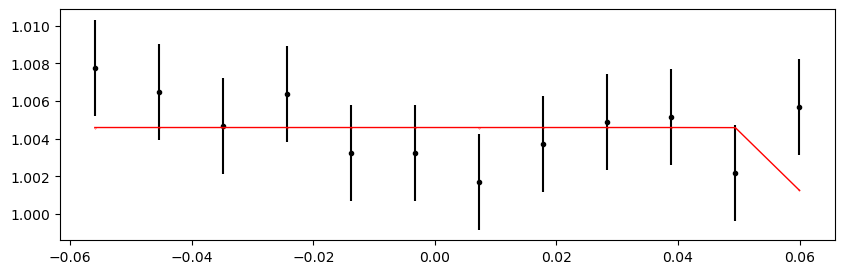

2820.9773834999996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:17<00:00, 555.85it/s]


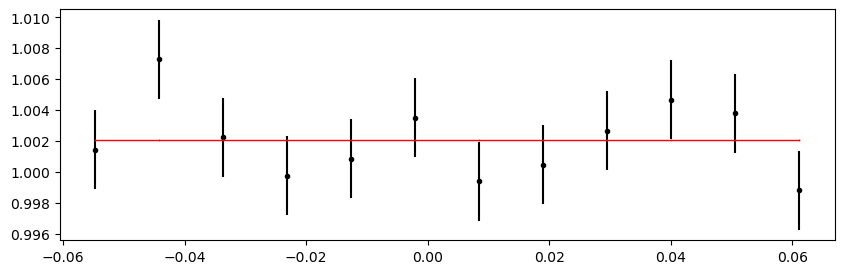

2821.63630836 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 506.01it/s]


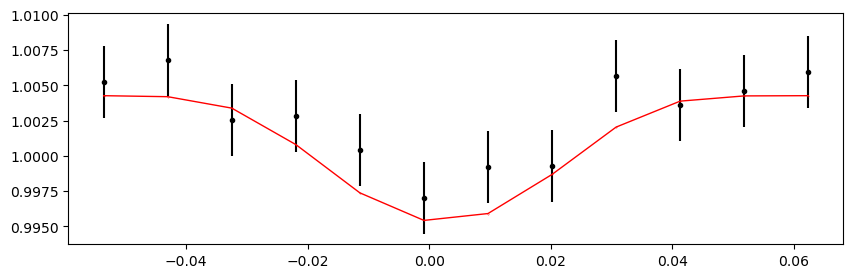

2822.2952332200002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 545.71it/s]


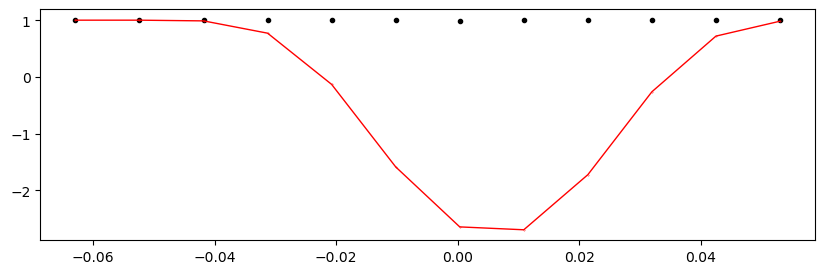

2822.9541580799996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 548.39it/s]


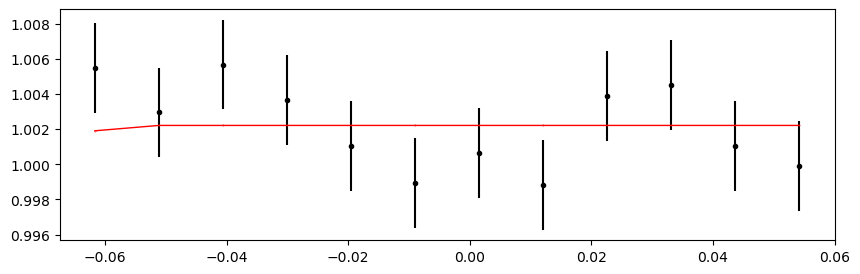

2823.61308294 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 550.35it/s]


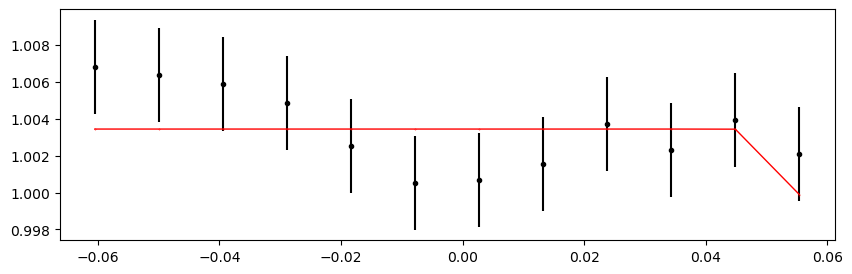

Time 2824.2720078 does not have enough data points: 5
2825.58985752 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.88it/s]


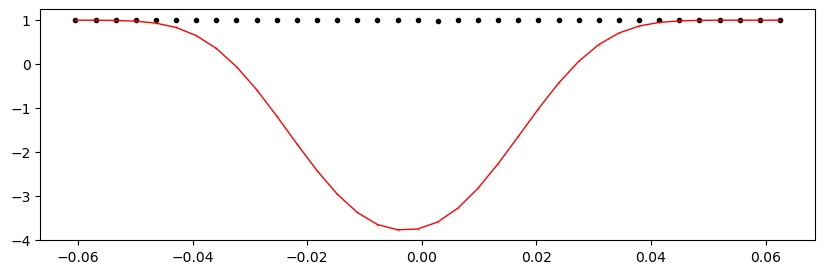

2826.24878238 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 416.82it/s]


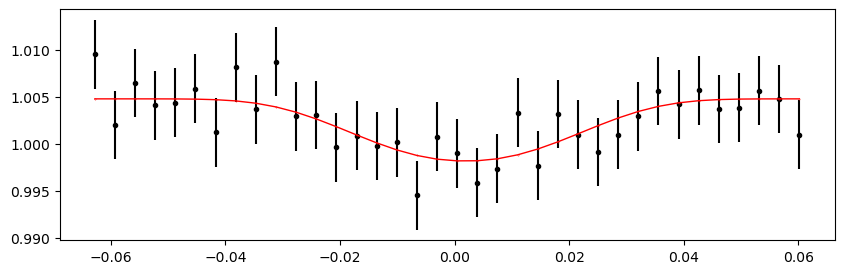

2826.90770724 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 523.13it/s]


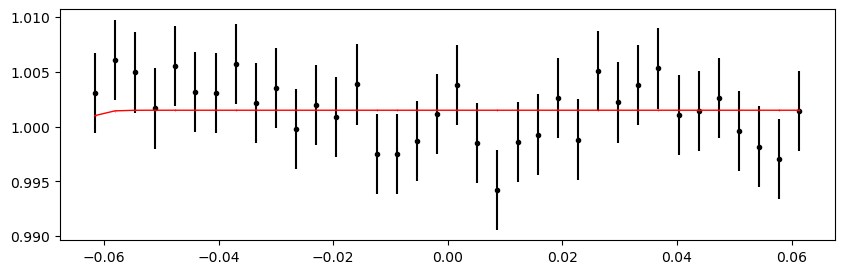

2827.5666321 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.17it/s]


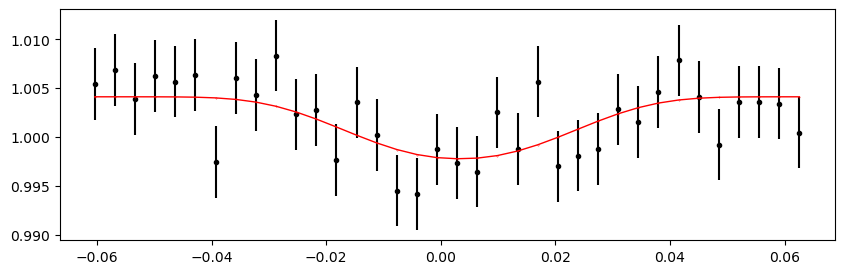

2828.22555696 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 522.87it/s]


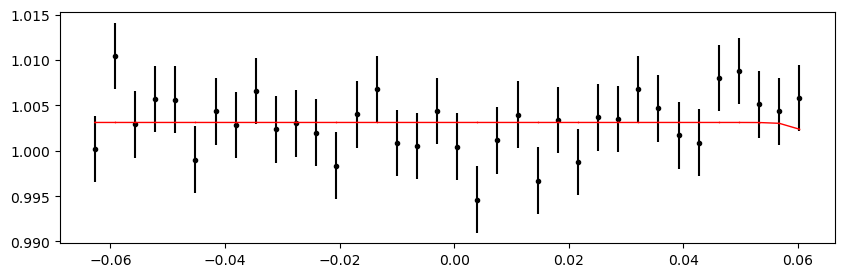

2828.88448182 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 527.42it/s]


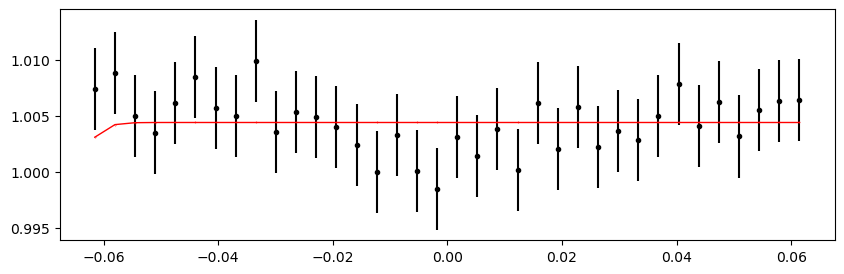

2829.54340668 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 528.69it/s]


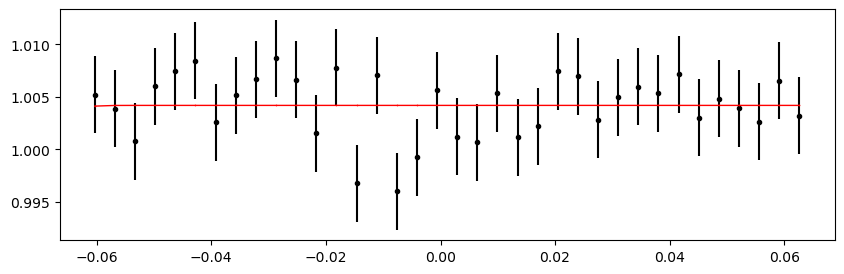

2830.20233154 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.12it/s]


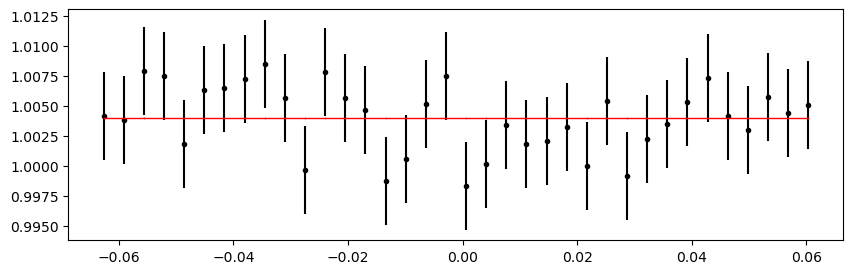

2830.8612564 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 459.11it/s]


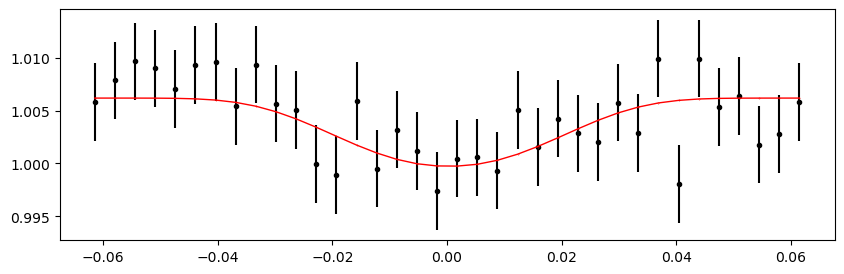

2831.52018126 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 522.74it/s]


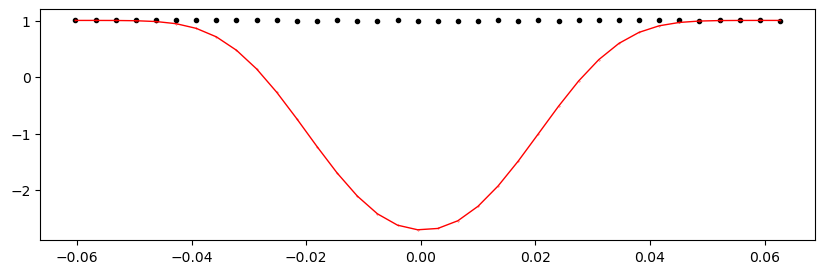

2832.17910612 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 492.74it/s]


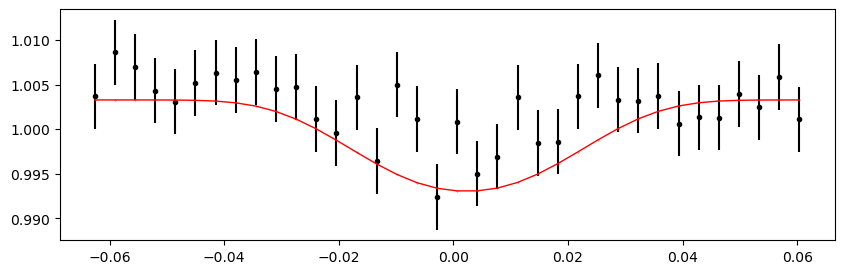

2832.83803098 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 525.77it/s]


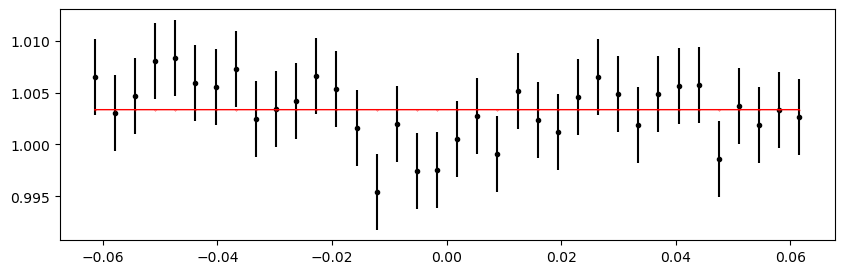

2833.49695584 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 534.63it/s]


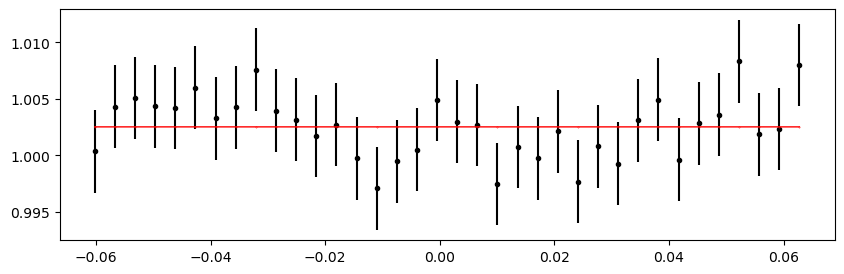

2834.1558807 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.95it/s]


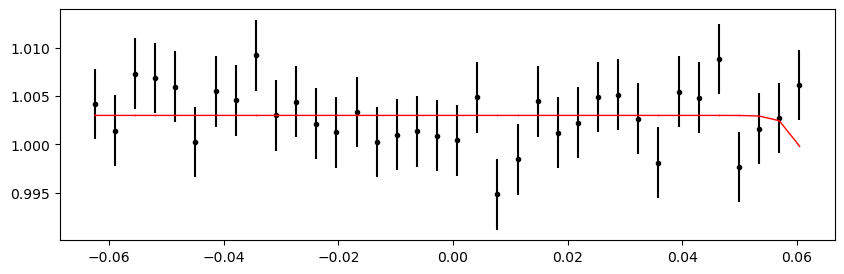

2834.81480556 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.36it/s]


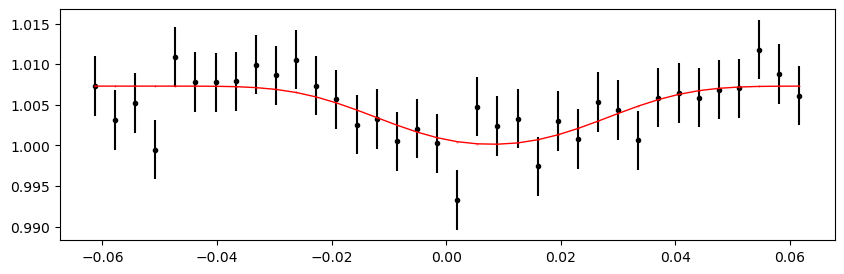

2835.47373042 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.51it/s]


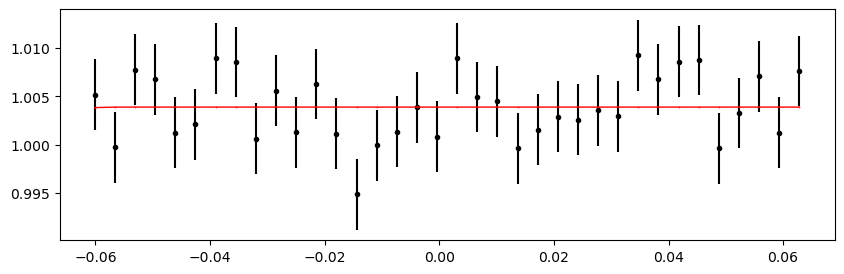

2836.13265528 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 423.56it/s]


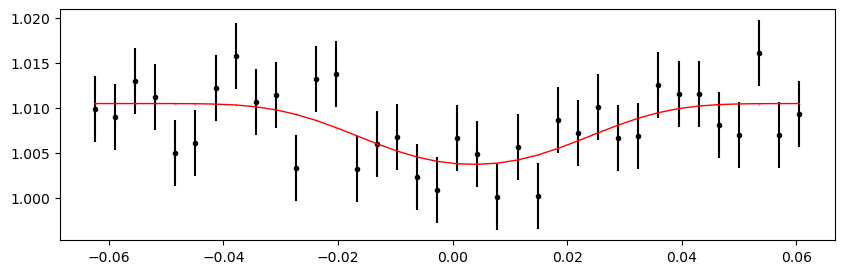

2836.79158014 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 526.88it/s]


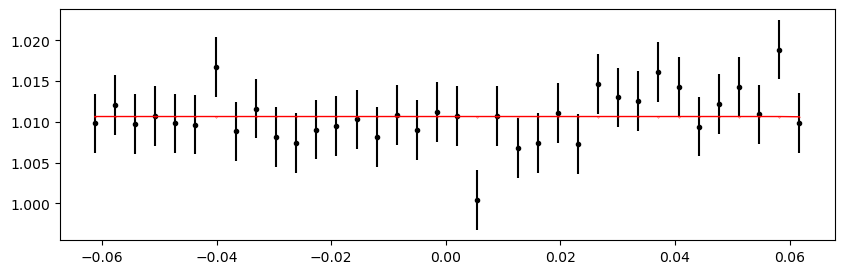

2837.450505 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 533.20it/s]


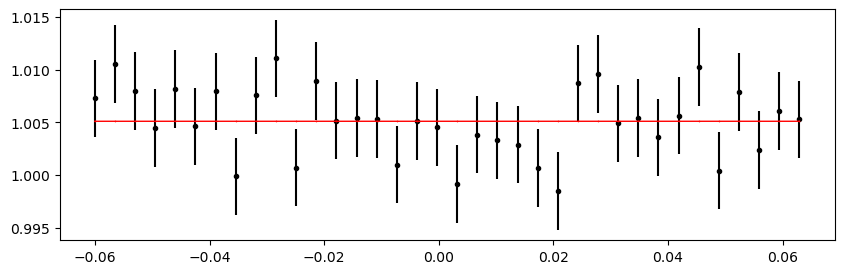

2838.10942986 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 427.67it/s]


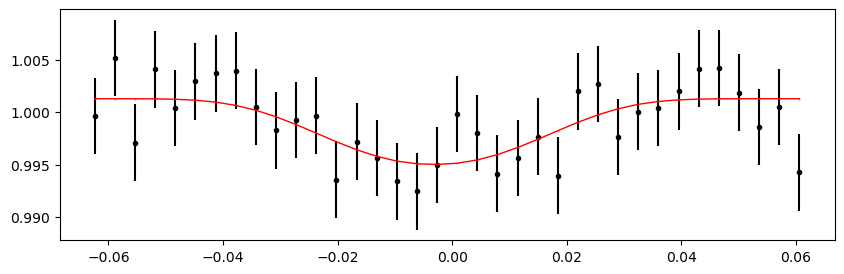

2838.76835472 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 530.22it/s]


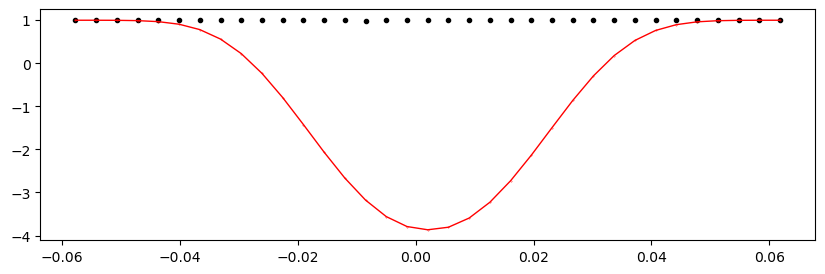

2839.42727958 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 529.81it/s]


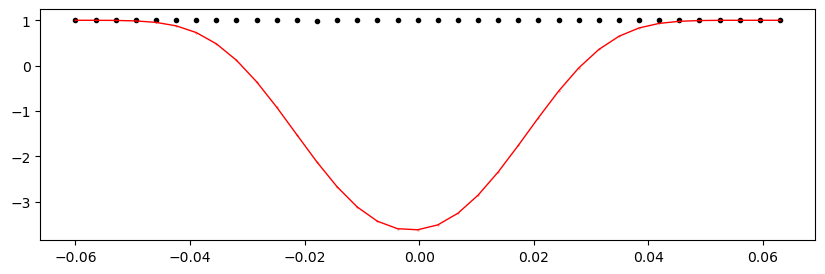

2840.08620444 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 527.42it/s]


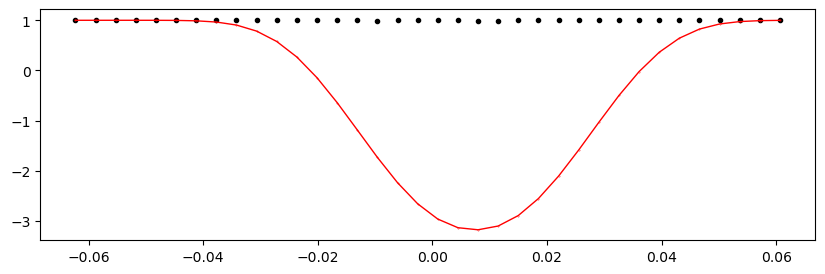

2840.7451293 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 426.85it/s]


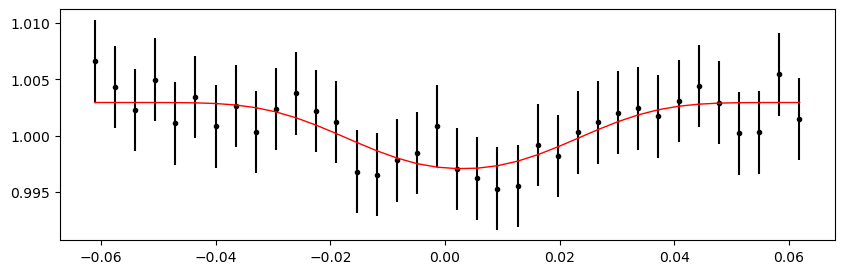

2841.4040541599998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 441.17it/s]


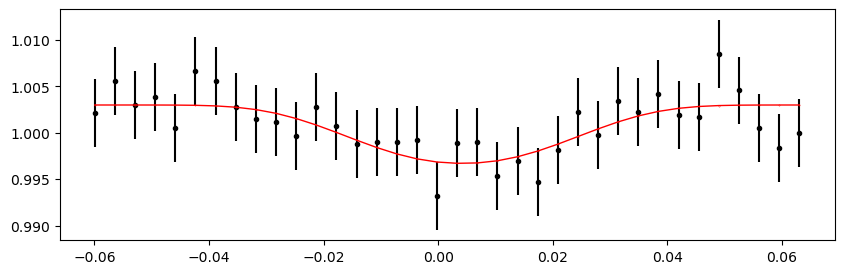

2842.06297902 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:18<00:00, 535.22it/s]


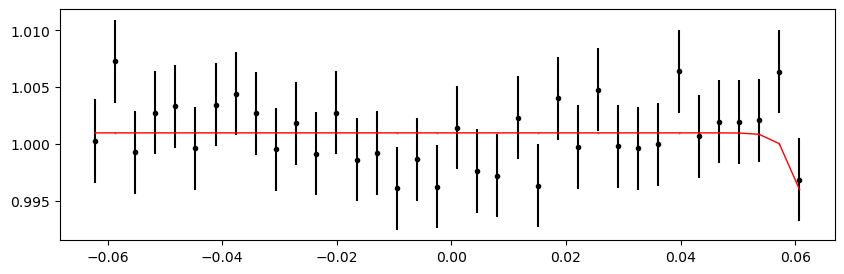

2842.72190388 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 518.25it/s]


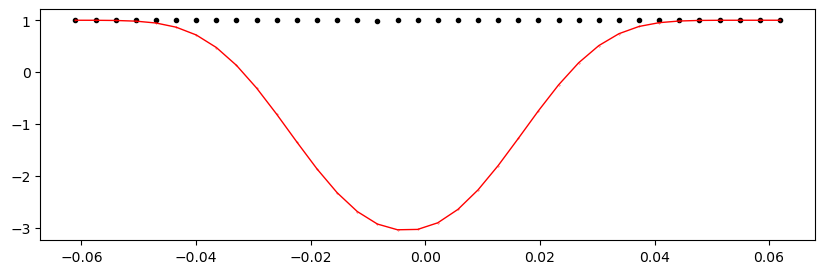

2843.3808287399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.49it/s]


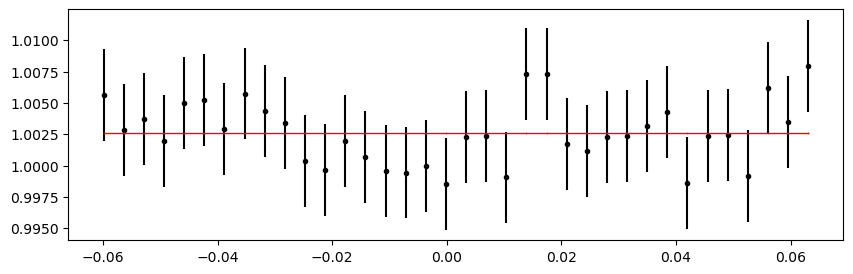

2844.0397536 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 489.19it/s]


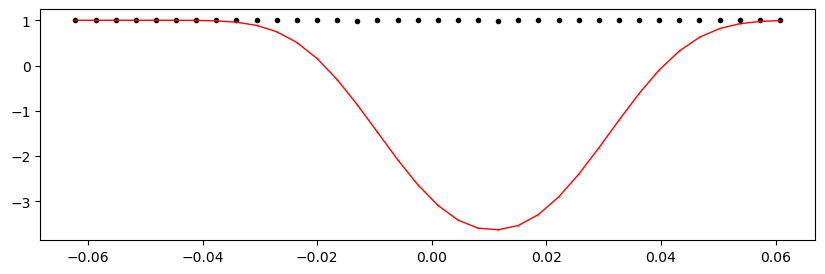

2844.69867846 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 516.17it/s]


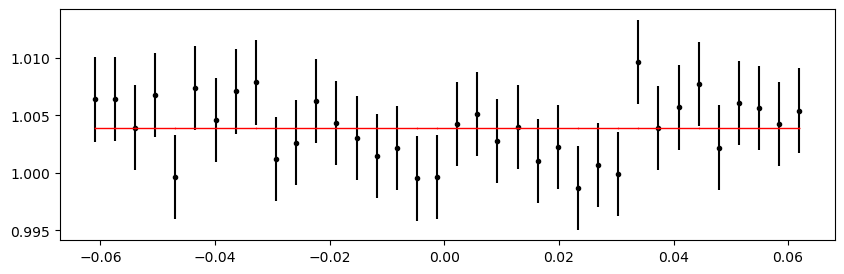

2845.3576033199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.16it/s]


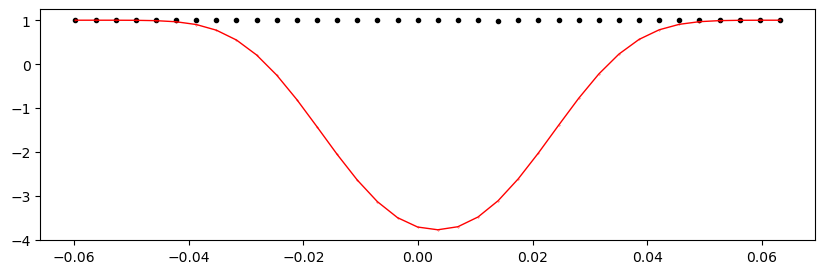

2846.67545304 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 522.33it/s]


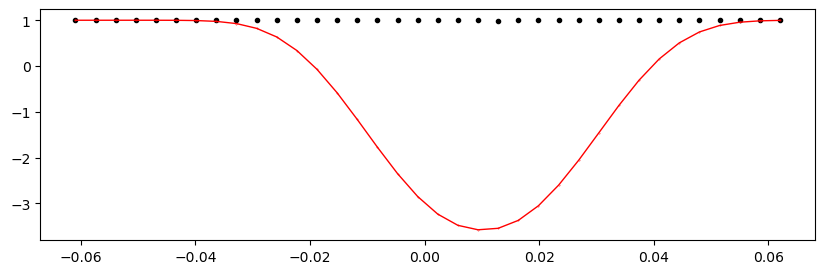

2847.3343778999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 518.40it/s]


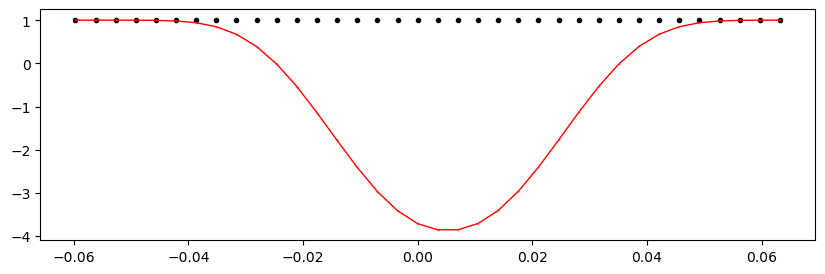

2847.99330276 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 448.13it/s]


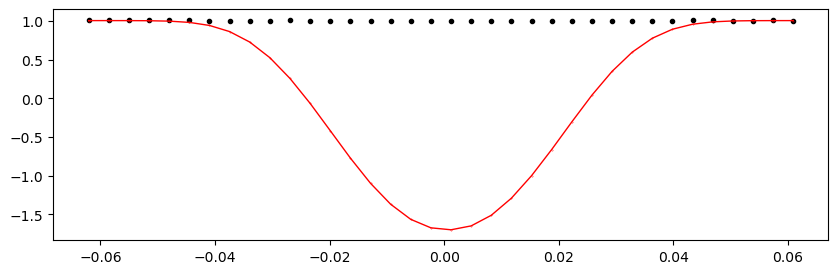

2848.65222762 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 445.39it/s]


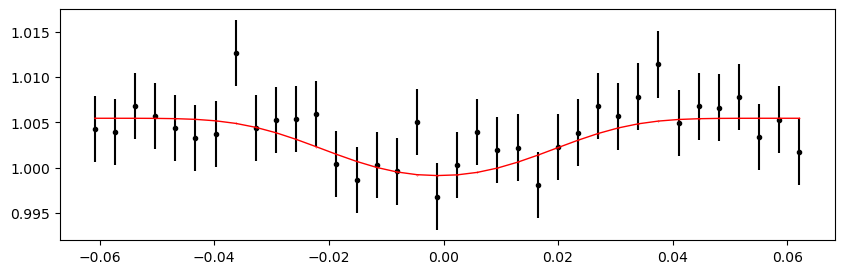

2849.3111524799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.63it/s]


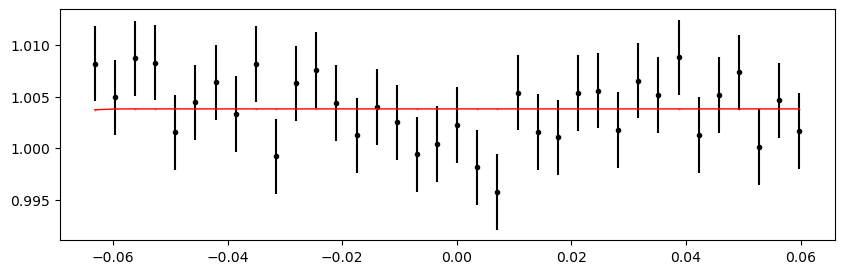

2849.97007734 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.94it/s]


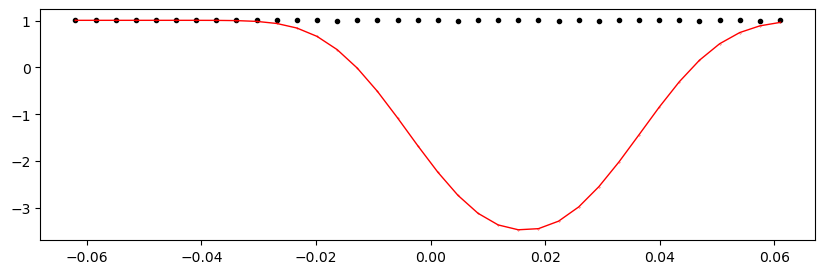

2850.6290022 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 455.88it/s]


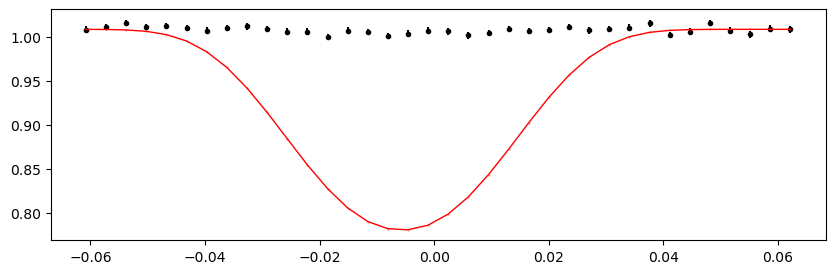

2851.2879270599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.84it/s]


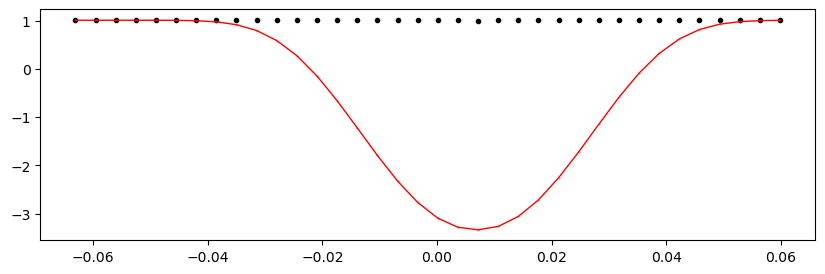

2851.94685192 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 507.70it/s]


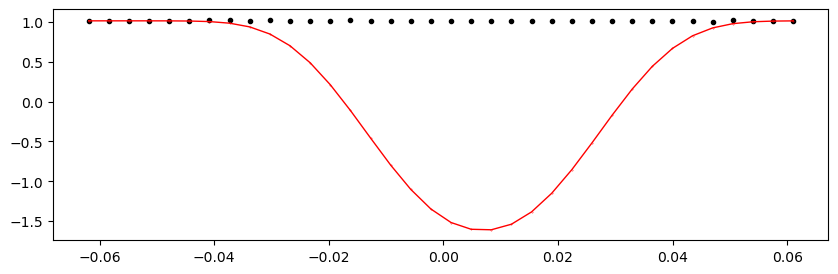

2852.6057767800003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 492.86it/s]


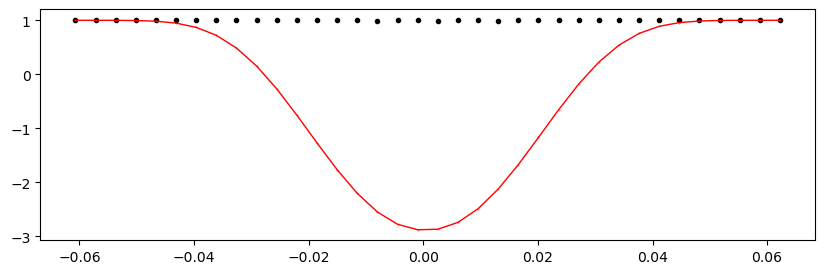

2853.9236265 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 428.47it/s]


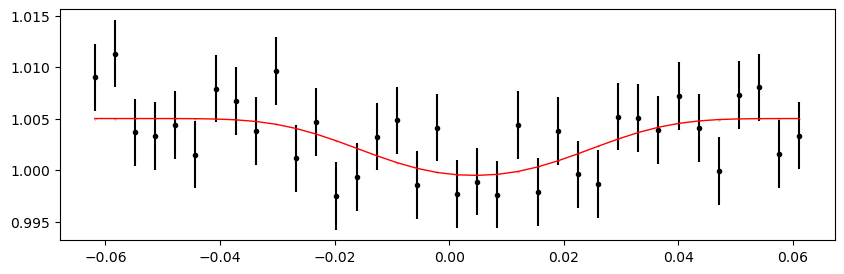

2854.5825513600003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.61it/s]


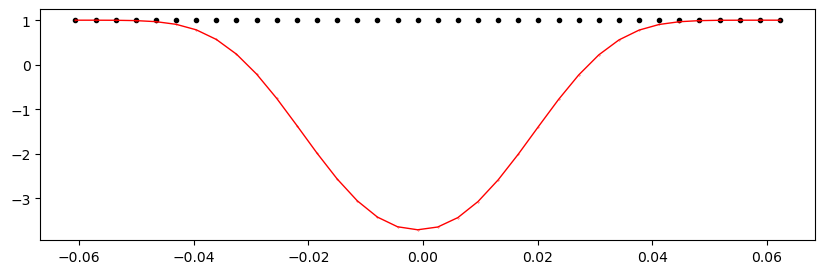

2855.2414762199996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 396.49it/s]


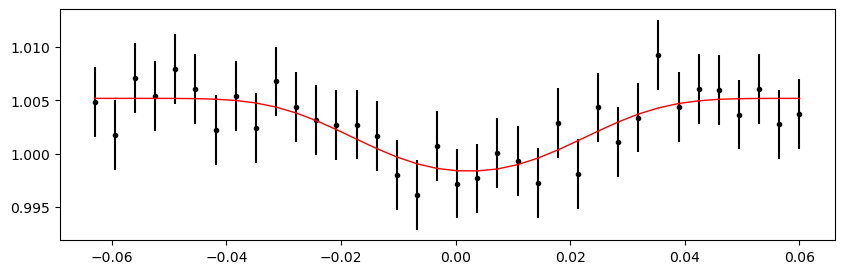

2855.90040108 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 409.90it/s]


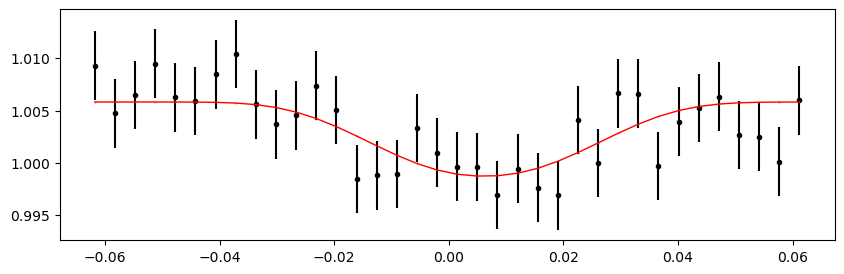

2856.5593259400002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 498.97it/s]


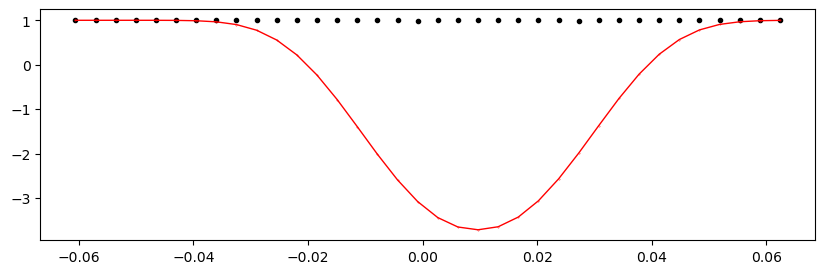

2857.2182507999996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.30it/s]


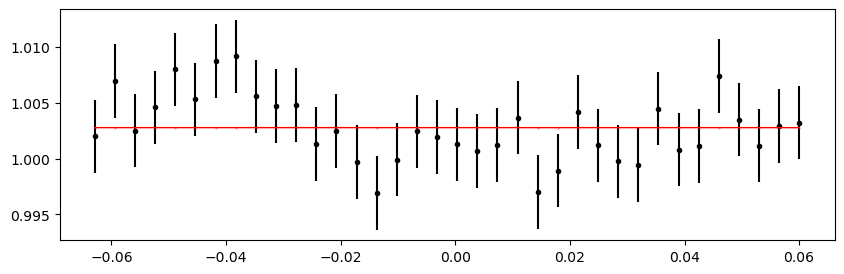

2857.87717566 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 410.96it/s]


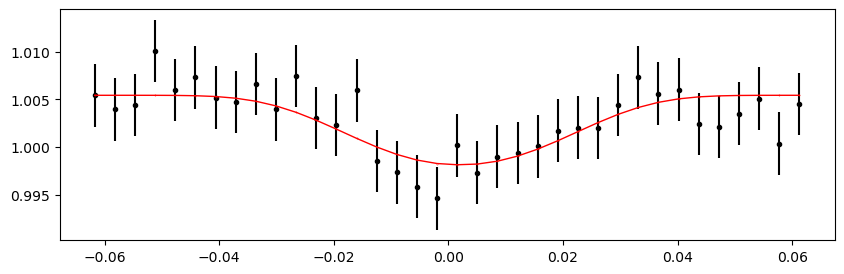

2858.53610052 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 488.02it/s]


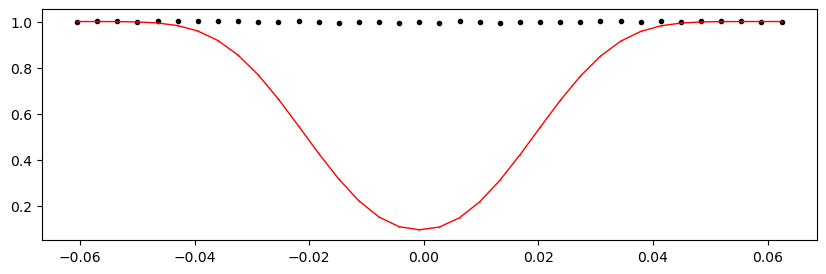

2859.1950253799996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 504.24it/s]


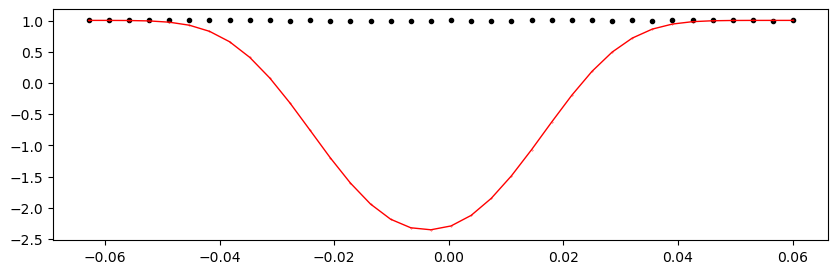

2859.85395024 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 473.46it/s]


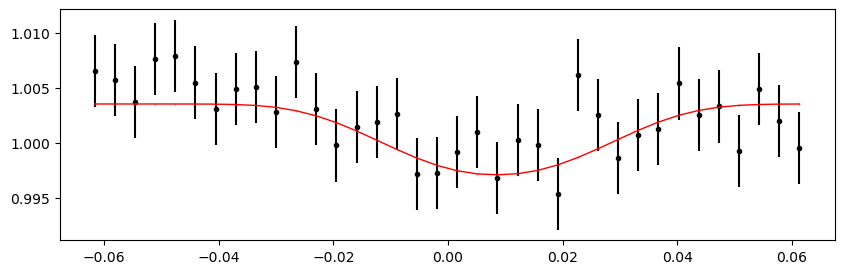

2860.5128751 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.94it/s]


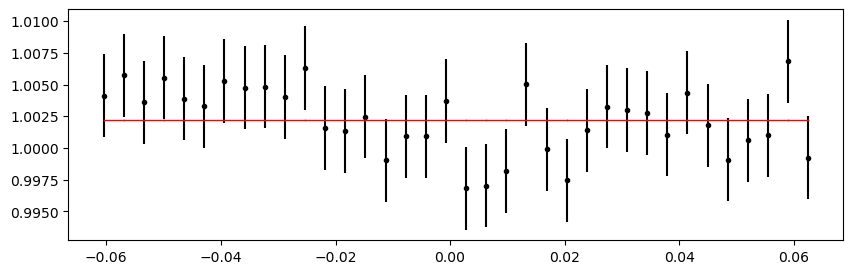

2861.17179996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.29it/s]


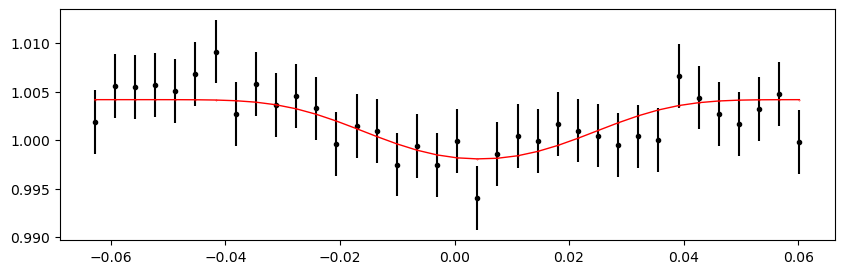

2861.83072482 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.61it/s]


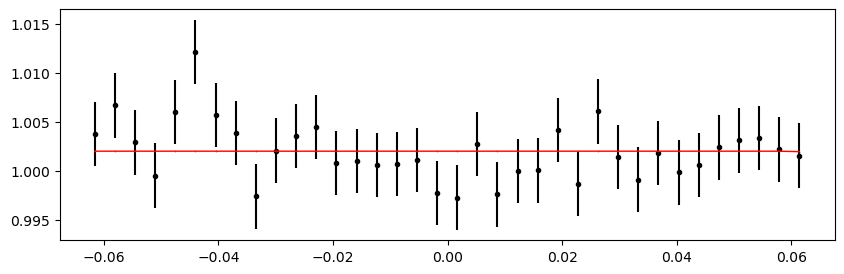

2862.48964968 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.99it/s]


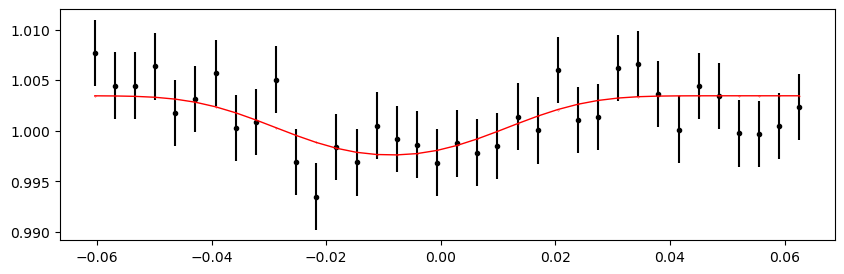

2863.14857454 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 447.89it/s]


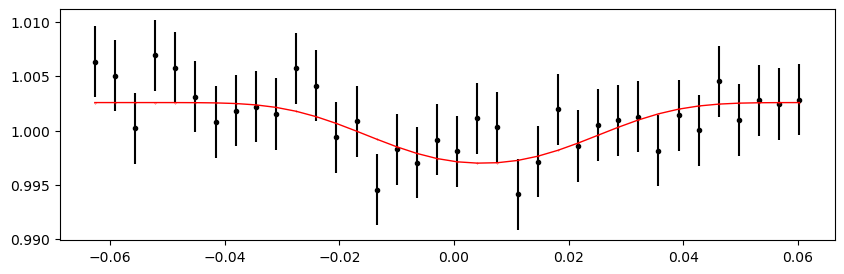

2866.44319884 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 465.40it/s]


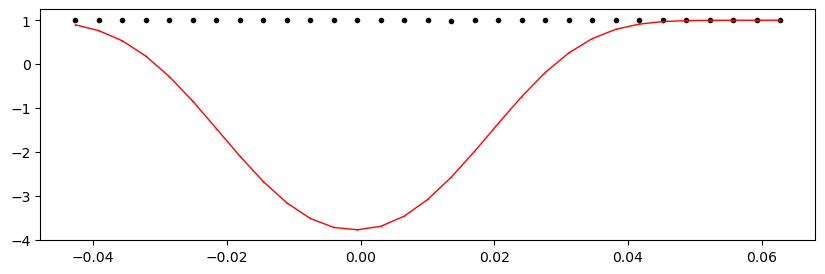

2867.1021237 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 477.19it/s]


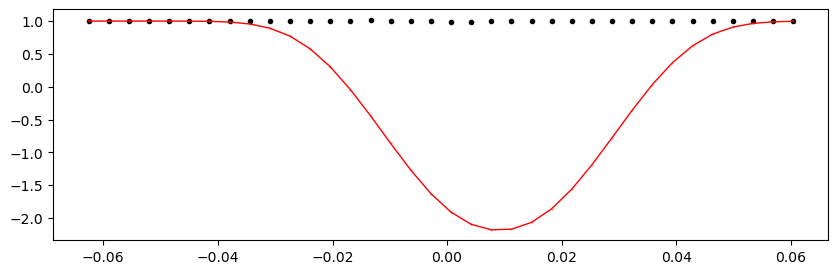

2867.76104856 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 390.49it/s]


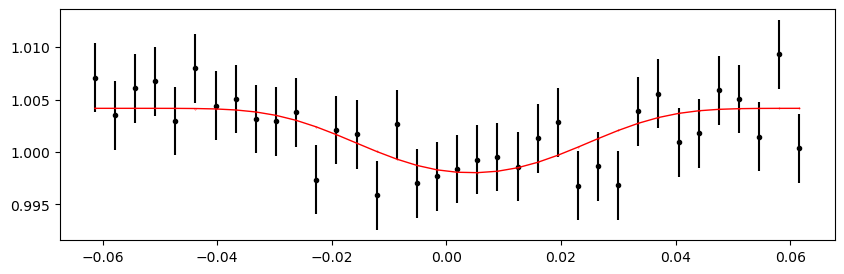

2868.41997342 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:26<00:00, 378.63it/s]


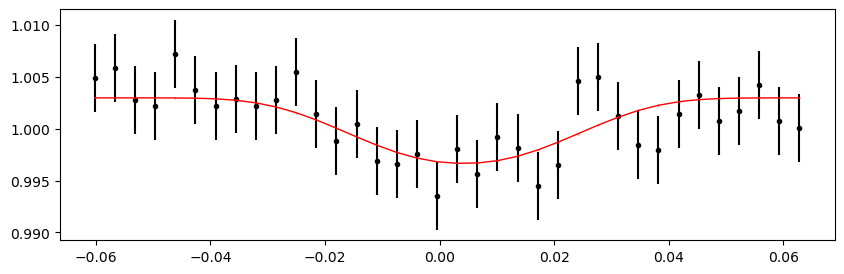

2869.07889828 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.39it/s]


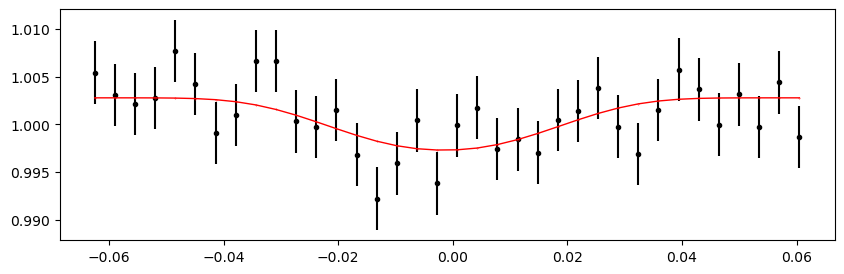

2869.73782314 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 412.35it/s]


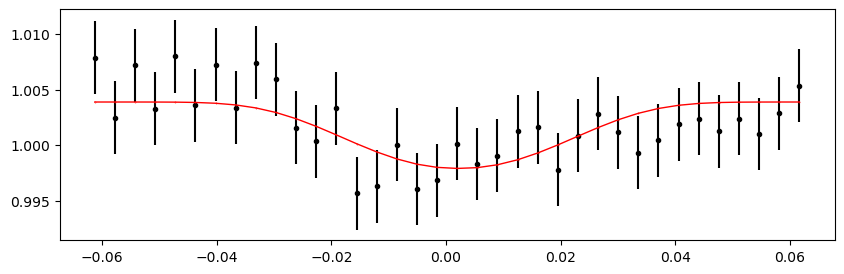

2870.396748 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.57it/s]


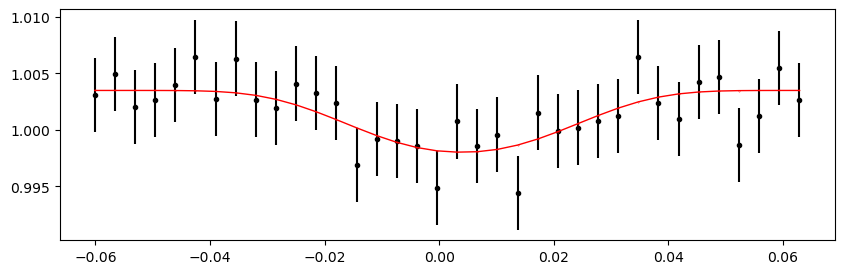

2871.05567286 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 488.87it/s]


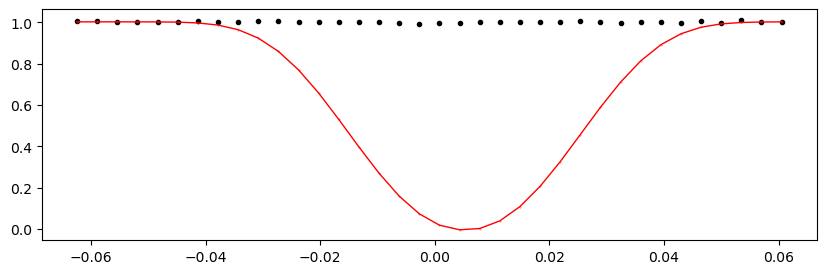

2871.71459772 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.05it/s]


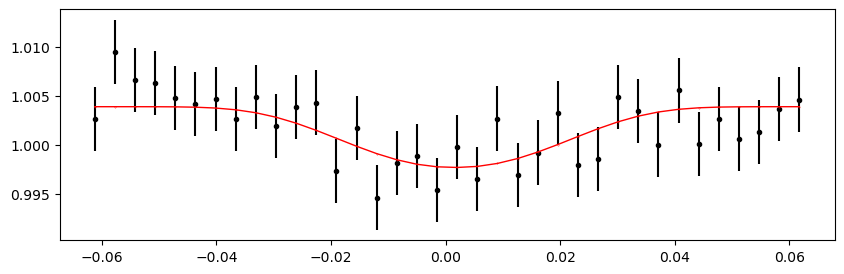

2872.37352258 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 412.97it/s]


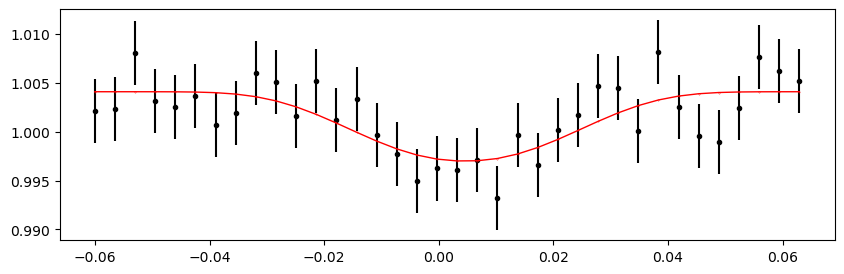

2873.03244744 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 414.16it/s]


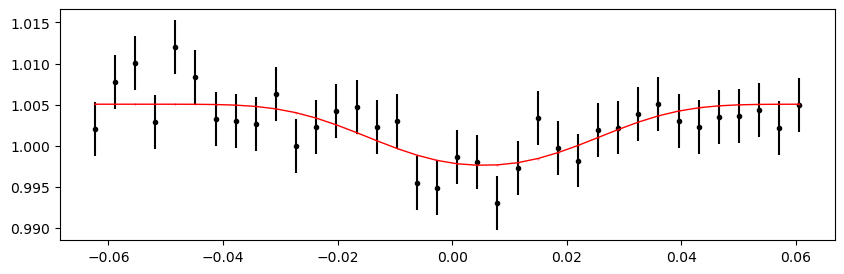

2873.6913723 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.29it/s]


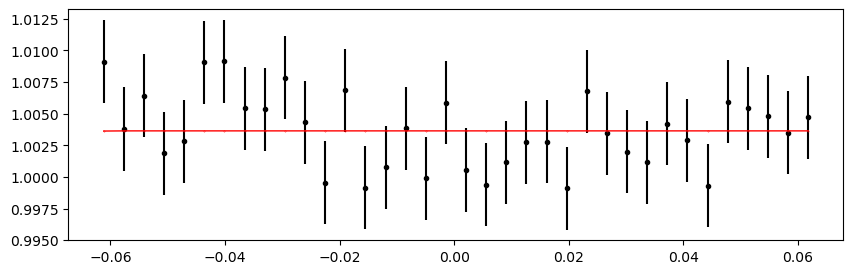

2874.35029716 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 410.91it/s]


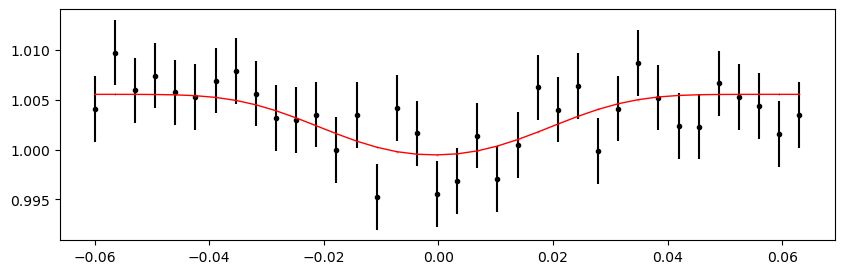

2875.00922202 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.53it/s]


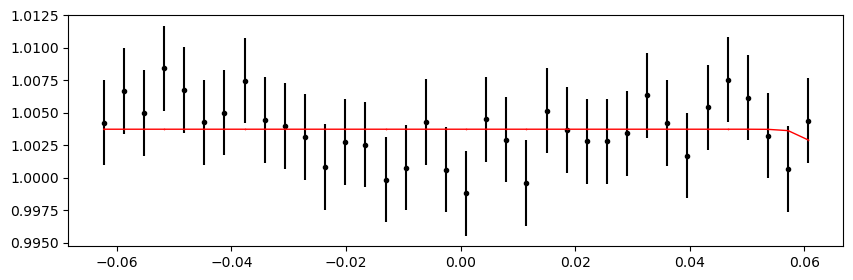

2875.6681468799998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.90it/s]


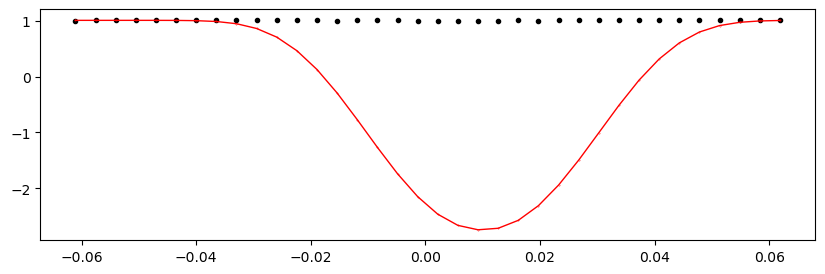

2876.32707174 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.47it/s]


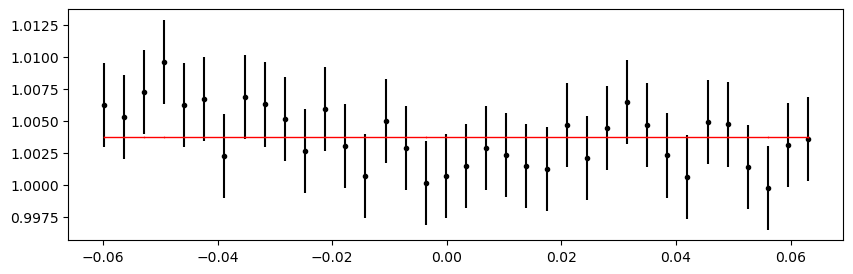

2876.9859966 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 485.48it/s]


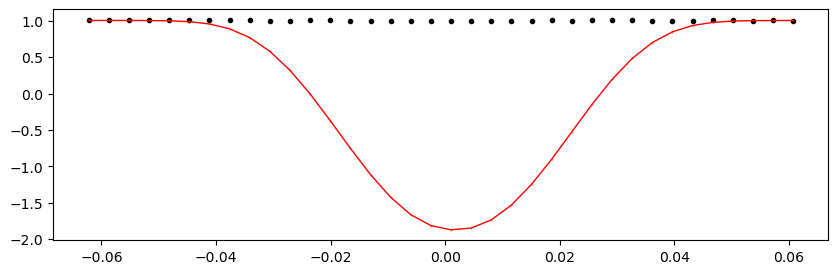

2877.6449214599998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.83it/s]


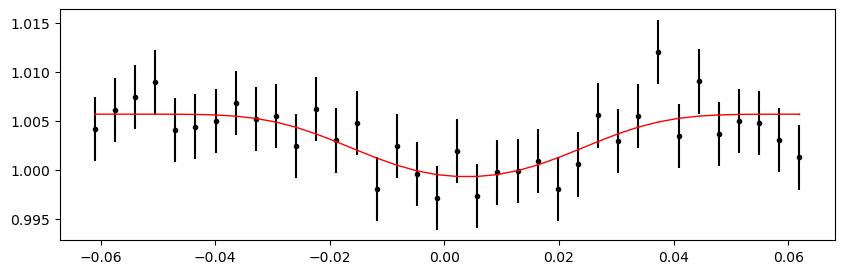

2878.30384632 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.19it/s]


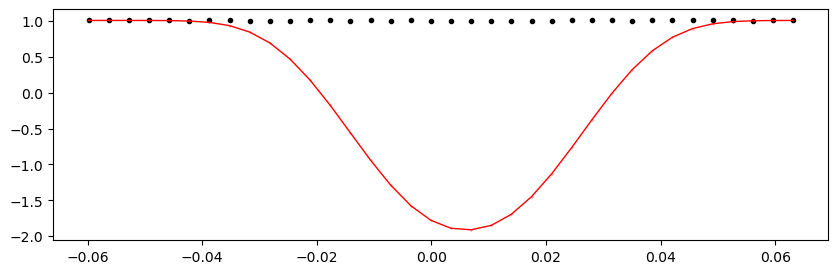

2878.96277118 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.61it/s]


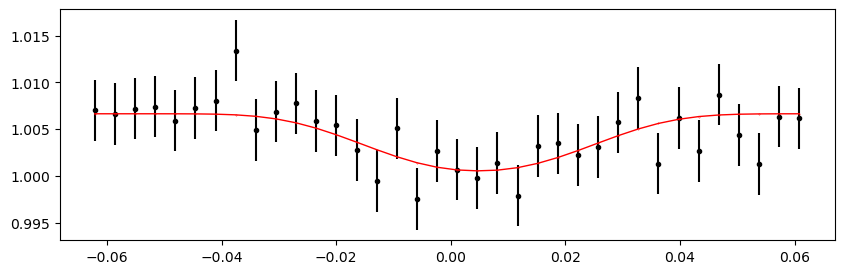

2879.6216960399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 480.02it/s]


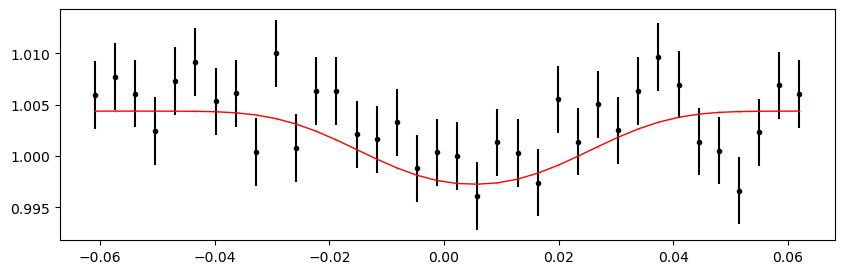

2880.2806209 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 413.25it/s]


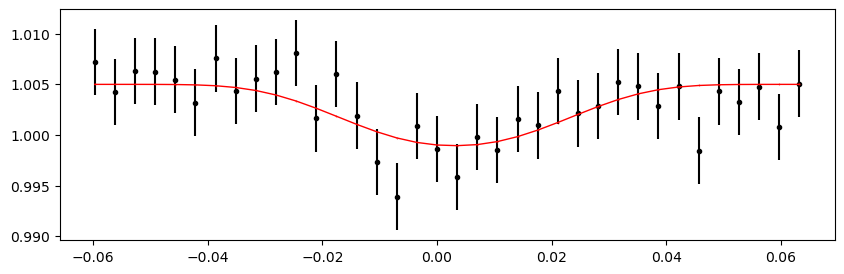

2880.93954576 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.94it/s]


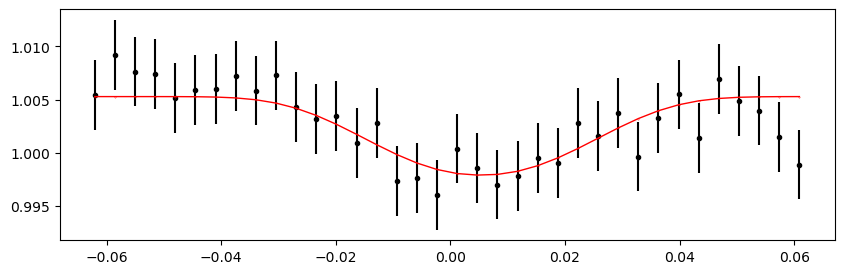

2881.5984706199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.92it/s]


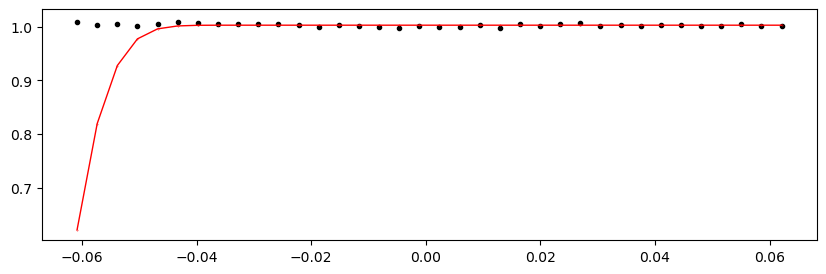

2882.91632034 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.61it/s]


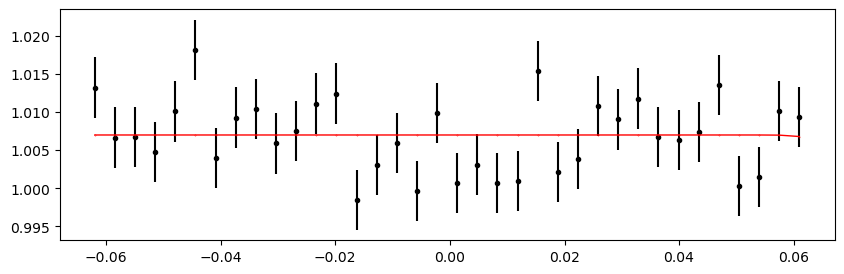

2883.5752451999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 505.12it/s]


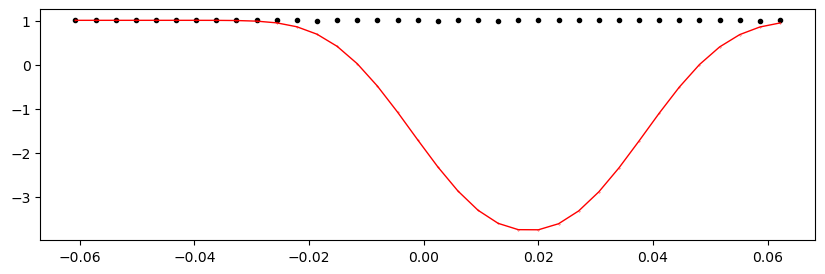

2884.23417006 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 492.54it/s]


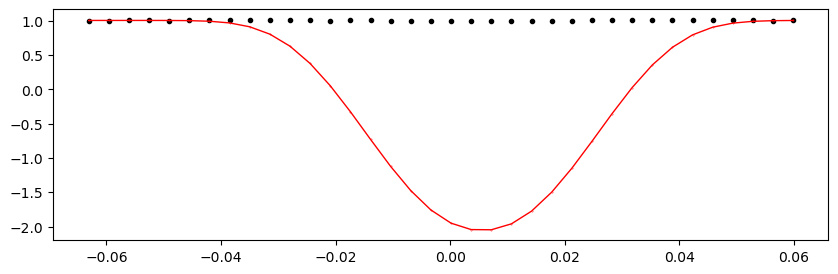

2884.89309492 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:23<00:00, 418.69it/s]


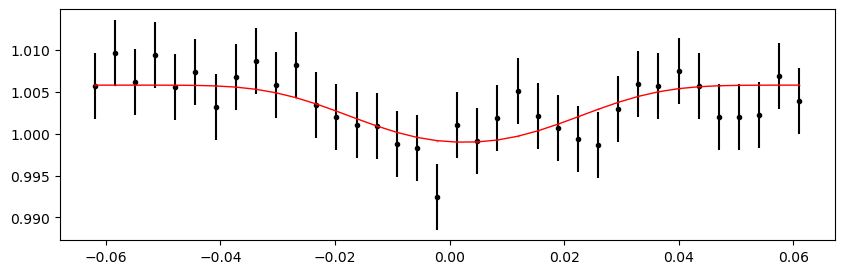

2885.5520197799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 498.78it/s]


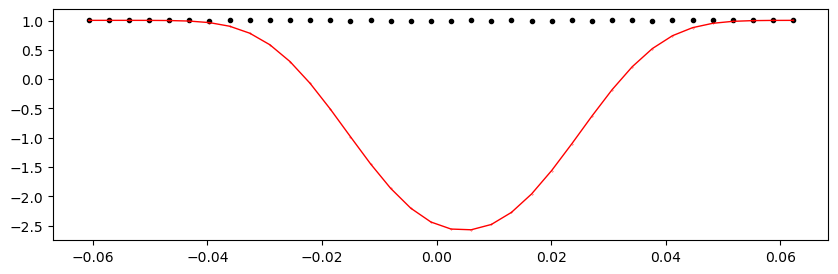

2886.21094464 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.09it/s]


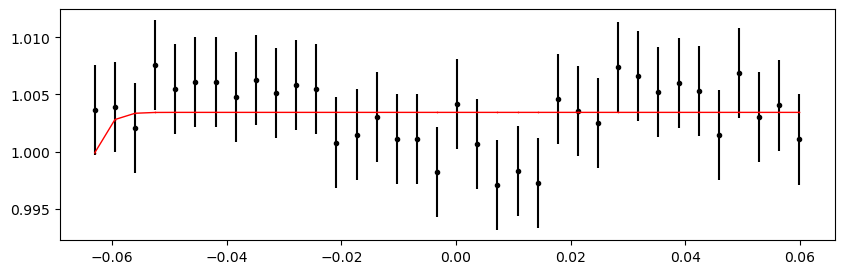

2886.8698695000003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.59it/s]


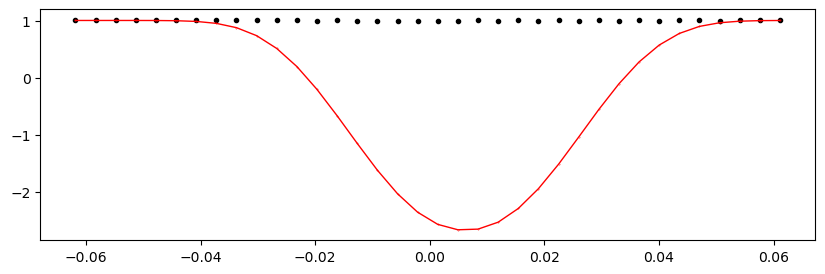

2887.5287943599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 516.66it/s]


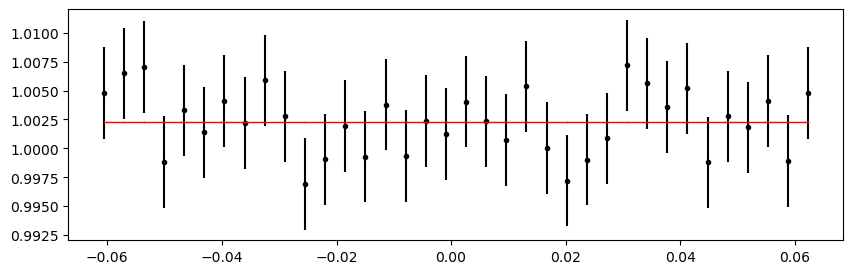

2888.18771922 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.75it/s]


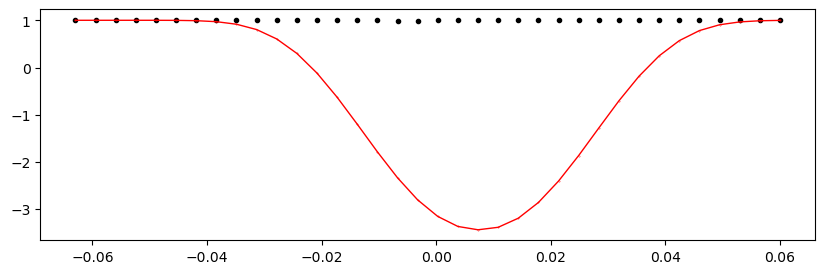

2888.8466440800003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.37it/s]


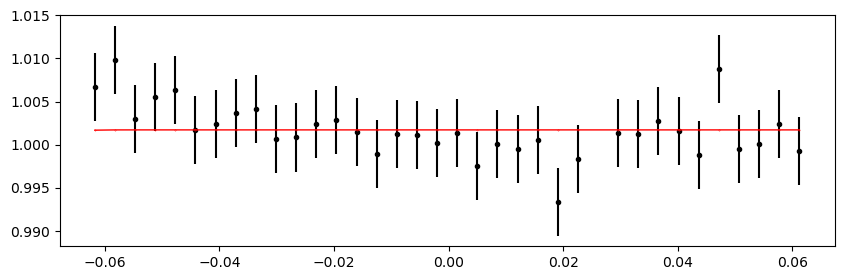

2890.1644938 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.62it/s]


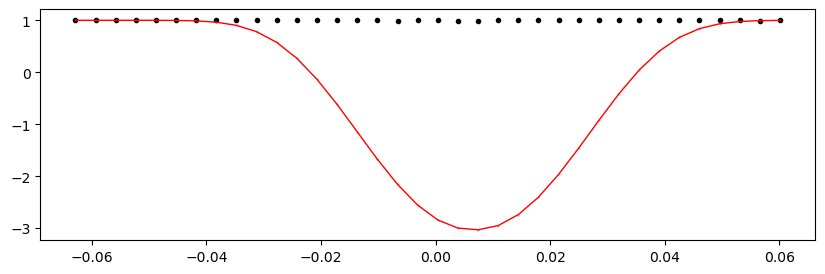

2890.8234186600002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.69it/s]


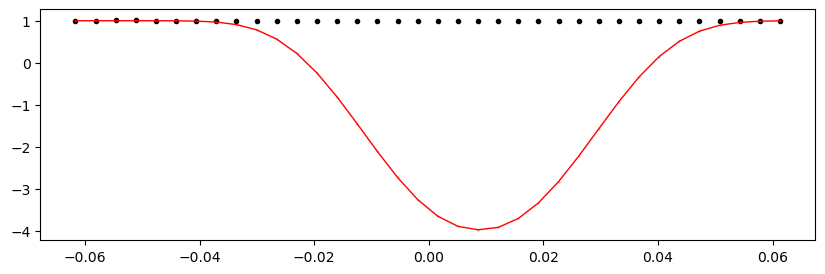

2891.4823435199996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.54it/s]


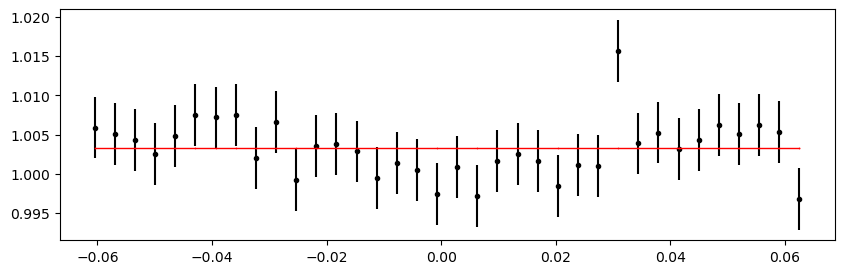

2892.14126838 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.14it/s]


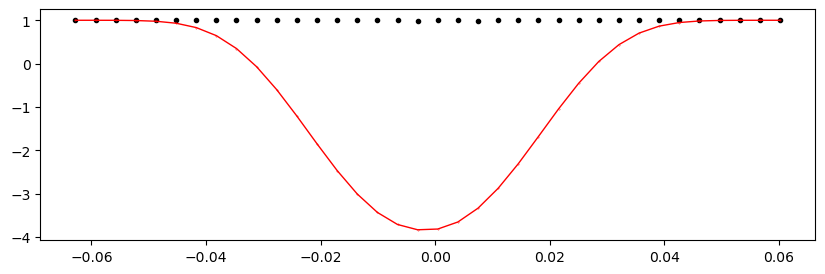

2892.80019324 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.66it/s]


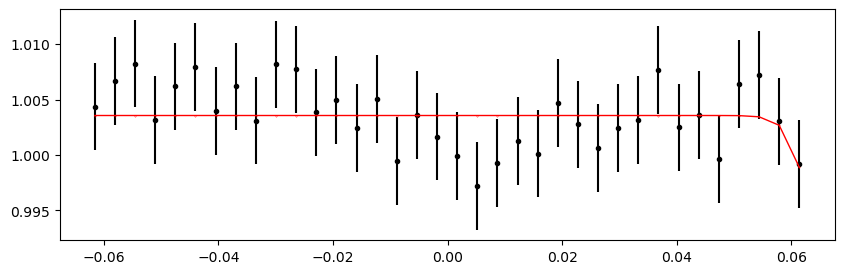

2893.4591180999996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.41it/s]


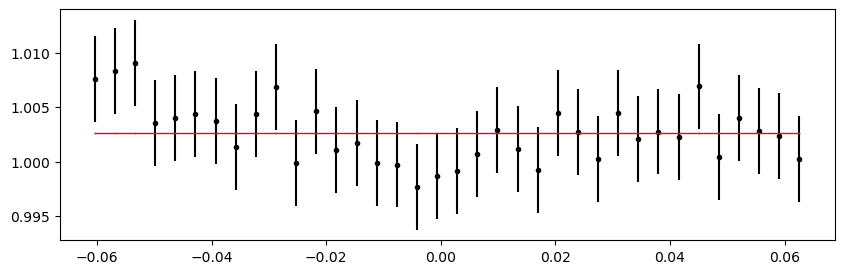

2894.11804296 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.36it/s]


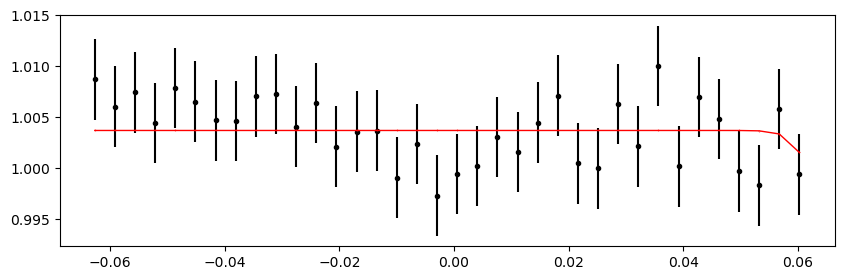

2894.77696782 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 480.08it/s]


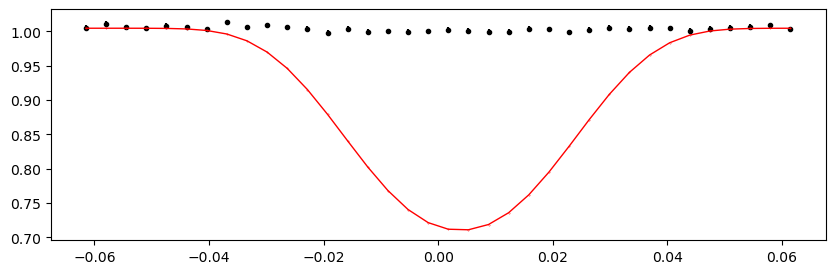

2895.4358926799996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.47it/s]


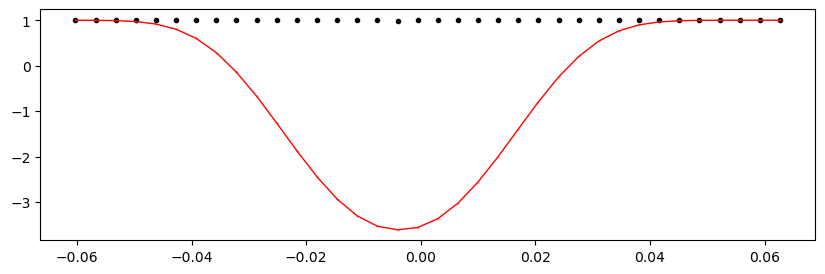

Time 2896.09481754 does not have enough data points: 1
2896.7537424 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.80it/s]


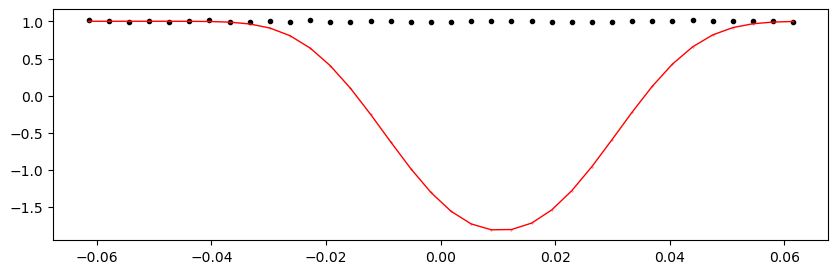

2897.41266726 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.15it/s]


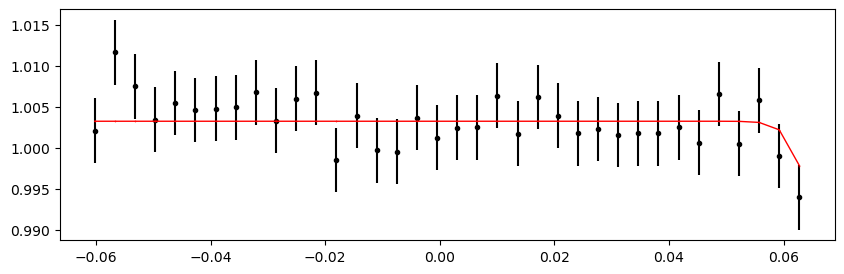

2898.07159212 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 507.98it/s]


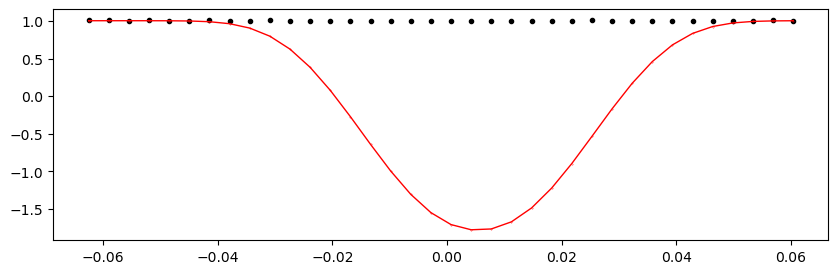

2898.73051698 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.40it/s]


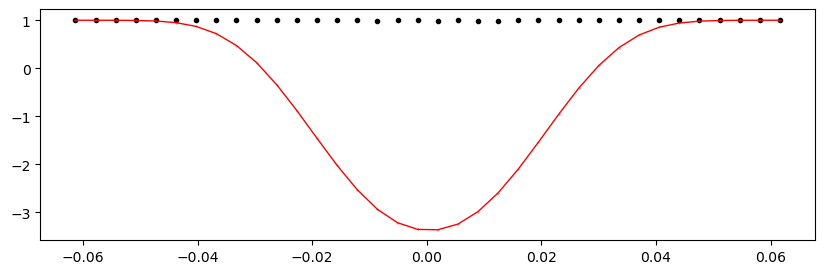

2899.38944184 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.64it/s]


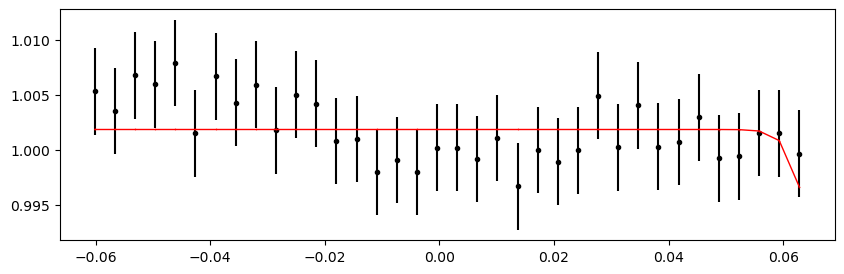

2900.0483667 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.07it/s]


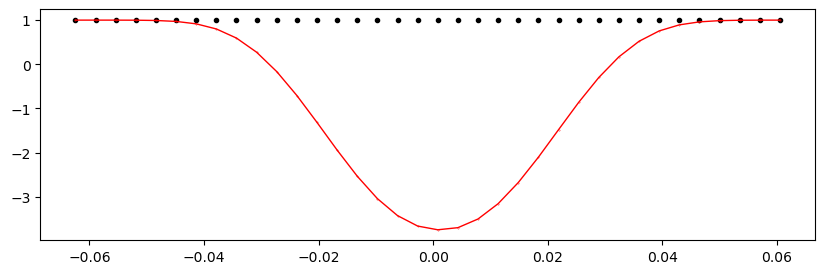

2900.70729156 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.59it/s]


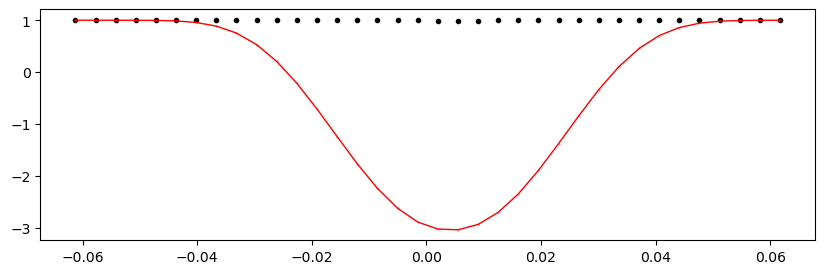

2901.36621642 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.98it/s]


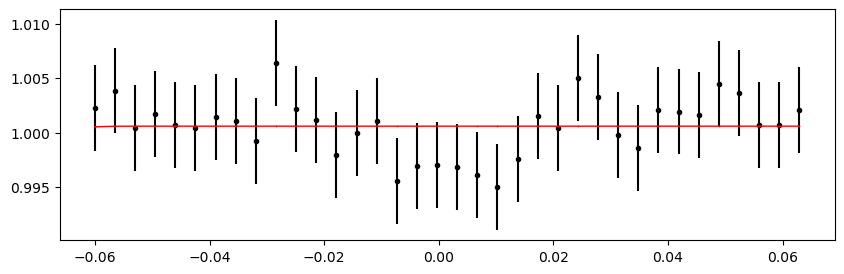

2902.02514128 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.83it/s]


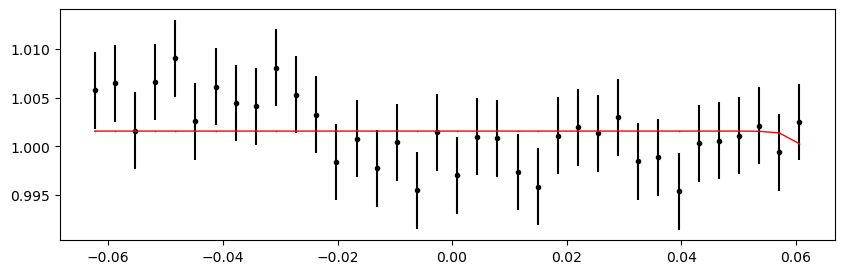

2902.68406614 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 518.09it/s]


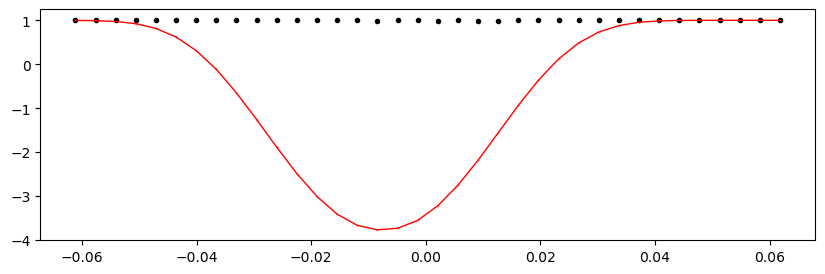

2903.342991 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 490.61it/s]


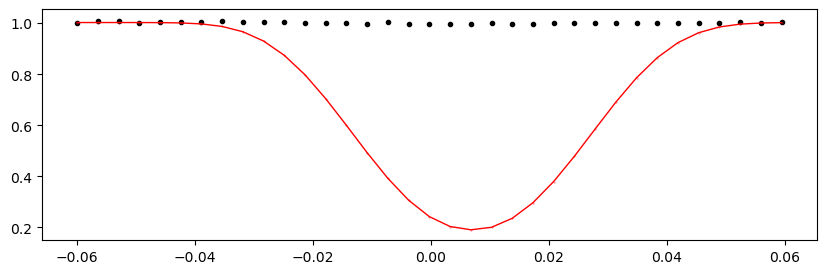

2904.00191586 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.41it/s]


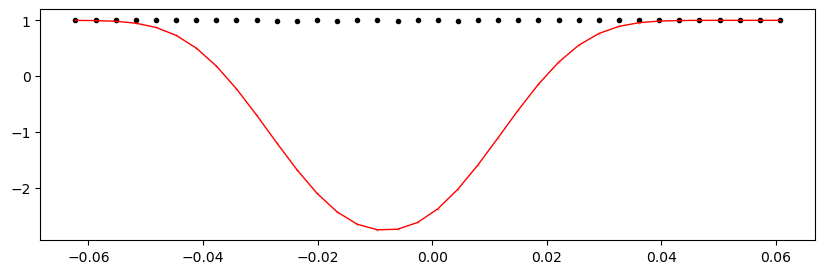

2904.66084072 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 455.13it/s]


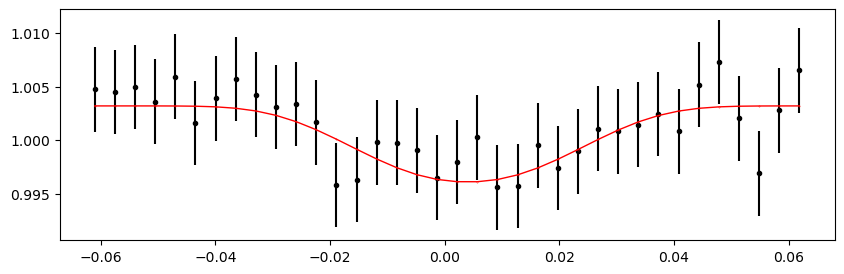

2905.31976558 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.09it/s]


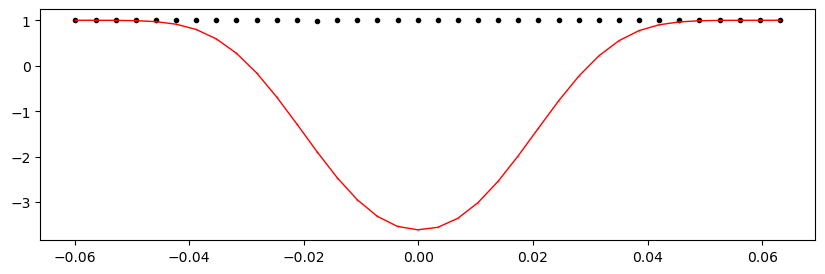

2905.97869044 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 498.02it/s]


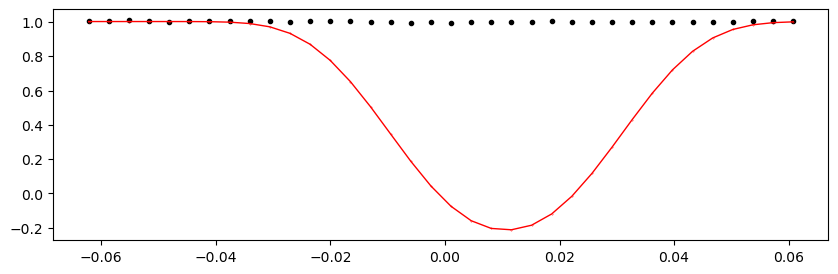

2906.6376153 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 477.42it/s]


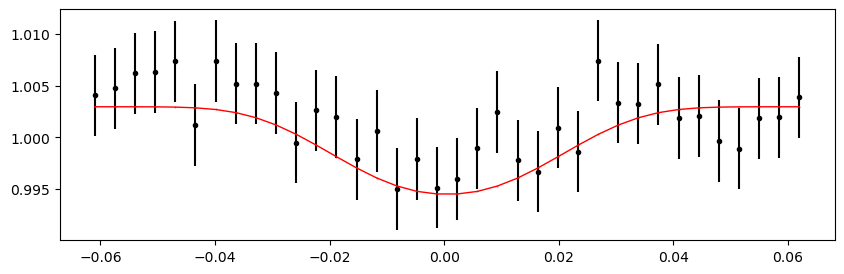

2907.29654016 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:25<00:00, 399.47it/s]


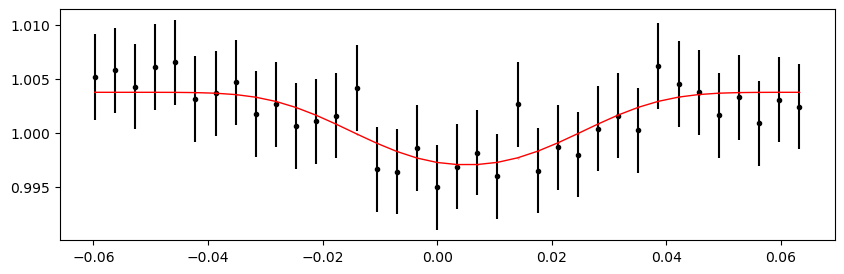

2907.95546502 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.34it/s]


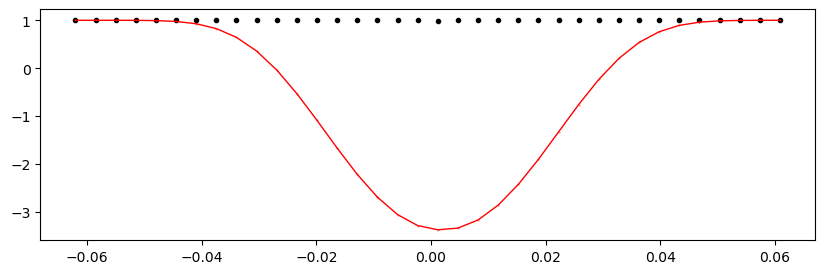

2908.61438988 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 516.37it/s]


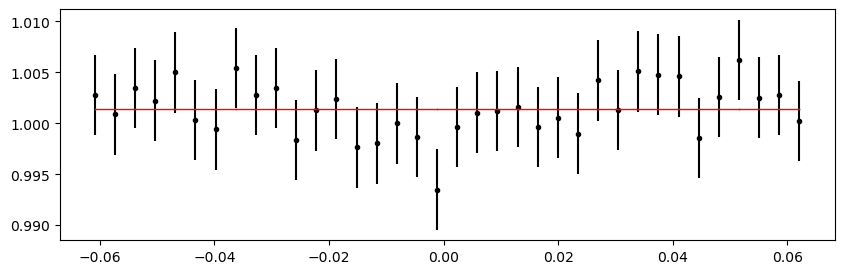

2909.27331474 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.06it/s]


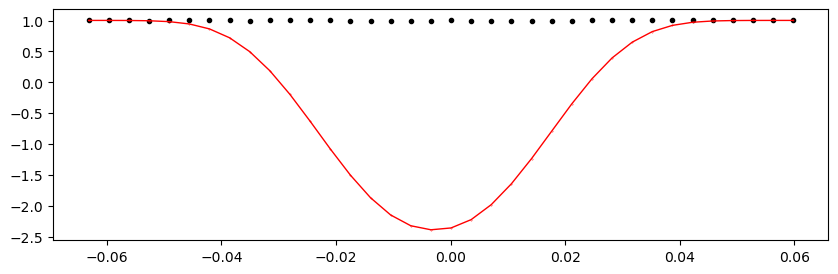

2909.9322396 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.44it/s]


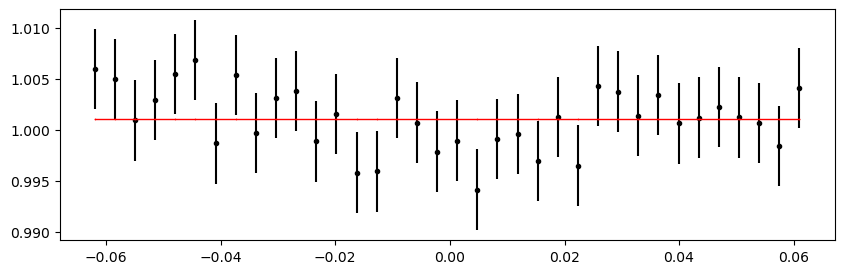

2910.59116446 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.79it/s]


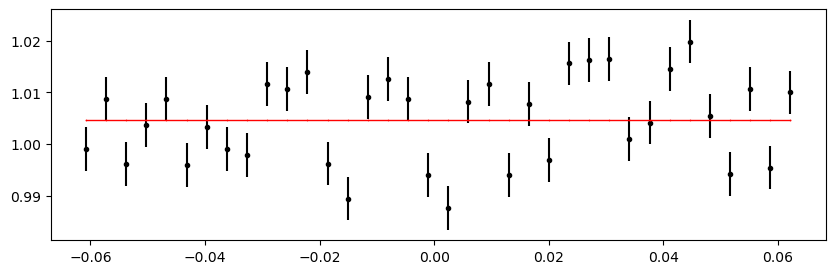

2911.25008932 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 405.76it/s]


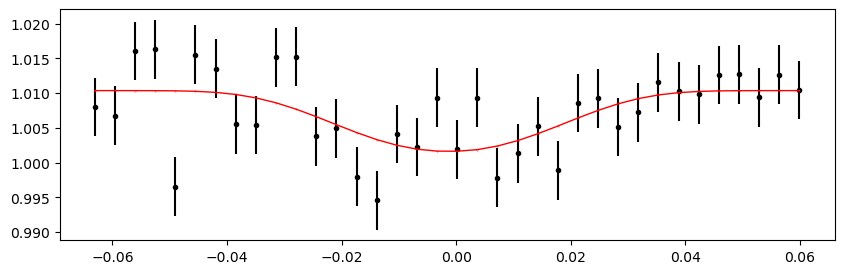

2911.9090141799998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 503.24it/s]


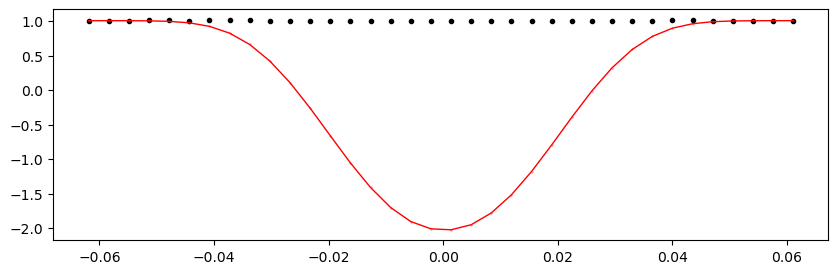

2912.56793904 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 410.83it/s]


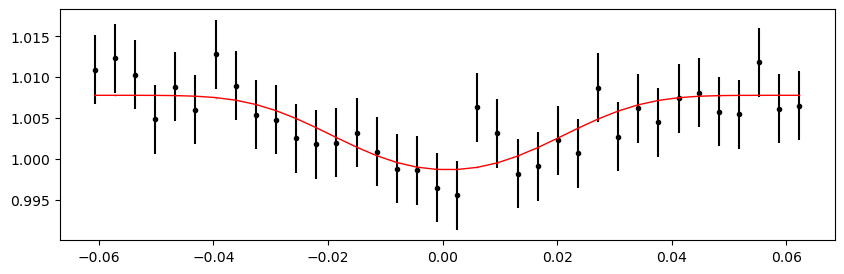

2913.2268639 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.43it/s]


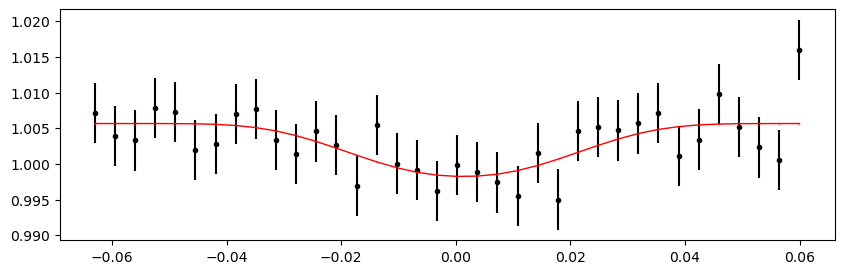

2913.8857887599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.25it/s]


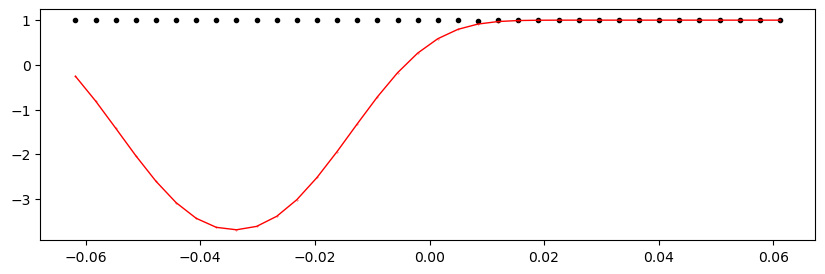

2914.54471362 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.36it/s]


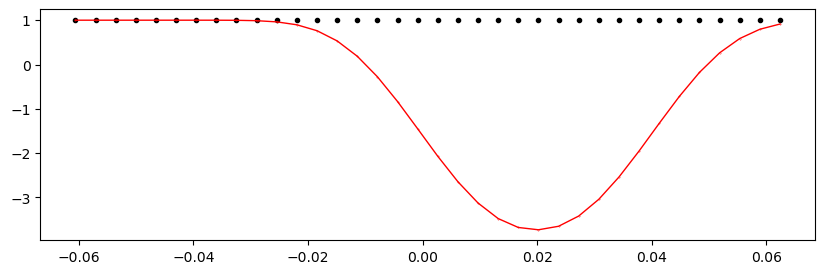

2915.20363848 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.42it/s]


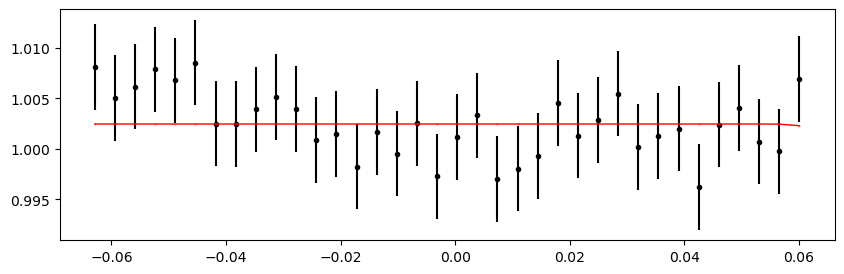

2915.8625633399997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 499.48it/s]


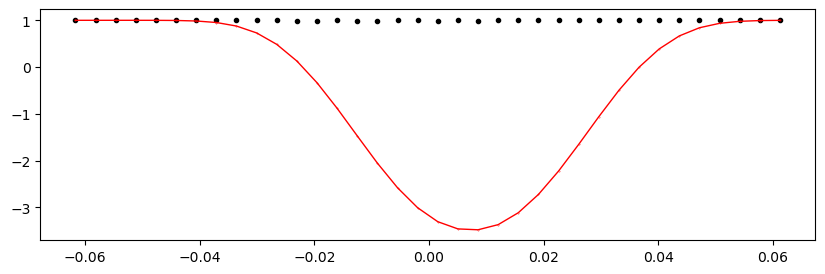

2916.5214882 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.26it/s]


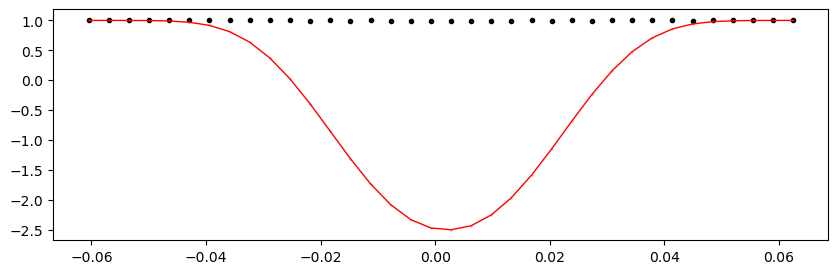

2917.18041306 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 452.49it/s]


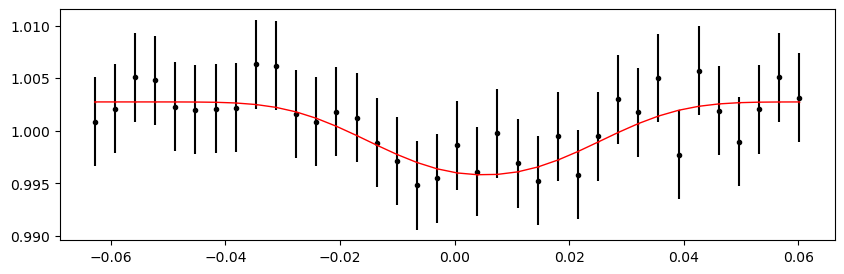

2917.8393379199997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.17it/s]


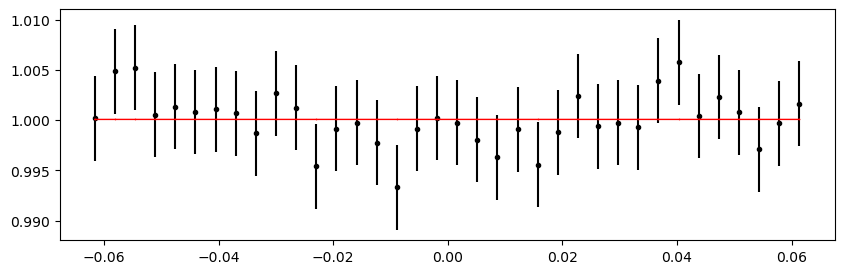

2918.49826278 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 477.72it/s]


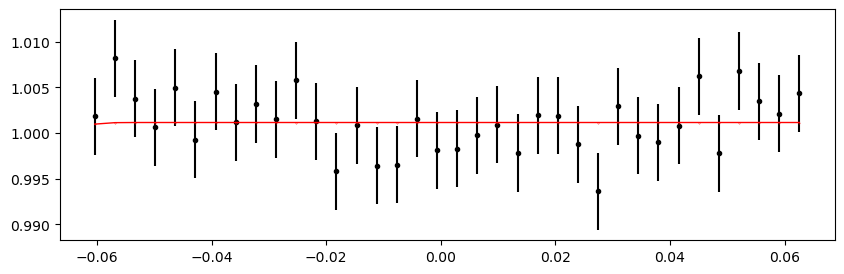

2919.15718764 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 478.88it/s]


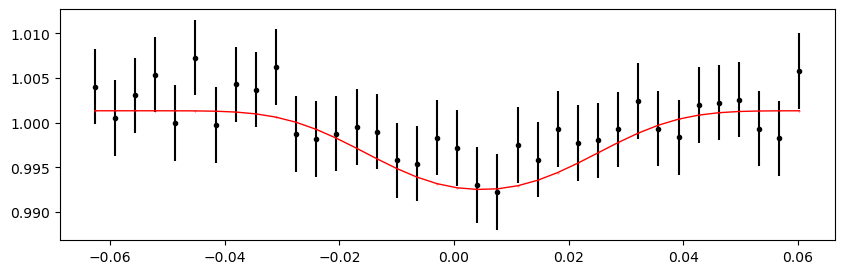

2919.8161124999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 484.69it/s]


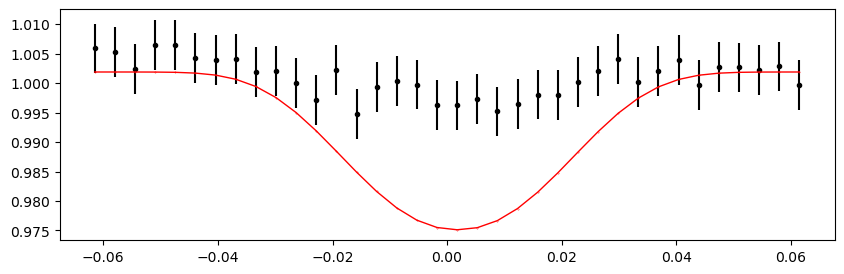

2920.47503736 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.19it/s]


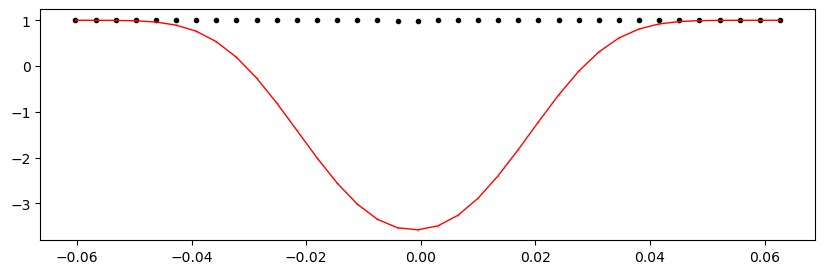

2921.13396222 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 467.09it/s]


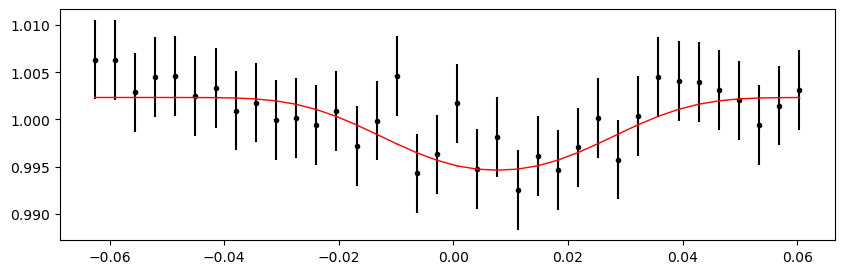

2921.7928870799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.89it/s]


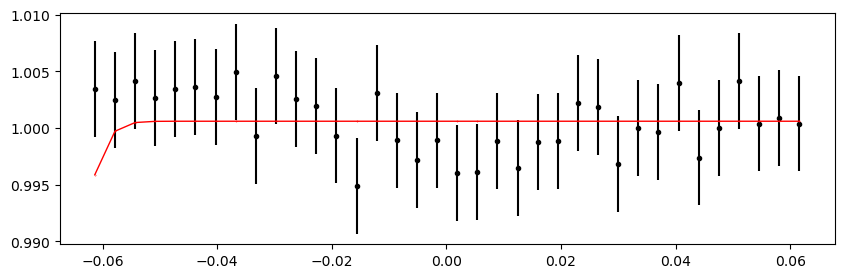

2922.45181194 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 495.19it/s]


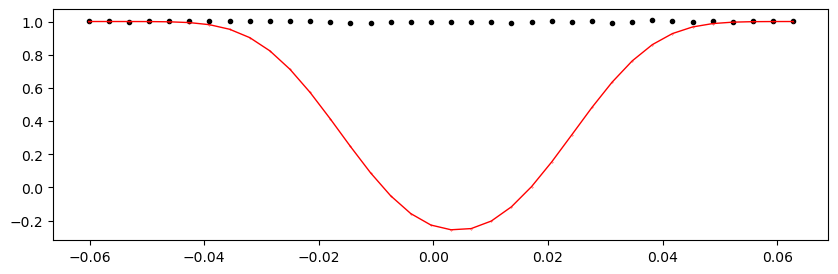

2923.1107368000003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.28it/s]


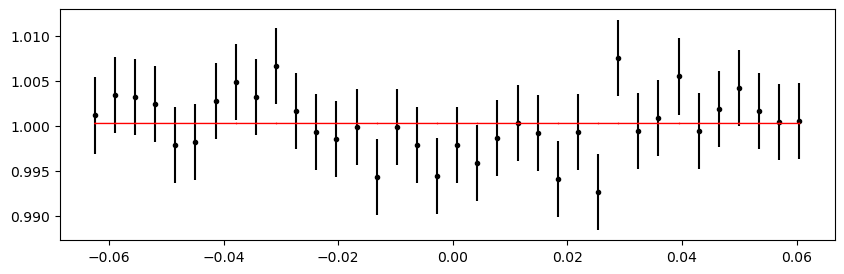

2923.7696616599997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.06it/s]


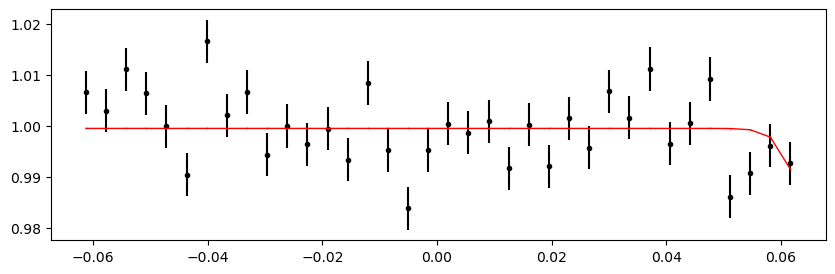

2924.42858652 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.36it/s]


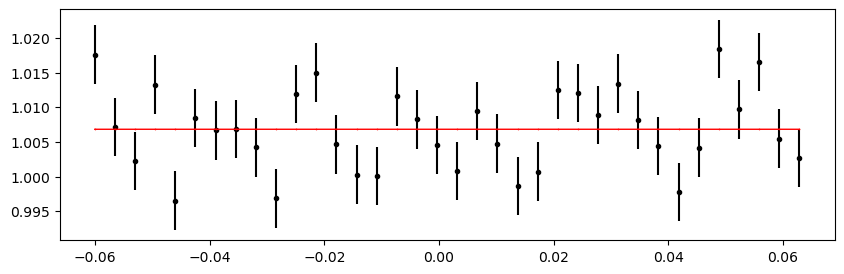

2925.0875113800003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.54it/s]


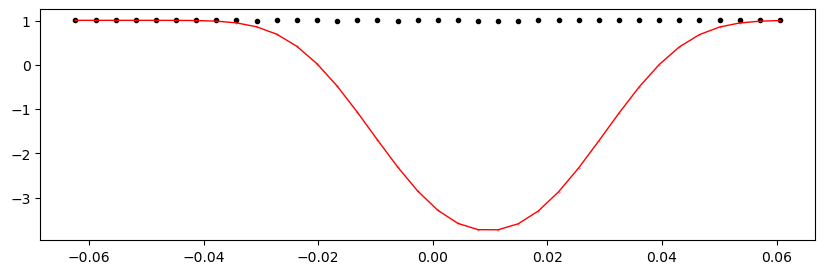

2925.7464362399996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 506.74it/s]


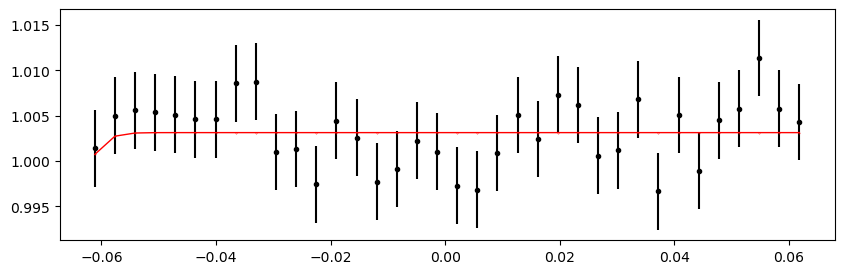

2926.4053611 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.22it/s]


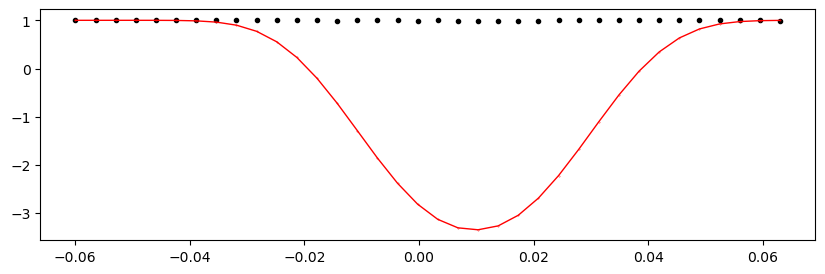

2927.0642859600002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.22it/s]


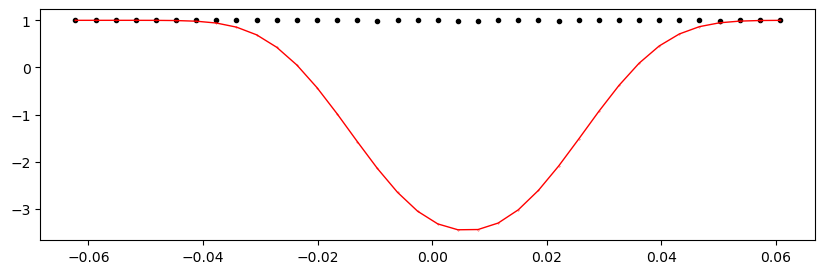

2927.7232108199996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 504.49it/s]


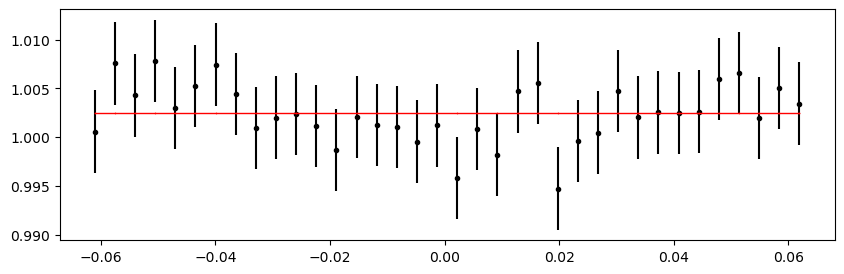

2928.38213568 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.33it/s]


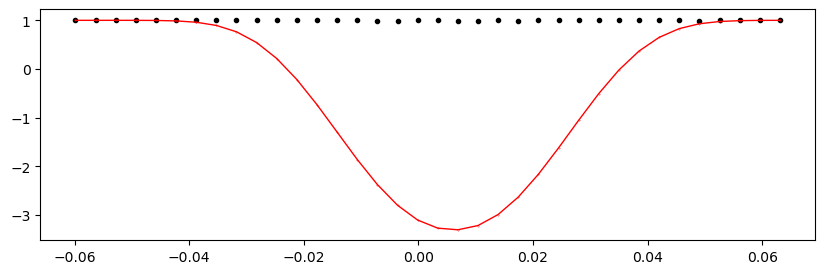

2929.04106054 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 506.53it/s]


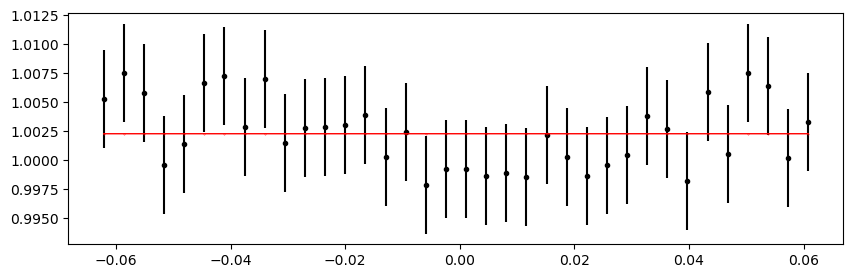

2929.6999853999996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.21it/s]


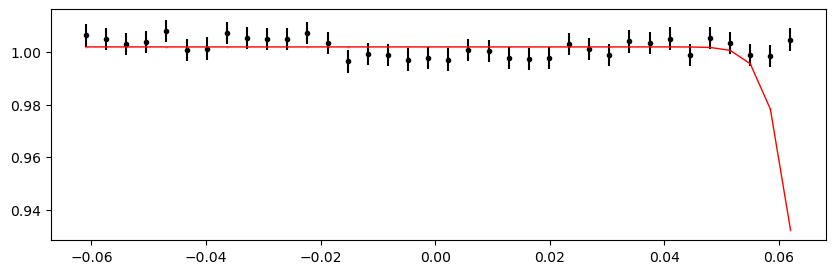

2931.01783512 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.44it/s]


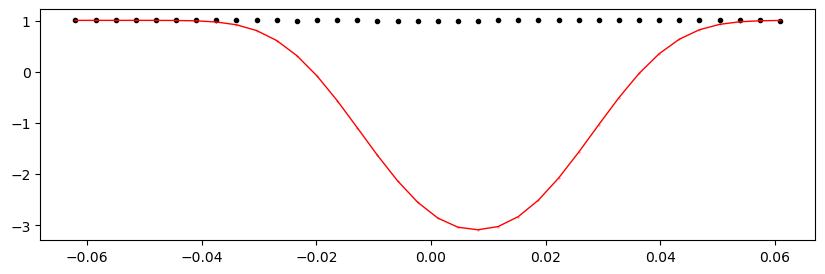

2931.67675998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 499.84it/s]


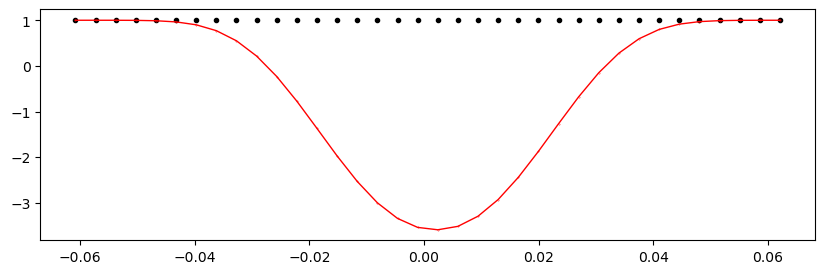

2932.33568484 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.70it/s]


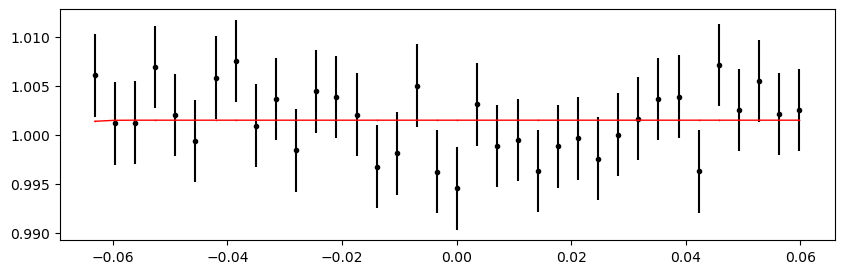

2932.9946097 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.69it/s]


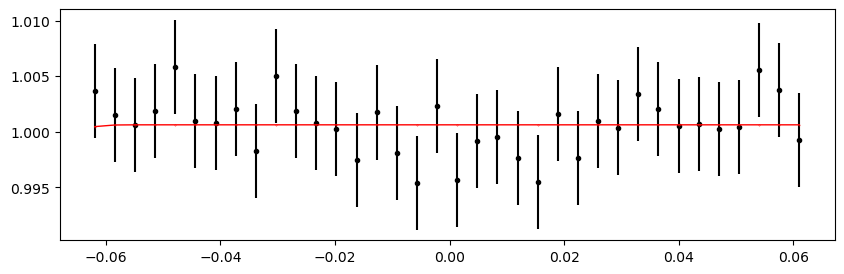

2933.65353456 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.68it/s]


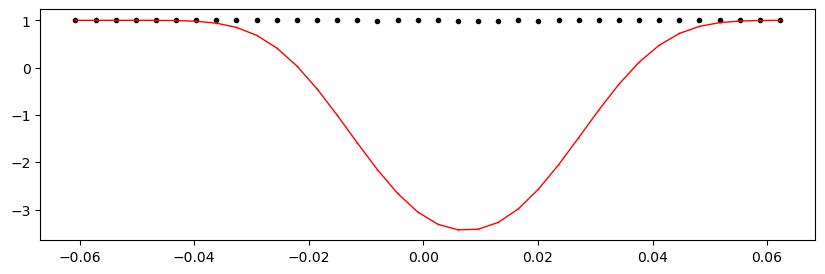

2934.31245942 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 519.65it/s]


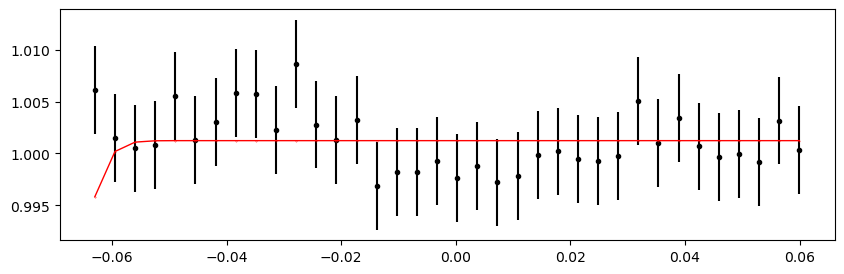

2934.97138428 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 504.07it/s]


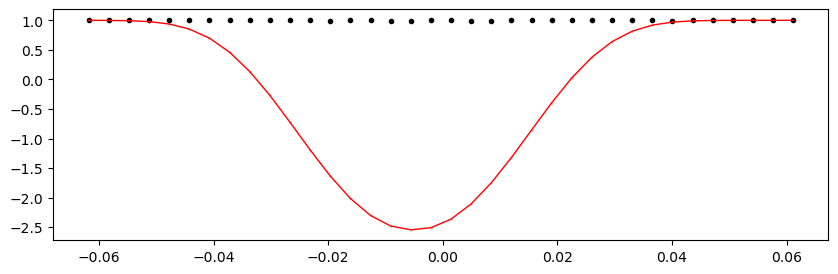

2935.63030914 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 506.49it/s]


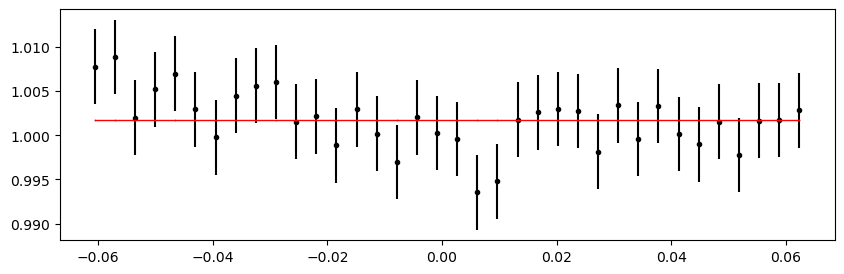

2936.289234 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 411.88it/s]


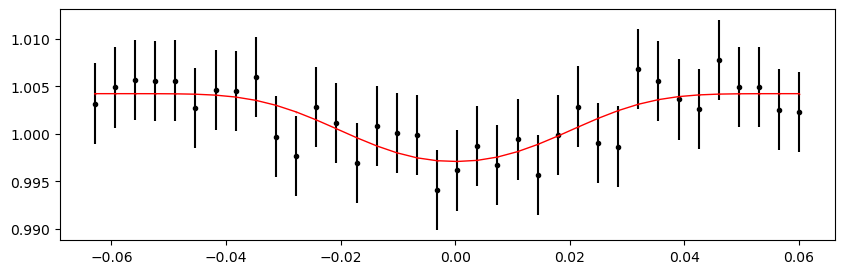

2936.94815886 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:24<00:00, 412.94it/s]


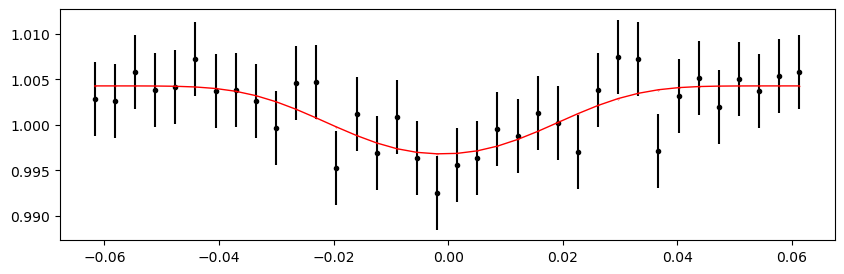

Time 2937.60708372 does not have enough data points: 9
2938.26600858 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.04it/s]


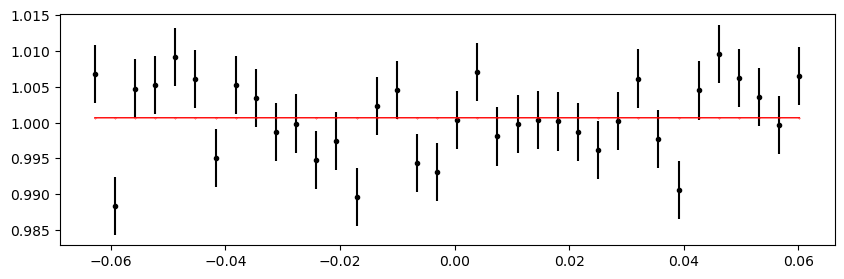

2938.92493344 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 508.59it/s]


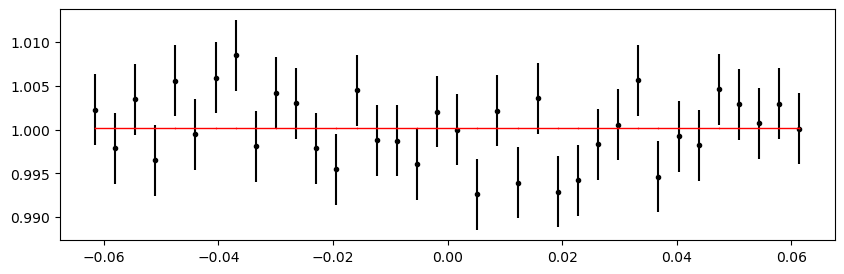

2939.5838583 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 504.91it/s]


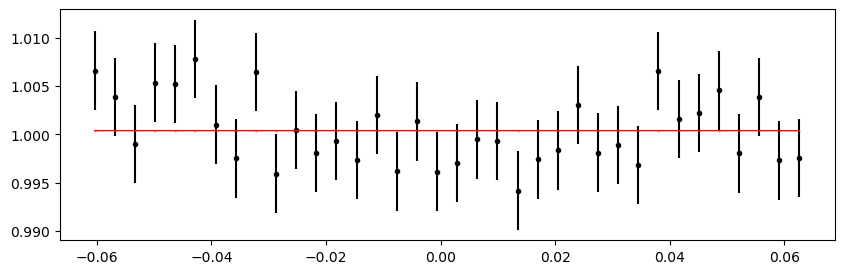

2940.24278316 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 502.41it/s]


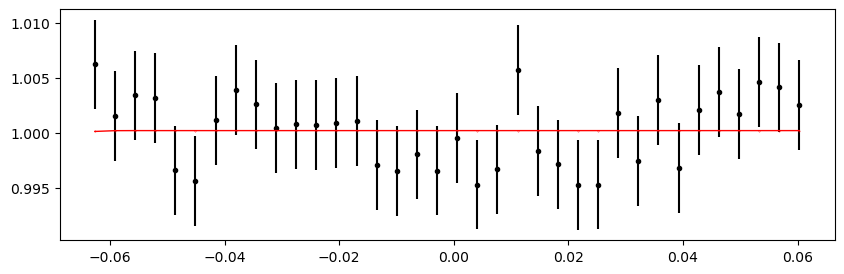

2940.90170802 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.65it/s]


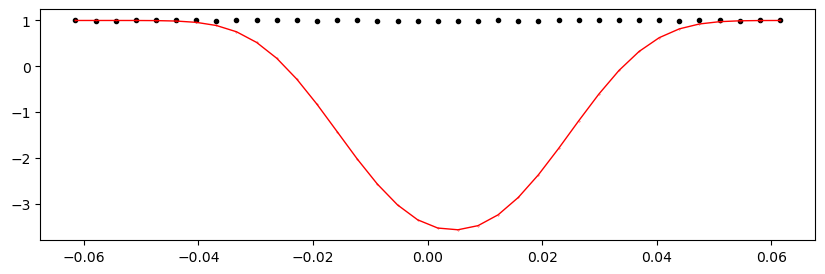

2941.56063288 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.43it/s]


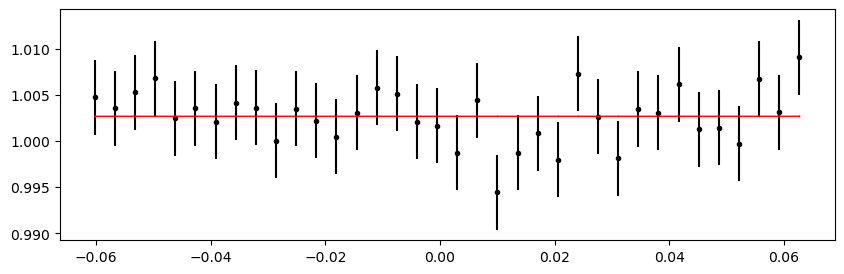

2942.21955774 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 518.37it/s]


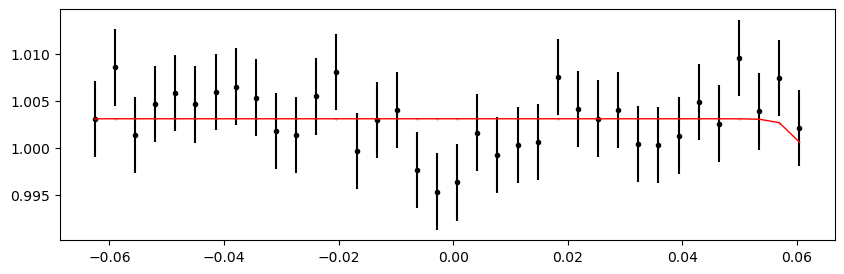

2942.8784826 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.85it/s]


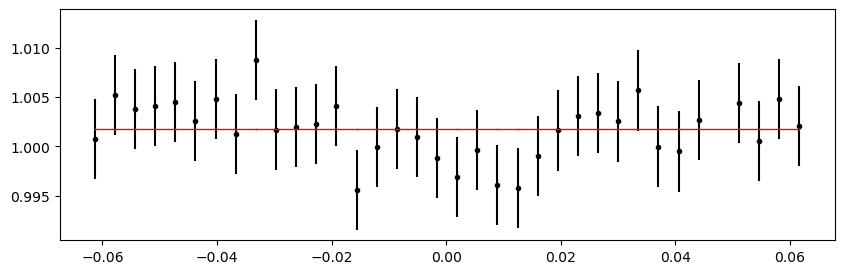

2943.53740746 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.76it/s]


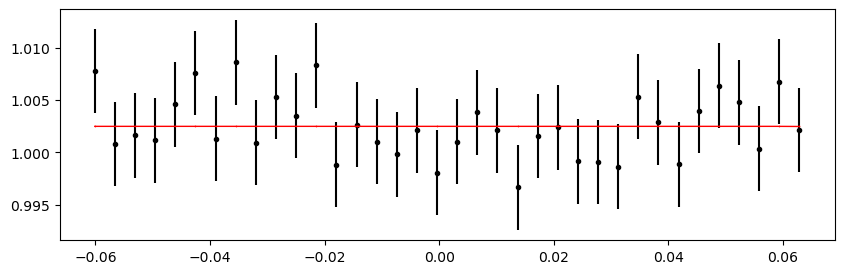

2944.19633232 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 511.18it/s]


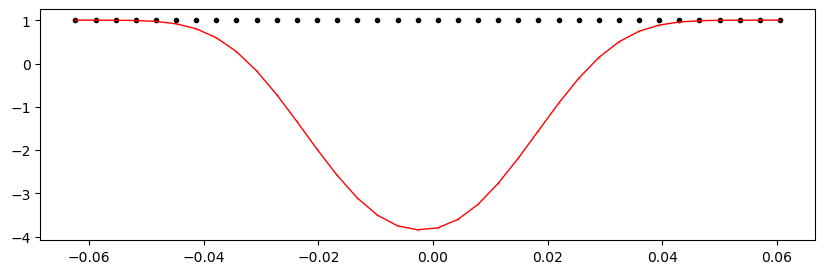

2944.85525718 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:22<00:00, 438.14it/s]


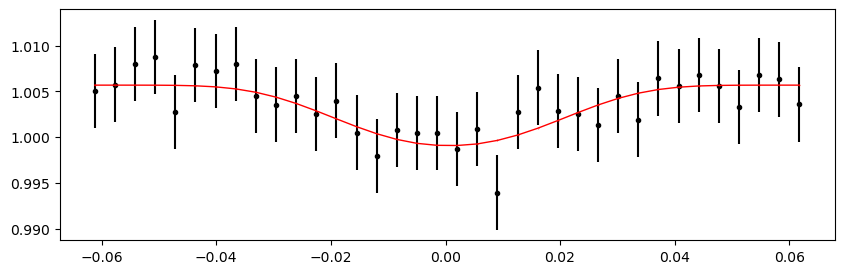

2945.51418204 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.82it/s]


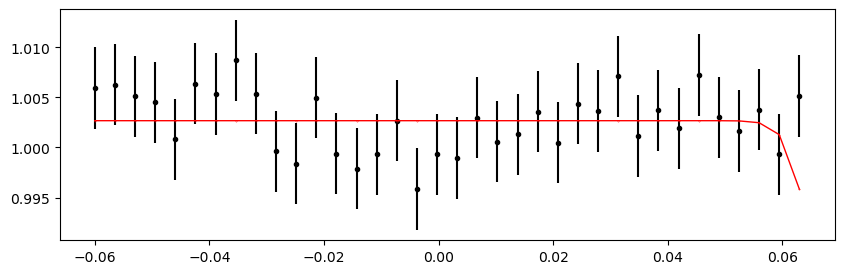

2946.1731068999998 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 510.98it/s]


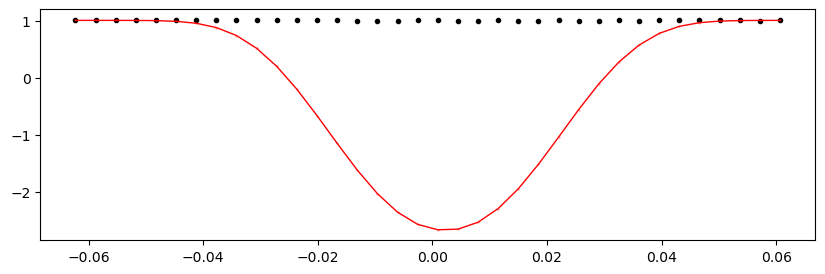

2946.83203176 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 476.41it/s]


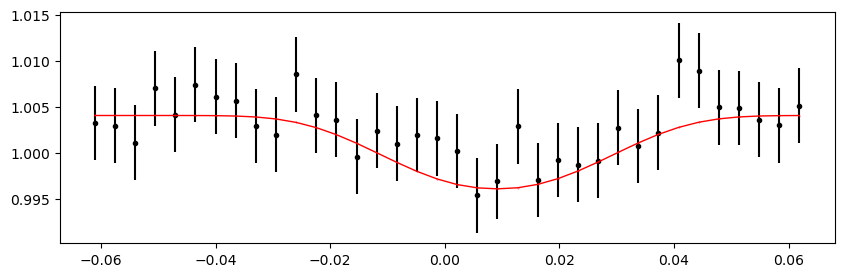

2947.49095662 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.60it/s]


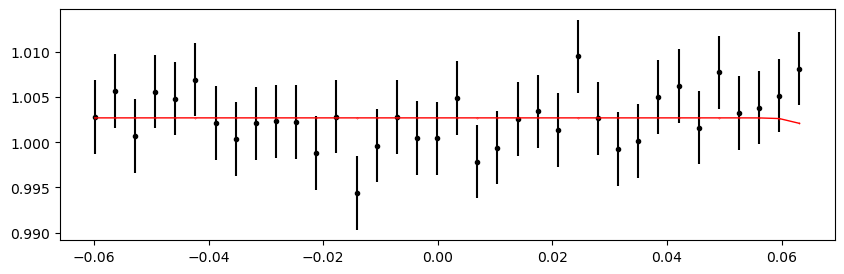

2948.1498814799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.26it/s]


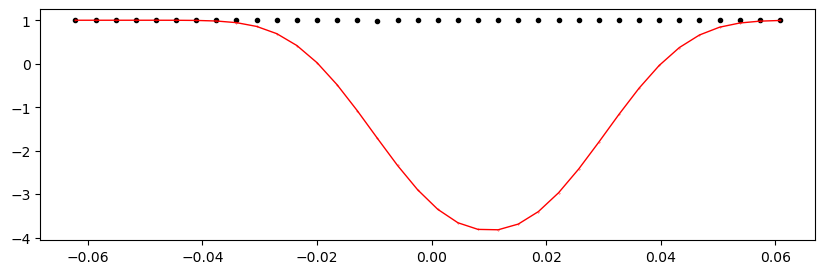

2948.80880634 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.38it/s]


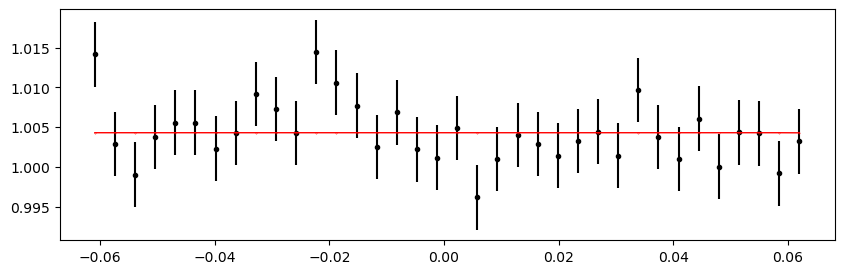

2949.4677312 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 513.62it/s]


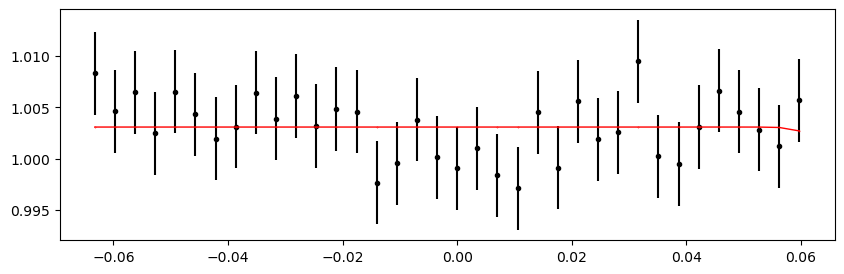

2955.39805494 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.24it/s]


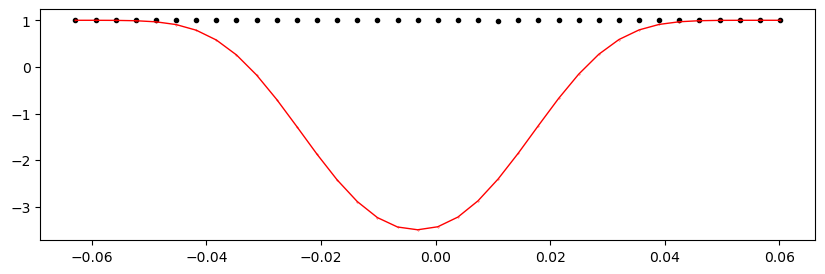

2956.0569797999997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.82it/s]


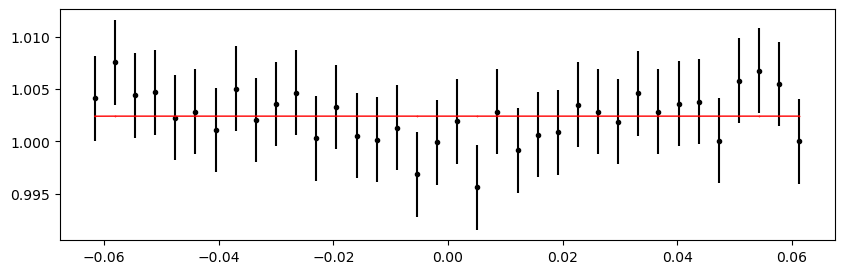

2956.71590466 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.34it/s]


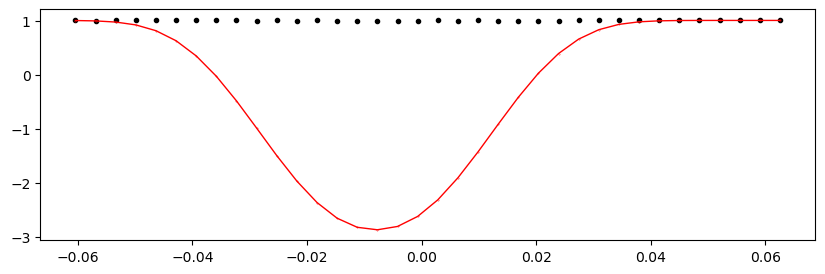

2957.37482952 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 509.07it/s]


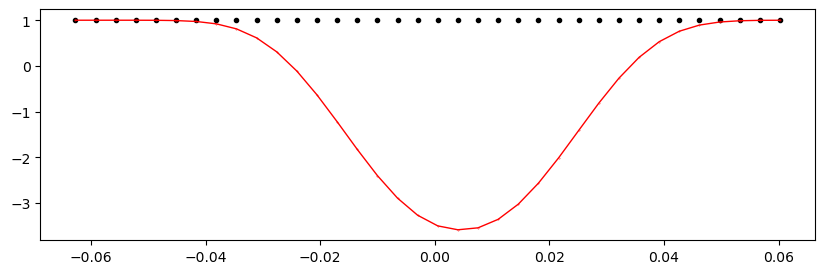

2958.0337543799997 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:21<00:00, 466.95it/s]


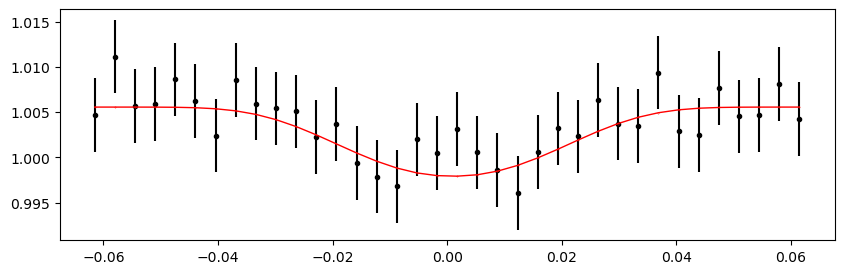

2958.69267924 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 515.30it/s]


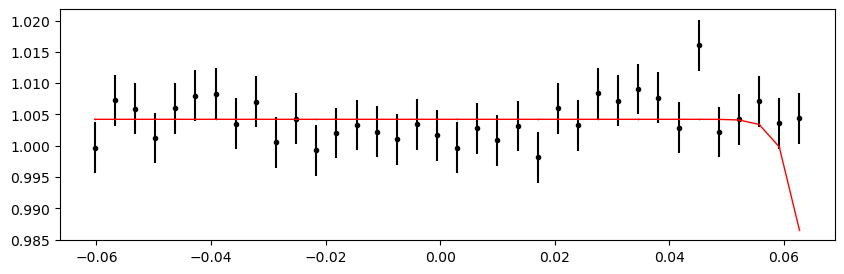

2959.3516041000003 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 512.50it/s]


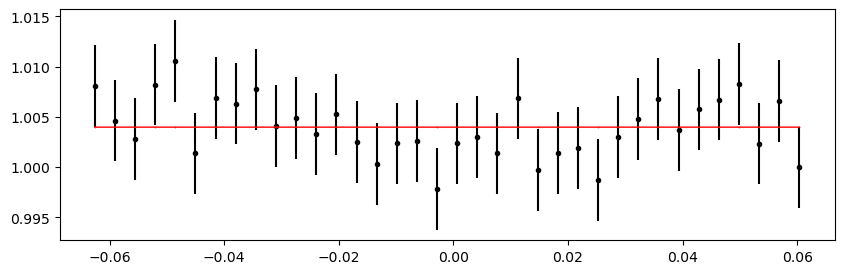

2960.0105289599996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.60it/s]


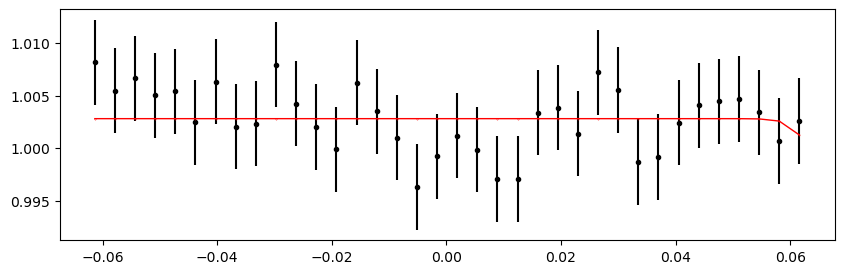

2960.66945382 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 517.06it/s]


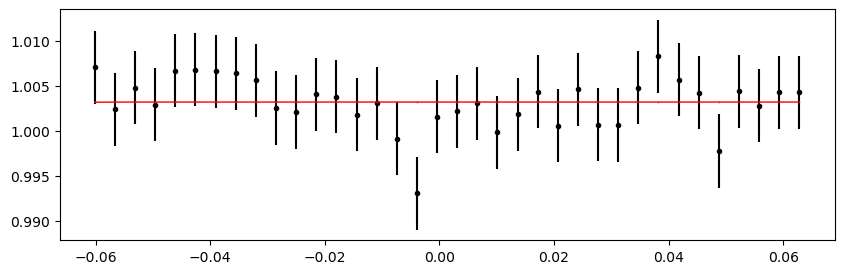

2961.3283786800002 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:20<00:00, 485.41it/s]


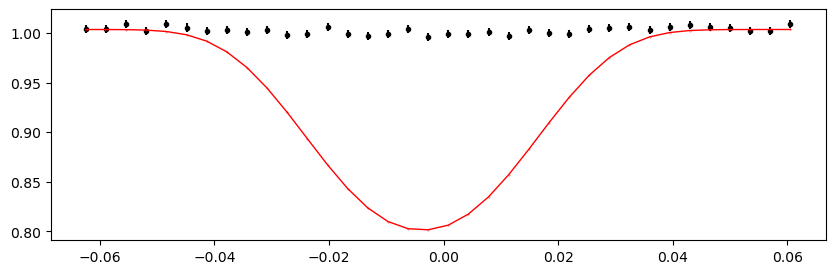

2961.9873035399996 1.0024856499010593 -0.004706525929913496 -0.2709965625095382


100%|███████████████████████████████████████████████████████| 10000/10000 [00:19<00:00, 514.21it/s]


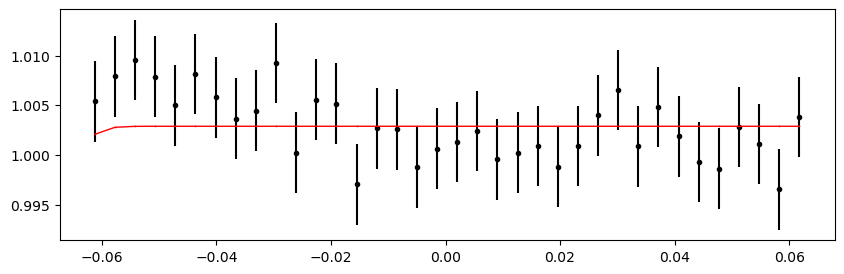

In [78]:
# ---

%matplotlib inline

if t0_secondary is not None:
    print("Fitting individual secondary eclipses...")
    etv_functions.fit_each_eclipse(data_secondary, n_transits, t0_secondary, period, mean_alpha0_s, mean_alpha1_s, mean_t0_s, mean_d_s, mean_Tau_s, outfile_path_s,
                                   min_number_data=10, 
                                  )
    !$NOTIFY_CMD "Individual secondary eclipses fit done"
else:
    print("No secondary eclipses defined. No-Op.")

## ETV O-C plot

- Note: the data in early 30-minute cadence sectors has no ETV result, because there are too few data points per eclipse (usually <= 4) 

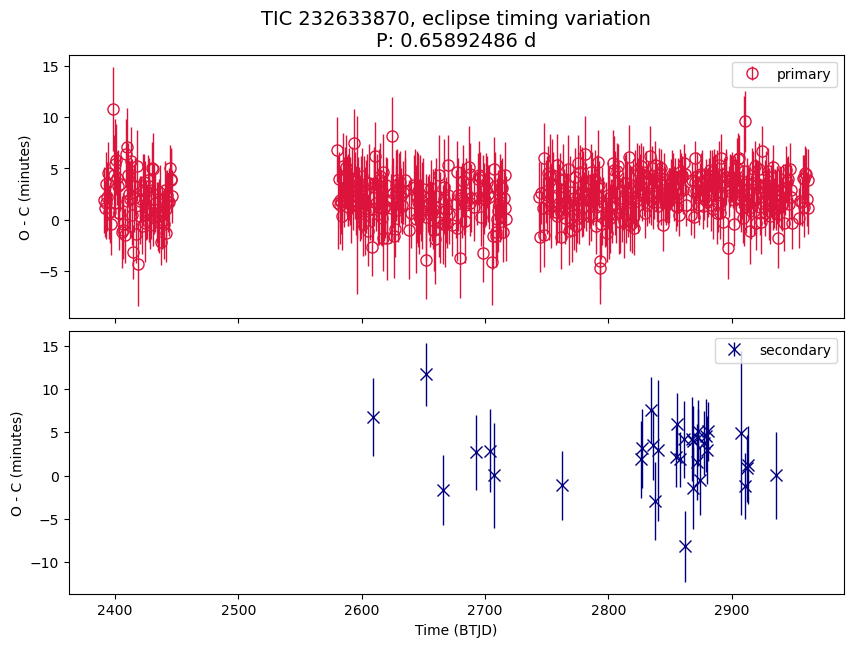

In [81]:
%matplotlib inline
# %matplotlib widget

#plot the extracted transit times to check for ETVs

num_rows = 2 if t0_secondary is not None else 1
figsize_y = 3.3 if num_rows == 1 else num_rows * 3.5
# num_rows = 1  # force to plot primary only
# figsize_y = 3.3

fig, axs = plt.subplots(num_rows, 1, figsize=(10, figsize_y), sharex=True)
if isinstance(axs, plt.Axes):  # handle edge case that num_rows == 1, returned axs is not a list
    axs = [axs]

in_df_primary = pd.read_csv(outfile_path)
in_df_primary['midpoint'] = in_df_primary['epoch'] + (in_df_primary['t0']*period)
in_df_primary['shift_mins'] = in_df_primary['t0']*period*24*60
in_df_primary['std_mins'] = in_df_primary['stdv_t0']*period*24*60

in_df_primary_all = in_df_primary
in_df_primary = in_df_primary[in_df_primary.std_mins < 10]  # filter out outliers in error

# axs[0].plot(in_df_primary['epoch'], in_df_primary['shift_mins'], 
#              lw = 1, color = 'crimson', )
# axs[0].scatter(in_df_primary['epoch'], in_df_primary['shift_mins'], 
#              marker = 'o', s=8**2, color = 'None', edgecolor = 'crimson', label="primary")
axs[0].errorbar(in_df_primary['epoch'], in_df_primary['shift_mins'], yerr = in_df_primary['std_mins'], 
             lw = 0, marker = 'o', elinewidth = 1, markersize = 8, color = 'None', ecolor='crimson', markeredgecolor = 'crimson', label="primary")

# if False:
if t0_secondary is not None:
    in_df_secondary = pd.read_csv(outfile_path_s)
    in_df_secondary['midpoint'] = in_df_secondary['epoch'] + (in_df_secondary['t0']*period)
    in_df_secondary['shift_mins'] = in_df_secondary['t0']*period*24*60
    in_df_secondary['std_mins'] = in_df_secondary['stdv_t0']*period*24*60
    
    in_df_secondary_all = in_df_secondary
    in_df_secondary = in_df_secondary[in_df_secondary.std_mins < 10]  # filter out outliers in error
    
    # axs[1].plot(in_df_secondary['epoch'], in_df_secondary['shift_mins'],
    #              lw = 1, color = 'navy', )
    # axs[1].scatter(in_df_secondary['epoch'], in_df_secondary['shift_mins'],
    #              marker = 'x',  s=9**2, color = 'navy', zorder = -2, label="secondary" );
    axs[1].errorbar(in_df_secondary['epoch'], in_df_secondary['shift_mins'], yerr = in_df_secondary['std_mins'], 
                 lw = 0, marker = 'x', elinewidth = 1, markersize = 9, color = 'navy', zorder = -2, label="secondary" );
else:
    in_df_secondary = None

for ax in axs:
    ax.set_ylabel("O - C (minutes)")
    ax.legend();

axs[-1].set_xlabel(f"Time ({search_result.time.format.upper()})")
axs[0].set_title(f"TIC {ticid}, eclipse timing variation\nP: {period} d", fontsize=14)

plt.subplots_adjust(hspace=0.05)
# plt.ylim(-3, 8)
plt.show()

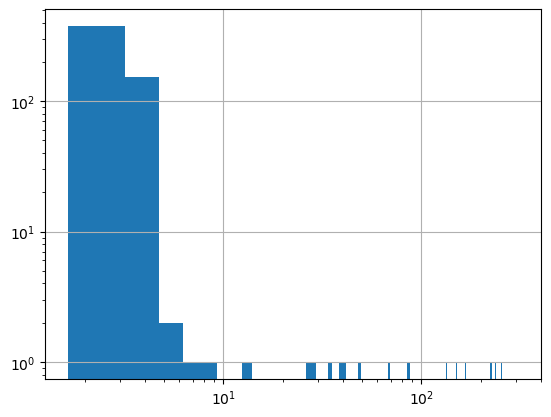

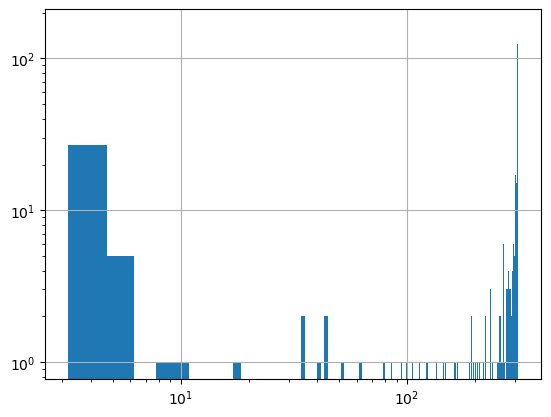

In [89]:
# to help to  filter out valeus with huge error
ax = in_df_primary_all.std_mins.hist(bins=200)
ax.set_xscale("log")
ax.set_yscale("log")
plt.show()

ax = in_df_secondary_all.std_mins.hist(bins=200)
ax.set_xscale("log")
ax.set_yscale("log")
plt.show()

### O-C Plot, Zoom In

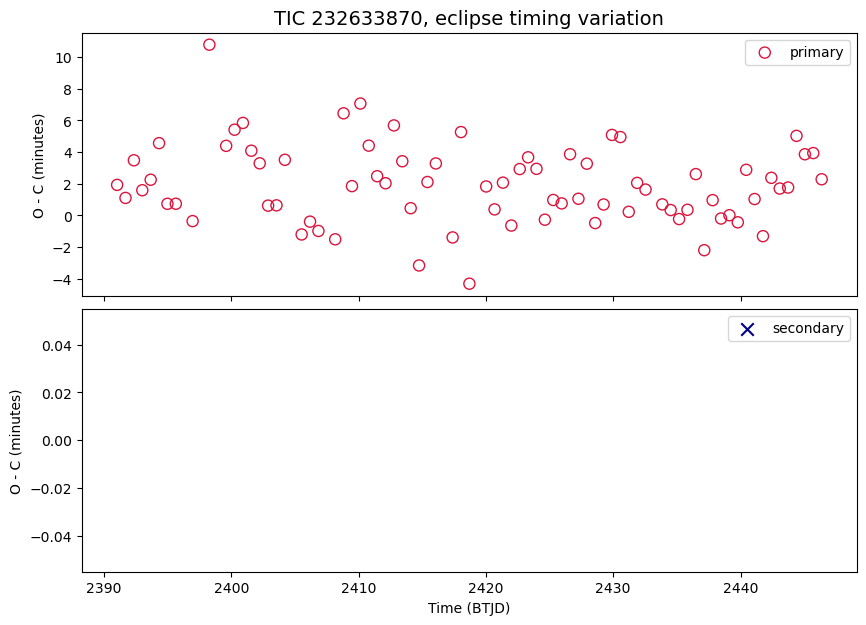

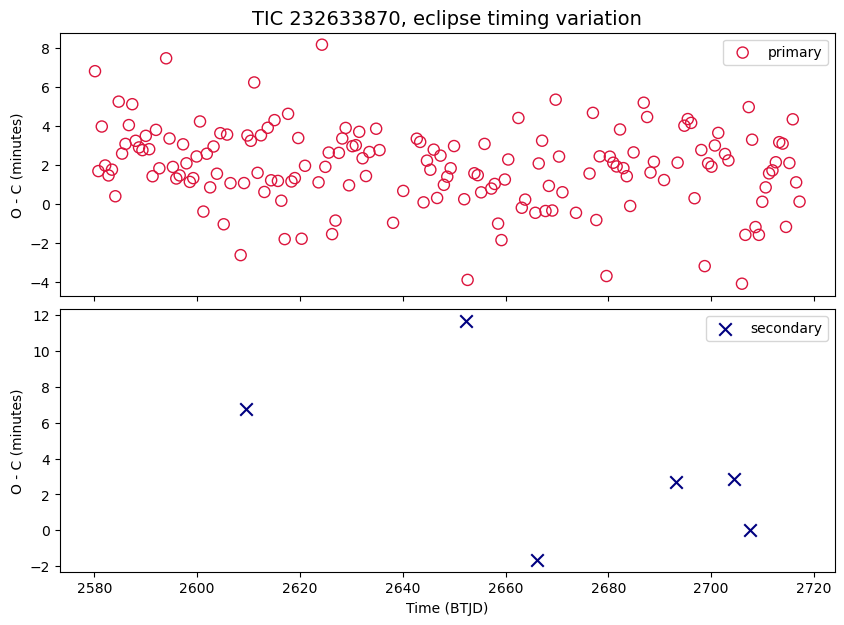

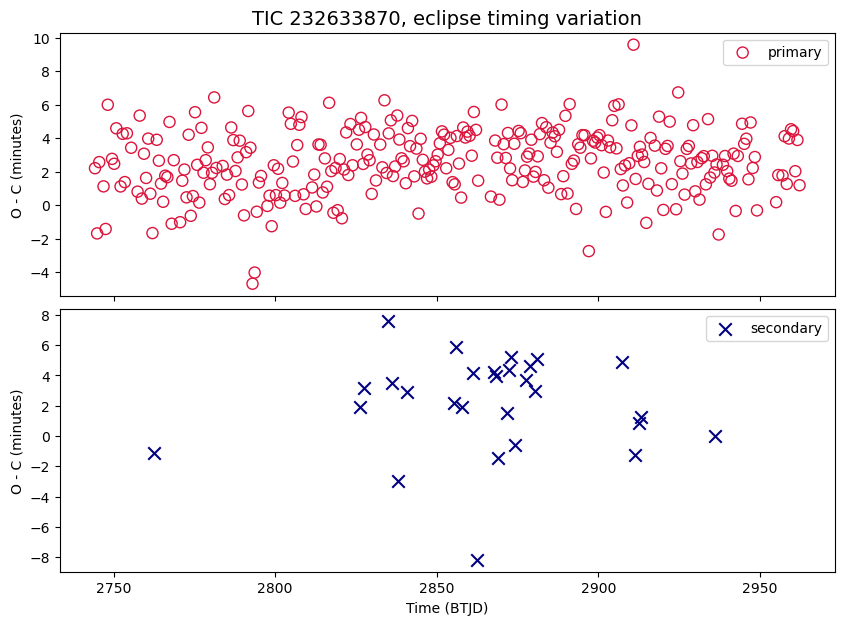

In [82]:
%matplotlib inline
# %matplotlib widget

zoom_ranges = [
    (2300, 2450),
    (2550, 2730),
    (2730, 3100),
]
title_suffix = "eclipse timing variation"

def tweak_axs_list(axs_list):
    # axs_list[0][1].set_ylim(-20, 30);
    # axs_list[1][0].set_ylim(None, 0.5);
    # axs_list[1][1].set_ylim(-5.5, 2);

    # ax = axs_list[0][0]
    # ax.set_title(f"{ax.get_title()} (2min cadence)")
    # ax = axs_list[1][0]
    # ax.set_title(f"{ax.get_title()} (2min cadence)")
    
    pass


def plot_oc_in_zoom_ranges(in_df_primary, in_df_secondary, zoom_ranges):
    axs_list = []
    for zoom_start, zoom_end in zoom_ranges:
        num_rows = 2 if t0_secondary is not None else 1
        figsize_y = 3.3 if num_rows == 1 else num_rows * 3.5
    
        fig, axs = plt.subplots(num_rows, 1, figsize=(10, figsize_y), sharex=True)
        if isinstance(axs, plt.Axes):  # handle edge case that num_rows == 1, returned axs is not a list
            axs = [axs]
        
        df_zoom = in_df_primary[(in_df_primary['epoch'] > zoom_start) & (in_df_primary['epoch'] < zoom_end)]
              
        axs[0].scatter(df_zoom['epoch'], df_zoom['shift_mins'], 
                       marker = 'o', s=8**2, color = 'None', edgecolor = 'crimson', label="primary")
        # axs[0].errorbar(df_zoom['epoch'], df_zoom['shift_mins'], yerr = df_zoom['std_mins'], 
        #                 lw = 0, marker = 'o', elinewidth = 1, markersize = 8, color = 'None', ecolor='crimson', markeredgecolor = 'crimson', label="primary")
        
        if in_df_secondary is not None:
            df_zoom = in_df_secondary[(in_df_secondary['epoch'] > zoom_start) & (in_df_secondary['epoch'] < zoom_end)]
        
            axs[1].scatter(df_zoom['epoch'], df_zoom['shift_mins'],
                           marker = 'x',  s=9**2, color = 'navy', zorder = -2, label="secondary" );
            # axs[1].errorbar(df_zoom['epoch'], df_zoom['shift_mins'], yerr = df_zoom['std_mins'],
            #                 lw = 0, marker = 'x', elinewidth = 1, markersize = 9, color = 'navy', zorder = -2, label="secondary" );
        
        for ax in axs:
            ax.set_ylabel("O - C (minutes)")
            ax.legend();
        
        axs[-1].set_xlabel("Time (BTJD)")
        axs[0].set_title(f"TIC {ticid}, {title_suffix}", fontsize=14)
        
        plt.subplots_adjust(hspace=0.05)
        axs_list.append(axs)
    return axs_list


axs_list = plot_oc_in_zoom_ranges(in_df_primary, in_df_secondary, zoom_ranges)
tweak_axs_list(axs_list);

## make a periodogram 

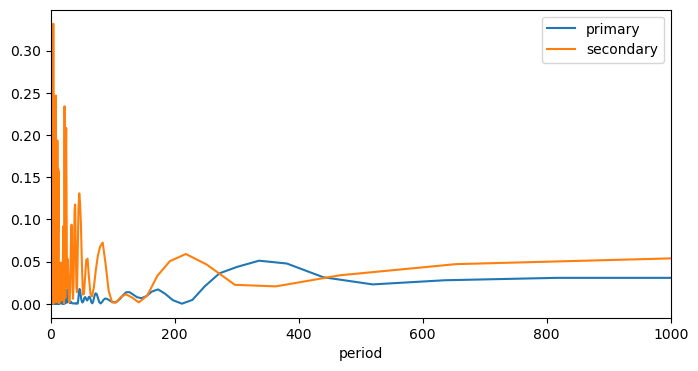

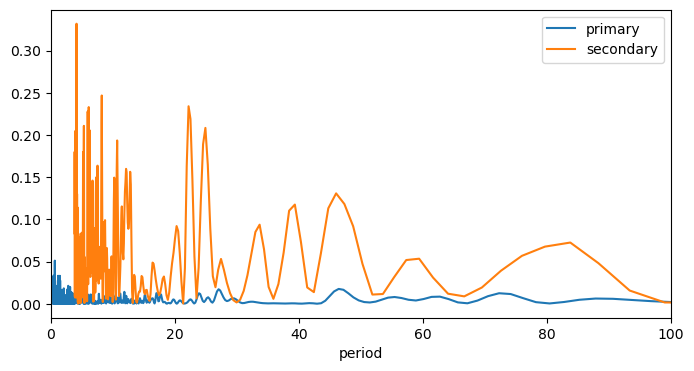

In [84]:
frequency, power = LombScargle(in_df_primary['epoch'], in_df_primary['shift_mins']).autopower()

fig, ax = plt.subplots(figsize=(8, 4))

plt.plot(1/frequency, power, label = 'primary')    

if t0_secondary is not None:
    frequency_s, power_s = LombScargle(in_df_secondary['epoch'], in_df_secondary['shift_mins']).autopower()
    plt.plot(1/frequency_s, power_s, label = 'secondary')    

plt.xlabel("period")

plt.legend()
plt.xlim(0, 1000)
plt.show()


if True:
    fig, ax = plt.subplots(figsize=(8, 4))
    
    plt.plot(1/frequency, power, label = 'primary')    
    
    if t0_secondary is not None:
        frequency_s, power_s = LombScargle(in_df_secondary['epoch'], in_df_secondary['shift_mins']).autopower()
        plt.plot(1/frequency_s, power_s, label = 'secondary')    
    
    plt.xlabel("period")
    
    plt.legend()
    plt.xlim(0, 100)
    plt.show()

## Results Summary

In [90]:
# FILL-IN the ETV results / comments
has_etv = "?"
comments = "O-C scatter of ~15 min amplitude in primary with no real trend. Unsure if the model for primary is good enough (Tau not converging well). Result on secondary is useless (many data points with huge error)."

# Eclipse depth from the model
depth_pct_p = round(-mean_alpha1 * 100, 2)
if t0_secondary is not None:
    depth_pct_s = round(-mean_alpha1_s * 100, 2)
else:
    depth_pct_s = None

summary = {
    "tic": ticid,
    "has_etv": has_etv,
    "comments": comments,
    "period": period,  # the period used in ETV analysis
    "depth_pct_p": depth_pct_p,
    "depth_pct_s": depth_pct_s,
    "epoch_p": t0_primary,
    "epoch_s": t0_secondary,
    "num_sectors": len(sr),
    "time_span": round(time[-1] - time[0], 2),
    "time_start": round(time[0], 2),
    "time_end": round(time[-1], 2),
}

summary = pd.DataFrame.from_dict(summary, orient="index")
with pd.option_context('display.max_colwidth', None, 'display.max_rows', 999, 'display.max_columns', 99):
    display(summary);

# Single line to be added to a CSV
print("")
print(summary.transpose().to_csv(
    index=False,
    header=True, 
))

,0
tic,232633870
has_etv,?
comments,O-C scatter of ~15 min amplitude in primary with no real trend. Unsure if the model for primary is good enough (Tau not converging well). Result on secondary is useless (many data points with huge error).
period,0.658925
depth_pct_p,1.14
depth_pct_s,0.47
epoch_p,1684.0
epoch_s,1683.673075
num_sectors,29
time_span,1279.22



tic,has_etv,comments,period,depth_pct_p,depth_pct_s,epoch_p,epoch_s,num_sectors,time_span,time_start,time_end
232633870,?,O-C scatter of ~15 min amplitude in primary with no real trend. Unsure if the model for primary is good enough (Tau not converging well). Result on secondary is useless (many data points with huge error).,0.65892486,1.14,0.47,1684.0,1683.67307514,29,1279.22,1683.37,2962.58

